# **[Import]**

In [1]:
import os
import pickle
from copy import deepcopy
from os.path import join
from collections import defaultdict, Counter
import itertools
from itertools import combinations
from datetime import datetime
from dateutil.relativedelta import relativedelta
from tqdm import tqdm

import numpy as np
import pandas as pd
import torch

import matplotlib as mpl
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.animation import FuncAnimation
from matplotlib.gridspec import GridSpec
from matplotlib.lines import Line2D

import mpl_toolkits
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

import seaborn as sns
import ipywidgets as widgets
from ipywidgets import interact
from IPython.display import display

from scipy.optimize import curve_fit
import scipy.stats as stats
from scipy.stats import rankdata
from scipy.stats import linregress
from scipy.stats import kendalltau
from scipy.stats import spearmanr
from scipy.stats import lognorm
import scipy.spatial as spatial
from scipy.spatial.distance import jensenshannon, euclidean

import sklearn as sk
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics.pairwise import cosine_similarity

import bertopic
import powerlaw
from umap import UMAP

from proj_utils import *

# pkill -f "jupyter"

In [2]:
def date_label(start_date, end_date):
    date_list = pd.date_range(start_date, end_date, freq='Y').strftime('%Y').tolist()
    jan_indices = [i for i, date in enumerate(pd.date_range(start_date, end_date, freq='M')) if date.month == 1]
    date_list = [date.strftime('%Y') for date in pd.date_range(start_date, end_date, freq='M') if date.month == 1]
    return jan_indices, date_list

def power_law(alpha, xmax):
    x = np.arange(1, xmax+1, dtype='float')
    pmf = x**(-alpha)
    pmf /= pmf.sum()
    return pmf, stats.rv_discrete(values=(range(1, xmax+1), pmf))

def truncated_power_law(alpha, Lambda, xmax):
    x = np.arange(1, xmax+1, dtype='float')
    pmf = x**(-alpha) * np.exp(-Lambda * x)
    pmf /= pmf.sum()
    return pmf, stats.rv_discrete(values=(range(1, xmax+1), pmf))

def sorted_topic(rank, rd):
    return np.where(rd == rank)[0][0]

def get_ranking(array):
    temp = array.argsort()[::-1]
    ranks = np.empty_like(temp)
    ranks[temp] = np.arange(len(array))+1
    return ranks

# articles_by_month clear (remove 2.5% of <10 comments data)
def articles_by_month_clear(articles_by_month, comment_threshold=10, exclude_neg_one=True):

    original_article_num = 0
    original_comment_num = 0
    filtered_article_num_1 = 0
    filtered_article_num_2 = 0
    filtered_comment_num_1 = 0
    filtered_comment_num_2 = 0
    filtered_n1_num_1 = 0
    filtered_n1_num_2 = 0
    
    articles_by_month_new = {}

    for month in articles_by_month.keys():
        tmp_df = articles_by_month[month]
        original_article_num += len(tmp_df)
        tmp_df['n1_num'] = tmp_df['comment_topics'].apply(lambda x: x.count(-1))
        tmp_df['comment_num'] = tmp_df['comment_topics'].apply(lambda x: len(x))
        original_comment_num += np.sum(tmp_df['comment_num'].values)
        if exclude_neg_one:
            tmp_df = tmp_df[tmp_df['comment_num']-tmp_df['n1_num'] > comment_threshold]
        else:
            tmp_df = tmp_df[tmp_df['comment_num'] > comment_threshold]
            
        filtered_article_num_1 += len(tmp_df)
        filtered_comment_num_1 += np.sum(tmp_df['comment_num'].values)
        filtered_n1_num_1 += np.sum(tmp_df['comment_num'].values) - np.sum(tmp_df['n1_num'].values)
        
        if 'topic_num' in tmp_df.columns:
            tmp_df = tmp_df[tmp_df['topic_num'].apply(lambda x: -1 not in x[:3])]
        else:
            tmp_df = tmp_df[tmp_df['topic_num_global'].apply(lambda x: -1 not in x[:3])]
            
        filtered_article_num_2 += len(tmp_df)
        filtered_comment_num_2 += np.sum(tmp_df['comment_num'].values)
        filtered_n1_num_2 += np.sum(tmp_df['comment_num'].values) - np.sum(tmp_df['n1_num'].values)
        articles_by_month_new[month] = tmp_df
        
    print(f'Original article number: {original_article_num}')
    print(f'Filtered article (after comment) number: {filtered_article_num_1}')
    print(f'Filtered article (after article) number: {filtered_article_num_2}')
    print(f'Filtered article ratio: {filtered_article_num_2/original_article_num:.6f}')
    print(f'Original comment number: {original_comment_num}')
    print(f'Filtered comment number (after comment): {filtered_comment_num_1}')
    print(f'Filtered comment number (after article): {filtered_comment_num_2}')
    print(f'Filtered comment ratio: {filtered_comment_num_2/original_comment_num:.6f}')
    print(f'Filtered n1 number (after comment): {filtered_n1_num_1}')
    print(f'Filtered n1 number (after article): {filtered_n1_num_2}')
    print(f'Filtered n1 ratio: {filtered_n1_num_2/original_comment_num:.6f}')
    
    
    return articles_by_month_new
    
# ==================================================================


def kendalltau_dist(x, y):
    x = kendalltau(np.argsort(np.argsort(-x)), np.argsort(np.argsort(-y))).statistic
    return (1-x)/2

def autocorr(data, max_lag=30):
    T = data.shape[0]
    autocorr_results = np.zeros(max_lag + 1)
    
    for lag in range(max_lag + 1):
        if lag == 0:
            autocorr_results[lag] = 1
        else:
            # Correlate vectors at lag
            valid_range = slice(0, T - lag)
            corr_matrix = np.corrcoef(data[valid_range].flatten(), data[lag:T].flatten())
            autocorr_results[lag] = corr_matrix[0, 1]
            
    return autocorr_results

def crosscorr(data1, data2, max_lag=30):
    assert data1.shape[0] == data2.shape[0]  # Not considering the other case
    
    T = data1.shape[0]
    crosscorr_results = np.zeros(max_lag + 1)
    
    for lag in range(max_lag + 1):
        # Correlate vectors at lag
        valid_range = slice(0, T - lag)
        corr_matrix = np.corrcoef(data1[valid_range].flatten(), data2[lag:T].flatten())
        crosscorr_results[lag] = corr_matrix[0, 1]
            
    return crosscorr_results

def total_variation_denoising(y, lambda_, n_iter=100, tolerance=1e-6):
    """
    Perform Total Variation Denoising (TVD) on a 1D signal.

    Parameters:
        y (numpy array): The noisy input signal.
        lambda_ (float): The regularization parameter controlling the smoothness.
        n_iter (int): Maximum number of iterations.
        tolerance (float): Convergence tolerance.

    Returns:
        x (numpy array): The denoised signal.
    """
    # Initialize
    x = y.copy()
    for _ in range(n_iter):
        x_old = x.copy()
        # Compute the finite difference
        diff = np.diff(x, n=1)
        # Update the signal based on the TVD formula
        x[1:-1] -= lambda_ * (diff[:-1] - diff[1:])
        # Check for convergence
        if np.linalg.norm(x - x_old, ord=1) < tolerance:
            break
    return x

# ==================================================================

def load_comp_model_result(folder_name, model_type, sim_name, tmp=False):
    
    if not tmp:
        with open(join('/data', 'collmind', 'model_result', folder_name, model_type, f'param_{sim_name}.pkl'), 'rb') as f:
            parameters = pickle.load(f)

        results = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'result_{sim_name}.npz'))
    else:
        with open(join('comp_model', 'model_result_tmp', f'param_{sim_name}.pkl'), 'rb') as f:
            parameters = pickle.load(f)

        results = np.load(join('comp_model', 'model_result_tmp', f'result_{sim_name}.npz'))
        
    return parameters, results

def compute_stats(folder_name, model_type, sim_name, dist={'l2':True, 'js': True, 'kd': True, 'corr': False}):
    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
    comm_num = parameters['comm_num']
    timestep = parameters['timestep']
    freq_list = results['freq_list']
    raw_freq_list = results['raw_freq_list']
    general_freq = results['general_freq']
    
    if dist['l2']:
        tt1_l2_list = [[] for _ in range(comm_num)]
        zt1_l2_list = [[] for _ in range(comm_num)]
        gt1_l2_list = [[] for _ in range(comm_num)]
    
    if dist['js']:
        tt1_js_list = [[] for _ in range(comm_num)]
        zt1_js_list = [[] for _ in range(comm_num)]
        gt1_js_list = [[] for _ in range(comm_num)]
    
    if dist['kd']:
        tt1_kd_list = [[] for _ in range(comm_num)]
        zt1_kd_list = [[] for _ in range(comm_num)]
        gt1_kd_list = [[] for _ in range(comm_num)]
    
    if dist['corr']:
        tt1_corr_list = [[] for _ in range(comm_num)]
        zt1_corr_list = [[] for _ in range(comm_num)]
        gt1_corr_list = [[] for _ in range(comm_num)]

    tg_data = general_freq/np.sum(general_freq)

    for c in range(comm_num):
        tz_data = raw_freq_list[c][0]/np.sum(freq_list[c][0])
        
        for t in range(timestep-1):
            t_data = raw_freq_list[c][t]/np.sum(raw_freq_list[c][t])
            t1_data = raw_freq_list[c][t+1]/np.sum(raw_freq_list[c][t+1])
            
            if dist['l2']:
                tt1_l2_list[c].append(euclidean(t_data, t1_data))
                zt1_l2_list[c].append(euclidean(tz_data, t1_data))
                gt1_l2_list[c].append(euclidean(tg_data, t1_data))
            
            if dist['js']:
                tt1_js_list[c].append(jensenshannon(t_data, t1_data))
                zt1_js_list[c].append(jensenshannon(tz_data, t1_data))
                gt1_js_list[c].append(jensenshannon(tg_data, t1_data))
            
            if dist['kd']:
                tt1_kd_list[c].append(kendalltau_dist(t_data, t1_data))
                zt1_kd_list[c].append(kendalltau_dist(tz_data, t1_data))
                gt1_kd_list[c].append(kendalltau_dist(tg_data, t1_data))
                
            if dist['corr']:
                tt1_corr_list[c].append(np.corrcoef(t_data, t1_data)[0][1])
                zt1_corr_list[c].append(np.corrcoef(tz_data, t1_data)[0][1])
                gt1_corr_list[c].append(np.corrcoef(tg_data, t1_data)[0][1])

    result_dict = {}
    if dist['l2']:
        result_dict['l2'] = (np.array(tt1_l2_list), np.array(zt1_l2_list), np.array(gt1_l2_list))
    if dist['kd']:
        result_dict['kd'] = (np.array(tt1_kd_list), np.array(zt1_kd_list), np.array(gt1_kd_list))
    if dist['js']:
        result_dict['js'] = (np.array(tt1_js_list), np.array(zt1_js_list), np.array(gt1_js_list))
    if dist['corr']:
        result_dict['corr'] = (np.array(tt1_corr_list), np.array(zt1_corr_list), np.array(gt1_corr_list))
    return result_dict

def compute_stats_general(folder_name, model_type, sim_name, dist={'l2':True, 'js': True, 'kd': True, 'corr': False}):
    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
    comm_num = parameters['comm_num']
    timestep = parameters['timestep']
    freq_list = results['freq_list']
    raw_freq_list = results['raw_freq_list']
    general_freq = results['general_freq']
    
    if dist['l2']:
        gt1_l2_list = [[] for _ in range(comm_num)]
    
    if dist['js']:
        gt1_js_list = [[] for _ in range(comm_num)]
    
    if dist['kd']:
        gt1_kd_list = [[] for _ in range(comm_num)]
    
    if dist['corr']:
        gt1_corr_list = [[] for _ in range(comm_num)]

    tg_data = general_freq/np.sum(general_freq)

    for c in range(comm_num):
        for t in range(timestep):
            t_data = raw_freq_list[c][t]/np.sum(raw_freq_list[c][t])
            # if contains t_data inf or nan, skip
            if np.any(np.isinf(t_data)) or np.any(np.isnan(t_data)):
                if dist['l2']:
                    gt1_l2_list[c].append(gt1_l2_list[c][-1])
                
                if dist['js']:
                    gt1_js_list[c].append(gt1_js_list[c][-1])
                
                if dist['kd']:
                    gt1_kd_list[c].append(gt1_kd_list[c][-1])
                    
                if dist['corr']:
                    gt1_corr_list[c].append(gt1_corr_list[c][-1])
                continue
            
            if dist['l2']:
                gt1_l2_list[c].append(euclidean(tg_data, t_data))
            
            if dist['js']:
                gt1_js_list[c].append(jensenshannon(tg_data, t_data))
            
            if dist['kd']:
                gt1_kd_list[c].append(kendalltau_dist(tg_data, t_data))
                
            if dist['corr']:
                gt1_corr_list[c].append(np.corrcoef(tg_data, t_data)[0][1])

    result_dict = {}
    if dist['l2']:
        result_dict['l2'] = np.array(gt1_l2_list)
    if dist['kd']:
        result_dict['kd'] = np.array(gt1_kd_list)
    if dist['js']:
        result_dict['js'] = np.array(gt1_js_list)
    if dist['corr']:
        result_dict['corr'] = np.array(gt1_corr_list)
    return result_dict

# ==================================================================

def list_to_frequency_vector(data, num_topics=250):

    F = [0] * num_topics
    counter = Counter(data)
    for num, count in counter.items():
        F[num] = count
    return F

# ==================================================================

with open(join('result', 'comment_topic_freq_dict.pkl'), 'rb') as f:
    comment_topic_freq_dict = pickle.load(f)

ranking_dict = {}
for collection_name in COLLECTION_NAMES + ['global']:
    topic_freq = comment_topic_freq_dict[collection_name][1:] # exclude -1
    ranking_dict[collection_name] = np.argsort(topic_freq)[::-1] # descending order

ranking_index_dict = {}
for collection_name in COLLECTION_NAMES + ['global']:
    ranking_index_dict[collection_name] = [sorted_topic(i, ranking_dict[collection_name]) for i in range(NUM_TOPICS[collection_name])]
    
def get_colors(N):
    return plt.get_cmap('jet')(np.linspace(0, 1, N))

def create_colormap(hex_color, base_color='gray'):
    color_rgb = mpl.colors.hex2color(hex_color)
    return mpl.colors.LinearSegmentedColormap.from_list("custom_colormap", [color_rgb, base_color])
    
orig_color_list = ['#e97132', '#feb326', '#60bd68', '#64c5eb', '#7f58af', '#808080', '#000000']
orig2_color_list = ['#e84d8a', '#feb326', '#60bd68', '#64c5eb', '#7f58af', '#808080', '#000000']
diff_color_list = ['#FF7373', '#F5B932', '#216936', '#0080ff']
diff2_color_list = ['#38BBD7', '#000080', '#663399']

rb_color_list= ['#0051ff', '#45a8f9', '#c77df3', '#fc5933', '#bf0000']

In [ ]:
# Figure template

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)

ax.set_xlim(0, 1)
ax.set_ylim(0, 1)

ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target title frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.legend(handles=line_list, bbox_to_anchor = (0.43, 0.62), fontsize=14)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig_S4a.svg", format="svg", transparent=True, bbox_inches='tight')

In [ ]:
# Get DB size

from proj_utils import _init_mongo_collection

select_columns = ['_id', 'clean_title', 'createdAt']
mongo_client_articles, collection_articles = _init_mongo_collection('Articles', collection_name)
mongo_client_comments, collection_comments = _init_mongo_collection('Comments', collection_name)
collection_articles.database.command("collStats", collection_articles.name)['size'] / 1024**3
collection_comments.database.command("collStats", collection_articles.name)['size'] / 1024**3

# **[Main]**

## Figure 1. Model description

In [3]:
## Nothing!

## Figure 2. Model verification (distribution)

### 2a. Title topic frequency fitting (data)

In [51]:
title_topic_num_list_dict_dict = {}
for collection_name in COLLECTION_NAMES:
    print(collection_name)
    with open(join('/data', 'collmind', 'article_global', collection_name.lower(), 'result_dict.pkl'), 'rb') as f:
        result_dict = pickle.load(f)
    title_topic_num_list_dict_dict[collection_name] = result_dict['title_topic_num_list_dict']['month']

Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones


In [52]:
rb_color_list

['#0051ff', '#45a8f9', '#c77df3', '#fc5933', '#bf0000']

1 Gatewaypundit -0.3784512797105363 0.001954337113029259
1 Breitbart -0.18489894901476364 0.0032266552304195235
1 Thehill -0.23625530709004308 0.0028328929582794784
1 Atlantic -0.13987575863393784 0.0035430648312161682
1 Motherjones -0.22693652250779 0.002892184173515764
2 Gatewaypundit -0.28473574161853904 0.002427137271528773
2 Breitbart -0.10606315688807644 0.003564259896123837
2 Thehill -0.18633235464322598 0.0030269772763453374
2 Atlantic -0.05965903355541059 0.003917075928654774
2 Motherjones -0.17540305295914127 0.0030024937764598033
3 Gatewaypundit -0.2577796573844017 0.0024990433215710418
3 Breitbart -0.051949941542981375 0.0038724429857450796
3 Thehill -0.17058232990745484 0.003057826530266805
3 Atlantic 0.011364341885266981 0.004388652736847469
3 Motherjones -0.10240669184733879 0.003486397143379247


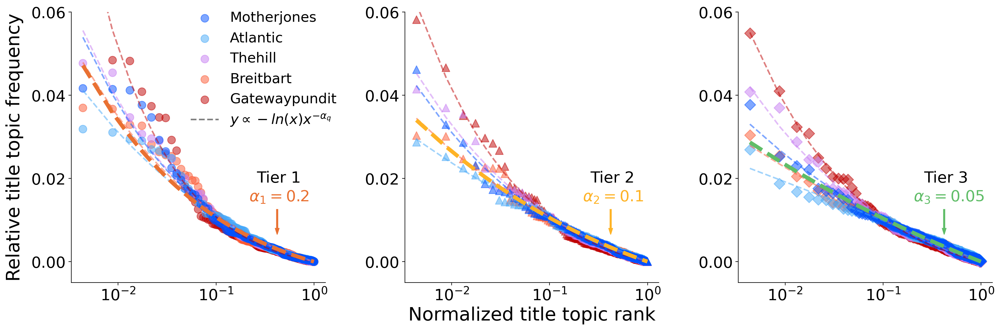

In [466]:
# individual ver.

fig, axes = plt.subplots(1, 3, figsize=(18, 6), dpi=200)
color_list = rb_color_list[::-1]
marker_list = marker_list = ['o', '^', 'D']

power_constant_list = [-0.2, -0.1, -0.05]
comp_color_list = orig_color_list

def model(x, a, b):
    return -b * np.log(x) * x**(a)

for rank in range(1, 4):
    line_list = []
    ax = axes[rank-1]
    for i, collection_name in enumerate(COLLECTION_NAMES):
        num_topics = NUM_TOPICS['global'] + 1
        x = np.arange(1, num_topics) / num_topics
        data = [title_topic_num_list_dict_dict[collection_name][i][:, rank-1] for i in range(len(title_topic_num_list_dict_dict[collection_name]))]
        sum_data = np.sum(data, axis=0)
        #line = ax.plot(x, np.sort(sum_data / np.sum(sum_data))[::-1], color=color_list[i], lw=4, label=collection_name)
        line = ax.scatter(x, np.sort(sum_data / np.sum(sum_data))[::-1], color=color_list[i], s=100, marker=marker_list[rank-1], alpha=0.5, label=collection_name)
        line_list.append(line)
    
        popt, pcov = curve_fit(model, x, np.sort(sum_data / np.sum(sum_data))[::-1], p0=[-0.2, 1])
        #plot fitting curve
        print(rank, collection_name, *popt)
        ax.plot(x, model(x, *popt), color=color_list[i], lw=2, ls='--', alpha=0.5)
        
    nlog = -np.log(x) * np.power(x, power_constant_list[rank-1])
    y = nlog / np.sum(nlog)
    ax.plot(x, y, color=comp_color_list[rank-1], lw=5, ls='--')

    ax.semilogx()
    if rank==2:
        ax.set_xlabel('Normalized title topic rank', fontsize=24)
    if rank==1:
        ax.set_ylabel('Relative title topic frequency', fontsize=24, labelpad=10)
    ax.set_yticks([0, 0.02, 0.04, 0.06, 0.08])
    ax.set_ylim([-0.005, 0.06])
    ax.spines[['right', 'top']].set_visible(False)
    ax.tick_params(which='minor', width=0, length=0)
    ax.tick_params(axis='both', labelsize=20)
    
    #ax.text(0.05, 0.05, f'Data', fontsize=20, transform=ax.transAxes)
    ax.text(0.73, 0.37, f'Tier {rank}', fontsize=20, transform=ax.transAxes)
    if rank==1:
        ax.text(0.7, 0.3, r'$\alpha_1=0.2$', fontsize=20, color=comp_color_list[rank-1], transform=ax.transAxes)
        custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto -ln(x)x^{-\alpha_q}$')
        line_list = line_list[::-1]
        line_list.append(custom_line)
        ax.legend(handles=line_list, fontsize=18, frameon=False, bbox_to_anchor=(0.42, 1.05))
    if rank==2:
        ax.text(0.7, 0.3, r'$\alpha_2=0.1$', fontsize=20, color=comp_color_list[rank-1], transform=ax.transAxes)
    if rank==3:
        ax.text(0.69, 0.3, r'$\alpha_3=0.05$', fontsize=20, color=comp_color_list[rank-1], transform=ax.transAxes)
        
    # draw a small straight downward arrow from the bottom of the text to the curve
    ax.arrow(0.81, 0.27, 0.0, -0.07, width=0.005, color=comp_color_list[rank-1], transform=ax.transAxes)
    #ax.set_facecolor([0, 0, 0, 0.05])
    # Create a custom line for the legend
    
plt.tight_layout()
plt.savefig("figure/fig2a.svg", format="svg", transparent=True)

In [41]:
for i, collection_name in enumerate(COLLECTION_NAMES):
    print(collection_name)

Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones


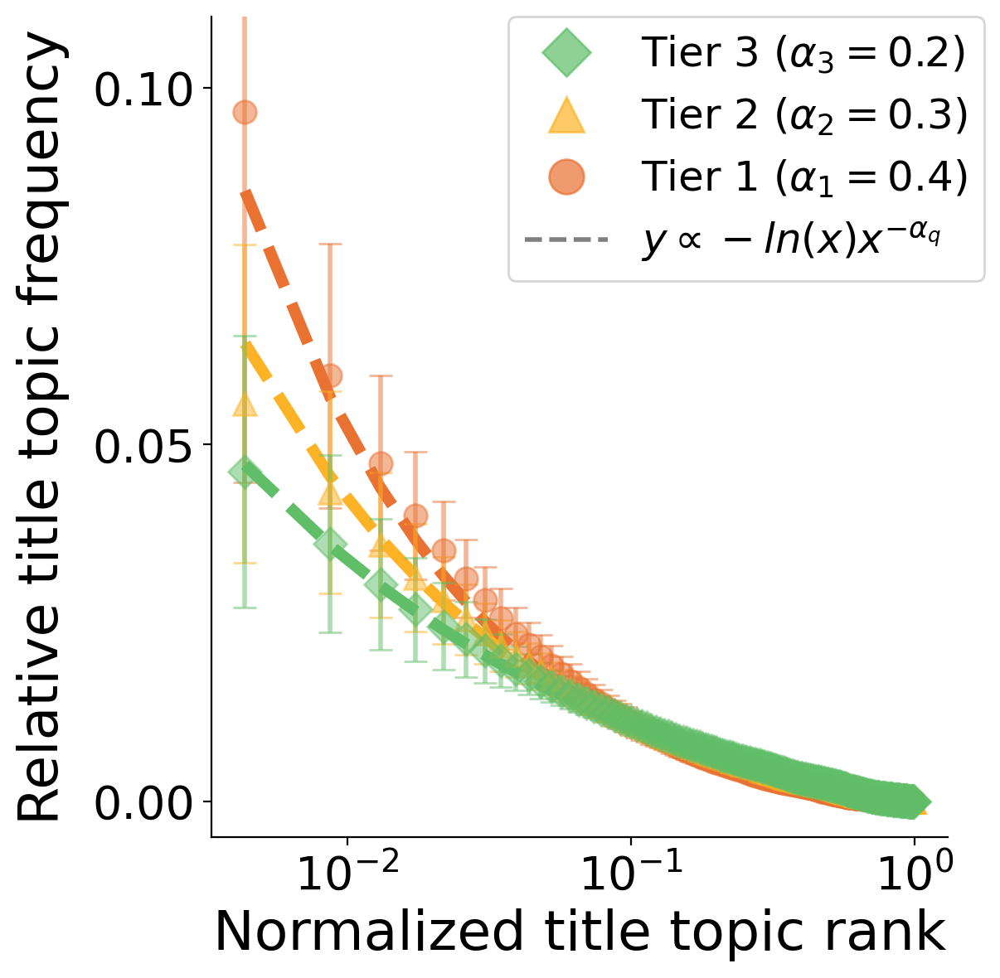

In [39]:
# average ver.

fig, ax = plt.subplots(1, 1, figsize=(6, 6), dpi=200)
color_list = orig_color_list
marker_list = marker_list = ['o', '^', 'D']
alpha_list = [0.4, 0.3, 0.2]
line_list = []

power_constant_list = [-0.4, -0.3, -0.2]
comp_color_list = orig_color_list

def model(x, a, b):
    return -b * np.log(x) * x**(a)

num_topics = NUM_TOPICS['global'] + 1
x = np.arange(1, num_topics) / num_topics

for rank in range(1, 4):
    
    data_list = []
    
    for i, collection_name in enumerate(COLLECTION_NAMES):
        
        data_list.append([title_topic_num_list_dict_dict[collection_name][i][:, rank-1] for i in range(len(title_topic_num_list_dict_dict[collection_name]))])
        
    data = np.vstack(data_list)
    data = data/np.sum(data, axis=1, keepdims=True)
    data = np.sort(data, axis=1)[..., ::-1]
    y = np.mean(data, axis=0)
    error = np.std(data, axis=0)
    ax.errorbar(x, y, yerr=error, color=color_list[rank-1], lw=2, fmt=marker_list[rank-1], capsize=5, markersize=10, alpha=0.5)
    line_list.append(Line2D([], [], marker=marker_list[rank-1], color='none', markerfacecolor=color_list[rank-1], markeredgecolor=color_list[rank-1], markersize=15, alpha=0.7, label=f'Tier {rank} $(\\alpha_{rank}={alpha_list[rank-1]})$'))

    #line = ax.scatter(x, np.sort(sum_data / np.sum(sum_data))[::-1], color=color_list[i], s=100, marker=marker_list[rank-1], alpha=0.5, label=collection_name)
    #line_list.append(line)
    
    
    #popt, pcov = curve_fit(model, x, np.sort(sum_data / np.sum(sum_data))[::-1], p0=[-0.2, 1])
    #plot fitting curve
    #print(rank, collection_name, *popt)
    #ax.plot(x, model(x, *popt), color=color_list[i], lw=2, ls='--', alpha=0.5)
        
    nlog = -np.log(x) * np.power(x, power_constant_list[rank-1])
    y = nlog / np.sum(nlog)
    ax.plot(x, y, color=comp_color_list[rank-1], lw=5, ls='--')

ax.semilogx()
ax.set_xlabel('Normalized title topic rank', fontsize=24)
ax.set_ylabel('Relative title topic frequency', fontsize=24, labelpad=10)
ax.set_yticks([0, 0.05, 0.10])
ax.set_ylim([-0.005, 0.11])
ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)
    
custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto -ln(x)x^{-\alpha_q}$')
line_list = line_list[::-1]
line_list.append(custom_line)
ax.legend(handles=line_list, fontsize=18, bbox_to_anchor=(0.375, 1.025))

plt.tight_layout()
#plt.savefig("figure/fig2a.svg", format="svg", transparent=True)

### 2b. Title topic frequency fitting (model)

In [467]:
model_type = 'simple'
filter_strength = 0.2
memory_strength = 0.9
target_topic = 25

topic_num = 250
time = 50

In [468]:
events_freq_list = []
filtered_events_freq_list = []

for r in range(10):
    print('repeat', r)
    sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV51_100_1.5_300_1.0_25_-1_t500_{r}'
    parameters, results = load_comp_model_result('5_trolls', model_type, sim_name)

    events_list_list = results['events_list']
    filtered_events_list_list = results['filtered_events_list_list']

    x = []

    for i in range(3):
        print('tier', i)
        x.append([])
        for d in range(1000):
            c = Counter(filtered_events_list_list[:time, d, :, i].flatten())
            for j in range(topic_num):
                if j not in c.keys():
                    c[j] = 0
            x[i].append(np.array(sorted(c.items()))[:, 1])
        
    filtered_events_freq_list.append(np.array(x)/(0.25*1000*time)) # filtered_event_num * time
    
filtered_events_freq_list = np.array(filtered_events_freq_list)
np.savez('figure/figure_data/fig2c.npz', filtered_events_freq_list=filtered_events_freq_list)

repeat 0


KeyboardInterrupt: 

In [469]:
results = np.load('figure/figure_data/fig2c.npz')
filtered_events_freq_list = results['filtered_events_freq_list']

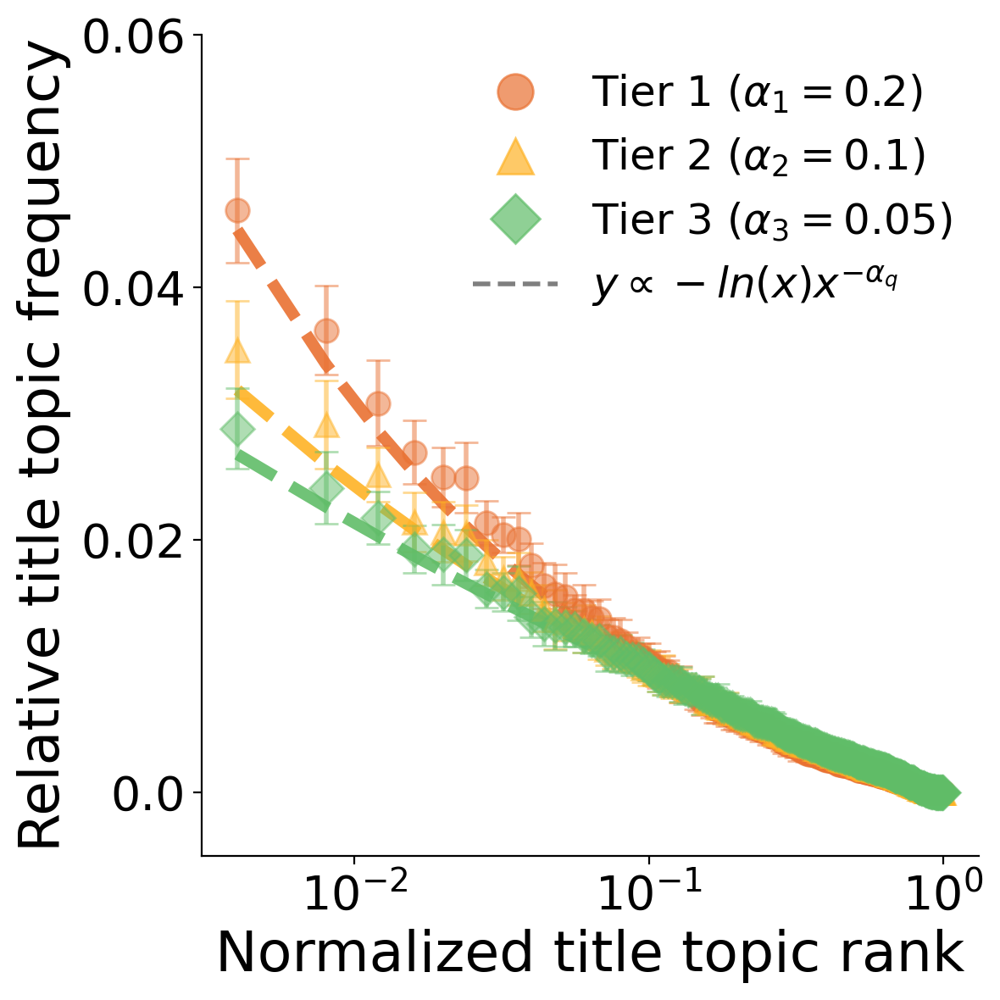

In [471]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6), dpi=200)
expected_power_constant_list = [-0.2, -0.1, -0.05]
x = np.arange(1, topic_num+1) / topic_num
color_list = orig_color_list
line_list = []

marker_list = ['o', '^', 'D']
alpha_list = [0.2, 0.1, 0.05]

for rank in range(1, 4):
    
    y = np.mean(filtered_events_freq_list[:, rank-1], axis=(0, 1))
    error = np.std(filtered_events_freq_list[:, rank-1], axis=(0, 1))
    #ax.scatter(x, np.sort(y)[::-1], c=color_list[rank-1], s=100, marker=marker_list[rank-1], alpha=0.5)
    ax.errorbar(x, np.sort(y)[::-1], yerr=error, color=color_list[rank-1], lw=2, label=f'Tier {rank} (filtered)', fmt=marker_list[rank-1], capsize=5, markersize=10, alpha=0.5)
    line_list.append(Line2D([], [], marker=marker_list[rank-1], color='none', markerfacecolor=color_list[rank-1], markeredgecolor=color_list[rank-1], markersize=15, alpha=0.7, label=f'Tier {rank} $(\\alpha_{rank}={alpha_list[rank-1]})$'))

    nlog = np.power(x, expected_power_constant_list[rank-1]) * -np.log(x)
    y = nlog / np.sum(nlog)
    ax.plot(x, y, color=color_list[rank-1], lw=5, ls='--', alpha=0.9)
    
    ax.semilogx()
    #ax.loglog()
    if rank==2:
        ax.set_xlabel('Normalized title topic rank', fontsize=24)
    if rank==1:
        ax.set_ylabel('Relative title topic frequency', fontsize=24)

    ax.set_yticks([0.0, 0.02, 0.04, 0.06])
    ax.set_yticklabels(['0.0', '0.02', '0.04', '0.06'], fontsize=20)

    ax.set_ylim([-0.005, 0.06])
    ax.spines[['right', 'top']].set_visible(False)
    ax.tick_params(which='minor', width=0, length=0)
    ax.tick_params(axis='both', labelsize=20)
    
#ax.text(0.05, 0.05, f'Model', fontsize=20, transform=ax.transAxes)    
custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto -ln(x)x^{-\alpha_q}$')
line_list.append(custom_line)

ax.legend(handles=line_list, frameon=False, fontsize=18, bbox_to_anchor=(0.3, 1.0))
plt.tight_layout()
plt.savefig("figure/fig2b.svg", format="svg", transparent=True)


In [41]:
# average version

folder_name = '0_sample'
model_type = 'simple'
filter_strength = 0.5
memory_strength = 0.9
comm_num = 1000
event_num = 1000

topic_num = 250
timestep = 120

sim_name = f'sim_T250_C{comm_num}_E{event_num}_ET3_F{filter_strength}_M{memory_strength}_ITplain_IF0.0_IV99_0_0.0_0_0.0_-1_-1_t{timestep}_1'
parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

comm_num = parameters['comm_num']
topic_num = parameters['topic_num']
raw_freq_list = results['raw_freq_list']
events_list_list = results['events_list']
filtered_events_list_list = results['filtered_events_list_list']
#weight_list = results['weight_list']

In [ ]:
time = 120

filtered_events_freq_list = []

x = []

for i in range(3):
    print('tier', i)
    x.append([])
    for d in range(1000):
        c = Counter(filtered_events_list_list[:time, d, :, i].flatten())
        for j in range(topic_num):
            if j not in c.keys():
                c[j] = 0
        x[i].append(np.array(sorted(c.items()))[:, 1])
    
filtered_events_freq_list.append(np.array(x)/(0.25*1000*time)) # filtered_event_num * time
filtered_events_freq_list = np.array(filtered_events_freq_list)

tier 0
tier 1
tier 2


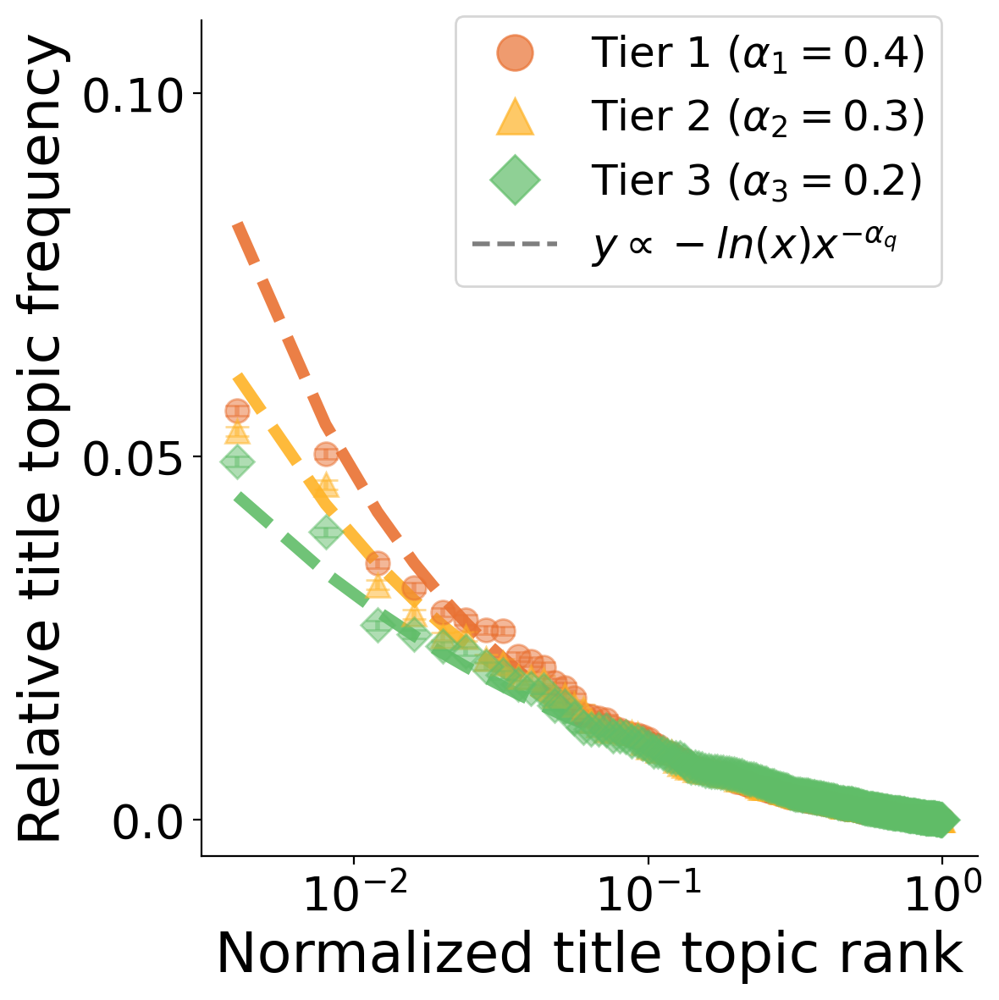

In [56]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6), dpi=200)
expected_power_constant_list = [-0.4, -0.3, -0.2]
x = np.arange(1, topic_num+1) / topic_num
color_list = orig_color_list
line_list = []

marker_list = ['o', '^', 'D']
alpha_list = [0.4, 0.3, 0.2]

for rank in range(1, 4):
    
    y = np.mean(filtered_events_freq_list[:, rank-1], axis=(0, 1))
    error = np.std(filtered_events_freq_list[:, rank-1], axis=(0, 1))
    #ax.scatter(x, np.sort(y)[::-1], c=color_list[rank-1], s=100, marker=marker_list[rank-1], alpha=0.5)
    ax.errorbar(x, np.sort(y)[::-1], yerr=error, color=color_list[rank-1], lw=2, label=f'Tier {rank} (filtered)', fmt=marker_list[rank-1], capsize=5, markersize=10, alpha=0.5)
    line_list.append(Line2D([], [], marker=marker_list[rank-1], color='none', markerfacecolor=color_list[rank-1], markeredgecolor=color_list[rank-1], markersize=15, alpha=0.7, label=f'Tier {rank} $(\\alpha_{rank}={alpha_list[rank-1]})$'))

    nlog = np.power(x, expected_power_constant_list[rank-1]) * -np.log(x)
    y = nlog / np.sum(nlog)
    ax.plot(x, y, color=color_list[rank-1], lw=5, ls='--', alpha=0.9)
    
    ax.semilogx()
    #ax.loglog()
    if rank==2:
        ax.set_xlabel('Normalized title topic rank', fontsize=24)
    if rank==1:
        ax.set_ylabel('Relative title topic frequency', fontsize=24)

    ax.set_yticks([0.0, 0.05, 0.10])
    ax.set_yticklabels(['0.0', '0.05', '0.10'], fontsize=20)

    ax.set_ylim([-0.005, 0.11])
    ax.spines[['right', 'top']].set_visible(False)
    ax.tick_params(which='minor', width=0, length=0)
    ax.tick_params(axis='both', labelsize=20)
    
#ax.text(0.05, 0.05, f'Model', fontsize=20, transform=ax.transAxes)    
custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto -ln(x)x^{-\alpha_q}$')
line_list.append(custom_line)

ax.legend(handles=line_list, fontsize=18, bbox_to_anchor=(0.3, 1.03))
plt.tight_layout()
#plt.savefig("figure/fig2b.svg", format="svg", transparent=True)

### 2c. Frequency distribution (data)

In [53]:
sorted_norm_topic_freq_dict = {}
for collection_name in COLLECTION_NAMES:

    file_names = os.listdir(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df'))
    keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))
    dates = [datetime.strptime(key, '%Y-%m-%d') for key in keys]

    topic_freq_list = []

    for key in keys:
        data = pd.read_parquet(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df', key+'.parquet'))
        topic_freq = data['topic_freq'].values[1:]
        topic_freq_list.append(topic_freq)

        
    topic_freq_list = np.sum(np.array(topic_freq_list), axis=0)
    sorted_topic_freq = np.sort(topic_freq_list)[::-1]
    sorted_norm_topic_freq = sorted_topic_freq / np.sum(sorted_topic_freq)
    
    sorted_norm_topic_freq_dict[collection_name] = sorted_norm_topic_freq

Gatewaypundit 1.0358527447981387 0.0007981191637648297
Breitbart 1.0203242960365246 0.0008288501300214316
Thehill 1.0892688176196335 0.000656753988503135
Atlantic 0.9664564218367228 0.0010658509156156255
Motherjones 1.0026093953710506 0.0009115248524242464


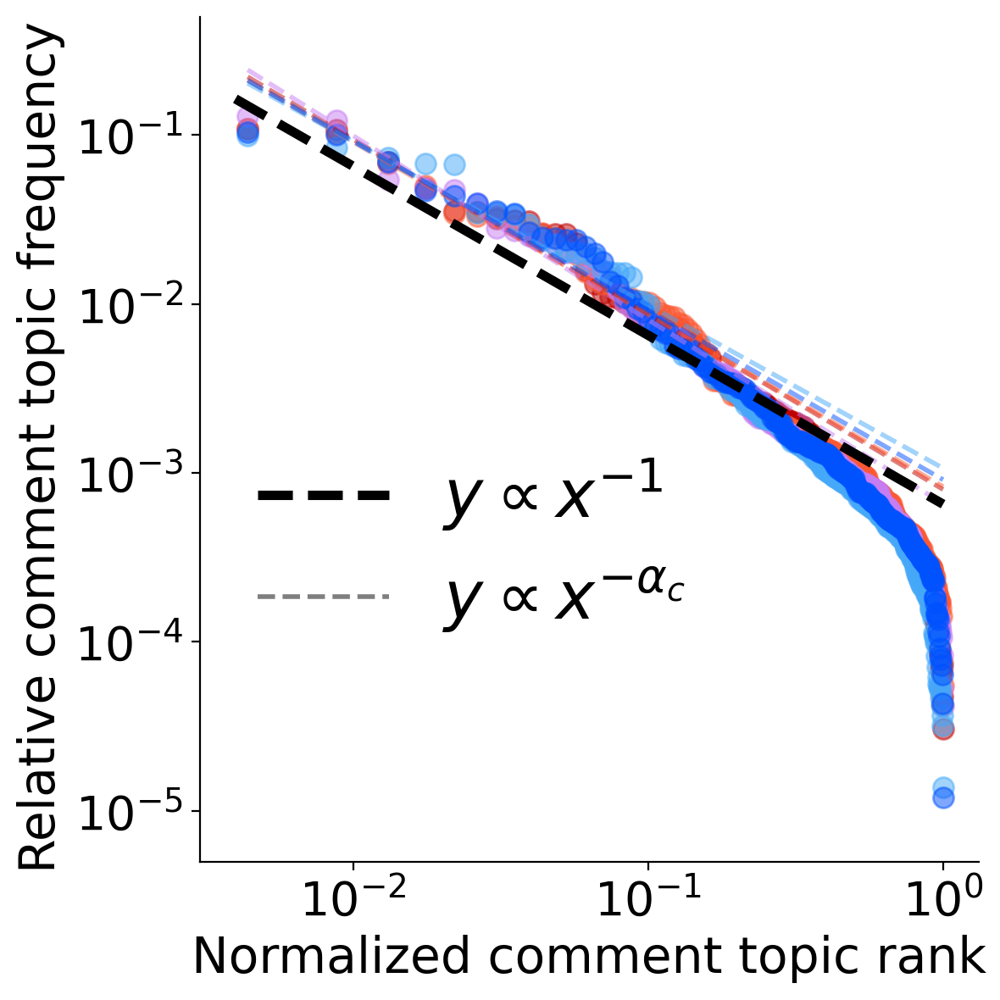

In [54]:

# Define the power-law model function
def func_power_law(x, a, b):
    return b * x**(-a)

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list[::-1]
line_list = []

for i, collection_name in enumerate(COLLECTION_NAMES):
    x = np.arange(1, NUM_TOPICS['global']+1)/ NUM_TOPICS['global']
    ax.scatter(x, sorted_norm_topic_freq_dict[collection_name], c=color_list[i], s=75, alpha=0.5, label=collection_name,zorder=i)
    
    # Fit the data to the power-law model
    popt, pcov = curve_fit(func_power_law, x[1:], sorted_norm_topic_freq_dict[collection_name][1:], p0=[1.0, 1.0])

    # Extract the optimal parameters
    a_opt, b_opt = popt
    print(collection_name, a_opt, b_opt)

    # Generate fitted values
    y_fit = func_power_law(x, a_opt, b_opt)

    ax.plot(x, y_fit, color=color_list[i], lw=2, ls='--', zorder=10, alpha=0.5)

x = np.arange(1, NUM_TOPICS['Gatewaypundit']+1)/ NUM_TOPICS['Gatewaypundit']
pdf, _ = power_law(alpha=1, xmax=NUM_TOPICS['Gatewaypundit'])

line = ax.plot(x, pdf, c='k', lw=4, ls='--', zorder=10, alpha=1, label=r'$y \propto x^{-1}$')
line_list.append(line[0])

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto x^{-\alpha_{c}}$')
line_list.append(custom_line)

ax.set_xlabel('Normalized comment topic rank', fontsize=21)
ax.set_ylabel('Relative comment topic frequency ', fontsize=21)
ax.spines[['right', 'top']].set_visible(False)
#ax.text(0.05, 0.05, f'Data', fontsize=20, transform=ax.transAxes)
ax.set_ylim(5e-6, 5e-1)

ax.legend(handles=line_list, frameon=False, bbox_to_anchor=(0.7, 0.55), fontsize=28)
ax.set_xscale('log')
ax.set_yscale('log')

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/fig2c.svg", format="svg", transparent=True)

### 2d. Frequency distribution (model)

In [6]:
folder_name = '0_sample'
model_type = 'simple'
filter_strength = 0.5
memory_strength = 0.9
comm_num = 1000
event_num = 1000

topic_num = 250
timestep = 120

In [ ]:
sim_name = f'sim_T250_C{comm_num}_E{event_num}_ET3_F{filter_strength}_M{memory_strength}_ITplain_IF0.0_IV99_0_0.0_0_0.0_-1_-1_t{timestep}_0'
parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

comm_num = parameters['comm_num']
topic_num = parameters['topic_num']
timestep = parameters['timestep']
raw_freq_list = results['raw_freq_list']

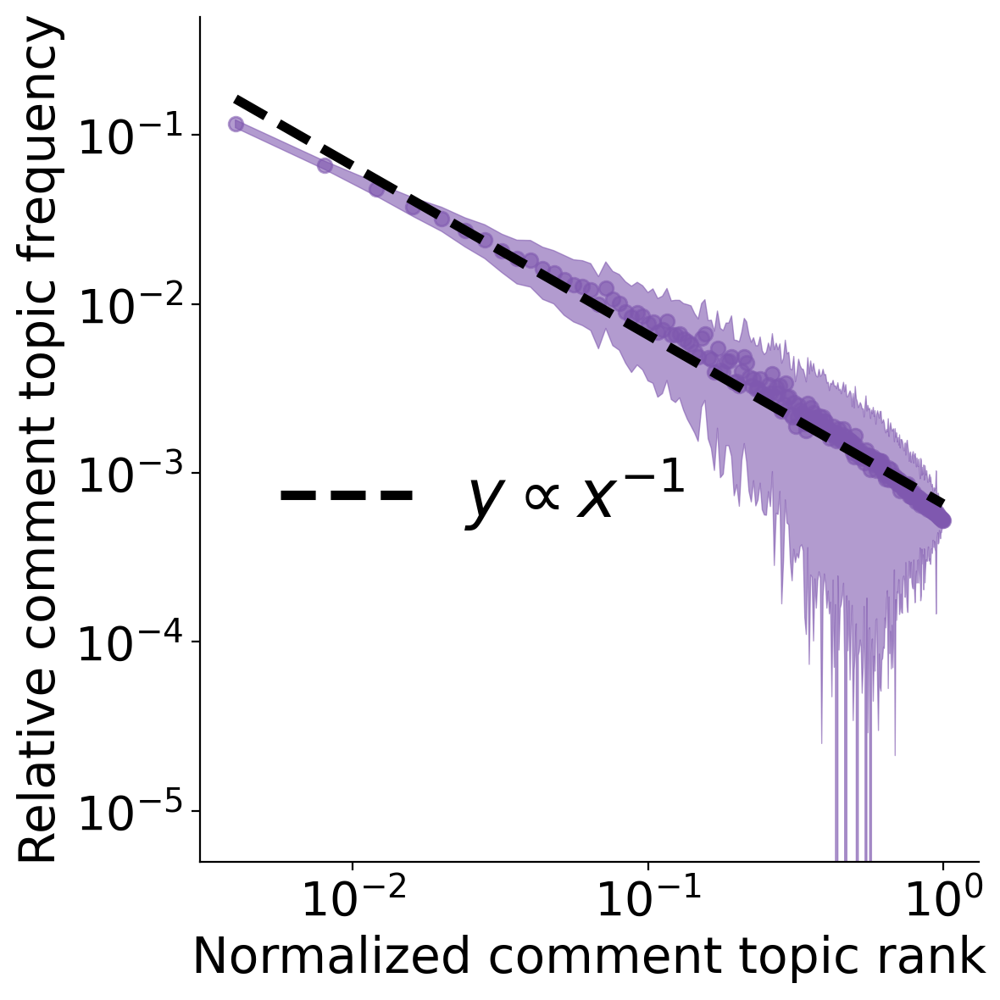

In [8]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6), dpi=200)
line_list = []

x = np.arange(1, topic_num+1)/topic_num

data = raw_freq_list.reshape(-1, topic_num)
data = data / np.sum(data, axis=1)[..., np.newaxis]
y = np.mean(data, axis=0)

errors = np.std(data, axis=0)
c = orig_color_list[4]

ax.scatter(x, y, color=c,alpha=0.6)
ax.fill_between(x, y - errors, y + errors, alpha=0.6, color=c, lw=0.5, ls='-')

pdf, _ = power_law(alpha=1, xmax=topic_num)
line = ax.plot(x, pdf, c='k', lw=4, ls='--', zorder=10, alpha=1, label=r'$y \propto x^{-1}$')
line_list.append(line[0])

#custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto x^{-\alpha_{c}}$')
#line_list.append(custom_line)

ax.set_xlabel('Normalized comment topic rank', fontsize=21)
ax.set_ylabel('Relative comment topic frequency', fontsize=21)

ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)
ax.legend(handles=line_list, frameon=False, bbox_to_anchor=(0.7, 0.55), fontsize=28)
#ax.text(0.05, 0.05, f'Model', fontsize=20, transform=ax.transAxes)
ax.set_ylim(5e-6, 5e-1)

ax.set_xscale('log')
ax.set_yscale('log')

plt.tight_layout()
plt.savefig("figure/fig2d.svg", format="svg", transparent=True)

### 2e. Similarity distribution (data)

In [45]:
hist_data_dict = {}
similarity_matrix_dict = {}

for collection_name in COLLECTION_NAMES:
    print(collection_name)
    num_topics = NUM_TOPICS['global']
    file_names = os.listdir(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df'))
    keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))

    total_embeddings = np.zeros((num_topics+1, 384))
    total_num = np.zeros((num_topics+1))

    for key in keys:
        data = pd.read_parquet(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df', key+'.parquet'))
        total_num += data['topic_freq'].values
        total_embeddings += data['topic_freq'].values.reshape(-1, 1) * np.vstack(data['topic_mean_embedding'].values)
        
    total_embeddings /= total_num.reshape(-1, 1)
    similarity_matrix = cosine_similarity(total_embeddings, total_embeddings)[1:, 1:]
    similarity_matrix_dict[collection_name] = similarity_matrix
    hist_data = similarity_matrix[np.triu_indices(num_topics, k = 1)]
    hist_data_dict[collection_name] = hist_data

Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones


In [46]:
total_min = 1
total_max = 0
for collection_name in COLLECTION_NAMES:
    total_min = min(total_min, np.min(hist_data_dict[collection_name]))
    total_max = max(total_max, np.max(hist_data_dict[collection_name]))
    
print(total_min, total_max)

-0.0597361382900597 0.9132498344098746


In [47]:
total_min, total_max = -2.5, 0.1

In [48]:
import numpy as np
from scipy.stats import lognorm

plot_dict = {}
fit_dict = {}

bins = np.logspace(total_min, total_max, 100)

for collection_name in COLLECTION_NAMES:
    a, b = np.histogram(hist_data_dict[collection_name], bins=bins, density=True)
    c = (b[1:] + b[:-1])/2
    lshape, lloc, lscale = stats.lognorm.fit(hist_data_dict[collection_name], loc=-0.5)
    
    plot_dict[collection_name] = (c, a)
    fit_dict[collection_name] = (lshape, lloc, lscale)
    
print(fit_dict)

/home/seungwoong.ha/miniconda3/envs/collmind/lib/python3.12/site-packages/scipy/stats/_continuous_distns.py:6902: RuntimeWarning:

invalid value encountered in log



{'Gatewaypundit': (np.float64(0.09476519393765351), np.float64(-0.8778297793046659), np.float64(1.2302498042578511)), 'Breitbart': (np.float64(0.1164205969273136), np.float64(-0.6514725626364142), np.float64(0.9941808669396839)), 'Thehill': (np.float64(0.09892862357462362), np.float64(-0.8294709453309608), np.float64(1.1806994238568627)), 'Atlantic': (np.float64(0.1322505384302049), np.float64(-0.6594519694842398), np.float64(0.9732617914002806)), 'Motherjones': (np.float64(0.13153919467877728), np.float64(-0.653450632245995), np.float64(0.9846153359227395))}


In [49]:
for i, collection_name in enumerate(COLLECTION_NAMES):
    print(collection_name, (hist_data_dict[collection_name]<0).mean())

Gatewaypundit 0.0011206430172347169
Breitbart 0.0005796429399489915
Thehill 0.0004637143519591931
Atlantic 0.0017389288198469742
Motherjones 0.0006569286652755236


<>:28: SyntaxWarning:

invalid escape sequence '\s'

<>:28: SyntaxWarning:

invalid escape sequence '\s'

/tmp/ipykernel_4159538/525241881.py:28: SyntaxWarning:

invalid escape sequence '\s'



0.09476519393765351 -0.8778297793046659 1.2302498042578511
0.1164205969273136 -0.6514725626364142 0.9941808669396839
0.09892862357462362 -0.8294709453309608 1.1806994238568627
0.1322505384302049 -0.6594519694842398 0.9732617914002806
0.13153919467877728 -0.653450632245995 0.9846153359227395


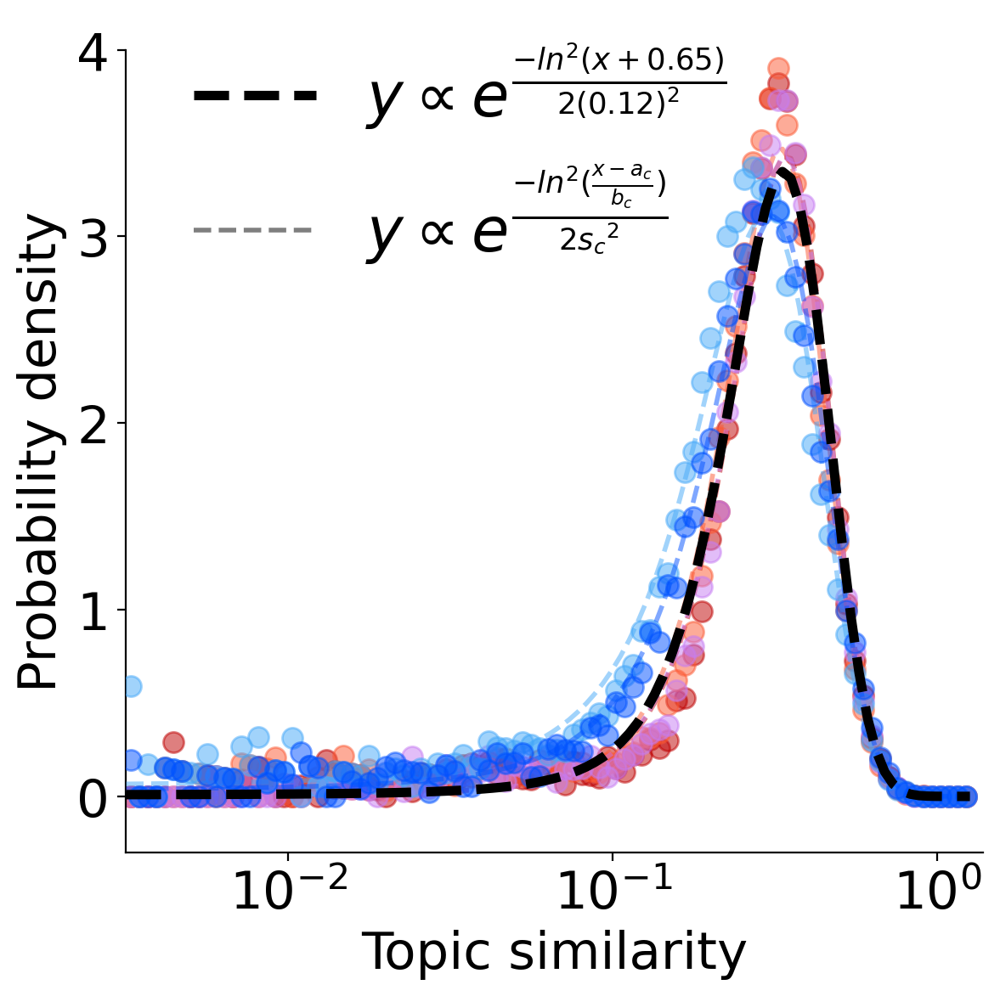

In [ ]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list[::-1]
line_list = []

fit_x = np.logspace(total_min, total_max, 100)

for i, collection_name in enumerate(COLLECTION_NAMES):
    x, y = plot_dict[collection_name]
    lshape, lloc, lscale = fit_dict[collection_name]
    print(lshape, lloc, lscale)
    fit_y = stats.lognorm.pdf(fit_x, lshape, loc=lloc, scale=lscale)
    ax.scatter(x, y, s=75, alpha=0.5, color=color_list[i], label=collection_name, zorder=i)
    #ax.plot(fit_x, fit_y, color='k', linewidth=1.5, label=f'{collection_name}: GN')
    ax.plot(fit_x, fit_y, color=color_list[i], ls='--', alpha=0.5, linewidth=2, zorder=i)
    #ax.fill_between(x, y, color=color_list[i], label=collection_name, alpha=0.2)
    

lshape, lloc, lscale = 0.12, -0.65, 1
fit_y = stats.lognorm.pdf(fit_x, lshape, loc=lloc, scale=lscale)
line = ax.plot(fit_x, fit_y, color='k', ls='--', alpha=1, lw=4, zorder=10, label=r'$y \propto e^{\frac{-ln^2(x+0.65)}{2(0.12)^2}}$')
line_list.append(line[0])

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto e^{\frac{-ln^2(\frac{x-a_c}{b_c})}{2{s_c}^2}}$')
line_list.append(custom_line)

'''
lshape, lloc, lscale = 0.12, -0.65, 1
fit_y = stats.lognorm.pdf(fit_x, lshape, loc=lloc, scale=lscale)
line = ax.plot(fit_x, fit_y, color='k', ls='--', alpha=1, lw=4, zorder=10, label=r'$y \sim \mathcal{L}\mathcal{N}(0.12, -0.65, 1))$')
line_list.append(line[0])

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \sim \mathcal{L}\mathcal{N}(s_c, a_c, b_c)$')
line_list.append(custom_line)
'''

ax.set_xlabel('Topic similarity', fontsize=22)
ax.set_ylabel('Probability density', fontsize=22)
ax.spines[['right', 'top']].set_visible(False)

ax.set_xlim(np.min(fit_x), np.max(fit_x)*1.1)
ax.set_ylim(-0.3, 4)
#ax.set_xticks(np.arange(0, 1.0, 0.5))

ax.set_xscale('log')

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)
ax.legend(handles=line_list, frameon=False, fontsize=26, loc=(0.05, 0.7))

'''
# make a inset top left corner
axins = inset_axes(ax, width="25%", height="20%", loc='upper left', bbox_to_anchor=(0.17, -0.05, 1, 1), bbox_transform=ax.transAxes)

for i, collection_name in enumerate(COLLECTION_NAMES):
    a, b = np.histogram(hist_data_dict[collection_name], bins=np.linspace(-0.15, 1, 30), density=True)
    axins.plot((b[1:] + b[:-1])/2, a, alpha=0.3, color=color_list[i], lw=2)

axins.axvline(x=0, color='k', ls='--', lw=1, alpha=0.5)
axins.set_xlabel('Topic sim.', fontsize=14)
axins.spines[['right', 'top', 'left']].set_visible(False)

axins.tick_params(which='minor', width=0, length=0)
axins.tick_params(axis='both', labelsize=12)
axins.set_yticks([])
axins.set_yticklabels([])
axins.set_xticks(np.arange(0, 1.1, 1.0))
'''

plt.tight_layout()
plt.savefig("figure/fig2e.svg", format="svg", transparent=True)
# shape loc scale

### 2f. similarity distribution (model)

In [25]:
folder_name = '0_sample'
model_type = 'simple'
filter_strength = 0.5
memory_strength = 0.9
comm_num = 1000
event_num = 1000

topic_num = 250
timestep = 120

sim_name = f'sim_T250_C{comm_num}_E{event_num}_ET3_F{filter_strength}_M{memory_strength}_ITplain_IF0.0_IV99_0_0.0_0_0.0_-1_-1_t{timestep}_0'
parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

comm_num = parameters['comm_num']
topic_num = parameters['topic_num']
raw_freq_list = results['raw_freq_list']
events_list_list = results['events_list']
filtered_events_list_list = results['filtered_events_list_list']
weight_list = results['weight_list']

In [26]:
y_list = []

bins = np.logspace(total_min, total_max, 100)

for t in range(120):
    y_list.append([])
    if t%10==0:
        print(t)
    for c in range(comm_num):
        y = np.histogram(weight_list[c, t][~np.eye(topic_num, dtype=bool)], bins=bins, density=True)
        y_list[t].append(y[0])
    
y_list = np.array(y_list)

0


10
20
30
40
50
60
70
80
90
100
110


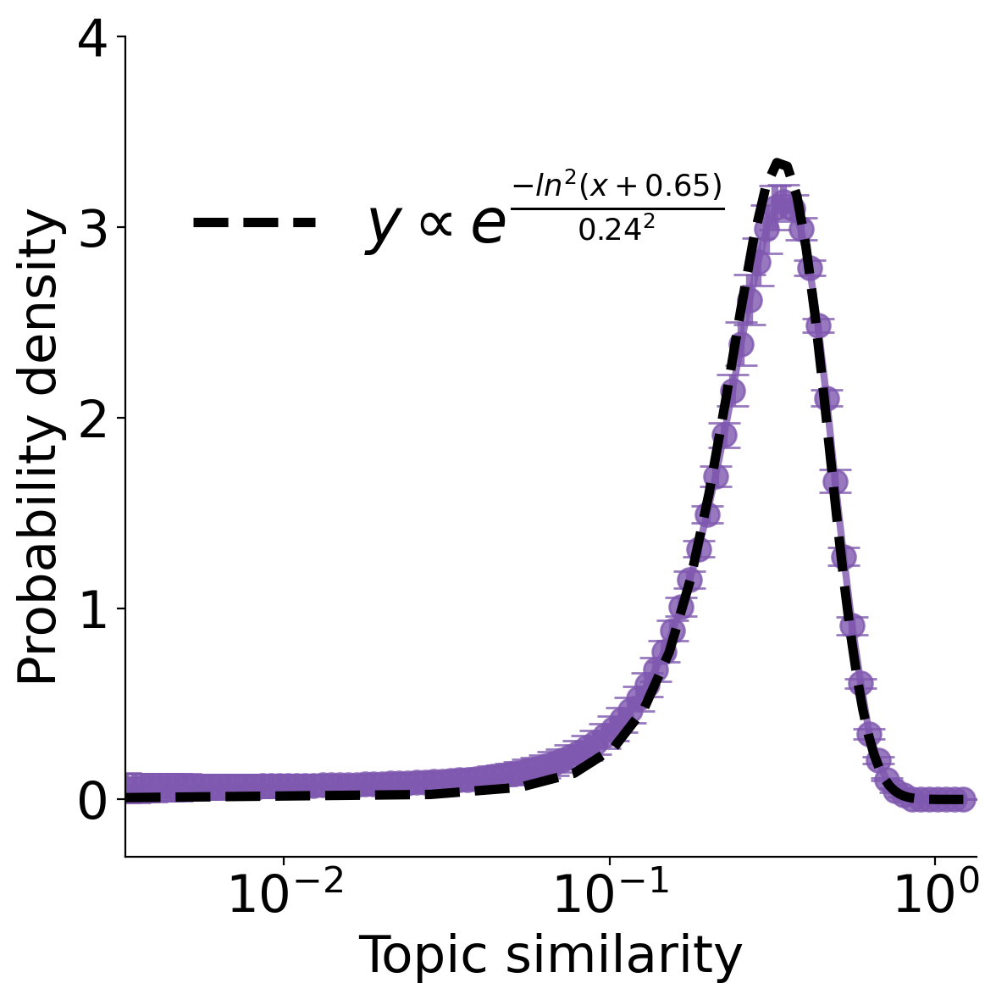

In [27]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list
line_list = []
c = orig_color_list[4]

x = (bins[:-1]+bins[1:])/2
y = np.mean(y_list.reshape(-1, 99), axis=0)
errors = np.std(y_list.reshape(-1, 99), axis=0)

#ax.scatter(x, y, color=c, alpha=1)
#ax.fill_between(x, y - errors, y + errors, alpha=0.6, color=c, lw=0.5, ls='-')
ax.errorbar(x, y, yerr=errors, color=c, marker='o', markersize=10, alpha=0.8, lw=3, capsize=7)

fit_x = np.linspace(min(x), max(x), 50)
lshape, lloc, lscale = 0.12, -0.65, 1
fit_y = stats.lognorm.pdf(fit_x, lshape, loc=lloc, scale=lscale)
line = ax.plot(fit_x, fit_y, color='k', ls='--', alpha=1, lw=4, zorder=10, label=r'$y \propto e^{\frac{-ln^2(x+0.65)}{0.24^2}}$')
line_list.append(line[0])

ax.set_xlabel('Topic similarity', fontsize=22)
ax.set_ylabel('Probability density', fontsize=22)
ax.spines[['right', 'top']].set_visible(False)

ax.set_xlim(np.min(fit_x), np.max(fit_x)*1.1)
ax.set_ylim(-0.3, 4)
#ax.set_xticks(np.arange(0, 1.0, 0.5))

ax.set_xscale('log')

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

ax.legend(handles=line_list, frameon=False, fontsize=26, loc=(0.05, 0.7))

plt.tight_layout()
plt.savefig("figure/fig2f.svg", format="svg", transparent=True)


## Figure 3. Model verification (phenomena)

### 3a. title topic frequency overview

#### 3a1. overview

In [56]:
#     [Vac, Cli, Gun, Abo]
# AT  [21, 30, 4, 24]
# BB  [14, 36, 9, 19]
# GW  [17, 26, 23, 38]
# MJ  [35, 3, 7, 10]
# TH  [2, 8, 19, 23]

special_topic_dict = {'Atlantic': [21, 30, 4, 24],
                      'Breitbart': [14, 36, 9, 19],
                      'Gatewaypundit': [17, 26, 23, 38],
                      'Motherjones': [35, 3, 7, 10],
                      'Thehill': [2, 8, 19, 23]}

special_topic_list = [16, 13, 24, 21]


In [57]:
title_topic_num_list_dict_dict = {}
for collection_name in COLLECTION_NAMES:
    print(collection_name)
    with open(join('/data', 'collmind', 'article_global', collection_name.lower(), 'result_dict.pkl'), 'rb') as f:
        result_dict = pickle.load(f)
    title_topic_num_list_dict_dict[collection_name] = result_dict['title_topic_num_list_dict']['month']

Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones


In [58]:
special_topic_dist_dict = {}
for collection_name in COLLECTION_NAMES:
    data = title_topic_num_list_dict_dict[collection_name]
    dist = []
    for i in range(len(data)):
        dist.append(data[i][special_topic_list][:, 0] / data[i][:, 0].sum())
    special_topic_dist_dict[collection_name] = np.array(dist)

/tmp/ipykernel_3977324/3332603440.py:3: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



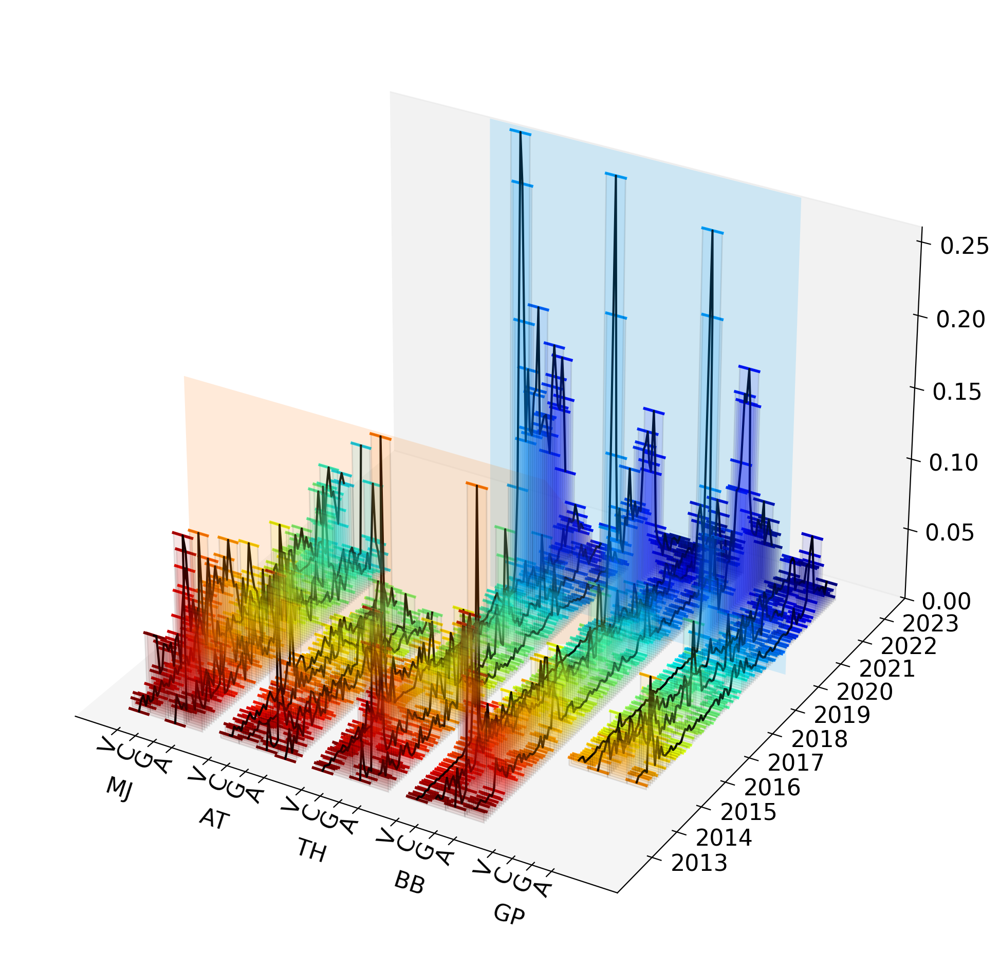

In [33]:
fig = plt.figure(figsize=(12, 12), dpi=200)
ax = fig.add_subplot(projection='3d')
cmap = cm.get_cmap('jet')
min_start_date = datetime(2012, 6, 1)
max_end_date = datetime(2023, 4, 1)
total_months = (max_end_date.year - min_start_date.year) * 12 + max_end_date.month - min_start_date.month

x = np.arange(4)
jump = 5
width = 0.5

for c, collection_name in enumerate(COLLECTION_NAMES[::-1]):
    start_date, end_date = DATE_RANGES[collection_name]
    dist_list = special_topic_dist_dict[collection_name]
    
    bold_edge_list = np.array([0, width, width*2, width*3]) + width*jump*c
    time_edge_list = np.array([width*0.5, width*1.5, width*2.5, width*3.5]) + width*jump*c
    time_edge_expand_list = [np.ones(len(dist_list))*x for x in time_edge_list]
    
    offset = MONTH_OFFSET[collection_name]
    
    for i in range(len(dist_list)):
        data = dist_list[i]
        color = cmap((total_months-(i+offset)) / total_months)
        position = np.array([width*0.5, width*1.5, width*2.5, width*3.5]) + width*jump*c
        ax.bar(position, data, zs=i+offset, zdir='y', color=color, alpha=0.1, edgecolor=(0, 0, 0, 1.0), linewidth=1, width=width)
        #ax.scatter(time_edge_list, data, zs=i+offset, zdir='y', color=color, s=10)
        for j in range(4):
            ax.plot([bold_edge_list[j], bold_edge_list[j]+width], [data[j], data[j]], zs=i+offset, zdir='y', color=color, linewidth=2)
            
    for i in range(4):
        ax.plot(time_edge_expand_list[i], np.arange(len(dist_list))+offset, dist_list[:, i], color='k', linewidth=1.5)


ax.add_collection3d(mpl_toolkits.mplot3d.art3d.Poly3DCollection(np.array([[[0, 28, 0], [0, 28, 0.195], [9.5, 28, 0.195], [9.5, 92, 0]]]), 
                                               facecolors=cmap((total_months-28) / total_months), alpha=0.15))

ax.add_collection3d(mpl_toolkits.mplot3d.art3d.Poly3DCollection(np.array([[[4.5, 92, 0], [4.5, 92, 0.325], [12.5, 92, 0.325], [12.5, 92, 0]]]), 
                                               facecolors=cmap((total_months-92) / total_months), alpha=0.15))


ax.set_xlabel('MJ          AT          TH          BB          GP', labelpad=5, fontsize=16)
#ax.set_ylabel('Date', labelpad=30, fontsize=24)
#ax.set_zlabel('Relative title topic frequency', rotation=-45, labelpad=25, fontsize=24)

# Set x-labels
position_list = np.array([np.array([width*0.5, width*1.5, width*2.5, width*3.5]) + width*jump*c for c in range(5)]).flatten()
ax.set_xticks(position_list)
ax.set_xticklabels(['V', 'C', 'G', 'A'] * 5, rotation=65, rotation_mode='anchor', verticalalignment='center', horizontalalignment='right', fontsize=16)


'''
diff_color_list = ['#FF7373', '#F5B932', '#216936', '#0080ff']

for i in range(5):
    for j in range(4):
        ax.get_xticklabels()[i*4+j].set_color(diff_color_list[j])
'''
ax.xaxis.set_tick_params(pad=-3)


#sec = ax.secondary_xaxis(0.5)
#sec.set_xticks([width*2 + width*jump*c for c in range(5)], labels=[f'\n\n{collection_name}' for collection_name in COLLECTION_NAMES])
#sec.tick_params('x', length=0)

# lines between the classes:
#sec2 = ax.secondary_xaxis(location=0)
#sec2.set_xticks([-0.5, 2.5, 4.5, 8.5], labels=[])
#sec2.tick_params('x', length=40, width=1.5)
#ax.set_xlim(-0.6, 8.6)

yticks, yticklabels = date_label(min_start_date, max_end_date)
ax.set_yticks(yticks, yticklabels, rotation=0, rotation_mode='anchor', verticalalignment='bottom',horizontalalignment='left', fontsize=16)

ax.set_zticks(np.arange(0, 0.26, 0.05), [f'{a:.2f}' for a in np.arange(0, 0.26, 0.05)], fontsize=16)
ax.tick_params(axis='z', which='major', pad=10)

# Remove grid
ax.grid(False)

# Remove background color
ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
#ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
#ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))

ax.set_box_aspect((50, 50, 35))
ax.set_zlim(0.0, 0.26)
# Set the camera angle
ax.view_init(elev=30, azim=-60)

#plt.tight_layout()
plt.savefig("figure/fig3a1.svg", format="svg", transparent=True)

#### 3a2. Covid (data)

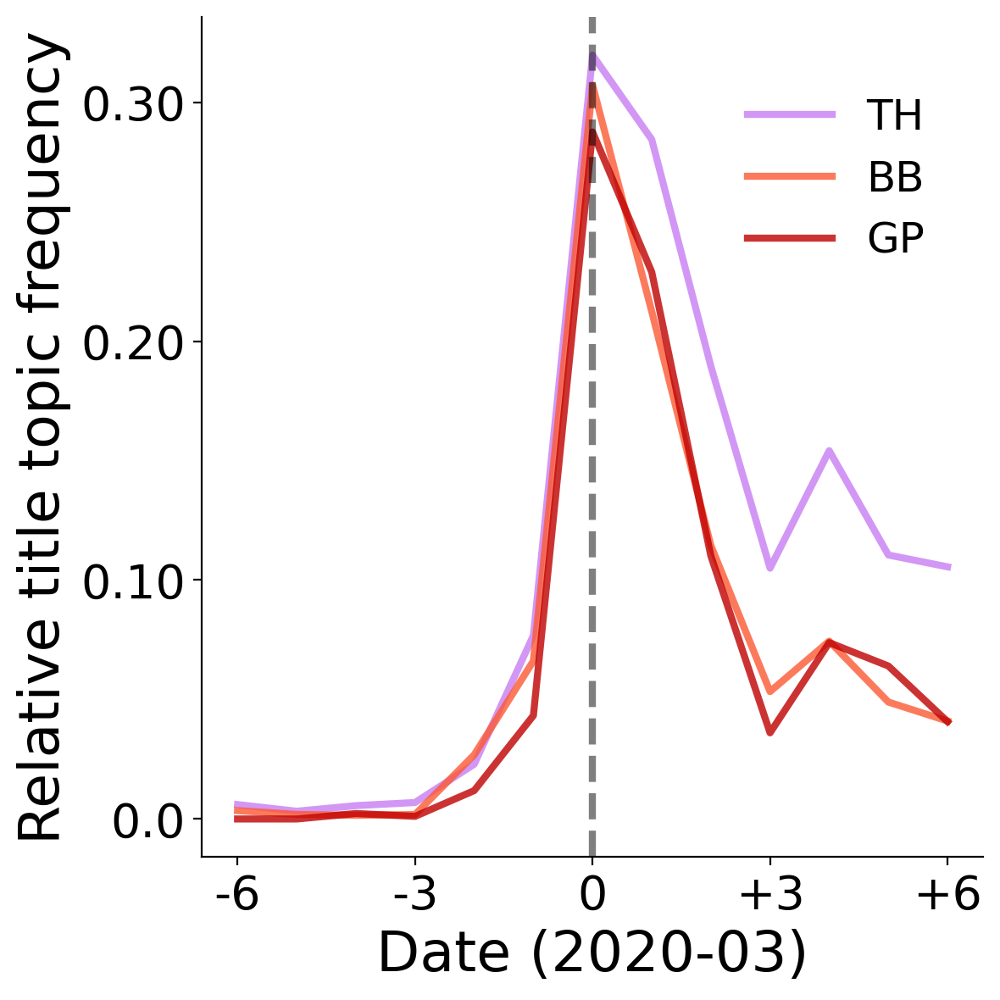

In [59]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot()

covid = 93
label_list = ['TH', 'BB', 'GP', ]
c_list = [2, 1, 0]
color_list = rb_color_list[::-1]

for c, collection_name in enumerate(['Thehill', 'Breitbart', 'Gatewaypundit']):
    start_date, end_date = DATE_RANGES[collection_name]
    dist_list = special_topic_dist_dict[collection_name]
    data = dist_list[:, 0]
    offset = MONTH_OFFSET[collection_name]
    ax.plot(np.arange(-6, +7), data[covid-offset-6:covid-offset+7], c=color_list[c_list[c]], label=label_list[c], alpha=0.8, lw=3)
    
ax.set_xlabel('Date (2020-03)', fontsize=24)
ax.set_xticks([-6, -3, 0, 3, 6])
ax.set_xticklabels(['-6', '-3', '0', '+3', '+6' ], fontsize=24)
ax.set_ylabel('Relative title topic frequency', fontsize=24)
ax.set_yticks([0.0, 0.1, 0.2, 0.3])
ax.set_yticklabels(['0.0', '0.10', '0.20', '0.30'], fontsize=24)
ax.axvline(0, color='k', linestyle='--', alpha=0.5, lw=3)

#ax.text(0.05, 0.15, f'Data', fontsize=22, transform=ax.transAxes)   

ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)
ax.legend(frameon=False, fontsize=18, bbox_to_anchor=(0.65, 0.95))

plt.tight_layout()

plt.savefig("figure/fig3a2.svg", format="svg", transparent=True)

#### 3a3. Ebola (data)

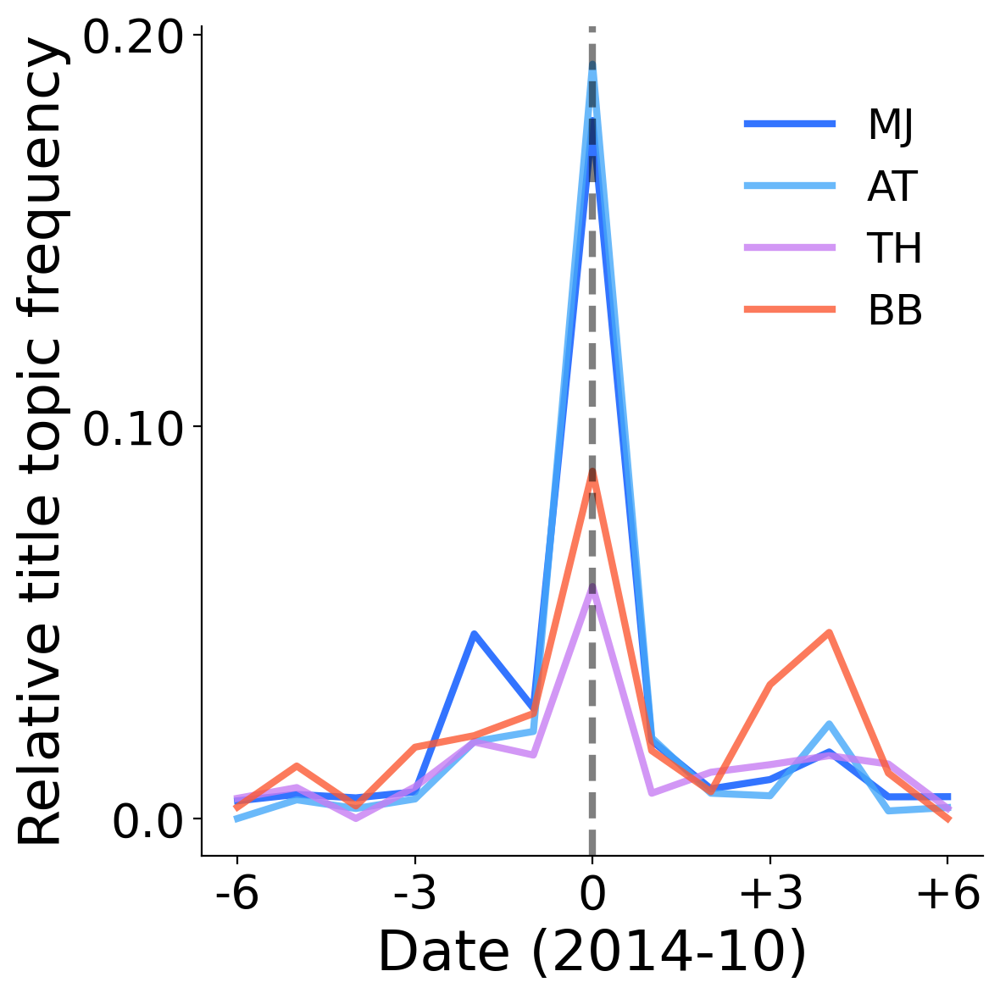

In [60]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot()

ebola = 28
label_list = ['MJ', 'AT', 'TH', 'BB']
c_list = [4, 3, 2, 1]
color_list = rb_color_list[::-1]

for c, collection_name in enumerate(['Breitbart', 'Thehill', 'Atlantic', 'Motherjones']):
    start_date, end_date = DATE_RANGES[collection_name]
    dist_list = special_topic_dist_dict[collection_name]
    data = dist_list[:, 0]
    offset = MONTH_OFFSET[collection_name]
    ax.plot(np.arange(-6, +7), data[ebola-offset-6:ebola-offset+7], c=color_list[c_list[c]], label=label_list[c], alpha=0.8, lw=3)
    
ax.set_xlabel('Date (2014-10)', fontsize=24)
ax.set_xticks([-6, -3, 0, 3, 6])
ax.set_xticklabels(['-6', '-3', '0', '+3', '+6' ], fontsize=24)
ax.set_ylabel('Relative title topic frequency', fontsize=24)
ax.set_yticks([0.0, 0.1, 0.2])
ax.set_yticklabels(['0.0', '0.10', '0.20'], fontsize=24)

#ax.text(0.05, 0.15, f'Data', fontsize=22, transform=ax.transAxes)
ax.axvline(0, color='k', linestyle='--', alpha=0.5, lw=3)

ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)
ax.legend(frameon=False, fontsize=18, bbox_to_anchor=(0.65, 0.95))
plt.tight_layout()

plt.savefig("figure/fig3a3.svg", format="svg", transparent=True)

### 3b. Title topic frequency (model)

#### 3b1. Covid (model)

In [ ]:
folder_name = '0_pred2'
model_type = 'simple'

topic_num = 250
comm_num = 1000
event_num = 10000
timestep = 13

iv_t1 = 6
iv_s1 = 32.0
iv_t2  = 7
iv_s2 = 2.0
iv_rank = 16

init_type = 'fixed'
init_freq_std = 0.0

memory_filter_list = [(0.9, 0.1), (0.9, 0.3), (0.9, 0.5), (0.9, 0.8), (0.9, 0.9), (0.9, 0.95), (0.9, 0.99)]

event_freq_list = []
filtered_event_freq_list = []
tier = 0

desc_range = range(10)

for memory_strength, filter_strength in memory_filter_list:
        
    tmp_event_freq_list = []
    tmp_filtered_event_freq_list = []
    
    for i in desc_range:
        print(filter_strength, memory_strength, i)
        sim_name = f'sim_T250_C{comm_num}_E{event_num}_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV02_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{iv_rank}_-1_t{timestep}_{i}'
        parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

        comm_num = parameters['comm_num']
        events_list_list = results['events_list']
        filtered_events_list_list = results['filtered_events_list_list']
        
        for j in range(comm_num):
            event_freq = np.array([Counter(events_list_list[t][:, tier])[iv_rank]for t in range(timestep)])
            tmp_event_freq_list.append(event_freq)
        
            filtered_event_freq = np.array([Counter(filtered_events_list_list[t][j, :, tier])[iv_rank]for t in range(timestep)])
            tmp_filtered_event_freq_list.append(filtered_event_freq)

    event_freq_list.append(tmp_event_freq_list)
    filtered_event_freq_list.append(tmp_filtered_event_freq_list)
    
np.savez('figure/figure_data/fig3b1.npz', event_freq_list=event_freq_list, filtered_event_freq_list=filtered_event_freq_list)

0.1 0.9 0
0.1 0.9 1
0.1 0.9 2
0.1 0.9 3
0.1 0.9 4
0.1 0.9 5
0.1 0.9 6
0.1 0.9 7
0.1 0.9 8
0.1 0.9 9
0.3 0.9 0
0.3 0.9 1
0.3 0.9 2
0.3 0.9 3
0.3 0.9 4
0.3 0.9 5
0.3 0.9 6
0.3 0.9 7
0.3 0.9 8
0.3 0.9 9
0.5 0.9 0
0.5 0.9 1
0.5 0.9 2
0.5 0.9 3
0.5 0.9 4
0.5 0.9 5
0.5 0.9 6
0.5 0.9 7
0.5 0.9 8
0.5 0.9 9
0.8 0.9 0
0.8 0.9 1
0.8 0.9 2
0.8 0.9 3
0.8 0.9 4
0.8 0.9 5
0.8 0.9 6
0.8 0.9 7
0.8 0.9 8
0.8 0.9 9
0.9 0.9 0
0.9 0.9 1
0.9 0.9 2
0.9 0.9 3
0.9 0.9 4
0.9 0.9 5
0.9 0.9 6
0.9 0.9 7
0.9 0.9 8
0.9 0.9 9
0.95 0.9 0
0.95 0.9 1
0.95 0.9 2
0.95 0.9 3
0.95 0.9 4
0.95 0.9 5
0.95 0.9 6
0.95 0.9 7
0.95 0.9 8
0.95 0.9 9
0.99 0.9 0
0.99 0.9 1
0.99 0.9 2
0.99 0.9 3
0.99 0.9 4
0.99 0.9 5
0.99 0.9 6
0.99 0.9 7
0.99 0.9 8
0.99 0.9 9


In [456]:
results = np.load('figure/figure_data/fig3b1.npz')
event_freq_list = results['event_freq_list']
filtered_event_freq_list = results['filtered_event_freq_list']
memory_filter_list = [(0.9, 0.1), (0.9, 0.3), (0.9, 0.5), (0.9, 0.8), (0.9, 0.9), (0.9, 0.95), (0.9, 0.99)]

0 0
1 2
2 3
3 4
4 6


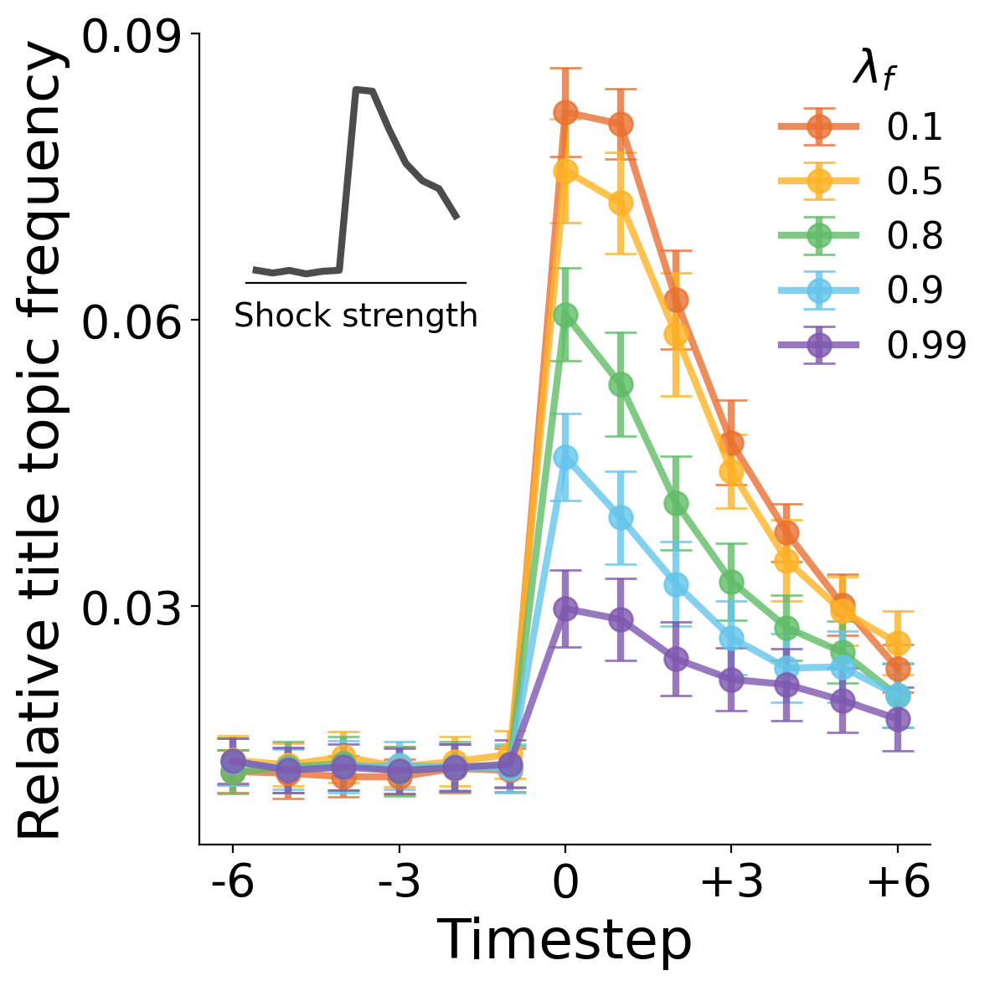

In [457]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6), dpi=200)

take = [0, 2, 3, 4, 6]

for n, i in enumerate(take):
    print(n, i)
    data = np.array(filtered_event_freq_list[i])/(0.25*10000)
    ax.errorbar(np.arange(-6, 7), np.mean(data, axis=0), yerr=np.std(data, axis=0), marker='o', markersize=10, alpha=0.8, label=f'{memory_filter_list[i][1]}', color=orig_color_list[n], lw=3, capsize=7)

ax.legend()
ax.spines[['right', 'top']].set_visible(False)

ax.set_xlabel('Timestep', fontsize=24)
ax.set_xticks([-6, -3, 0, 3, 6])
ax.set_xticklabels(['-6', '-3', '0', '+3', '+6' ], fontsize=24)
ax.set_ylabel('Relative title topic frequency', fontsize=24)
ax.set_yticks([0.0, 0.03, 0.06, 0.09])
ax.set_yticklabels(['0.0', '0.03', '0.06', '0.09'], fontsize=24)
ax.set_ylim(0.005, 0.09)

ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)
ax.legend(title=r'$\lambda_f$',title_fontsize='20', frameon=False, fontsize=16, bbox_to_anchor=(0.75, 0.55))
#ax.text(0.05, 0.17, f'Model', fontsize=20, transform=ax.transAxes)

# make a inset top left corner
axins = inset_axes(ax, width="30%", height="25%", loc='upper left', borderpad=2)

data = np.mean(event_freq_list, axis=(0, 1))/event_num
axins.plot(np.arange(13), data, alpha=0.7, color='k', lw=3)

axins.set_xlabel('Shock strength', fontsize=14)
axins.spines[['right', 'top', 'left']].set_visible(False)
axins.tick_params(axis='both', which='both', length=0)
axins.set_xticklabels([])
axins.set_yticklabels([])

plt.tight_layout()
plt.savefig("figure/fig3b1.svg", format="svg", transparent=True)

#### 2d2. Ebola (model)

In [ ]:
folder_name = '0_pred1'
model_type = 'simple'

topic_num = 250
comm_num = 1000
event_num = 10000
timestep = 13

iv_t1 = 6
iv_s1 = 32.0
iv_t2  = 7
iv_s2 = 2.0
iv_rank = 16

init_type = 'fixed'
init_freq_std = 0.0

memory_filter_list = [(0.9, 0.1), (0.9, 0.3), (0.9, 0.5), (0.9, 0.8), (0.9, 0.9), (0.9, 0.95), (0.9, 0.99)]

event_freq_list = []
filtered_event_freq_list = []
tier = 0

desc_range = range(10)

for memory_strength, filter_strength in memory_filter_list:
        
    tmp_event_freq_list = []
    tmp_filtered_event_freq_list = []
    
    for i in desc_range:
        print(filter_strength, memory_strength, i)
        sim_name = f'sim_T250_C{comm_num}_E{event_num}_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV01_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{iv_rank}_-1_t{timestep}_{i}'
        parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

        comm_num = parameters['comm_num']
        events_list_list = results['events_list']
        filtered_events_list_list = results['filtered_events_list_list']
        
        for j in range(comm_num):
            event_freq = np.array([Counter(events_list_list[t][:, tier])[iv_rank]for t in range(timestep)])
            tmp_event_freq_list.append(event_freq)
        
            filtered_event_freq = np.array([Counter(filtered_events_list_list[t][j, :, tier])[iv_rank]for t in range(timestep)])
            tmp_filtered_event_freq_list.append(filtered_event_freq)

    event_freq_list.append(tmp_event_freq_list)
    filtered_event_freq_list.append(tmp_filtered_event_freq_list)
    
np.savez('figure/figure_data/fig3b2.npz', event_freq_list=event_freq_list, filtered_event_freq_list=filtered_event_freq_list)

0.0 0.9 0
0.0 0.9 1
0.0 0.9 2
0.0 0.9 3
0.0 0.9 4
0.0 0.9 5
0.0 0.9 6
0.0 0.9 7
0.0 0.9 8
0.0 0.9 9
0.1 0.9 0
0.1 0.9 1
0.1 0.9 2
0.1 0.9 3
0.1 0.9 4
0.1 0.9 5
0.1 0.9 6
0.1 0.9 7
0.1 0.9 8
0.1 0.9 9
0.3 0.9 0
0.3 0.9 1
0.3 0.9 2
0.3 0.9 3
0.3 0.9 4
0.3 0.9 5
0.3 0.9 6
0.3 0.9 7
0.3 0.9 8
0.3 0.9 9
0.5 0.9 0
0.5 0.9 1
0.5 0.9 2
0.5 0.9 3
0.5 0.9 4
0.5 0.9 5
0.5 0.9 6
0.5 0.9 7
0.5 0.9 8
0.5 0.9 9
0.7 0.9 0
0.7 0.9 1
0.7 0.9 2
0.7 0.9 3
0.7 0.9 4
0.7 0.9 5
0.7 0.9 6
0.7 0.9 7
0.7 0.9 8
0.7 0.9 9
0.8 0.9 0
0.8 0.9 1
0.8 0.9 2
0.8 0.9 3
0.8 0.9 4
0.8 0.9 5
0.8 0.9 6
0.8 0.9 7
0.8 0.9 8
0.8 0.9 9
0.9 0.9 0
0.9 0.9 1
0.9 0.9 2
0.9 0.9 3
0.9 0.9 4
0.9 0.9 5
0.9 0.9 6
0.9 0.9 7
0.9 0.9 8
0.9 0.9 9
0.95 0.9 0
0.95 0.9 1
0.95 0.9 2
0.95 0.9 3
0.95 0.9 4
0.95 0.9 5
0.95 0.9 6
0.95 0.9 7
0.95 0.9 8
0.95 0.9 9
0.99 0.9 0
0.99 0.9 1
0.99 0.9 2
0.99 0.9 3
0.99 0.9 4
0.99 0.9 5
0.99 0.9 6
0.99 0.9 7
0.99 0.9 8
0.99 0.9 9


In [458]:
results = np.load('figure/figure_data/fig3b2.npz')
event_freq_list = results['event_freq_list']
filtered_event_freq_list = results['filtered_event_freq_list']
memory_filter_list = [(0.9, 0.1), (0.9, 0.3), (0.9, 0.5), (0.9, 0.8), (0.9, 0.9), (0.9, 0.95), (0.9, 0.99)]


0 0
1 2
2 3
3 4
4 6


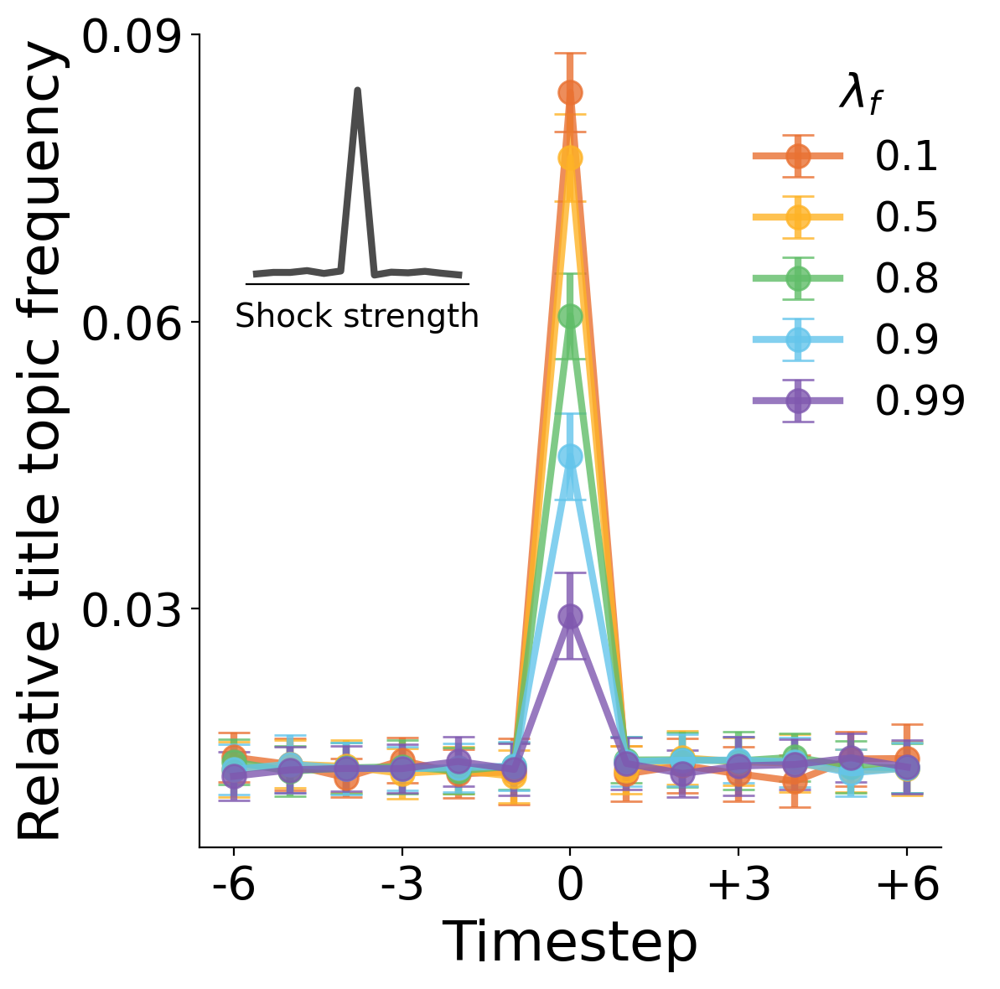

In [461]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6), dpi=200)

take = [0, 2, 3, 4, 6]

for n, i in enumerate(take):
    print(n, i)
    data = np.array(filtered_event_freq_list[i])/(0.25*10000)
    ax.errorbar(np.arange(-6, 7), np.mean(data, axis=0), yerr=np.std(data, axis=0), marker='o', markersize=10, alpha=0.8, label=f'{memory_filter_list[i][1]}', color=orig_color_list[n], lw=3, capsize=7)

ax.legend()
ax.spines[['right', 'top']].set_visible(False)

ax.set_xlabel('Timestep', fontsize=24)
ax.set_xticks([-6, -3, 0, 3, 6])
ax.set_xticklabels(['-6', '-3', '0', '+3', '+6' ], fontsize=24)
ax.set_ylabel('Relative title topic frequency', fontsize=24)
ax.set_yticks([0.0, 0.03, 0.06, 0.09])
ax.set_yticklabels(['0.0', '0.03', '0.06', '0.09'], fontsize=24)
ax.set_ylim(0.005, 0.09)

ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)
ax.legend(title=r'$\lambda_f$',title_fontsize='20', frameon=False, fontsize=18, bbox_to_anchor=(0.7, 1))
#ax.text(0.05, 0.17, f'Model', fontsize=20, transform=ax.transAxes)

# make a inset top left corner
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
axins = inset_axes(ax, width="30%", height="25%", loc='upper left', borderpad=2)

data = np.mean(event_freq_list, axis=(0, 1))/event_num
axins.plot(np.arange(13), data, alpha=0.7, color='k', lw=3)

axins.set_xlabel('Shock strength', fontsize=14)
axins.spines[['right', 'top', 'left']].set_visible(False)
axins.tick_params(axis='both', which='both', length=0)
axins.set_xticklabels([])
axins.set_yticklabels([])

plt.tight_layout()

plt.savefig("figure/fig3b2.svg", format="svg", transparent=True)

### 3c. Frequency behavior (data)

In [508]:
collection_name = 'Thehill'
model_name = MODEL_NAMES['global']
num_topics = NUM_TOPICS['global']
start_date, end_date = DATE_RANGES[collection_name]

In [509]:
with open(join('result', 'comment_topic_freq_dict.pkl'), 'rb') as f:
    comment_topic_freq_dict = pickle.load(f)

topic_freq = comment_topic_freq_dict['global'][1:] # exclude -1
ranking = np.argsort(topic_freq)[::-1] # descending order

topic_name_list = pd.read_csv(join('result', 'global', model_name +'_fit.csv'))['Name'].values
topic_name_list = topic_name_list[1:][ranking]

In [510]:
file_names = os.listdir(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df'))
keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))
dates = [datetime.strptime(key, '%Y-%m-%d') for key in keys]

sorted_topic_freq_list = []
sorted_norm_topic_freq_list = []

for key in keys:
    data = pd.read_parquet(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df', key+'.parquet'))
    sorted_topic_freq = data['topic_freq'].values[1:][ranking]
    sorted_norm_topic_freq = sorted_topic_freq / sorted_topic_freq.sum()
    sorted_topic_freq_list.append(sorted_topic_freq)
    sorted_norm_topic_freq_list.append(sorted_norm_topic_freq)
    
sorted_topic_freq_list = np.array(sorted_topic_freq_list)
sorted_norm_topic_freq_list = np.array(sorted_norm_topic_freq_list)

In [943]:
dates = [datetime.strptime(key, '%Y-%m-%d') for key in keys]

@interact(topic_num=(0, len(topic_name_list)-1))
def update_plot(topic_num):
    
    fig = plt.figure(figsize=(6, 6))
    ax = fig.add_subplot(111)
    ax.set_title(f"Topic: {topic_name_list[topic_num]}")
    ax.set_xlabel("Date")
    ax.set_ylabel("Re Frequency")
    ax.plot(np.arange(len(dates)), sorted_norm_topic_freq_list[:, topic_num], c=color_list[0])
    

interactive(children=(IntSlider(value=113, description='topic_num', max=227), Output()), _dom_classes=('widget…

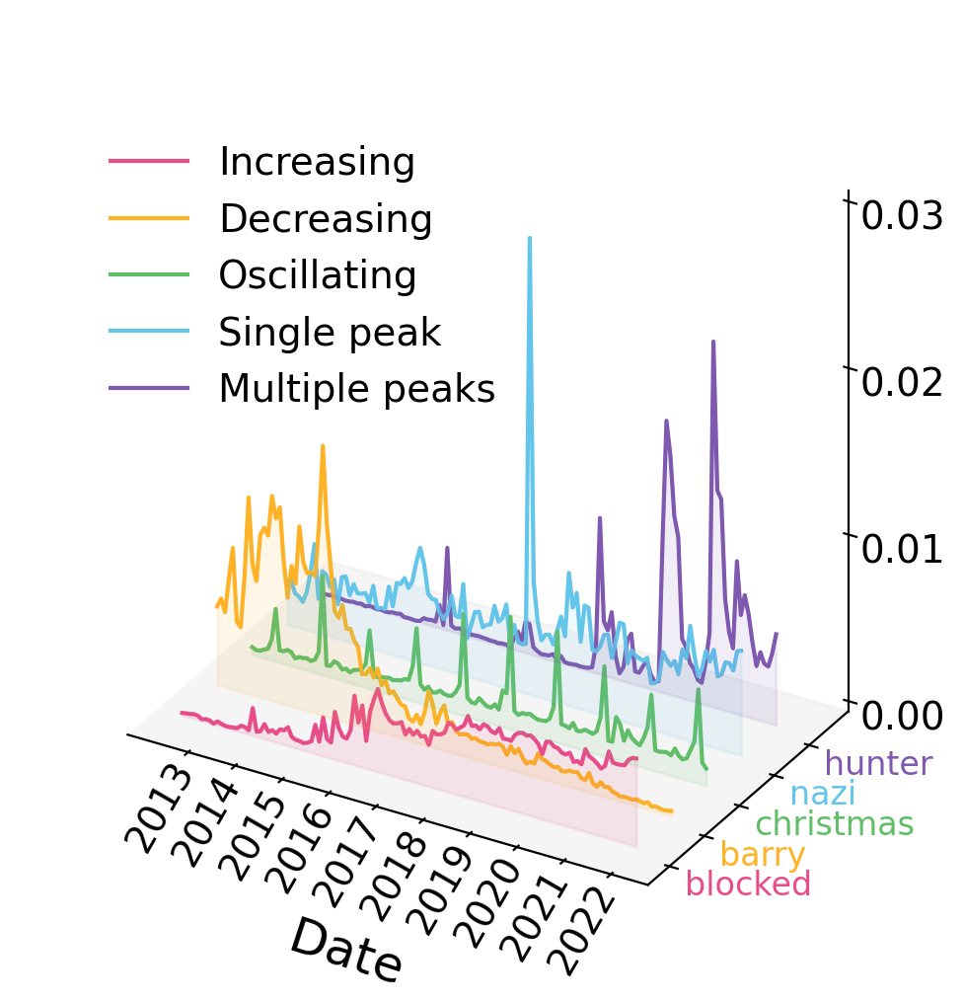

In [552]:
# Check the distribution of the topic frequency
# keep increasing : 9 (orange man bad), 12 (facts)
# keep decreasing : 15 (obama)
# oscillating : 6 (racist)
# showing one peak : 3 (Hillary clinton), 23(mexico wall)
# showing multiple (<3) peaks : 2 (Covid), 19(abortion), 24(obamacare)


fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(projection='3d')
color_list = ['#e84d8a', '#feb326', '#60bd68', '#64c5eb', '#7f58af',]

# Convert the keys to datetime objects
dates = [datetime.strptime(key, '%Y-%m-%d') for key in keys]

topic_list = [39, 68, 65, 35, 43]
topic_num = len(topic_list)-1
label_list = ['Increasing', 'Decreasing', 'Oscillating', 'Single peak', 'Multiple peaks']

for i, t in enumerate(topic_list[::-1]):
    ax.plot(np.arange(len(dates)), sorted_norm_topic_freq_list[:, t],  zs=topic_num-i, zdir='y', label=label_list[topic_num-i], c=color_list[topic_num-i])
    ax.add_collection3d(plt.fill_between(np.arange(len(dates)), sorted_norm_topic_freq_list[:, t], 0, color=color_list[topic_num-i], alpha=0.05), topic_num-i, zdir='y')
    
# Remove grid
ax.grid(False)

# Remove background color
ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.5))
ax.yaxis.set_pane_color((1, 1, 1, 1.0))
#ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.5))

ax.set_box_aspect((30, 20, 30))

# Set the camera angle
ax.view_init(elev=30, azim=-60)

xticks, xticklabels = date_label(start_date, end_date)
#xticks = xticks[::3]
#xticklabels = xticklabels[::3]
ax.set_xticks(xticks)
ax.set_xticklabels(xticklabels, rotation=60, rotation_mode='anchor', verticalalignment='center',horizontalalignment='right', fontsize=14)
ax.xaxis.set_tick_params(pad=-5)
ax.set_xlabel('Date', labelpad=15, fontsize=18, rotation=-18)

yticks = np.arange(len(topic_list))
yticklabels = [topic_name_list[t].split('_')[1] for t in topic_list]
ax.set_yticks(yticks)
ax.set_yticklabels(yticklabels, rotation=0, verticalalignment='center', horizontalalignment='left', fontsize=12)

for i in range(5):
    ax.get_yticklabels()[i].set_color(color_list[i])

ax.yaxis.set_tick_params(pad=-3)
ax.set_ylim(-0.5, len(topic_list))

ax.set_zticks(np.arange(0, 0.031, 0.01))
ax.set_zticklabels([f'{a:.2f}' for a in np.arange(0, 0.031, 0.01)], fontsize=14)
ax.zaxis.set_tick_params(pad=5)
ax.set_zlim(0, 0.03)
ax.set_zlabel('Rel. comment topic freq.', labelpad=20, fontsize=18)

ax.set_proj_type('ortho')
# Locate the legend precisely and reverse the order
ax.legend(reversed(ax.get_legend_handles_labels()[0]), reversed(ax.get_legend_handles_labels()[1]), frameon=False, bbox_to_anchor=(0.56, 0.9),fontsize=14)
plt.tight_layout()

plt.savefig("figure/fig3c.svg", format="svg", transparent=True)

### 3d. Frequency behavior (model)

In [90]:
folder_name = '0_sample'
model_type = 'simple'
filter_strength = 0.5
memory_strength = 0.9
comm_num = 1000
event_num = 1000

topic_num = 250
timestep = 120

sim_name = f'sim_T250_C{comm_num}_E{event_num}_ET3_F{filter_strength}_M{memory_strength}_ITplain_IF0.0_IV99_0_0.0_0_0.0_-1_-1_t{timestep}_0'
parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

comm_num = parameters['comm_num']
topic_num = parameters['topic_num']
raw_freq_list = results['raw_freq_list']
events_list_list = results['events_list']
filtered_events_list_list = results['filtered_events_list_list']
weight_list = results['weight_list']

In [ ]:
data = raw_freq_list / np.sum(raw_freq_list, axis=-1, keepdims=True)

# Define the topic sliders
comm_slider = widgets.IntSlider(min=0, max=comm_num-1, value=0, description='Comm')
topic_slider = widgets.IntSlider(min=0, max=topic_num-1, value=0, description='Topic')

# Define the update function
def update_topics(comm, topic):
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_title(f"Topic {topic}")
    ax.set_xlabel("Timestep")
    ax.set_ylabel("Frequency")
    ax.plot(np.arange(timestep), data[comm, :, topic], c='k')
    # linear fitting
    x = np.arange(timestep)
    y = data[comm, :, topic]
    m, b = np.polyfit(x, y, 1)
    ax.plot(x, m*x+b, c='r', ls='--', lw=3)
    print(m, b)
    plt.show()
    
# Create the interactive widget
widgets.interact(update_topics, comm=comm_slider, topic=topic_slider)

interactive(children=(IntSlider(value=0, description='Comm', max=999), IntSlider(value=0, description='Topic',…

<function __main__.update_topics(comm, topic)>

In [ ]:
data = raw_freq_list / np.sum(raw_freq_list, axis=-1, keepdims=True)

m_list = np.zeros((data.shape[0], data.shape[2]))
c_list = np.zeros((data.shape[0], data.shape[2]))
x = np.arange(timestep)

for i in range(comm_num):
    if i%50==0:
        print(i)
    for j in range(topic_num):
        y = data[i, :, j]
        m, _ = np.polyfit(x, y, 1)
        c = np.corrcoef(x, y)[0, 1]
        m_list[i][j] = m
        c_list[i][j] = c

# get indices of top 10 largest entries in m_list and c_list
m_indices = np.argsort(m_list, axis=None)[::-1]
c_indices = np.argsort(c_list, axis=None)[::-1]

m_indices = np.unravel_index(m_indices, m_list.shape)
c_indices = np.unravel_index(c_indices, c_list.shape)

print(m_indices[0][:10], m_indices[1][:10])
print(c_indices[0][:10], c_indices[1][:10])

In [1046]:
from scipy.fft import fft, fftfreq
from scipy.signal import periodogram

def dominant_periodicity_score_fft(time_series, target_period, sampling_rate=1):
    n = len(time_series)
    freqs = fftfreq(n, d=sampling_rate)  # Frequency bins
    fft_values = fft(time_series)
    power = np.abs(fft_values)**2  # Power spectrum
    
    # Target frequency
    target_freq = 1 / target_period
    target_idx = np.argmin(np.abs(freqs - target_freq))  # Closest bin to target frequency
    
    # Calculate dominant score
    target_power = power[target_idx]
    other_power = np.sum(power) - target_power
    if other_power == 0:  # Handle edge case with no other power
        return np.inf
    return target_power / other_power

def dominant_periodicity_score_periodogram(time_series, target_period, sampling_rate=1):
    frequencies, power = periodogram(time_series, fs=1/sampling_rate)
    target_freq = 1 / target_period
    target_idx = np.argmin(np.abs(frequencies - target_freq))  # Closest frequency
    
    # Target power and background power
    target_power = power[target_idx]
    background_power = np.mean(np.delete(power, target_idx))  # Exclude target frequency
    if background_power == 0:  # Handle edge case
        return np.inf
    return target_power / background_power



In [1076]:
func_period = periodicity_score_periodogram

data = raw_freq_list / np.sum(raw_freq_list, axis=-1, keepdims=True)
f_list = np.zeros((data.shape[0], data.shape[2]))
target_period = 20

for i in range(comm_num):
    if i%50==0:
        print(i)
    for j in range(topic_num):
        y = data[i, :, j]
        f_list[i][j] = 0.5 * dominant_periodicity_score_fft(y, target_period) + 0.5 * dominant_periodicity_score_periodogram(y, target_period)

f_indices = np.argsort(f_list, axis=None)[::-1]
f_indices = np.unravel_index(f_indices, f_list.shape)


0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950


In [1077]:
data = raw_freq_list / np.sum(raw_freq_list, axis=-1, keepdims=True)

# Define the topic sliders
rank_slider = widgets.IntSlider(min=0, max=np.prod(f_list.shape)-1, value=0, description='rank (m)')

# Define the update function
def update_topics(rank):
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlabel("Timestep")
    ax.set_ylabel("Frequency")
    
    ax.plot(np.arange(timestep), data[f_indices[0][rank], :, f_indices[1][rank]], c='k')
    ax.text(0.05, 0.9, f'{f_indices[0][rank], f_indices[1][rank]}', fontsize=22, transform=ax.transAxes)
    # linear fitting
    plt.show()
    
# Create the interactive widget
widgets.interact(update_topics, rank=rank_slider)

interactive(children=(IntSlider(value=0, description='rank (m)', max=249999), Output()), _dom_classes=('widget…

<function __main__.update_topics(rank)>

In [1086]:
data = raw_freq_list / np.sum(raw_freq_list, axis=-1, keepdims=True)

# Define the topic sliders
rank_slider = widgets.IntSlider(min=0, max=np.prod(m_list.shape)-1, value=0, description='rank (m)')

# Define the update function
def update_topics(rank):
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlabel("Timestep")
    ax.set_ylabel("Frequency")
    
    ax.plot(np.arange(timestep), data[m_indices[0][rank], :, m_indices[1][rank]], c='k')
    ax.text(0.05, 0.7, f'{m_indices[0][rank], m_indices[1][rank]}', fontsize=22, transform=ax.transAxes)
    # linear fitting
    x = np.arange(timestep)
    y = data[m_indices[0][rank], :, m_indices[1][rank]]
    m, b = np.polyfit(x, y, 1)
    ax.plot(x, m*x+b, c='r', ls='--', lw=3)
    print(m, b)
    plt.show()
    
# Create the interactive widget
widgets.interact(update_topics, rank=rank_slider)

interactive(children=(IntSlider(value=0, description='rank (m)', max=249999), Output()), _dom_classes=('widget…

<function __main__.update_topics(rank)>

In [ ]:
data = raw_freq_list / np.sum(raw_freq_list, axis=-1, keepdims=True)

# Define the topic sliders
rank_slider = widgets.IntSlider(min=0, max=np.prod(c_list.shape)-1, value=0, description='rank (c)')

# Define the update function
def update_topics(rank):
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlabel("Timestep")
    ax.set_ylabel("Frequency")
    
    ax.plot(np.arange(timestep), data[c_indices[0][rank], :, c_indices[1][rank]], c='k')
    ax.text(0.05, 0.7, f'{c_indices[0][rank], c_indices[1][rank]}', fontsize=22, transform=ax.transAxes)
    # linear fitting
    x = np.arange(timestep)
    y = data[c_indices[0][rank], :, c_indices[1][rank]]
    m, b = np.polyfit(x, y, 1)
    ax.plot(x, m*x+b, c='r', ls='--', lw=3)
    print(m, b, c_list[c_indices[0][rank]][c_indices[1][rank]])
    plt.show()
    
# Create the interactive widget
widgets.interact(update_topics, rank=rank_slider)

interactive(children=(IntSlider(value=0, description='rank (c)', max=249999), Output()), _dom_classes=('widget…

<function __main__.update_topics(rank)>

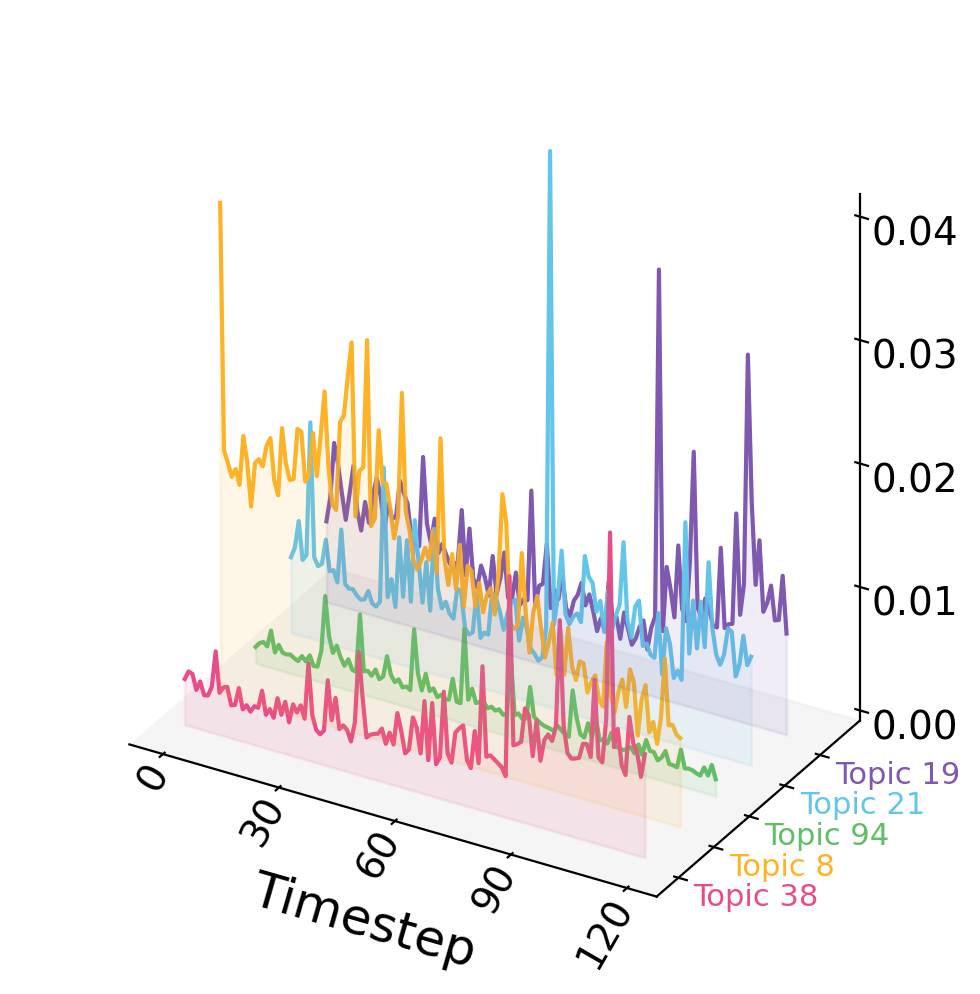

In [91]:
# Check the distribution of the topic frequency
# keep increasing : 9 (orange man bad), 12 (facts)
# keep decreasing : 15 (obama)
# oscillating : 6 (racist)
# showing one peak : 3 (Hillary clinton), 23(mexico wall)
# showing multiple (<3) peaks : 2 (Covid), 19(abortion), 24(obamacare)


fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(projection='3d')
color_list = ['#e84d8a', '#feb326', '#60bd68', '#64c5eb', '#7f58af',]

# Convert the keys to datetime objects
dates = [datetime.strptime(key, '%Y-%m-%d') for key in keys]
data = raw_freq_list / np.sum(raw_freq_list, axis=-1, keepdims=True)

# indicies are reversed
comm_list = [22, 50, 605, 731, 777]
topic_list = [19, 21, 94, 8, 38]
topic_num = len(topic_list)-1
label_list = ['Increasing', 'Decreasing', 'Oscillating', 'Single peak', 'Multiple peaks']

for i, t in enumerate(topic_list[::-1]):
    x = np.arange(timestep)
    y = data[comm_list[i], :, topic_list[i]]
    ax.plot(x, y, zs=topic_num-i, zdir='y', label=label_list[topic_num-i], c=color_list[topic_num-i])
    ax.add_collection3d(plt.fill_between(x, y, 0, color=color_list[topic_num-i], alpha=0.05), topic_num-i, zdir='y')
    
# Remove grid
ax.grid(False)

# Remove background color
ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.5))
ax.yaxis.set_pane_color((1, 1, 1, 1.0))
#ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.5))

ax.set_box_aspect((30, 20, 30))

# Set the camera angle
ax.view_init(elev=30, azim=-60)

xticks = [0, 30, 60, 90, 120]
xticklabels = ['0', '30', '60', '90', '120']
ax.set_xticks(xticks)
ax.set_xticklabels(xticklabels, rotation=60, rotation_mode='anchor', verticalalignment='center',horizontalalignment='right', fontsize=14)
ax.xaxis.set_tick_params(pad=-5)
ax.set_xlabel('Timestep', fontsize=18, rotation=-18)

yticks = np.arange(len(topic_list))
yticklabels = [f'Topic {t}' for t in topic_list][::-1]
ax.set_yticks(yticks)
ax.set_yticklabels(yticklabels, rotation=0, verticalalignment='center', horizontalalignment='left', fontsize=11)

for i in range(len(topic_list)):
    ax.get_yticklabels()[i].set_color(color_list[i])

ax.yaxis.set_tick_params(pad=-3)
ax.set_ylim(-0.5, len(topic_list))

ax.set_zticks(np.arange(0, 0.041, 0.01))
ax.set_zticklabels([f'{a:.2f}' for a in np.arange(0, 0.041, 0.01)], fontsize=14)
ax.set_zlim(0, 0.041)
ax.zaxis.set_tick_params(pad=5)
ax.set_zlabel('Rel. comment topic freq.', labelpad=20, fontsize=18)

ax.set_proj_type('ortho')
# Locate the legend precisely and reverse the order
#ax.legend(reversed(ax.get_legend_handles_labels()[0]), reversed(ax.get_legend_handles_labels()[1]), bbox_to_anchor=(0.5, 0.6), borderaxespad=0., fontsize=12)
plt.tight_layout()

plt.savefig("figure/fig3d.svg", format="svg", transparent=True)

### 3e. Similarity behavior (data)

In [1124]:
collection_name = 'Thehill'
model_name = MODEL_NAMES['global']
num_topics = NUM_TOPICS['global']
start_date, end_date = DATE_RANGES[collection_name]

In [1125]:
with open(join('result', 'comment_topic_freq_dict.pkl'), 'rb') as f:
    comment_topic_freq_dict = pickle.load(f)

topic_freq = comment_topic_freq_dict['global'][1:] # exclude -1
ranking = np.argsort(topic_freq)[::-1] # descending order

topic_name_list = pd.read_csv(join('result', 'global', model_name +'_fit.csv'))['Name'].values
topic_name_list = topic_name_list[1:][ranking]

In [1126]:
file_names = os.listdir(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df'))
keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))
sim_matrix_full_list = []

length_list = np.zeros((len(keys), 2))
for key in keys:
    data = pd.read_parquet(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df', key+'.parquet'))
    embedding = np.vstack(data['topic_mean_embedding'].values)
    sim_matrix_full = cosine_similarity(embedding, embedding)
    sim_matrix_full_list.append(sim_matrix_full)
    
sim_matrix_full_list = np.array(sim_matrix_full_list)

In [ ]:

# Define the topic sliders
topic_slider1 = widgets.IntSlider(min=0, max=num_topics-1, value=0, description='Topic 1:')
topic_slider2 = widgets.IntSlider(min=0, max=num_topics-1, value=1, description='Topic 2:')

# Define the update function
def update_topics(topic1, topic2):
    # Your code to update the plot based on the selected topics
    # For example:

    plt.plot(np.arange(len(sim_matrix_full_list)), sim_matrix_full_list[:, topic1, topic2], c='k')
    plt.text(10, min(sim_matrix_full_list[:, topic1, topic2])*1, s=f'{topic_name_list[topic1], topic_name_list[topic2]}')
    plt.show()
    
# Create the interactive widget
widgets.interact(update_topics, topic1=topic_slider1, topic2=topic_slider2)

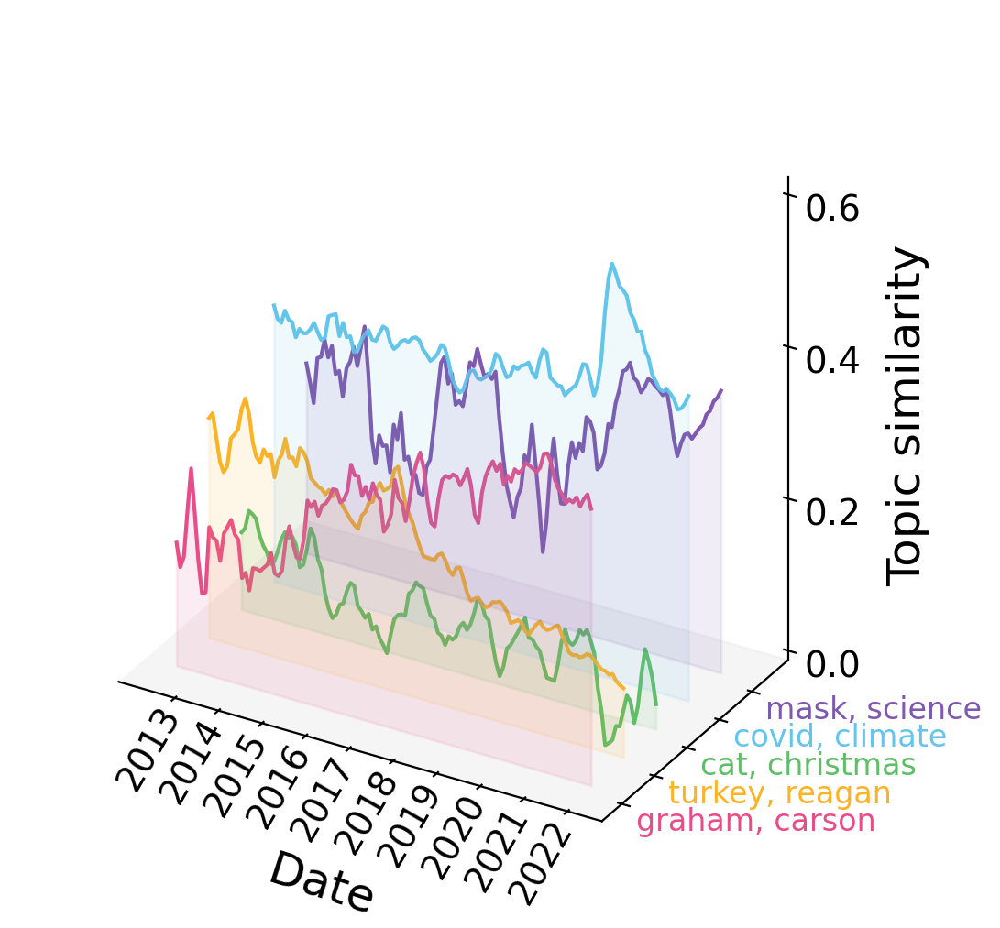

In [1238]:
# Check the distribution of the topic frequency
# keep increasing : 9 (orange man bad), 12 (facts)
# keep decreasing : 15 (obama)
# oscillating : 6 (racist)
# showing one peak : 3 (Hillary clinton), 23(mexico wall)
# showing multiple (<3) peaks : 2 (Covid), 19(abortion), 24(obamacare)


fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(projection='3d')
color_list = ['#e84d8a', '#feb326', '#60bd68', '#64c5eb', '#7f58af',]

# Convert the keys to datetime objects
dates = [datetime.strptime(key, '%Y-%m-%d') for key in keys]
ymin = 0.0
ymax = 0.45

topic_pair_list = [(102, 124), (127, 99), (74, 65), (14, 17), (48, 71)]
topic_num = len(topic_pair_list)-1
label_list = ['Increasing', 'Decreasing', 'Oscillating', 'Single peak', 'Multiple peaks']


for i, topic_pair in enumerate(topic_pair_list[::-1]):
    #ax.plot(np.arange(len(dates)), sim_matrix_full_list[:, topic_pair[0], topic_pair[1]], zs=topic_num-i, zdir='y', label=label_list[topic_num-i], c=color_list[topic_num-i])

    # Calculate the moving average
    window_size = 3
    moving_avg = pd.Series(sim_matrix_full_list[:, topic_pair[0], topic_pair[1]]).rolling(window_size).mean()

    # Plot the smoothened data
    ax.plot(np.arange(len(dates)), moving_avg, zs=topic_num-i, zdir='y', label=f'{label_list[topic_num-i]}', c=color_list[topic_num-i])

    # Rest of the code...
    ax.add_collection3d(plt.fill_between(np.arange(len(dates)), moving_avg, ymin, color=color_list[topic_num-i], alpha=0.05), topic_num-i, zdir='y')


# Remove grid
ax.grid(False)

# Remove background color
ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.5))
ax.yaxis.set_pane_color((1, 1, 1, 1.0))
#ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.5))

ax.set_box_aspect((30, 20, 30))

# Set the camera angle
ax.view_init(elev=30, azim=-60)

xticks, xticklabels = date_label(start_date, end_date)
ax.set_xticks(xticks)
ax.set_xticklabels(xticklabels, rotation=60, rotation_mode='anchor', verticalalignment='center',horizontalalignment='right', fontsize=14)
ax.xaxis.set_tick_params(pad=-5)
ax.set_xlabel('Date', labelpad=15, fontsize=18, rotation=-18)

yticks = np.arange(len(topic_pair_list))
yticklabels = [f"{topic_name_list[t[0]].split('_')[1]}, {topic_name_list[t[1]].split('_')[1]}" for t in topic_pair_list]
ax.set_yticks(yticks)
ax.set_yticklabels(yticklabels, rotation=0, verticalalignment='center', horizontalalignment='left', fontsize=12)
for i in range(5):
    ax.get_yticklabels()[i].set_color(color_list[i])
ax.yaxis.set_tick_params(pad=-3)
ax.set_ylim(-0.5, len(topic_pair_list))

ax.set_zticks(np.arange(0, 0.61, 0.2))
ax.set_zticklabels([f'{a:.1f}' for a in np.arange(0, 0.61, 0.2)], fontsize=14)
ax.set_zlim(0, 0.61)
ax.set_zlabel('Topic similarity', labelpad=10, fontsize=18)

ax.set_proj_type('ortho')
# Locate the legend precisely and reverse the order
#ax.legend(reversed(ax.get_legend_handles_labels()[0]), reversed(ax.get_legend_handles_labels()[1]), bbox_to_anchor=(0.45, 0.95), borderaxespad=0., fontsize=12)
#plt.tight_layout()

plt.savefig("figure/fig3e.svg", format="svg", bbox_inches="tight", transparent=True)

### 3f. Similarity behavior (model)

In [ ]:
folder_name = '0_sample'
model_type = 'simple'
filter_strength = 0.5
memory_strength = 0.9
comm_num = 1000
event_num = 1000

topic_num = 250
timestep = 120

sim_name = f'sim_T250_C{comm_num}_E{event_num}_ET3_F{filter_strength}_M{memory_strength}_ITplain_IF0.0_IV99_0_0.0_0_0.0_-1_-1_t{timestep}_0'
parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

comm_num = parameters['comm_num']
topic_num = parameters['topic_num']
raw_freq_list = results['raw_freq_list']
events_list_list = results['events_list']
filtered_events_list_list = results['filtered_events_list_list']
weight_list = results['weight_list']

In [1177]:
topic_num = 250

# Define the topic sliders
comm_slider = widgets.IntSlider(min=0, max=comm_num-1, value=0, description='Comm')
topic_slider1 = widgets.IntSlider(min=0, max=topic_num-1, value=0, description='Topic 1:')
topic_slider2 = widgets.IntSlider(min=0, max=topic_num-1, value=1, description='Topic 2:')

# Define the update function
def update_topics(comm, topic1, topic2):
    # Your code to update the plot based on the selected topics
    # For example:

    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_title(f"Topic {topic1}, {topic2}")
    ax.set_xlabel("Timestep")
    ax.set_ylabel("Frequency")
    ax.plot(np.arange(timestep+1), weight_list[comm, :, topic1, topic2], c='k')
    plt.show()

    
# Create the interactive widget
widgets.interact(update_topics, comm=comm_slider, topic1=topic_slider1, topic2=topic_slider2)

interactive(children=(IntSlider(value=0, description='Comm', max=999), IntSlider(value=0, description='Topic 1…

<function __main__.update_topics(comm, topic1, topic2)>

In [ ]:
data = weight_list
comm = 1
topic_num = 250

m_list = np.zeros((comm, data.shape[2], data.shape[2]))
c_list = np.zeros((comm, data.shape[2], data.shape[2]))
x = np.arange(timestep)

for i in range(comm):
    for j in range(topic_num):
        for k in range(topic_num):
            y = data[i, :, j, k][1:]
            m, _ = np.polyfit(x, y, 1)
            c = np.corrcoef(x, y)[0, 1]
            m_list[i, j, k] = m
            c_list[i, j, k] = c

# get indices of top 10 largest entries in m_list and c_list
m_indices = np.argsort(m_list, axis=None)[::-1]
c_indices = np.argsort(c_list, axis=None)[::-1]

m_indices = np.unravel_index(m_indices, m_list.shape)
c_indices = np.unravel_index(c_indices, c_list.shape)


In [ ]:
data = weight_list

# Define the topic sliders
rank_slider = widgets.IntSlider(min=0, max=np.prod(m_list.shape)-1, value=0, description='rank (m)')

# Define the update function
def update_topics(rank):
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlabel("Timestep")
    ax.set_ylabel("Frequency")
    
    ax.plot(np.arange(timestep), data[m_indices[0][rank], :, m_indices[1][rank], m_indices[2][rank]][1:], c='k')
    ax.text(0.05, 0.9, f'{m_indices[0][rank], m_indices[1][rank], m_indices[2][rank]}', fontsize=22, transform=ax.transAxes)
    # linear fitting
    plt.show()
    
# Create the interactive widget
widgets.interact(update_topics, rank=rank_slider)

interactive(children=(IntSlider(value=0, description='rank (m)', max=62499), Output()), _dom_classes=('widget-…

<function __main__.update_topics(rank)>

In [1223]:
data = weight_list
comm = 1
topic_num = 250

m_list = np.zeros((comm, data.shape[2], data.shape[2]))
c_list = np.zeros((comm, data.shape[2], data.shape[2]))
x = np.arange(timestep)
threshold = 0.1

for i in range(comm):
    for j in range(topic_num):
        for k in range(topic_num):
            y = data[i, :, j, k][1:]
            c = np.corrcoef(x, y)[0, 1]
            if np.max(y)-np.min(y) > threshold:
                c_list[i, j, k] = np.abs(c)
            else:
                c_list[i, j, k] = 2

# get indices of top 10 largest entries in m_list and c_list
c_indices = np.argsort(c_list, axis=None)
c_indices = np.unravel_index(c_indices, c_list.shape)


In [1224]:
data = weight_list

# Define the topic sliders
rank_slider = widgets.IntSlider(min=0, max=np.prod(c_list.shape)-1, value=0, description='rank (m)')

# Define the update function
def update_topics(rank):
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlabel("Timestep")
    ax.set_ylabel("Frequency")
    
    ax.plot(np.arange(timestep), data[c_indices[0][rank], :, c_indices[1][rank], c_indices[2][rank]][1:], c='k')
    ax.text(0.05, 0.9, f'{c_indices[0][rank], c_indices[1][rank], c_indices[2][rank]}', fontsize=22, transform=ax.transAxes)
    # linear fitting
    plt.show()
    
# Create the interactive widget
widgets.interact(update_topics, rank=rank_slider)

interactive(children=(IntSlider(value=0, description='rank (m)', max=62499), Output()), _dom_classes=('widget-…

<function __main__.update_topics(rank)>

In [1205]:
f_indices_copy = [[], [], []]

for i in range(len(f_indices[0])):
    x = data[f_indices[0][i], :, f_indices[1][i], f_indices[2][i]][1:]
    if np.max(x)-np.min(x) < 0.1:
        continue
    else:
        f_indices_copy[0].append(f_indices[0][i])
        f_indices_copy[1].append(f_indices[1][i])
        f_indices_copy[2].append(f_indices[2][i])

In [1211]:
data = weight_list

# Define the topic sliders
rank_slider = widgets.IntSlider(min=0, max=np.prod(f_list.shape)-1, value=0, description='rank (m)')

# Define the update function
def update_topics(rank):
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlabel("Timestep")
    ax.set_ylabel("Frequency")
    
    ax.plot(np.arange(timestep), data[f_indices[0][rank], :, f_indices[1][rank], f_indices[2][rank]][1:], c='k')
    ax.text(0.05, 0.9, f'{f_indices[0][rank], f_indices[1][rank], f_indices[2][rank]}', fontsize=22, transform=ax.transAxes)
    # linear fitting
    plt.show()
    
# Create the interactive widget
widgets.interact(update_topics, rank=rank_slider)

interactive(children=(IntSlider(value=0, description='rank (m)', max=624999), Output()), _dom_classes=('widget…

<function __main__.update_topics(rank)>

In [ ]:
mm_list = []

for rank in range(1000):
    x = data[f_indices[0][rank], :, f_indices[1][rank], f_indices[2][rank]]
    mm_list.append(np.max(x)-np.min(x))
    
mm_indices = np.argsort(mm_list)[::-1]

interactive(children=(IntSlider(value=0, description='rank (m)', max=624999), Output()), _dom_classes=('widget…

<function __main__.update_topics(rank)>

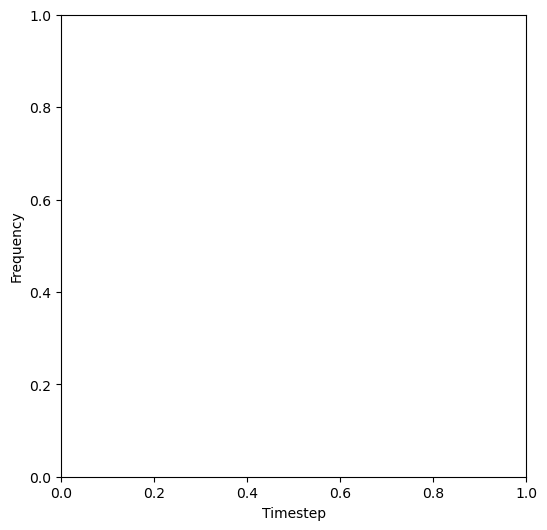

In [1194]:
data = weight_list

# Define the topic sliders
rank_slider = widgets.IntSlider(min=0, max=np.prod(f_list.shape)-1, value=0, description='rank (m)')

# Define the update function
def update_topics(rank):
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlabel("Timestep")
    ax.set_ylabel("Frequency")
    mm = mm_indices[rank]
    ax.plot(np.arange(timestep), data[f_indices[0][mm], :, f_indices[1][mm], f_indices[2][mm]][1:], c='k')
    ax.text(0.05, 0.9, f'{f_indices[0][mm], f_indices[1][mm], f_indices[2][mm]}', fontsize=22, transform=ax.transAxes)
    # linear fitting
    plt.show()
    
# Create the interactive widget
widgets.interact(update_topics, rank=rank_slider)

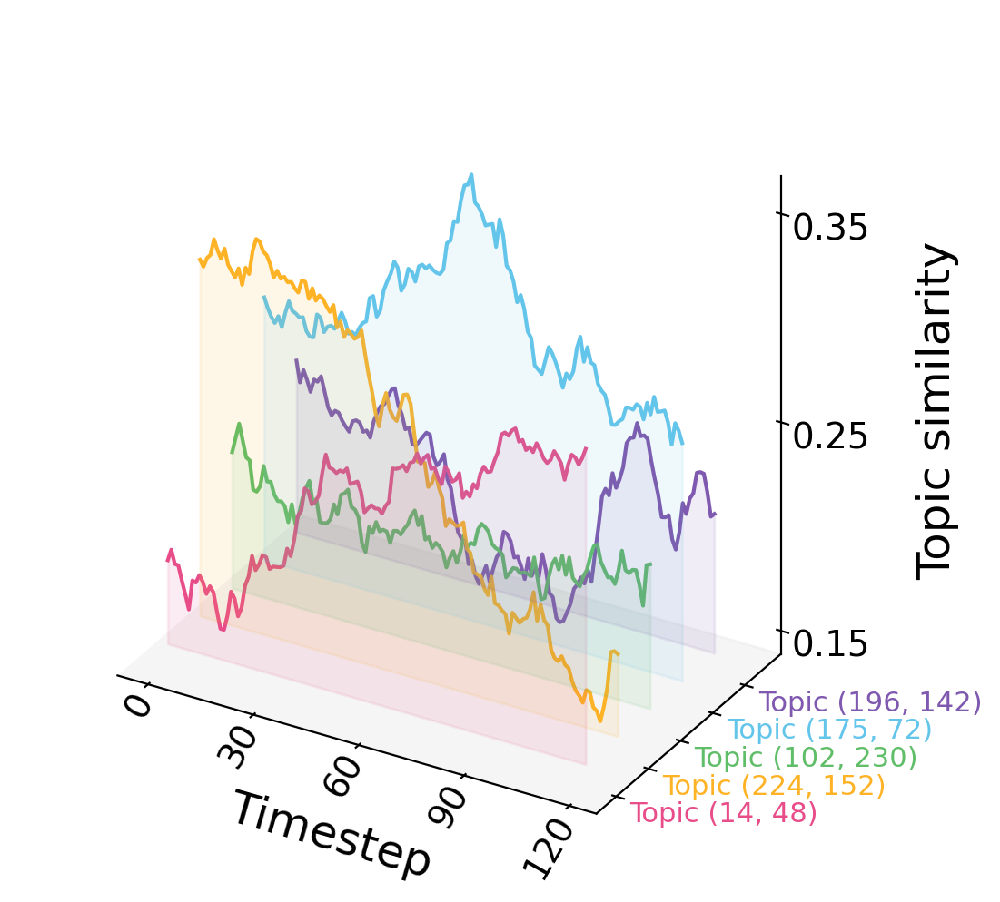

In [1243]:
# Check the distribution of the topic frequency
# keep increasing : 9 (orange man bad), 12 (facts)
# keep decreasing : 15 (obama)
# oscillating : 6 (racist)
# showing one peak : 3 (Hillary clinton), 23(mexico wall)
# showing multiple (<3) peaks : 2 (Covid), 19(abortion), 24(obamacare)


fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(projection='3d')
color_list = ['#e84d8a', '#feb326', '#60bd68', '#64c5eb', '#7f58af',]

# Convert the keys to datetime objects
dates = [datetime.strptime(key, '%Y-%m-%d') for key in keys]

# indicies are reversed
#comm_list = [4, 0, 0]
#topic_list = [(51, 17), (5, 121), (3, 2)]

comm_list = [0, 0, 6, 0, 0]
topic_list = [(196, 142), (175, 72), (102, 230), (224, 152), (14, 48)]

topic_num = len(topic_list)-1
label_list = ['Increasing', 'Decreasing', 'Oscillating', 'Single peak', 'Multiple peaks']

min_val = 0.15

for i, t in enumerate(topic_list[::-1]):
    x = np.arange(timestep)
    y = weight_list[comm_list[i], :, topic_list[i][0], topic_list[i][1]][1:]
    ax.plot(x, y, zs=topic_num-i, zdir='y', label=label_list[topic_num-i], c=color_list[topic_num-i])
    ax.add_collection3d(plt.fill_between(x, y, min_val, color=color_list[topic_num-i], alpha=0.05), topic_num-i, zdir='y')
    
# Remove grid
ax.grid(False)

# Remove background color
ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.5))
ax.yaxis.set_pane_color((1, 1, 1, 1.0))
#ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.5))

ax.set_box_aspect((30, 20, 30))

# Set the camera angle
ax.view_init(elev=30, azim=-60)

xticks = [0, 30, 60, 90, 120]
xticklabels = ['0', '30', '60', '90', '120']
ax.set_xticks(xticks)
ax.set_xticklabels(xticklabels, rotation=60, rotation_mode='anchor', verticalalignment='center',horizontalalignment='right', fontsize=14)
ax.xaxis.set_tick_params(pad=-5)
ax.set_xlabel('Timestep', fontsize=18, rotation=-18)

yticks = np.arange(len(topic_list))
yticklabels = [f'Topic {t}' for t in topic_list][::-1]
ax.set_yticks(yticks)
ax.set_yticklabels(yticklabels, rotation=0, verticalalignment='center', horizontalalignment='left', fontsize=11)

for i in range(len(topic_list)):
    ax.get_yticklabels()[i].set_color(color_list[i])

ax.yaxis.set_tick_params(pad=-3)
ax.set_ylim(-0.5, len(topic_list))

ax.set_zticks(np.arange(min_val, 0.41, 0.1))
ax.set_zticklabels([f'{a:.2f}' for a in np.arange(min_val, 0.41, 0.1)], fontsize=14)
ax.zaxis.set_tick_params(pad=5)
ax.set_zlabel('Topic similarity', labelpad=20, fontsize=18)

ax.set_proj_type('ortho')
# Locate the legend precisely and reverse the order
#ax.legend(reversed(ax.get_legend_handles_labels()[0]), reversed(ax.get_legend_handles_labels()[1]), bbox_to_anchor=(0.5, 0.6), borderaxespad=0., fontsize=12)
#plt.tight_layout()

plt.savefig("figure/fig3f.svg", format="svg", bbox_inches="tight", transparent=True)

## Figure 4. Editorial influence

### 4b. Align 0.0 (KD)

In [1054]:
folder_name = '1_align'
model_type = 'simple'

topic_num = 250
comm_num = 1000
timestep = 100

filter_strength = 0.2
target_topic = 25

iv_t1_list = [20]
iv_s1 = 0.8
iv_s2_list = [0.2]
iv_t2_list = [60]

#init_type = 'fixed'
init_type = 'perturb'
#init_freq_std = 1.0
#init_freq_std = 0.0
init_freq_std = 0.2
memory_strength_list = [0.9, 0.95, 0.99]

store_events = 'F'
store_extra = 'F'
store_weight = 'F'
store_corr = 'F'

desc_list = range(10)

In [1048]:
dist = {'l2': True, 'js':True, 'kd':True, 'corr':True}

l1 = len(memory_strength_list)
l2 = len(iv_t1_list)
l3 = len(iv_t2_list)
l4 = len(iv_s2_list)
l5 = len(desc_list)

avg_gt1_l2_list = [[] for _ in range(l1)]
avg_gt1_kd_list = [[] for _ in range(l1)]
avg_gt1_js_list = [[] for _ in range(l1)]
avg_gt1_corr_list = [[] for _ in range(l1)]

for m, memory_strength in enumerate(memory_strength_list):
    for iv_t1 in iv_t1_list:
        for iv_t2 in iv_t2_list:
            for iv_s2 in iv_s2_list:
                for desc in desc_list:
                    print(memory_strength, iv_t1, iv_t2, iv_s2, desc)
                    sim_name = f'sim_T250_C{comm_num}_E1000_ET3_F{filter_strength}_M{memory_strength}_IT{init_type}_IF{init_freq_std}_IV11_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_-1_-1_t{timestep}_{desc}'
                    result_dict = compute_stats_general(folder_name, model_type, sim_name, dist)
                    
                    gt1_l2_list = result_dict['l2']
                    gt1_js_list = result_dict['js']
                    gt1_kd_list = result_dict['kd']
                    gt1_corr_list = result_dict['corr']
                
                    avg_gt1_l2_list[m].append(np.mean(gt1_l2_list, axis=0))
                    avg_gt1_js_list[m].append(np.mean(gt1_js_list, axis=0))
                    avg_gt1_kd_list[m].append(np.mean(gt1_kd_list, axis=0))
                    avg_gt1_corr_list[m].append(np.mean(gt1_corr_list, axis=0))
                
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type,  f'summary_11_3'), 
                    avg_gt1_l2_list=np.array(avg_gt1_l2_list), avg_gt1_js_list=np.array(avg_gt1_js_list), 
                    avg_gt1_kd_list=np.array(avg_gt1_kd_list), avg_gt1_corr_list=np.array(avg_gt1_corr_list))

0.9 20 60 0.2 0
0.9 20 60 0.2 1
0.9 20 60 0.2 2
0.9 20 60 0.2 3
0.9 20 60 0.2 4
0.9 20 60 0.2 5
0.9 20 60 0.2 6
0.9 20 60 0.2 7
0.9 20 60 0.2 8
0.9 20 60 0.2 9
0.95 20 60 0.2 0
0.95 20 60 0.2 1
0.95 20 60 0.2 2
0.95 20 60 0.2 3
0.95 20 60 0.2 4
0.95 20 60 0.2 5
0.95 20 60 0.2 6
0.95 20 60 0.2 7
0.95 20 60 0.2 8
0.95 20 60 0.2 9
0.99 20 60 0.2 0
0.99 20 60 0.2 1
0.99 20 60 0.2 2
0.99 20 60 0.2 3
0.99 20 60 0.2 4
0.99 20 60 0.2 5
0.99 20 60 0.2 6
0.99 20 60 0.2 7
0.99 20 60 0.2 8
0.99 20 60 0.2 9


In [ ]:
dist = {'l2': True, 'js':True, 'kd':True, 'corr':True}

base_gt1_l2_list = [[] for _ in range(l1)]
base_gt1_kd_list = [[] for _ in range(l1)]
base_gt1_js_list = [[] for _ in range(l1)]
base_gt1_corr_list = [[] for _ in range(l1)]

for m, memory_strength in enumerate(memory_strength_list):
    for desc in desc_list:
        print(memory_strength, desc)
        folder_name = '0_base'
        sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_IT{init_type}_IF{init_freq_std}_IV99_0_0.0_0_0.0_{target_topic}_-1_t{timestep}_{desc}'
            
        result_dict = compute_stats_general(folder_name, model_type, sim_name, dist)
        
        gt1_l2_list = result_dict['l2']
        gt1_js_list = result_dict['js']
        gt1_kd_list = result_dict['kd']
        gt1_corr_list = result_dict['corr']

        base_gt1_l2_list[m].append(np.mean(gt1_l2_list, axis=0))
        base_gt1_js_list[m].append(np.mean(gt1_js_list, axis=0))
        base_gt1_kd_list[m].append(np.mean(gt1_kd_list, axis=0))
        base_gt1_corr_list[m].append(np.mean(gt1_corr_list, axis=0))
    
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type,  f'summary_11_3_base'), 
        base_gt1_l2_list=np.array(base_gt1_l2_list), base_gt1_js_list=np.array(base_gt1_js_list), 
        base_gt1_kd_list=np.array(base_gt1_kd_list), base_gt1_corr_list=np.array(base_gt1_corr_list))

0.9 0


0.9 1
0.9 2
0.9 3
0.9 4
0.9 5
0.9 6
0.9 7
0.9 8
0.9 9
0.95 0
0.95 1
0.95 2
0.95 3
0.95 4
0.95 5
0.95 6
0.95 7
0.95 8
0.95 9
0.99 0
0.99 1
0.99 2
0.99 3
0.99 4
0.99 5
0.99 6
0.99 7
0.99 8
0.99 9


In [16]:
# load data

model_type = 'simple'

folder_name = '1_align'
file_name = 'summary_11_2.npz'
data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, file_name))
avg_gt1_l2_list = data['avg_gt1_l2_list']
avg_gt1_js_list = data['avg_gt1_js_list']
avg_gt1_kd_list = data['avg_gt1_kd_list']
avg_gt1_corr_list = data['avg_gt1_corr_list']

folder_name = '0_base'
file_name = 'summary_11_2_base.npz'
data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, file_name))
base_gt1_l2_list = data['base_gt1_l2_list']
base_gt1_js_list = data['base_gt1_js_list']
base_gt1_kd_list = data['base_gt1_kd_list']
base_gt1_corr_list = data['base_gt1_corr_list']

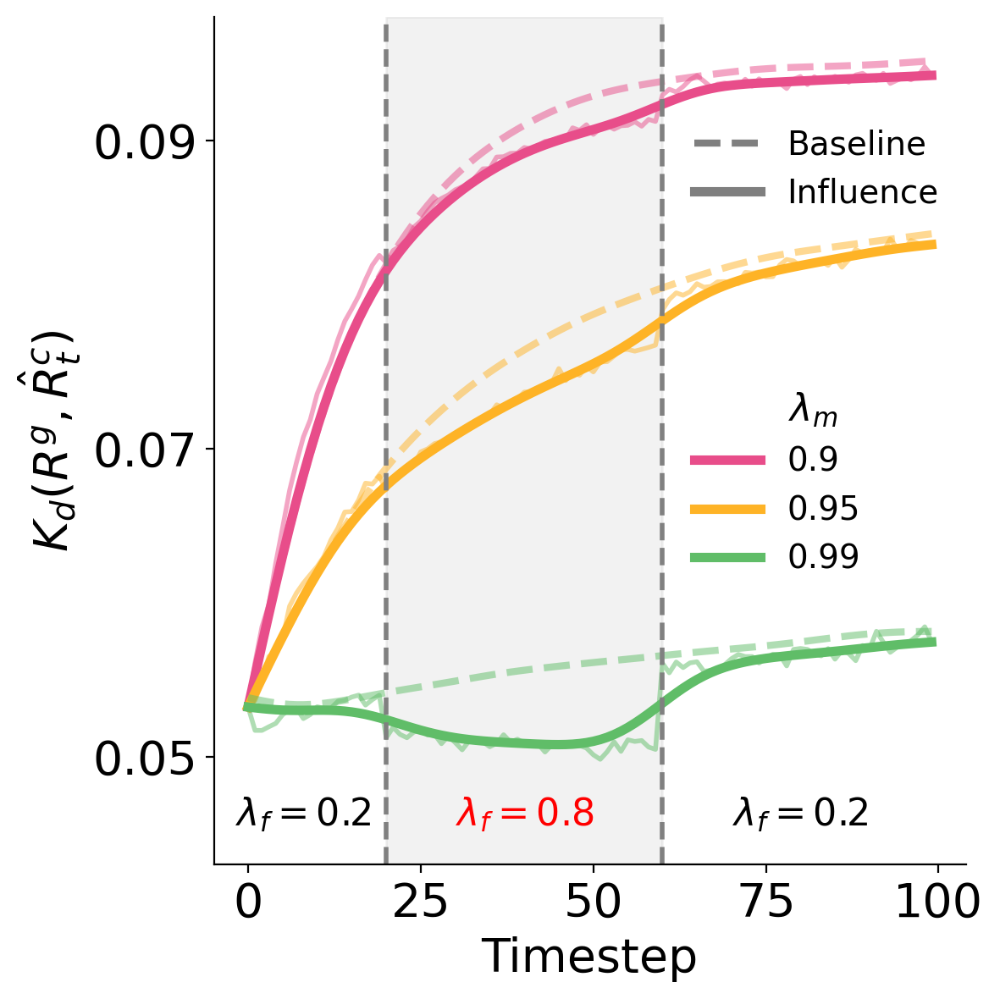

In [111]:
# memory_strength, iv_time, iv_s2

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list
line_list = []

for m, memory in enumerate(memory_strength_list):
    
    y = np.mean(avg_gt1_kd_list[m], axis=0)
    ax.plot(y, lw=2, alpha=0.5, color=color_list[m], ls='-')

    lambda_ = 0.2
    denoised_signal = total_variation_denoising(y, lambda_)
    line=ax.plot(denoised_signal, lw=4, color=color_list[m], label=f'{memory}')
    line_list.append(line[0])
    
    y = np.mean(base_gt1_kd_list[m], axis=0)
    denoised_signal = total_variation_denoising(y, lambda_)
    ax.plot(denoised_signal, lw=3, alpha=0.5, color=color_list[m], ls='--')
    
ax.axvline(x=iv_t1_list[0], ls='--', lw=2, color='gray')
ax.axvline(x=iv_t2_list[0], ls='--', lw=2, color='gray')
ax.axvspan(iv_t1_list[0], iv_t2_list[0], color='black', alpha=0.05)

y_text = 0.045
ax.text((iv_t1_list[0]) / 2 * 0.8, y_text, r'$\lambda_f=0.2$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1_list[0] + iv_t2_list[0]) / 2, y_text, r'$\lambda_f=0.8$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2_list[0]) / 2 , y_text, r'$\lambda_f=0.2$', ha='center', va='bottom', fontsize=16, color='k')

ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel(r'$K_d(R^g, \hat{R}_t^c)$', fontsize=20)

ax.set_ylim(0.043, 0.098)
ax.set_yticks([0.05, 0.07, 0.09])

ax.spines[['right', 'top']].set_visible(False)
legend1 = ax.legend(title="      "+r"$\lambda_m$", title_fontsize=16, handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.45), fontsize=14)

line_list=[]

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label='Baseline')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label='Influence')
line_list.append(custom_line)


legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.82), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig4b.svg", format="svg", transparent=True, bbox_inches='tight')

### 4c. Align 1.0 (KD)

In [864]:
folder_name = '1_align'
model_type = 'simple'

topic_num = 250
comm_num = 1000
timestep = 100

filter_strength = 0.2
target_topic = 25

iv_t1_list = [20]
iv_s1 = 0.8
iv_s2_list = [0.2]
iv_t2_list = [60]

init_type = 'fixed'
#init_freq_std = 1.0
init_freq_std = 0.0
memory_strength_list = [0.9, 0.95, 0.99]

store_events = 'F'
store_extra = 'F'
store_weight = 'F'
store_corr = 'F'

desc_list = range(10)

In [112]:
# load data
folder_name = '1_align'
file_name = 'summary_11.npz'
data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, file_name))
avg_gt1_l2_list = data['avg_gt1_l2_list']
avg_gt1_js_list = data['avg_gt1_js_list']
avg_gt1_kd_list = data['avg_gt1_kd_list']
avg_gt1_corr_list = data['avg_gt1_corr_list']

folder_name = '0_base'
file_name = 'summary_11_base.npz'
data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, file_name))
base_gt1_l2_list = data['base_gt1_l2_list']
base_gt1_js_list = data['base_gt1_js_list']
base_gt1_kd_list = data['base_gt1_kd_list']
base_gt1_corr_list = data['base_gt1_corr_list']

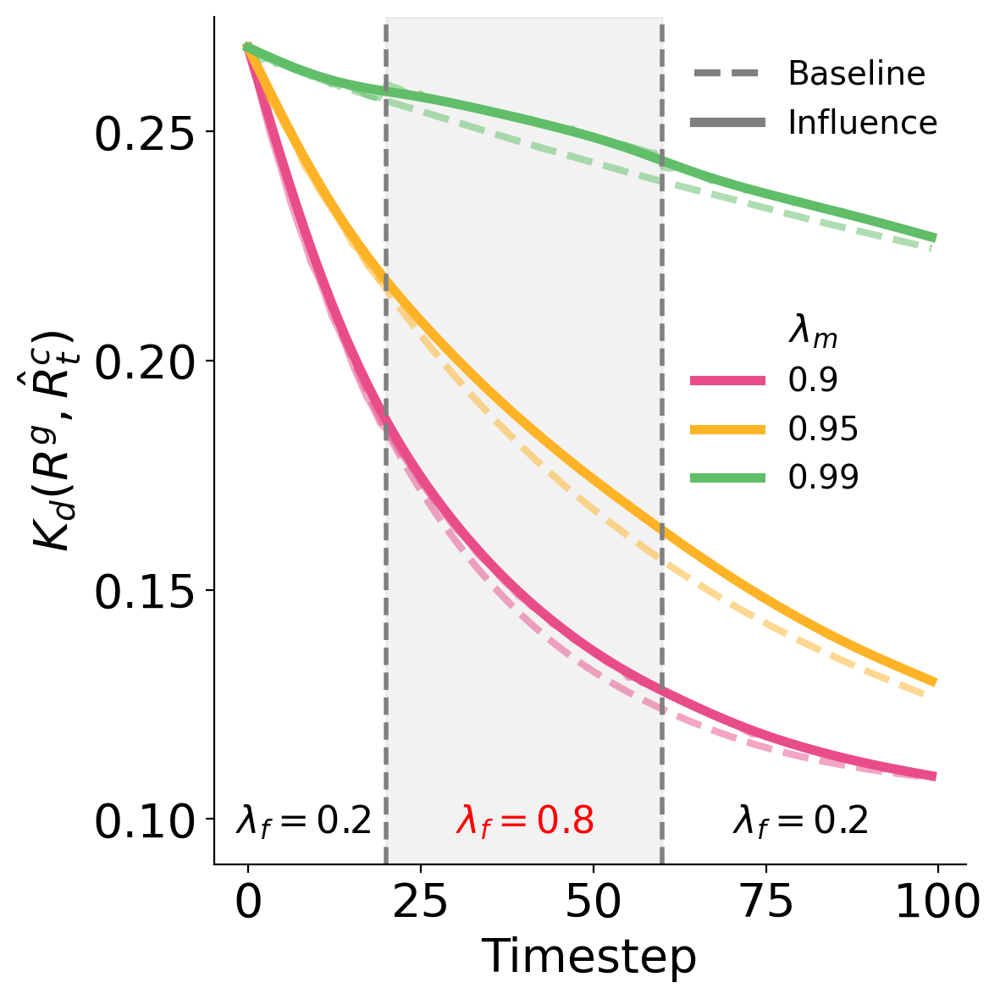

In [113]:
# memory_strength, iv_time, iv_s2

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list
line_list = []

for m, memory in enumerate(memory_strength_list):
    
    y = np.mean(avg_gt1_kd_list[m], axis=0)
    ax.plot(y, lw=2, alpha=0.5, color=color_list[m], ls='-')

    lambda_ = 0.2
    denoised_signal = total_variation_denoising(y, lambda_)
    line=ax.plot(denoised_signal, lw=4, color=color_list[m], label=f'{memory}')
    line_list.append(line[0])
    
    y =np.mean(base_gt1_kd_list[m], axis=0)
    denoised_signal = total_variation_denoising(y, lambda_)
    ax.plot(denoised_signal, lw=3, alpha=0.5, color=color_list[m], ls='--')
    
ax.axvline(x=iv_t1_list[0], ls='--', lw=2, color='gray')
ax.axvline(x=iv_t2_list[0], ls='--', lw=2, color='gray')
ax.axvspan(iv_t1_list[0], iv_t2_list[0], color='black', alpha=0.05)

ax.text((iv_t1_list[0]) / 2 * 0.8, 0.095, r'$\lambda_f=0.2$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1_list[0] + iv_t2_list[0]) / 2, 0.095, r'$\lambda_f=0.8$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2_list[0]) / 2 , 0.095, r'$\lambda_f=0.2$', ha='center', va='bottom', fontsize=16, color='k')

ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel(r'$K_d(R^g, \hat{R}_t^c)$', fontsize=20)

ax.set_ylim(0.09, 0.275)
ax.set_yticks([0.1, 0.15, 0.2, 0.25])

ax.spines[['right', 'top']].set_visible(False)
legend1 = ax.legend(title="      "+r"$\lambda_m$", title_fontsize=16, handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.4), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label='Baseline')
line_list.append(custom_line)
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label='Influence')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.82), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig4c.svg", format="svg", transparent=True, bbox_inches='tight')

### 4d. Align (diff)

In [4]:
folder_name = '1_align'
model_type = 'simple'

topic_num = 250
comm_num = 1000
timestep = 100

filter_strength = 0.2
target_topic = 25

iv_t1_list = [20]
iv_s1 = 0.8
iv_s2_list = [0.2]
iv_t2_list = [60]

init_type = 'fixed'
init_freq_std = 0.0
memory_strength_list = [0.9, 0.95, 0.99]

store_events = 'F'
store_extra = 'F'
store_weight = 'F'
store_corr = 'F'

desc_list = range(10)

In [992]:
dist = {'l2': False, 'js':False, 'kd':True, 'corr':False}

l1 = len(memory_strength_list)
l2 = len(iv_t1_list)
l3 = len(iv_t2_list)
l4 = len(iv_s2_list)
l5 = len(desc_list)

total_gt1_kd_list = [[] for _ in range(l1)]
total_gt1_kd_base_list = [[] for _ in range(l1)]
timelist = [500, 500, 100]

for m, memory_strength in enumerate(memory_strength_list):
    for iv_t1 in iv_t1_list:
        for iv_t2 in iv_t2_list:
            for iv_s2 in iv_s2_list:
                for desc in desc_list:
                    print(memory_strength, iv_t1, iv_t2, iv_s2, desc)
                    
                    sim_name = f'sim_T250_C{comm_num}_E1000_ET3_F{filter_strength}_M{memory_strength}_IT{init_type}_IF{init_freq_std}_IV11_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_-1_-1_t{timestep}_{desc}'
                    
                    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
                    comm_num = parameters['comm_num']
                    timestep = parameters['timestep']
                    raw_freq_list = results['raw_freq_list']
                    general_freq = results['general_freq']
                    
                    gt1_kd_list = []
                    tg_data = general_freq/np.sum(general_freq)
                    t = timestep-1
                    
                    for c in range(comm_num):
                        t_data = raw_freq_list[c][t]/np.sum(raw_freq_list[c][t])
                        gt1_kd_list.append(kendalltau_dist(tg_data, t_data))
                                
                    total_gt1_kd_list[m].append(gt1_kd_list)
                    
                    # base
                    
                    sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_IT{init_type}_IF{init_freq_std}_IV00_0_0.0_0_0.0_{target_topic}_-1_t{timelist[m]}_{desc}'
                    
                    parameters, results = load_comp_model_result('0_base', model_type, sim_name)
                    comm_num = parameters['comm_num']
                    raw_freq_list = results['raw_freq_list']
                    general_freq = results['general_freq']
                    
                    gt1_kd_list = []
                    tg_data = general_freq/np.sum(general_freq)
                    t = timestep-1
                    
                    for c in range(comm_num):
                        t_data = raw_freq_list[c][t]/np.sum(raw_freq_list[c][t])
                        gt1_kd_list.append(kendalltau_dist(tg_data, t_data))
                                
                    total_gt1_kd_base_list[m].append(gt1_kd_list)

np.savez('figure/figure_data/fig4d2.npz', total_gt1_kd_list=np.array(total_gt1_kd_list), total_gt1_kd_base_list=np.array(total_gt1_kd_base_list))

0.9 20 60 0.2 0
0.9 20 60 0.2 1
0.9 20 60 0.2 2
0.9 20 60 0.2 3
0.9 20 60 0.2 4
0.9 20 60 0.2 5
0.9 20 60 0.2 6
0.9 20 60 0.2 7
0.9 20 60 0.2 8
0.9 20 60 0.2 9
0.95 20 60 0.2 0
0.95 20 60 0.2 1
0.95 20 60 0.2 2
0.95 20 60 0.2 3
0.95 20 60 0.2 4
0.95 20 60 0.2 5
0.95 20 60 0.2 6
0.95 20 60 0.2 7
0.95 20 60 0.2 8
0.95 20 60 0.2 9
0.99 20 60 0.2 0
0.99 20 60 0.2 1
0.99 20 60 0.2 2
0.99 20 60 0.2 3
0.99 20 60 0.2 4
0.99 20 60 0.2 5
0.99 20 60 0.2 6
0.99 20 60 0.2 7
0.99 20 60 0.2 8
0.99 20 60 0.2 9


In [17]:
results = np.load('figure/figure_data/fig4d1.npz')
total_gt1_kd_list1 = results['total_gt1_kd_list']
total_gt1_kd_base_list1 = results['total_gt1_kd_base_list']

results = np.load('figure/figure_data/fig4d2.npz')
total_gt1_kd_list2 = results['total_gt1_kd_list']
total_gt1_kd_base_list2 = results['total_gt1_kd_base_list']

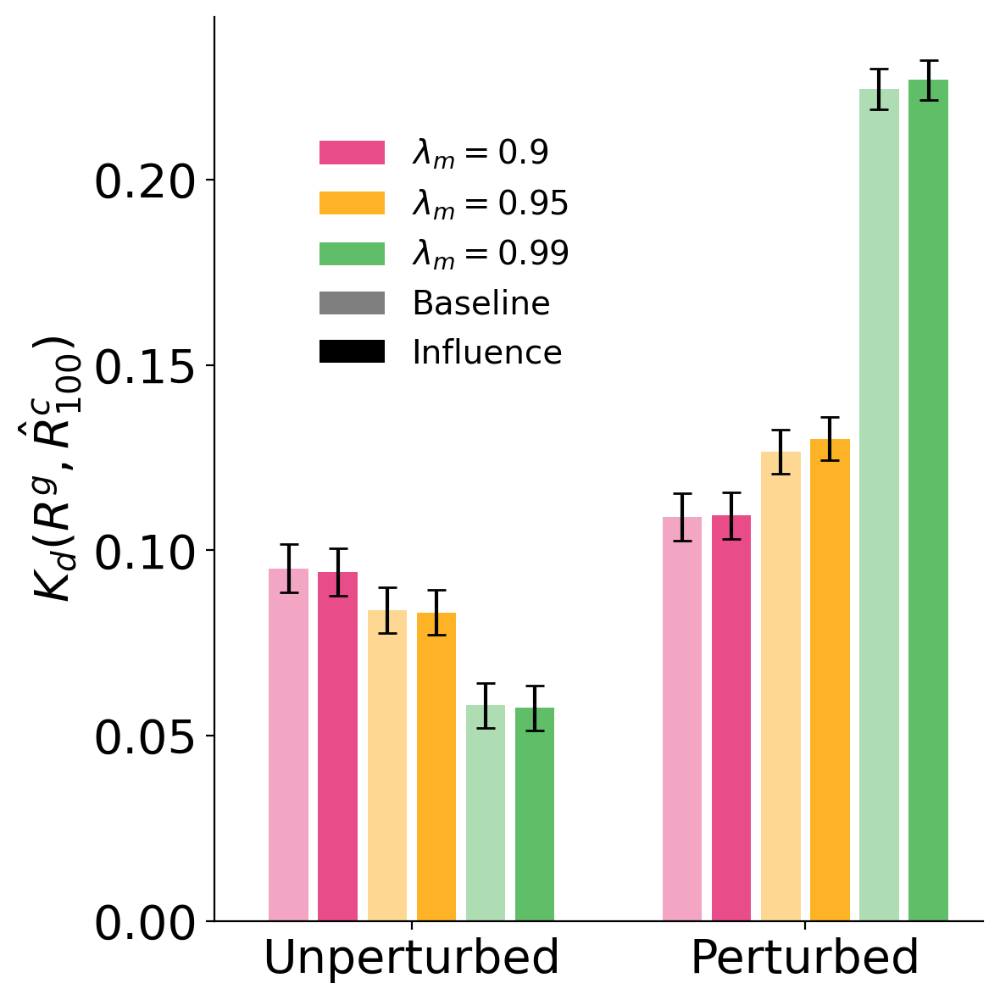

In [19]:
# memory_strength, iv_time, iv_s2

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list
line_list = []

memory_strength_list = [0.9, 0.95, 0.99]

for m, memory in enumerate(memory_strength_list):
    ax.bar(x=m, height=np.mean(total_gt1_kd_base_list1[m].flatten()), yerr=np.std(total_gt1_kd_base_list1[m].flatten()), capsize=4, color=color_list[m], width=0.4, alpha=0.5)
    ax.bar(x=m+0.5, height=np.mean(total_gt1_kd_list1[m].flatten()), yerr=np.std(total_gt1_kd_list1[m].flatten()), capsize=4, color=color_list[m], width=0.4)

for m, memory in enumerate(memory_strength_list):
    ax.bar(x=m+4, height=np.mean(total_gt1_kd_base_list2[m].flatten()), yerr=np.std(total_gt1_kd_base_list2[m].flatten()), capsize=4, color=color_list[m], width=0.4, alpha=0.5)
    line = ax.bar(x=m+4.5, height=np.mean(total_gt1_kd_list2[m].flatten()), yerr=np.std(total_gt1_kd_list2[m].flatten()), capsize=4, color=color_list[m], width=0.4, label="$\lambda_m=$"+f'{memory}')
    line_list.append(line)

#ax.set_xlabel('Timestep', fontsize=20)
ax.set_xticks([1.25, 5.25])
ax.set_xticklabels(['Unperturbed', 'Perturbed'])
ax.set_ylabel(r'$K_d(R^g, \hat{R}_{100}^c)$', fontsize=20)

#ax.set_ylim(0.09, 0.275)
#ax.set_yticks([0.1, 0.15, 0.2, 0.25])

custom_line = ax.bar(x=[0], height=[0], color='k', alpha=0.5, label='Baseline')
line_list.append(custom_line)

custom_line = ax.bar(x=[0], height=[0], color='k', label='Influence')
line_list.append(custom_line)

legend = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.5, 0.9), fontsize=14)

# Remove small ticks and increase tick font size
ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig4d.svg", format="svg", transparent=True, bbox_inches='tight')

### 4f. Amp (event)

In [ ]:
folder_name = '2_amp'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

check = 50
tier=0

iv_t1 = 100
iv_s1 = 25.0
iv_t2 = 300
iv_s2 = 1.0

desc_range = range(10)

freq_list = []
base_freq_list = []

event_freq_list = []
base_event_freq_list = []

top_weight_list = []
bottom_weight_list = []

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)
        
        tmp_base_freq_list = []
        tmp_base_event_freq_list = []
        
        for i in desc_range:
            print('base', i)
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV00_0_0.0_0_0.0_{target_topic}_-1_t500_{i}'
            parameters, results = load_comp_model_result('0_base', model_type, sim_name)

            comm_num = parameters['comm_num']
            filtered_events_list_list = results['filtered_events_list_list']
            raw_freq_list = results['raw_freq_list']
            weight_list = results['weight_list']

            base_event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_base_event_freq_list.append(base_event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            base_freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_base_freq_list.append(base_freq)
            
        base_event_freq_list.append(np.mean(tmp_base_event_freq_list, axis=0))
        base_freq_list.append(np.mean(tmp_base_freq_list, axis=0))
        
        top_list = np.array([np.argsort(-weight_list[i*100][0])[:check] for i in range(10)])
        bottom_list = np.array([np.argsort(-weight_list[i*100][0])[-check-1:-1] for i in range(10)])

        base_weight_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :,:], axis=0) for i in range(10)])
        base_weight_top_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :, top_list[i]], axis=0) for i in range(10)])
        base_weight_top_list = base_weight_top_list.transpose(0, 2, 1).reshape(-1, timestep+1)
        base_weight_bottom_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :, bottom_list[i]], axis=0) for i in range(10)])
        base_weight_bottom_list = base_weight_bottom_list.transpose(0, 2, 1).reshape(-1, timestep+1)
        
        tmp_event_freq_list = []
        tmp_freq_list = []
        top_weight_mean_list_list = []
        bottom_weight_mean_list_list = []
        
        for i in desc_range:
            print(i)
    
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV21_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t{timestep}_{i}'
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

            comm_num = parameters['comm_num']
            raw_freq_list = results['raw_freq_list']
            weight_list = results['weight_list']
            filtered_events_list_list = results['filtered_events_list_list']
            
            event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_event_freq_list.append(event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_freq_list.append(np.mean(freq, axis=0))
            
            top_weight_mean_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :, top_list[i]], axis=0) for i in range(10)])
            top_weight_mean_list = top_weight_mean_list.transpose(0, 2, 1).reshape(-1, timestep+1)
            top_weight_mean_list_list.append(top_weight_mean_list)
            
            bottom_weight_mean_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :, bottom_list[i]], axis=0) for i in range(10)])
            bottom_weight_mean_list = bottom_weight_mean_list.transpose(0, 2, 1).reshape(-1, timestep+1)
            bottom_weight_mean_list_list.append(bottom_weight_mean_list)
            
        top_weight_mean_list = np.mean(top_weight_mean_list_list, axis=0)
        bottom_weight_mean_list = np.mean(bottom_weight_mean_list_list, axis=0)

        top_weight_list.append(np.mean([top_weight_mean_list[i, :] - base_weight_top_list[i, :] for i in range(len(top_weight_mean_list))], axis=0))
        bottom_weight_list.append(np.mean([bottom_weight_mean_list[i, :] - base_weight_bottom_list[i, :] for i in range(len(bottom_weight_mean_list))], axis=0))

        event_freq_list.append(np.mean(tmp_event_freq_list, axis=0))
        freq_list.append(np.mean(tmp_freq_list, axis=0))
        
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_21'), 
                    freq_list=np.array(freq_list), base_freq_list=np.array(base_freq_list),
                    event_freq_list=np.array(event_freq_list), base_event_freq_list=np.array(base_event_freq_list),
                    top_weight_list=np.array(top_weight_list), bottom_weight_list=np.array(bottom_weight_list))

In [4]:
folder_name = '2_amp'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

check = 50
tier=0

iv_t1 = 100
iv_s1 = 25.0
iv_t2 = 300
iv_s2 = 1.0

desc_range = range(10, 30)

freq_list = []
base_freq_list = []

event_freq_list = []
base_event_freq_list = []

top_weight_list = []
bottom_weight_list = []

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)

        tmp_event_freq_list = []

        for i in desc_range:
            print(i)
    
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV21_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t{timestep}_{i}'
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name, tmp=True)

            comm_num = parameters['comm_num']
            filtered_events_list_list = results['filtered_events_list_list']
            
            event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_event_freq_list.append(event_freq)
            
        event_freq_list.append(np.mean(tmp_event_freq_list, axis=0))


np.savez_compressed(join('comp_model', 'model_result_tmp', f'summary_21_3'),
                    event_freq_list=np.array(event_freq_list))

0.2 0.9
10


11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
0.2 0.95
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
0.8 0.9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
0.8 0.95
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


In [ ]:
folder_name = '2_amp'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_21.npz'))
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']

data2 = np.load(join('comp_model', 'model_result_tmp', f'summary_21_2.npz'))
event_freq_list2 = data2['event_freq_list']

data3 = np.load(join('comp_model', 'model_result_tmp', f'summary_21_3.npz'))
event_freq_list3 = data3['event_freq_list']

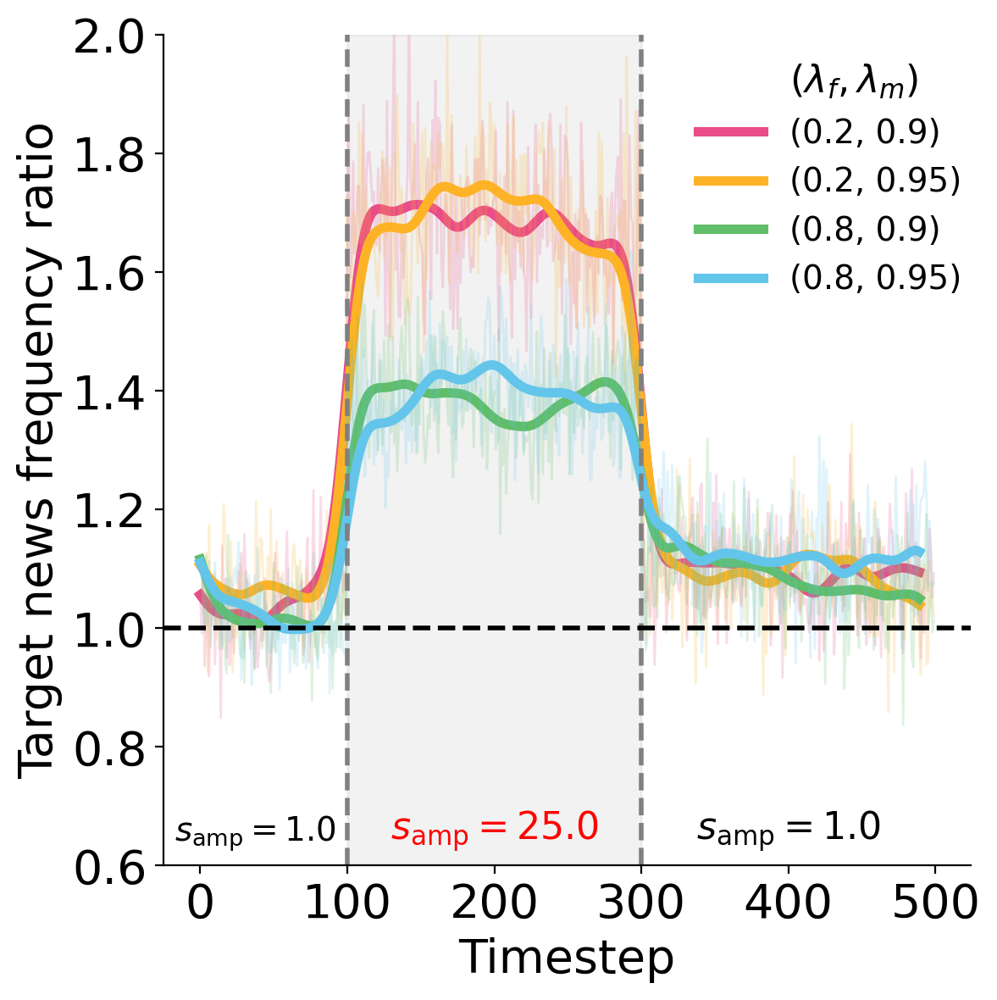

In [20]:
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250

iv_t1 = 100
iv_s1 = 25.0
iv_t2 = 300
iv_s2 = 1.0

sc = 50
sn = timestep//sc

counter = 0
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list

denoise_cut = 10

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        #y = data_list[counter]
        
        a = [np.mean(base_event_freq_list[counter][i*sc: (i+1)*sc]) for i in range(sn)]
        y1 = np.concatenate([event_freq_list[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        y2 = np.concatenate([event_freq_list2[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        y3 = np.concatenate([event_freq_list3[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        y = (y1+y2*2+y3*2)/5
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(np.arange(0, timestep-denoise_cut), denoised_signal[:-denoise_cut], lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        counter +=1
            
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.62
ax.text((iv_t1) / 2 * 0.75, y_text, r'$s_{\mathrm{amp}}=1.0$', ha='center', va='bottom', fontsize=14, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$s_{\mathrm{amp}}=25.0$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$s_{\mathrm{amp}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(0.6, 2.0)
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target news frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.625, 0.65), fontsize=14)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig4f.svg", format="svg", transparent=True, bbox_inches='tight')

### 4g. Amp (comment)

In [22]:
folder_name = '2_amp'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_21.npz'))
freq_list = data['freq_list']
base_freq_list = data['base_freq_list']
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']
top_weight_list = data['top_weight_list']
bottom_weight_list = data['bottom_weight_list']

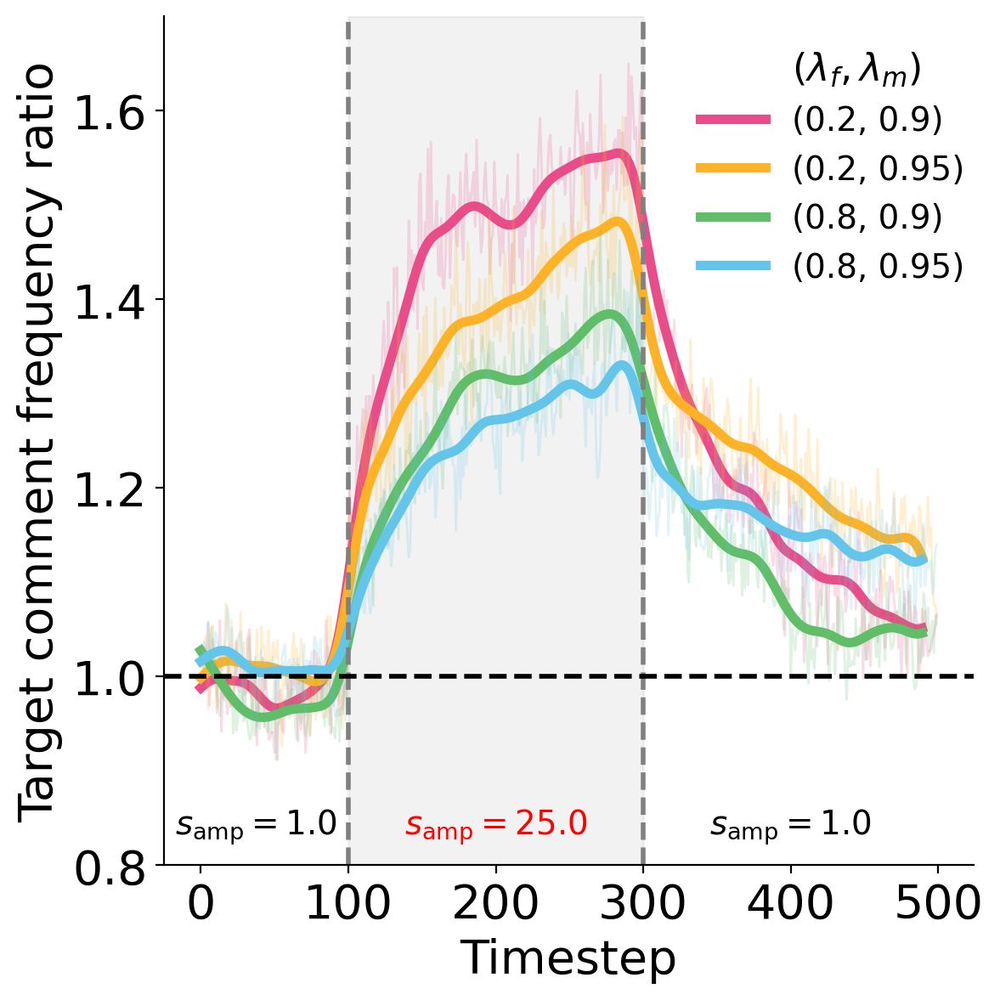

In [24]:
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250

iv_t1 = 100
iv_s1 = 25.0
iv_t2 = 300
iv_s2 = 1.0

sc = 100
sn = timestep//sc

counter = 0
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list

denoise_cut = 10

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        #y = data_list[counter]
        
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(np.arange(0, timestep-denoise_cut), denoised_signal[:-denoise_cut], lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        counter +=1
            
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.82
ax.text((iv_t1) / 2 * 0.75, y_text, r'$s_{\mathrm{amp}}=1.0$', ha='center', va='bottom', fontsize=14, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$s_{\mathrm{amp}}=25.0$', ha='center', va='bottom', fontsize=14, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$s_{\mathrm{amp}}=1.0$', ha='center', va='bottom', fontsize=14, color='k')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(0.8, 1.7)
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target comment frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.625, 0.65), fontsize=14)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig4g.svg", format="svg", transparent=True, bbox_inches='tight')

### 4h. Amp (sim)

In [ ]:
folder_name = '2_amp'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_21.npz'))
freq_list = data['freq_list']
base_freq_list = data['base_freq_list']
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']
top_weight_list = data['top_weight_list']
bottom_weight_list = data['bottom_weight_list']

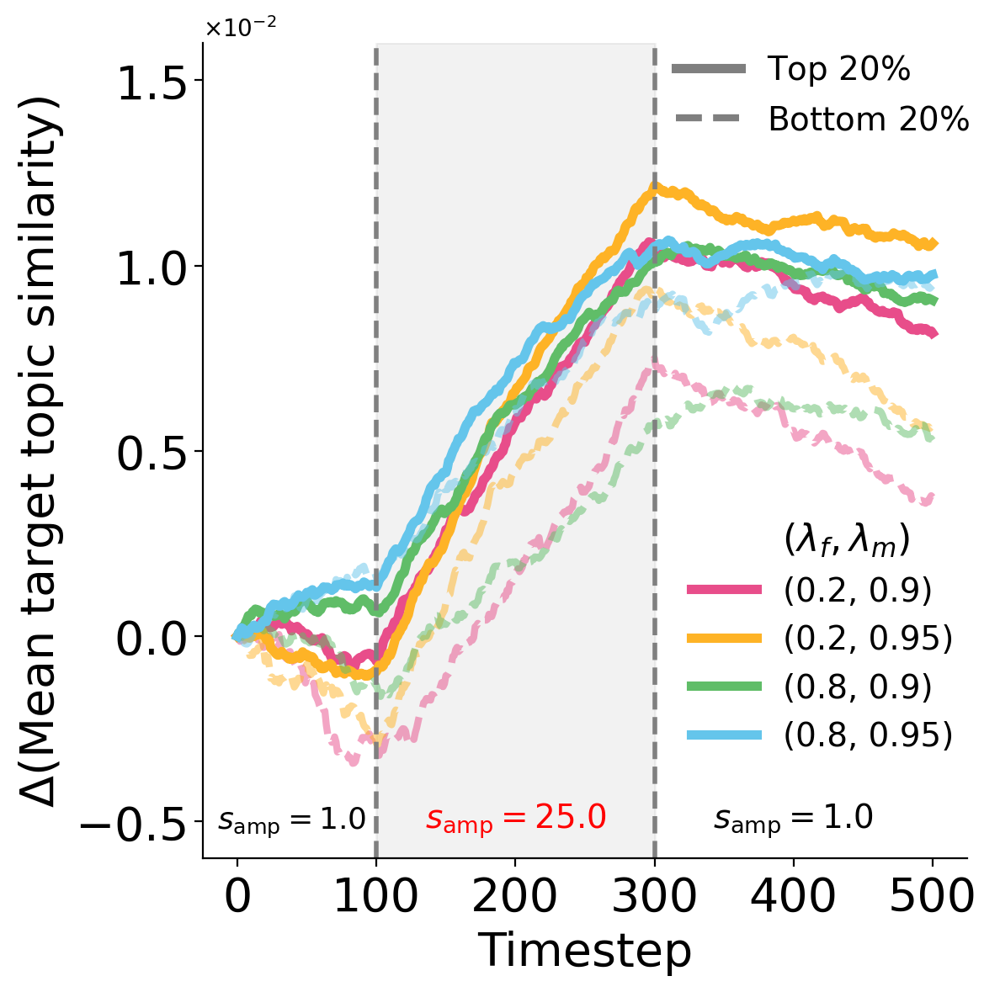

In [852]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
counter=0
color_list = orig2_color_list
filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
counter=0
line_list = []


for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:

        line = ax.plot(top_weight_list[counter], ls='-', color=color_list[counter], lw=4, label=f'({filter_strength}, {memory_strength})')
        ax.plot(bottom_weight_list[counter], ls='--', color=color_list[counter], lw=3, alpha=0.5)
        line_list.append(line[0])
        counter+=1

ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = -0.0055
ax.text((iv_t1) / 2 * 0.78, y_text, r'$s_{\mathrm{amp}}=1.0$', ha='center', va='bottom', fontsize=13, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$s_{\mathrm{amp}}=25.0$', ha='center', va='bottom', fontsize=14, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$s_{\mathrm{amp}}=1.0$', ha='center', va='bottom', fontsize=14, color='k')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(-0.006, 0.016)
ax.ticklabel_format(style='sci', axis='y', scilimits=(0,0), useMathText=True)
#ax.set_yticks([-0.005, 0.0, 0.005, 0.01, 0.015])
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel(r'$\Delta$'+'(Mean target topic similarity)', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
#ax.legend(bbox_to_anchor = (0.56, 0.95), fontsize=14)


#ax.legend(handles=line_list, fontsize=14, bbox_to_anchor = (0.23, 1.02), loc = 'upper center')
legend1=ax.legend(handles=line_list, title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.6, 0.45), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label='Top '+r'$20\%$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label='Bottom '+r'$20\%$')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.58, 0.85), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig4h.svg", format="svg", transparent=True, bbox_inches='tight')

### 4j. Ref (event 2)

In [810]:
folder_name = '3_ref'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

iv_t1 = 100
iv_s1 = 0.04
iv_t2 = 300
iv_s2 = 0.0
counter = 0

init_type = 'fixed'
init_freq_std = 0.0

data_list = []

desc_range = range(10)

freq_list = []
base_freq_list = []

event_freq_list = []
base_event_freq_list = []

top_weight_list = []
bottom_weight_list = []

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)
        
        tmp_base_freq_list = []
        tmp_base_event_freq_list = [[] for _ in range(3)]
        
        for i in desc_range:
            print('base', i)
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV00_0_0.0_0_0.0_{target_topic}_-1_t500_{i}'
            parameters, results = load_comp_model_result('0_base', model_type, sim_name)

            comm_num = parameters['comm_num']
            filtered_events_list_list = results['filtered_events_list_list']
            raw_freq_list = results['raw_freq_list']
            weight_list = results['weight_list']

            for tier in range(3):
                base_event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
                tmp_base_event_freq_list[tier].append(base_event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            base_freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_base_freq_list.append(base_freq)
            
        base_event_freq_list.append(np.mean(np.array(tmp_base_event_freq_list), axis=1))
        base_freq_list.append(np.mean(tmp_base_freq_list, axis=0))
        
        top_list = np.array([np.argsort(-weight_list[i*100][0])[:check] for i in range(10)])
        bottom_list = np.array([np.argsort(-weight_list[i*100][0])[-check-1:-1] for i in range(10)])

        base_weight_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :,:], axis=0) for i in range(10)])
        base_weight_top_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :, top_list[i]], axis=0) for i in range(10)])
        base_weight_top_list = base_weight_top_list.transpose(0, 2, 1).reshape(-1, timestep+1)
        base_weight_bottom_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :, bottom_list[i]], axis=0) for i in range(10)])
        base_weight_bottom_list = base_weight_bottom_list.transpose(0, 2, 1).reshape(-1, timestep+1)
        
        tmp_event_freq_list = [[] for _ in range(3)]
        tmp_freq_list = []
        top_weight_mean_list_list = []
        bottom_weight_mean_list_list = []
        
        for i in desc_range:
            print(i)
    
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV31_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t{timestep}_{i}'
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

            comm_num = parameters['comm_num']
            raw_freq_list = results['raw_freq_list']
            weight_list = results['weight_list']
            filtered_events_list_list = results['filtered_events_list_list']
            
            for tier in range(3):
                event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
                tmp_event_freq_list[tier].append(event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_freq_list.append(np.mean(freq, axis=0))
            
            top_weight_mean_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :, top_list[i]], axis=0) for i in range(10)])
            top_weight_mean_list = top_weight_mean_list.transpose(0, 2, 1).reshape(-1, timestep+1)
            top_weight_mean_list_list.append(top_weight_mean_list)
            
            bottom_weight_mean_list = np.array([np.mean(weight_list[i*100:(i+1)*100, :, bottom_list[i]], axis=0) for i in range(10)])
            bottom_weight_mean_list = bottom_weight_mean_list.transpose(0, 2, 1).reshape(-1, timestep+1)
            bottom_weight_mean_list_list.append(bottom_weight_mean_list)
            
        top_weight_mean_list = np.mean(top_weight_mean_list_list, axis=0)
        bottom_weight_mean_list = np.mean(bottom_weight_mean_list_list, axis=0)

        top_weight_list.append(np.mean([top_weight_mean_list[i, :] - base_weight_top_list[i, :] for i in range(len(top_weight_mean_list))], axis=0))
        bottom_weight_list.append(np.mean([bottom_weight_mean_list[i, :] - base_weight_bottom_list[i, :] for i in range(len(bottom_weight_mean_list))], axis=0))

        event_freq_list.append(np.mean(np.array(tmp_event_freq_list), axis=1))
        freq_list.append(np.mean(tmp_freq_list, axis=0))
        
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_31'), 
                    freq_list=np.array(freq_list), base_freq_list=np.array(base_freq_list),
                    event_freq_list=np.array(event_freq_list), base_event_freq_list=np.array(base_event_freq_list),
                    top_weight_list=np.array(top_weight_list), bottom_weight_list=np.array(bottom_weight_list))

0.2 0.9
base 0


base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
0.2 0.95
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
0.8 0.9
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
0.8 0.95
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9


In [860]:
folder_name = '3_ref'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250

iv_t1 = 100
iv_s1 = 0.04
iv_t2 = 300
iv_s2 = 0.0
tier = 2

init_type = 'fixed'
init_freq_std = 0.0

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_31.npz'))
freq_list = data['freq_list']
base_freq_list = data['base_freq_list']
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']
top_weight_list = data['top_weight_list']
bottom_weight_list = data['bottom_weight_list']

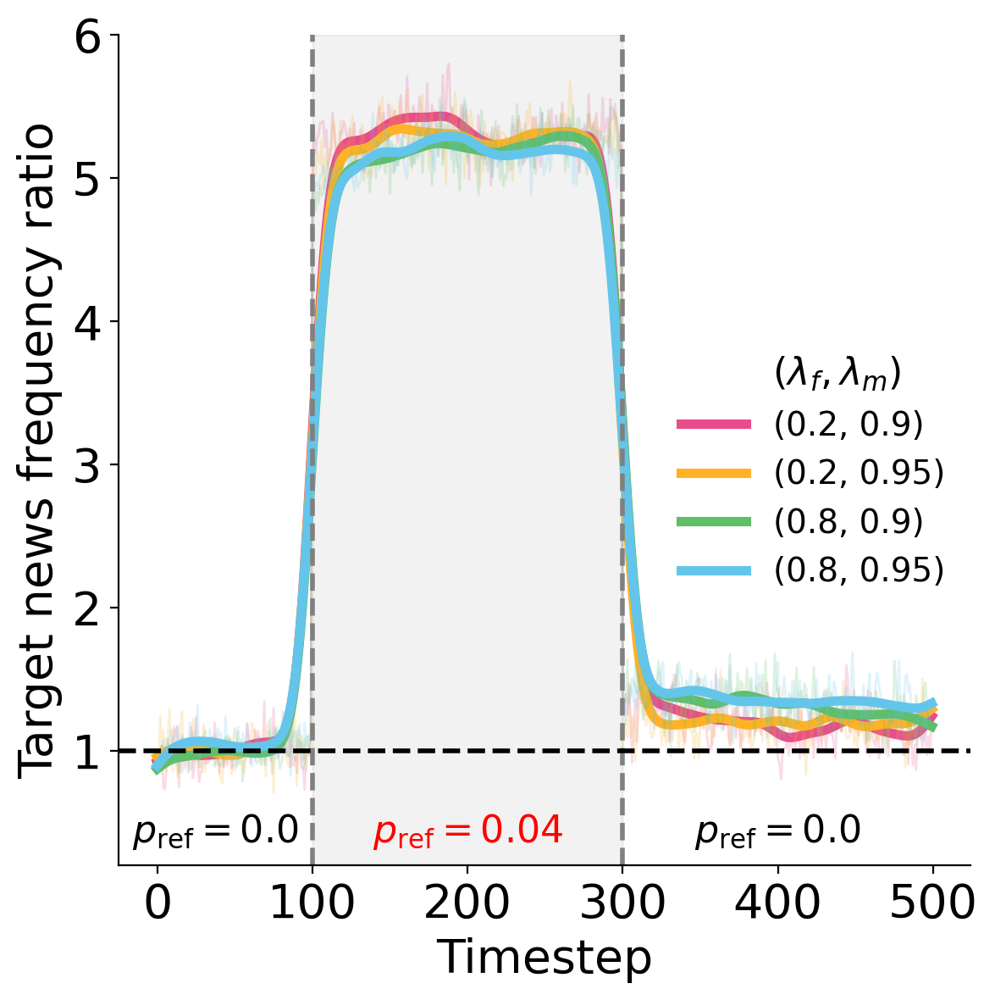

In [861]:
counter = 0
sc = 100
sn = timestep//sc
tier=1

counter = 0
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        #y = data_list[counter]
        
        a = [np.mean(base_event_freq_list[counter][tier][i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([event_freq_list[counter][tier][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        counter +=1
            
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.3
ax.text((iv_t1) / 2 * 0.75, y_text, r'$p_{\mathrm{ref}}=0.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$p_{\mathrm{ref}}=0.04$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$p_{\mathrm{ref}}=0.0$', ha='center', va='bottom', fontsize=16, color='k')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(0.2, 6)
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target news frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.625, 0.65), fontsize=14)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig4j.svg", format="svg", transparent=True, bbox_inches='tight')

### 4k. Ref (event 1)

In [25]:
folder_name = '3_ref'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250

iv_t1 = 100
iv_s1 = 0.04
iv_t2 = 300
iv_s2 = 0.0
tier = 2

init_type = 'fixed'
init_freq_std = 0.0

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_31.npz'))
freq_list = data['freq_list']
base_freq_list = data['base_freq_list']
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']
top_weight_list = data['top_weight_list']
bottom_weight_list = data['bottom_weight_list']

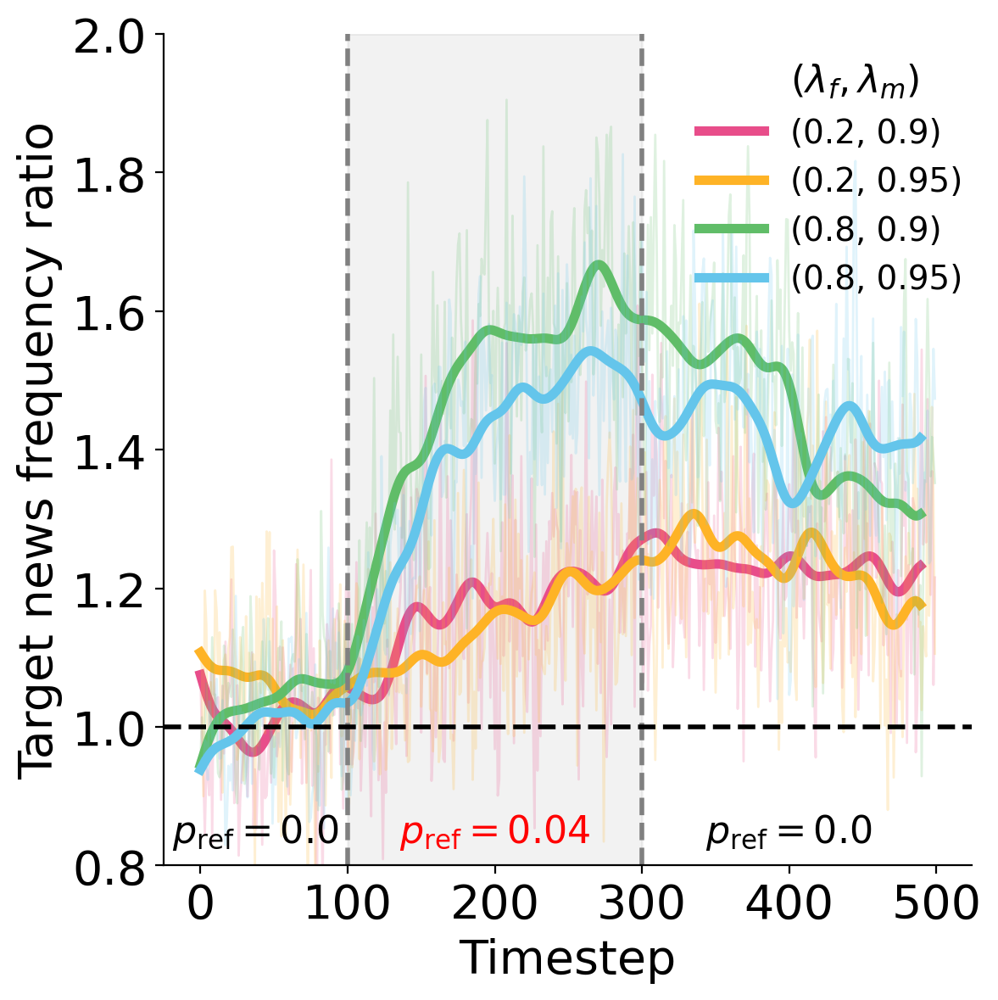

In [26]:
counter = 0
sc = 100
sn = timestep//sc
tier=0

counter = 0
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list

denosie_cut = 10

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        #y = data_list[counter]
        
        a = [np.mean(base_event_freq_list[counter][tier][i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([event_freq_list[counter][tier][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(np.arange(0, timestep-denoise_cut), denoised_signal[:-denoise_cut], lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        counter +=1
            
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.82
ax.text((iv_t1) / 2 * 0.75, y_text, r'$p_{\mathrm{ref}}=0.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$p_{\mathrm{ref}}=0.04$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$p_{\mathrm{ref}}=0.0$', ha='center', va='bottom', fontsize=16, color='k')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(0.8, 2)
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target news frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.625, 0.65), fontsize=14)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig4k.svg", format="svg", transparent=True, bbox_inches='tight')

### 4l. Ref (sim)

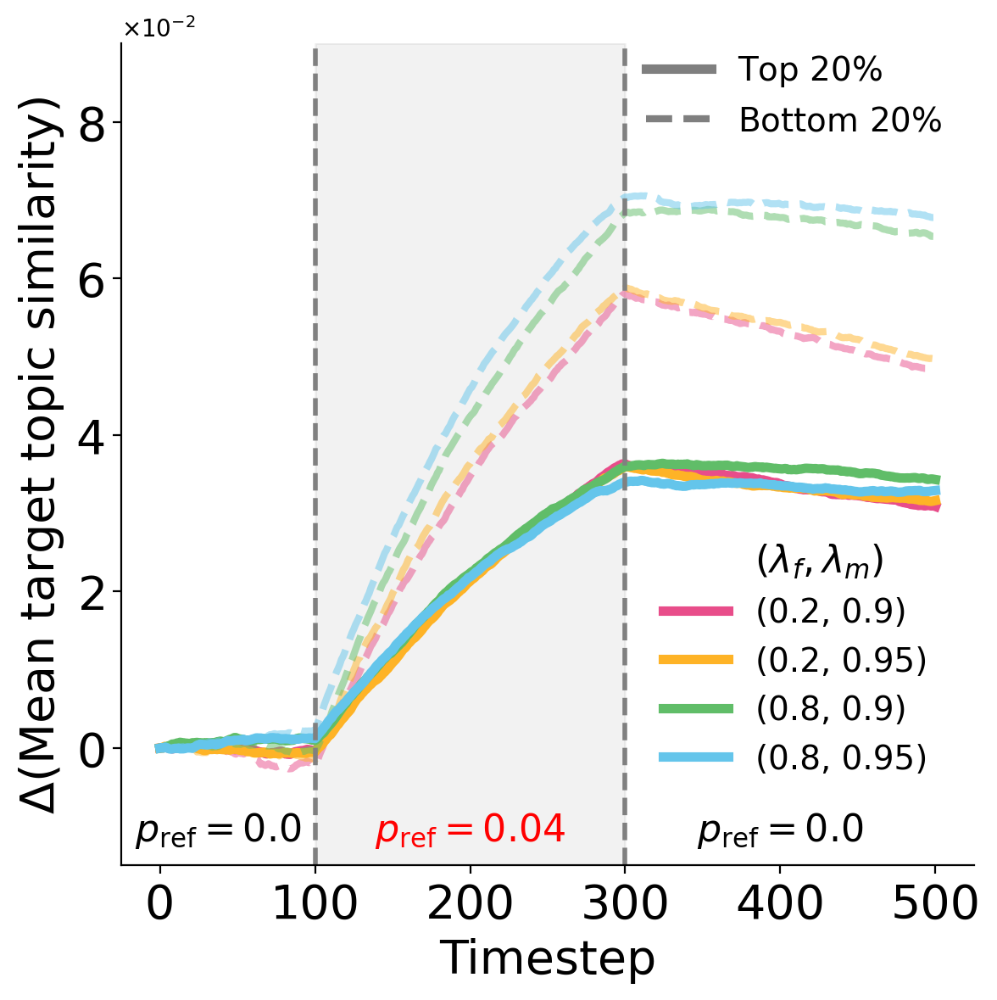

In [857]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
counter=0
color_list = orig2_color_list
filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
counter=0
line_list = []


for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:

        line = ax.plot(top_weight_list[counter], ls='-', color=color_list[counter], lw=4, label=f'({filter_strength}, {memory_strength})')
        ax.plot(bottom_weight_list[counter], ls='--', color=color_list[counter], lw=3, alpha=0.5)
        line_list.append(line[0])
        counter+=1

ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = -0.013
ax.text((iv_t1) / 2 * 0.75, y_text, r'$p_{\mathrm{ref}}=0.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$p_{\mathrm{ref}}=0.04$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$p_{\mathrm{ref}}=0.0$', ha='center', va='bottom', fontsize=16, color='k')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(-0.015, 0.09)
ax.ticklabel_format(style='sci', axis='y', scilimits=(0,0), useMathText=True)
#ax.set_yticks([-0.005, 0.0, 0.005, 0.01, 0.015])
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel(r'$\Delta$'+'(Mean target topic similarity)', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
#ax.legend(bbox_to_anchor = (0.56, 0.95), fontsize=14)


#ax.legend(handles=line_list, fontsize=14, bbox_to_anchor = (0.23, 1.02), loc = 'upper center')
legend1=ax.legend(handles=line_list, title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.6, 0.43), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label='Top '+r'$20\%$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label='Bottom '+r'$20\%$')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.58, 0.85), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig4l.svg", format="svg", transparent=True, bbox_inches='tight')

## Figure 5. User influence

### 5b. Mem 0.0 (KD)

In [1043]:
folder_name = '4_member'
model_type = 'simple'

topic_num = 250
comm_num = 1000
timestep = 100

memory_strength = 0.99

iv_t1_list = [20]
iv_s1 = 0.95
iv_s2_list = [0.99]
iv_t2_list = [60]

#init_type = 'fixed'
init_type = 'perturb'
#init_freq_std = 1.0
#init_freq_std = 0.0
init_freq_std = 0.2
filter_strength_list = [0.2, 0.5, 0.8]

store_events = 'F'
store_extra = 'F'
store_weight = 'F'
store_corr = 'F'

desc_list = range(10)

In [ ]:
dist = {'l2': True, 'js':True, 'kd':True, 'corr':True}

l1 = len(filter_strength_list)
l2 = len(iv_t1_list)
l3 = len(iv_t2_list)
l4 = len(iv_s2_list)
l5 = len(desc_list)

avg_gt1_l2_list = [[] for _ in range(l1)]
avg_gt1_kd_list = [[] for _ in range(l1)]
avg_gt1_js_list = [[] for _ in range(l1)]
avg_gt1_corr_list = [[] for _ in range(l1)]

for f, filter_strength in enumerate(filter_strength_list):
    for iv_t1 in iv_t1_list:
        for iv_t2 in iv_t2_list:
            for iv_s2 in iv_s2_list:
                for desc in desc_list:
                    print(filter_strength, iv_t1, iv_t2, iv_s2, desc)
                    sim_name = f'sim_T250_C{comm_num}_E1000_ET3_F{filter_strength}_M{memory_strength}_IT{init_type}_IF{init_freq_std}_IV41_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_-1_-1_t{timestep}_{desc}'
                    result_dict = compute_stats_general(folder_name, model_type, sim_name, dist)
                    
                    gt1_l2_list = result_dict['l2']
                    gt1_js_list = result_dict['js']
                    gt1_kd_list = result_dict['kd']
                    gt1_corr_list = result_dict['corr']
                
                    avg_gt1_l2_list[f].append(np.mean(gt1_l2_list, axis=0))
                    avg_gt1_js_list[f].append(np.mean(gt1_js_list, axis=0))
                    avg_gt1_kd_list[f].append(np.mean(gt1_kd_list, axis=0))
                    avg_gt1_corr_list[f].append(np.mean(gt1_corr_list, axis=0))
                    
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_41_3'), 
                    avg_gt1_l2_list=np.array(avg_gt1_l2_list), avg_gt1_js_list=np.array(avg_gt1_js_list), 
                    avg_gt1_kd_list=np.array(avg_gt1_kd_list), avg_gt1_corr_list=np.array(avg_gt1_corr_list))
                

0.2 20 60 0.99 0
0.2 20 60 0.99 1
0.2 20 60 0.99 2
0.2 20 60 0.99 3
0.2 20 60 0.99 4
0.2 20 60 0.99 5
0.2 20 60 0.99 6
0.2 20 60 0.99 7
0.2 20 60 0.99 8
0.2 20 60 0.99 9
0.5 20 60 0.99 0
0.5 20 60 0.99 1
0.5 20 60 0.99 2
0.5 20 60 0.99 3
0.5 20 60 0.99 4
0.5 20 60 0.99 5
0.5 20 60 0.99 6
0.5 20 60 0.99 7
0.5 20 60 0.99 8
0.5 20 60 0.99 9
0.8 20 60 0.99 0
0.8 20 60 0.99 1
0.8 20 60 0.99 2
0.8 20 60 0.99 3
0.8 20 60 0.99 4
0.8 20 60 0.99 5
0.8 20 60 0.99 6
0.8 20 60 0.99 7
0.8 20 60 0.99 8
0.8 20 60 0.99 9


In [ ]:
dist = {'l2': True, 'js':True, 'kd':True, 'corr':True}

base_gt1_l2_list = [[] for _ in range(l1)]
base_gt1_kd_list = [[] for _ in range(l1)]
base_gt1_js_list = [[] for _ in range(l1)]
base_gt1_corr_list = [[] for _ in range(l1)]

for f, filter_strength in enumerate(filter_strength_list):
    for desc in desc_list:
        print(filter_strength, desc)
        folder_name = '0_base'
        sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_IT{init_type}_IF{init_freq_std}_IV99_0_0.0_0_0.0_{target_topic}_-1_t{timestep}_{desc}'
            
        result_dict = compute_stats_general(folder_name, model_type, sim_name, dist)
        
        gt1_l2_list = result_dict['l2']
        gt1_js_list = result_dict['js']
        gt1_kd_list = result_dict['kd']
        gt1_corr_list = result_dict['corr']

        base_gt1_l2_list[f].append(np.mean(gt1_l2_list, axis=0))
        base_gt1_js_list[f].append(np.mean(gt1_js_list, axis=0))
        base_gt1_kd_list[f].append(np.mean(gt1_kd_list, axis=0))
        base_gt1_corr_list[f].append(np.mean(gt1_corr_list, axis=0))
    
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type,  f'summary_41_3_base'), 
        base_gt1_l2_list=np.array(base_gt1_l2_list), base_gt1_js_list=np.array(base_gt1_js_list), 
        base_gt1_kd_list=np.array(base_gt1_kd_list), base_gt1_corr_list=np.array(base_gt1_corr_list))

In [116]:
# load data
folder_name = '4_member'
file_name = 'summary_41_2.npz'
data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, file_name))
avg_gt1_l2_list = data['avg_gt1_l2_list']
avg_gt1_js_list = data['avg_gt1_js_list']
avg_gt1_kd_list = data['avg_gt1_kd_list']
avg_gt1_corr_list = data['avg_gt1_corr_list']

folder_name = '0_base'
file_name = 'summary_41_2_base.npz'
data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, file_name))
base_gt1_l2_list = data['base_gt1_l2_list']
base_gt1_js_list = data['base_gt1_js_list']
base_gt1_kd_list = data['base_gt1_kd_list']
base_gt1_corr_list = data['base_gt1_corr_list']

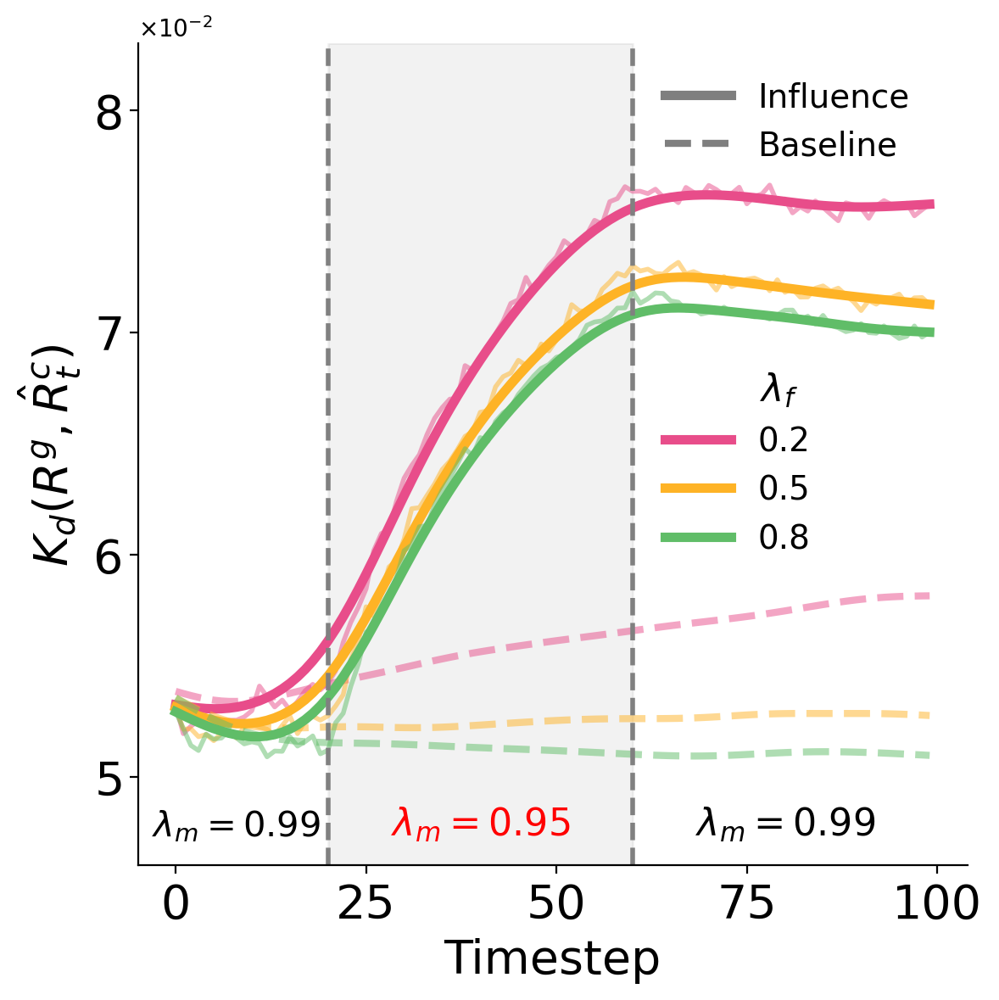

In [117]:
# memory_strength, iv_time, iv_s2

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list
line_list = []

for f, fs in enumerate(filter_strength_list):
    
    y = np.mean(avg_gt1_kd_list[f], axis=0)
    ax.plot(y, lw=2, alpha=0.5, color=color_list[f], ls='-')

    lambda_ = 0.2
    denoised_signal = total_variation_denoising(y, lambda_)

    line=ax.plot(denoised_signal, lw=4, color=color_list[f], label=f'{fs}')
    line_list.append(line[0])
    
    y = np.mean(base_gt1_kd_list[f], axis=0)
    denoised_signal = total_variation_denoising(y, lambda_)
    ax.plot(denoised_signal, lw=3, alpha=0.5, color=color_list[f], ls='--')
    
ax.axvline(x=iv_t1_list[0], ls='--', lw=2, color='gray')
ax.axvline(x=iv_t2_list[0], ls='--', lw=2, color='gray')
ax.axvspan(iv_t1_list[0], iv_t2_list[0], color='black', alpha=0.05)

ax.set_ylim(0.046, 0.083)
ax.set_yticks([0.05, 0.06, 0.07, 0.08])
ax.ticklabel_format(style='sci', axis='y', scilimits=(0,0), useMathText=True)

y_text = 0.047
ax.text((iv_t1_list[0]) / 2 * 0.8, y_text, r'$\lambda_m=0.99$', ha='center', va='bottom', fontsize=15, color='k')
ax.text((iv_t1_list[0] + iv_t2_list[0]) / 2, y_text, r'$\lambda_m=0.95$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2_list[0]) / 2 , y_text, r'$\lambda_m=0.99$', ha='center', va='bottom', fontsize=16, color='k')

ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel(r'$K_d(R^g, \hat{R}_t^c)$', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
legend1 = ax.legend(title="       "+r"$\lambda_f$", title_fontsize=16, handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.49), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label='Influence')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label='Baseline')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.82), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig5b.svg", format="svg", transparent=True, bbox_inches='tight')

### 5c. Mem 1.0 (KD)

In [118]:
# load data
folder_name = '4_member'
file_name = 'summary_41.npz'
data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, file_name))
avg_gt1_l2_list = data['avg_gt1_l2_list']
avg_gt1_js_list = data['avg_gt1_js_list']
avg_gt1_kd_list = data['avg_gt1_kd_list']
avg_gt1_corr_list = data['avg_gt1_corr_list']

folder_name = '0_base'
file_name = 'summary_41_base.npz'
data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, file_name))
base_gt1_l2_list = data['base_gt1_l2_list']
base_gt1_js_list = data['base_gt1_js_list']
base_gt1_kd_list = data['base_gt1_kd_list']
base_gt1_corr_list = data['base_gt1_corr_list']

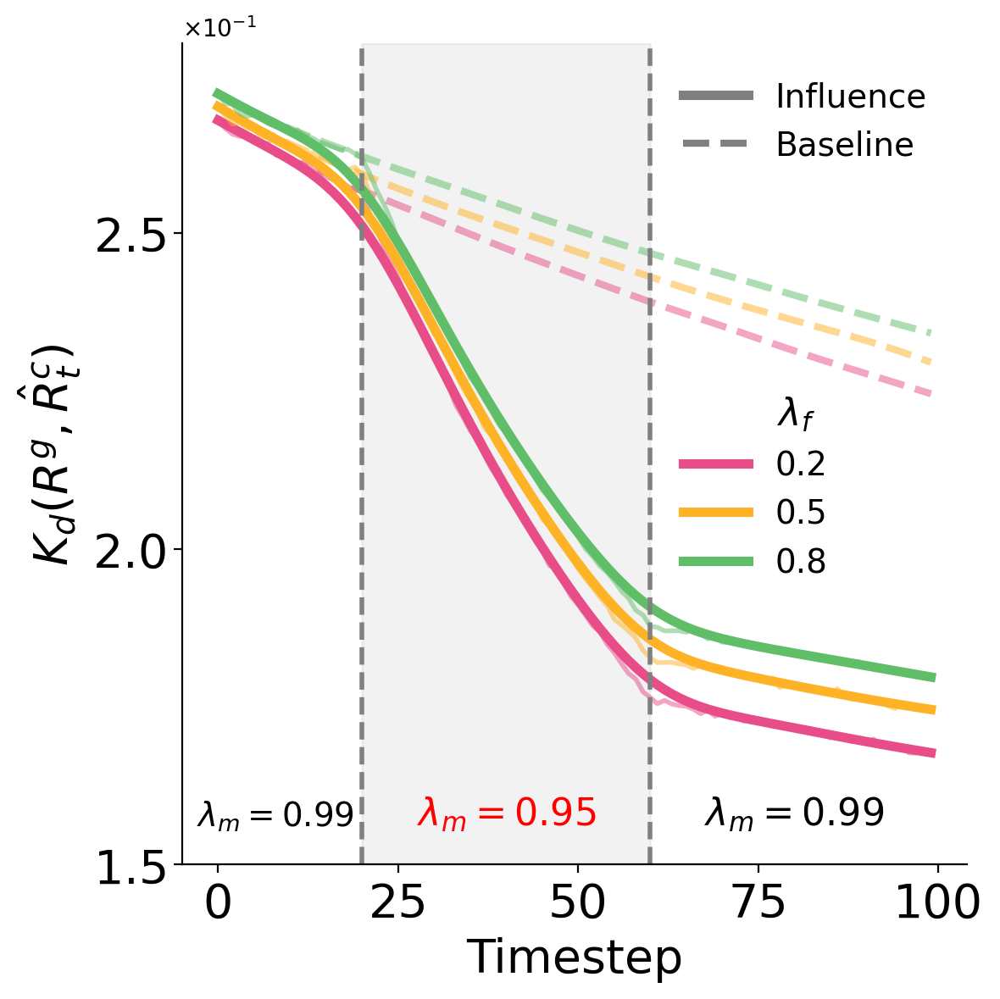

In [119]:
# memory_strength, iv_time, iv_s2

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list
line_list = []

for f, fs in enumerate(filter_strength_list):
    
    y = np.mean(avg_gt1_kd_list[f], axis=0)
    ax.plot(y, lw=2, alpha=0.5, color=color_list[f], ls='-')

    lambda_ = 0.2
    denoised_signal = total_variation_denoising(y, lambda_)

    line=ax.plot(denoised_signal, lw=4, color=color_list[f], label=f'{fs}')
    line_list.append(line[0])
    
    y = np.mean(base_gt1_kd_list[f], axis=0)
    denoised_signal = total_variation_denoising(y, lambda_)
    ax.plot(denoised_signal, lw=3, alpha=0.5, color=color_list[f], ls='--')
    
ax.axvline(x=iv_t1_list[0], ls='--', lw=2, color='gray')
ax.axvline(x=iv_t2_list[0], ls='--', lw=2, color='gray')
ax.axvspan(iv_t1_list[0], iv_t2_list[0], color='black', alpha=0.05)

ax.set_ylim(0.16, 0.28)
ax.set_yticks([0.15, 0.2, 0.25])
ax.ticklabel_format(style='sci', axis='y', scilimits=(0,0), useMathText=True)

y_text = 0.155
ax.text((iv_t1_list[0]) / 2 * 0.8, y_text, r'$\lambda_m=0.99$', ha='center', va='bottom', fontsize=14, color='k')
ax.text((iv_t1_list[0] + iv_t2_list[0]) / 2, y_text, r'$\lambda_m=0.95$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2_list[0]) / 2 , y_text, r'$\lambda_m=0.99$', ha='center', va='bottom', fontsize=16, color='k')

ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel(r'$K_d(R^g, \hat{R}_t^c)$', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
legend1 = ax.legend(title="       "+r"$\lambda_f$", title_fontsize=16, handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.46), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label='Influence')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label='Baseline')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.82), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig5c.svg", format="svg", transparent=True, bbox_inches='tight')

### 5d. Mem (diff)

In [18]:
folder_name = '4_member'
model_type = 'simple'

topic_num = 250
comm_num = 1000
timestep = 100

memory_strength = 0.99

iv_t1_list = [20]
iv_s1 = 0.95
iv_s2_list = [0.99]
iv_t2_list = [60]

init_type = 'fixed'
init_freq_std = 0.0
filter_strength_list = [0.2, 0.5, 0.8]

store_events = 'F'
store_extra = 'F'
store_weight = 'F'
store_corr = 'F'

desc_list = range(10)

In [19]:
dist = {'l2': False, 'js':False, 'kd':True, 'corr':False}

l1 = len(memory_strength_list)
l2 = len(iv_t1_list)
l3 = len(iv_t2_list)
l4 = len(iv_s2_list)
l5 = len(desc_list)

total_gt1_kd_list = [[] for _ in range(l1)]
total_gt1_kd_base_list = [[] for _ in range(l1)]
timelist = [100, 100, 100]

for f, filter_strength in enumerate(filter_strength_list):
    for iv_t1 in iv_t1_list:
        for iv_t2 in iv_t2_list:
            for iv_s2 in iv_s2_list:
                for desc in desc_list:
                    print(memory_strength, iv_t1, iv_t2, iv_s2, desc)
                    
                    sim_name = f'sim_T250_C{comm_num}_E1000_ET3_F{filter_strength}_M{memory_strength}_IT{init_type}_IF{init_freq_std}_IV12_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_-1_-1_t{timestep}_{desc}'
                    
                    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
                    comm_num = parameters['comm_num']
                    timestep = parameters['timestep']
                    raw_freq_list = results['raw_freq_list']
                    general_freq = results['general_freq']
                    
                    gt1_kd_list = []
                    tg_data = general_freq/np.sum(general_freq)
                    t = timestep-1
                    
                    for c in range(comm_num):
                        t_data = raw_freq_list[c][t]/np.sum(raw_freq_list[c][t])
                        gt1_kd_list.append(kendalltau_dist(tg_data, t_data))
                                
                    total_gt1_kd_list[f].append(gt1_kd_list)
                    
                    # base
                    
                    sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_IT{init_type}_IF{init_freq_std}_IV00_0_0.0_0_0.0_{target_topic}_-1_t{timelist[f]}_{desc}'
                    
                    parameters, results = load_comp_model_result('0_base', model_type, sim_name)
                    comm_num = parameters['comm_num']
                    raw_freq_list = results['raw_freq_list']
                    general_freq = results['general_freq']
                    
                    gt1_kd_list = []
                    tg_data = general_freq/np.sum(general_freq)
                    t = timestep-1
                    
                    for c in range(comm_num):
                        t_data = raw_freq_list[c][t]/np.sum(raw_freq_list[c][t])
                        gt1_kd_list.append(kendalltau_dist(tg_data, t_data))
                                
                    total_gt1_kd_base_list[f].append(gt1_kd_list)

np.savez('figure/figure_data/fig5d2.npz', total_gt1_kd_list=np.array(total_gt1_kd_list), total_gt1_kd_base_list=np.array(total_gt1_kd_base_list))

0.99 20 60 0.99 0


0.99 20 60 0.99 1
0.99 20 60 0.99 2
0.99 20 60 0.99 3
0.99 20 60 0.99 4
0.99 20 60 0.99 5
0.99 20 60 0.99 6
0.99 20 60 0.99 7
0.99 20 60 0.99 8
0.99 20 60 0.99 9
0.99 20 60 0.99 0
0.99 20 60 0.99 1
0.99 20 60 0.99 2
0.99 20 60 0.99 3
0.99 20 60 0.99 4
0.99 20 60 0.99 5
0.99 20 60 0.99 6
0.99 20 60 0.99 7
0.99 20 60 0.99 8
0.99 20 60 0.99 9
0.99 20 60 0.99 0
0.99 20 60 0.99 1
0.99 20 60 0.99 2
0.99 20 60 0.99 3
0.99 20 60 0.99 4
0.99 20 60 0.99 5
0.99 20 60 0.99 6
0.99 20 60 0.99 7
0.99 20 60 0.99 8
0.99 20 60 0.99 9


In [20]:
results = np.load('figure/figure_data/fig5d1.npz')
total_gt1_kd_list1 = results['total_gt1_kd_list']
total_gt1_kd_base_list1 = results['total_gt1_kd_base_list']

results = np.load('figure/figure_data/fig5d2.npz')
total_gt1_kd_list2 = results['total_gt1_kd_list']
total_gt1_kd_base_list2 = results['total_gt1_kd_base_list']

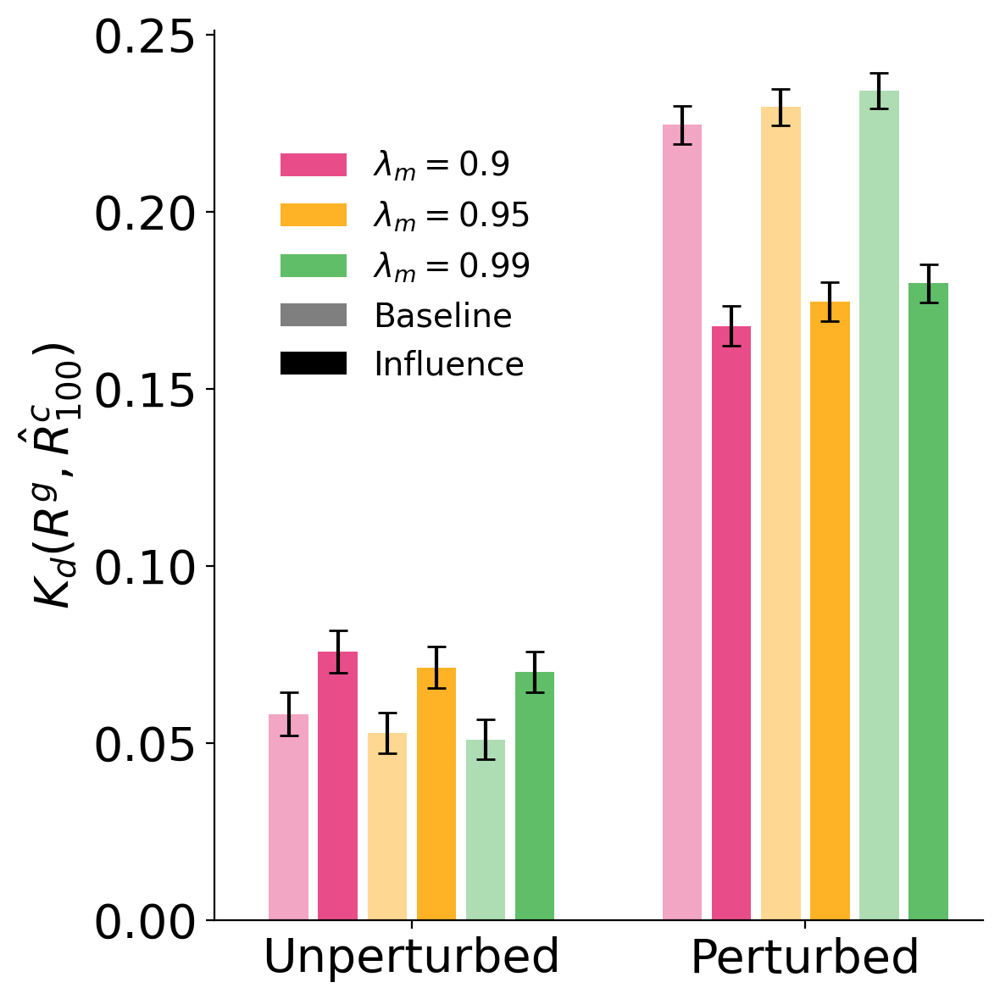

In [21]:
# memory_strength, iv_time, iv_s2

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list
line_list = []

filter_strength_list = [0.2, 0.5, 0.8]

for m, memory in enumerate(memory_strength_list):
    ax.bar(x=m+4, height=np.mean(total_gt1_kd_base_list1[m].flatten()), yerr=np.std(total_gt1_kd_base_list1[m].flatten()), capsize=4, color=color_list[m], width=0.4, alpha=0.5)
    ax.bar(x=m+4.5, height=np.mean(total_gt1_kd_list1[m].flatten()), yerr=np.std(total_gt1_kd_list1[m].flatten()), capsize=4, color=color_list[m], width=0.4)

for m, memory in enumerate(memory_strength_list):
    ax.bar(x=m+0, height=np.mean(total_gt1_kd_base_list2[m].flatten()), yerr=np.std(total_gt1_kd_base_list2[m].flatten()), capsize=4, color=color_list[m], width=0.4, alpha=0.5)
    line = ax.bar(x=m+0.5, height=np.mean(total_gt1_kd_list2[m].flatten()), yerr=np.std(total_gt1_kd_list2[m].flatten()), capsize=4, color=color_list[m], width=0.4, label="$\lambda_m=$"+f'{memory}')
    line_list.append(line)

#ax.set_xlabel('Timestep', fontsize=20)
ax.set_xticks([1.25, 5.25])
ax.set_xticklabels(['Unperturbed', 'Perturbed'])
ax.set_ylabel(r'$K_d(R^g, \hat{R}_{100}^c)$', fontsize=20)

#ax.set_ylim(0.09, 0.275)
#ax.set_yticks([0.1, 0.15, 0.2, 0.25])

custom_line = ax.bar(x=[0], height=[0], color='k', alpha=0.5, label='Baseline')
line_list.append(custom_line)

custom_line = ax.bar(x=[0], height=[0], color='k', label='Influence')
line_list.append(custom_line)

legend = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.45, 0.9), fontsize=14)

# Remove small ticks and increase tick font size
ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig5d.svg", format="svg", transparent=True, bbox_inches='tight')

### 5f. Trolls (comment)

In [136]:
folder_name = '5_trolls'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 1.0
counter = 0
    
iv_type = '51'
tier=0

desc_range1 = range(10)
desc_range2 = range(50)

freq_list = []
base_freq_list = []

event_freq_list = []
base_event_freq_list = []


for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)
        
        tmp_base_freq_list = []
        tmp_base_event_freq_list = []
        
        for i in desc_range1:
            print('base', i)
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV00_0_0.0_0_0.0_{target_topic}_-1_t500_{i}'
            parameters, results = load_comp_model_result('0_base', model_type, sim_name)

            comm_num = parameters['comm_num']
            filtered_events_list_list = results['filtered_events_list_list']
            raw_freq_list = results['raw_freq_list']

            base_event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_base_event_freq_list.append(base_event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            base_freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_base_freq_list.append(base_freq)
            
        base_event_freq_list.append(np.mean(tmp_base_event_freq_list, axis=0))
        base_freq_list.append(np.mean(tmp_base_freq_list, axis=0))
        
        tmp_event_freq_list = []
        tmp_freq_list = []
        
        for i in desc_range2:
            print(i)
    
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i}'
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

            comm_num = parameters['comm_num']
            raw_freq_list = results['raw_freq_list']
            filtered_events_list_list = results['filtered_events_list_list']
            
            event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_event_freq_list.append(event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_freq_list.append(np.mean(freq, axis=0))
            
        event_freq_list.append(np.mean(tmp_event_freq_list, axis=0))
        freq_list.append(np.mean(tmp_freq_list, axis=0))
        
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_51'), 
                    freq_list=np.array(freq_list), base_freq_list=np.array(base_freq_list),
                    event_freq_list=np.array(event_freq_list), base_event_freq_list=np.array(base_event_freq_list))

0.2 0.9
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.2 0.95
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.8 0.9
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.8 0.95
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [183]:
folder_name = '5_trolls'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 1.5
counter = 0
    
iv_type = '51'
tier=0

desc_range1 = range(10)
desc_range2 = range(50)

freq_list = []
base_freq_list = []

event_freq_list = []
base_event_freq_list = []

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)
        
        tmp_event_freq_list = []
        tmp_freq_list = []
        
        for i in desc_range2:
            print(i)
    
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i}'
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

            comm_num = parameters['comm_num']
            raw_freq_list = results['raw_freq_list']
            filtered_events_list_list = results['filtered_events_list_list']
            
            event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_event_freq_list.append(event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_freq_list.append(np.mean(freq, axis=0))
            
        event_freq_list.append(np.mean(tmp_event_freq_list, axis=0))
        freq_list.append(np.mean(tmp_freq_list, axis=0))
        
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_51_2'), 
                    freq_list=np.array(freq_list), base_freq_list=np.array(base_freq_list),
                    event_freq_list=np.array(event_freq_list), base_event_freq_list=np.array(base_event_freq_list))

0.2 0.9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.2 0.95
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32


/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.8 0.9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.8 0.95
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [225]:
folder_name = '5_trolls'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_51.npz'))
freq_list = data['freq_list']
base_freq_list = data['base_freq_list']
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_51_2.npz'))
freq_list2 = data['freq_list']
event_freq_list2 = data['event_freq_list']


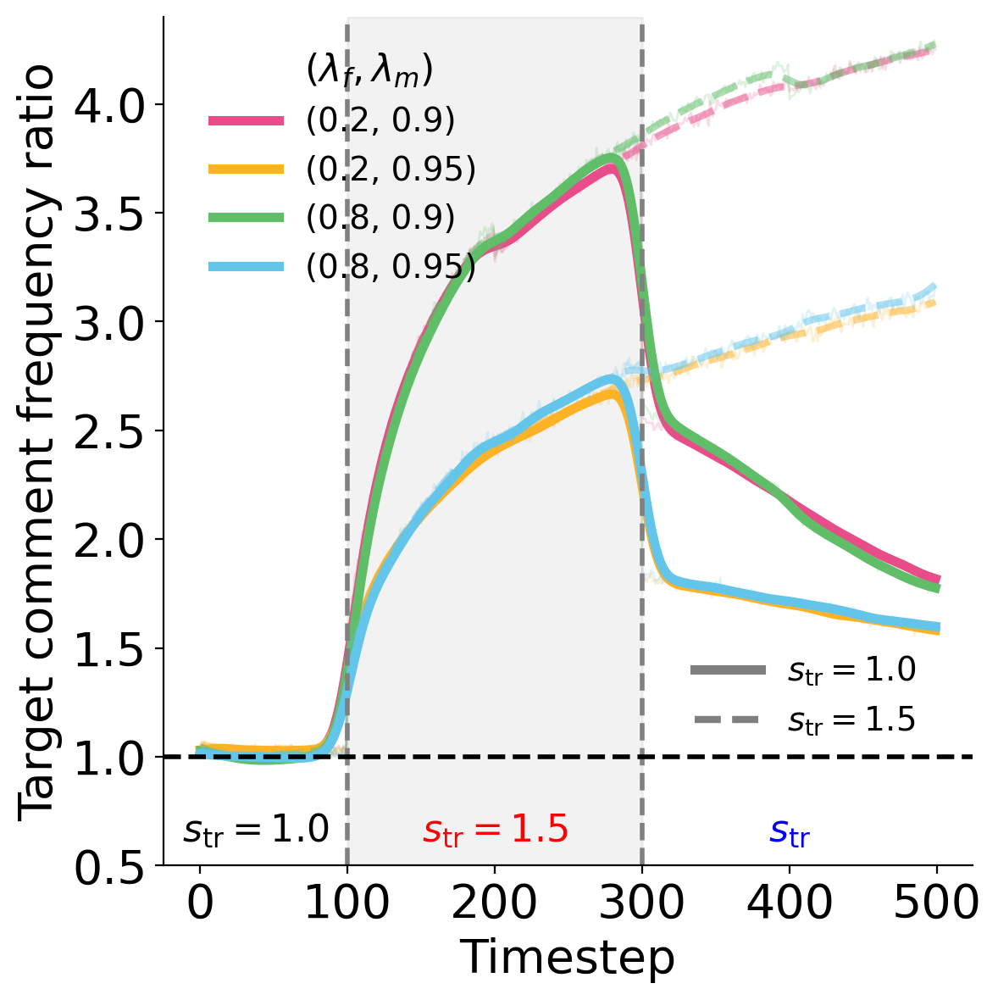

In [235]:
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 1.0

sc = 100
sn = timestep//sc

counter = 0
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list

for i in range(4):
    for j in range(500):
        if np.isnan(freq_list[i][j]):
            freq_list[i][j] = freq_list[i][j-1]
        if np.isnan(freq_list2[i][j]):
            freq_list2[i][j] = freq_list2[i][j-1]

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        #y = data_list[counter]
    
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list2[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=3, color=color_list[counter], ls='--', alpha=0.5)
        
        counter +=1
            
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.57
ax.text((iv_t1) / 2 * 0.75, y_text, r'$s_{\mathrm{tr}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$s_{\mathrm{tr}}$', ha='center', va='bottom', fontsize=16, color='b')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(0.5, 4.4)
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target comment frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
legend1 = ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.425, 0.65), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label=r'$s_{\mathrm{tr}}=1.0$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label=r'$s_{\mathrm{tr}}=1.5$')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.62, 0.2), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig5f.svg", format="svg", transparent=True, bbox_inches='tight')

### 5g. Trolls (event)

In [28]:
folder_name = '5_trolls'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_51.npz'))
freq_list = data['freq_list']
base_freq_list = data['base_freq_list']
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_51_2.npz'))
freq_list2 = data['freq_list']
event_freq_list2 = data['event_freq_list']


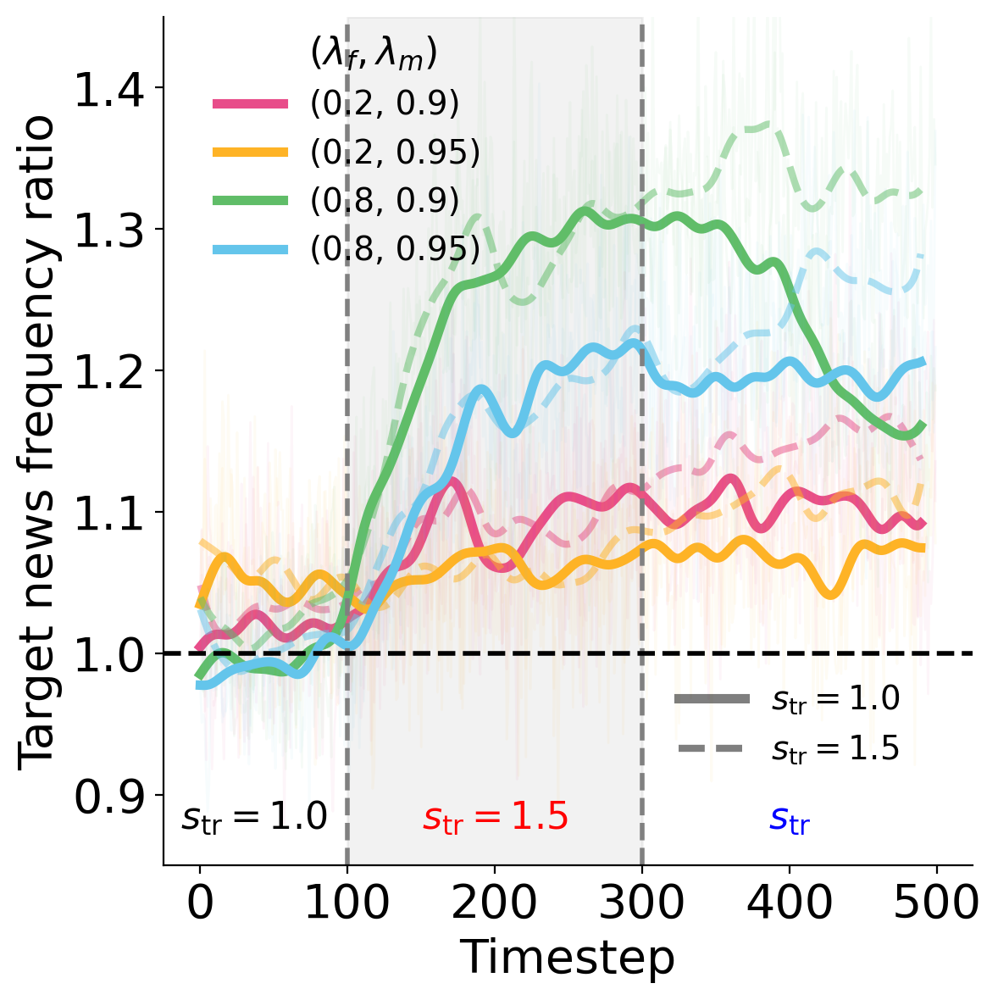

: 

In [ ]:
model_type = 'simple'
color_list = orig2_color_list
lambda_ = 0.4

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)
timestep = 500

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 1.0
    
tier=0
counter = 0

sc = 100
sn = timestep//sc

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
line_list = []

denoise_cut = 10

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        a = [np.mean(base_event_freq_list[counter][i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([event_freq_list2[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
    
        ax.plot(y, lw=1, alpha=0.05, color=color_list[counter], ls='-')

        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(np.arange(0, timestep-denoise_cut), denoised_signal[:-denoise_cut], lw=3, ls='--', alpha=0.5, color=color_list[counter])
        
        a = [np.mean(base_event_freq_list[counter][i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([event_freq_list[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        
        ax.plot(y, lw=1, alpha=0.05, color=color_list[counter], ls='-')

        denoised_signal = total_variation_denoising(y, lambda_)
        line = ax.plot(np.arange(0, timestep-denoise_cut), denoised_signal[:-denoise_cut], lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        line_list.append(line[0])
        
        counter +=1
        
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.87

ax.text((iv_t1) / 2 * 0.73, y_text, r'$s_{\mathrm{tr}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$s_{\mathrm{tr}}$', ha='center', va='bottom', fontsize=16, color='b')

#ax.set_ylim(0.95, 1.4)

ax.set_ylim(0.85, 1.45)

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target news frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
#ax.legend(bbox_to_anchor = (0.43, 0.735), fontsize=14)

legend1 =ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, handles=line_list, frameon=False, bbox_to_anchor = (0.43, 0.67), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label=r'$s_{\mathrm{tr}}=1.0$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label=r'$s_{\mathrm{tr}}=1.5$')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.25), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/fig5g.svg", format="svg", transparent=True, bbox_inches='tight')

### 5h. Trolls (TSNE)

In [60]:
folder_name = '5_trolls'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 1.5
counter = 0
    
iv_type = '51'
tier=0

i1=0
i2=0

freq_list = []
event_freq_list = []
for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)

        tmp_event_freq_list = []
        
        sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i2}'
        parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

        comm_num = parameters['comm_num']
        raw_freq_list = results['raw_freq_list']
        filtered_events_list_list = results['filtered_events_list_list']
        
        for c in range(comm_num):
            if c%100==0:
                print(c)
            tmp_tmp_event_freq_list = []
            for t in range(timestep):
                tmp_tmp_event_freq_list.append(list_to_frequency_vector(data=filtered_events_list_list[t][c, :, tier], num_topics=num_topics))
            tmp_event_freq_list.append(tmp_tmp_event_freq_list)
        event_freq_list.append(tmp_event_freq_list)

        raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
        freq = np.array([[raw_freq_list[c][i] for i in range(timestep)] for c in range(comm_num)])
        freq_list.append(freq)
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_full_51'), 
                    freq_list=np.array(freq_list),event_freq_list=np.array(event_freq_list))

0.2 0.9
0
100
200
300
400
500
600
700
800
900
0.2 0.95
0
100
200
300
400
500
600
700
800
900
0.8 0.9
0
100
200
300
400
500
600
700
800
900
0.8 0.95
0
100
200
300
400
500
600
700
800
900


In [61]:
folder_name = '5_trolls'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 1.0
counter = 0
    
iv_type = '51'
tier=0

i1=0
i2=0

freq_list = []
event_freq_list = []
for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)

        tmp_event_freq_list = []
        
        sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i2}'
        parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

        comm_num = parameters['comm_num']
        raw_freq_list = results['raw_freq_list']
        filtered_events_list_list = results['filtered_events_list_list']
        
        for c in range(comm_num):
            if c%100==0:
                print(c)
            tmp_tmp_event_freq_list = []
            for t in range(timestep):
                tmp_tmp_event_freq_list.append(list_to_frequency_vector(data=filtered_events_list_list[t][c, :, tier], num_topics=num_topics))
            tmp_event_freq_list.append(tmp_tmp_event_freq_list)
        event_freq_list.append(tmp_event_freq_list)

        raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
        freq = np.array([[raw_freq_list[c][i] for i in range(timestep)] for c in range(comm_num)])
        freq_list.append(freq)
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_full_51_2'), 
                    freq_list=np.array(freq_list),event_freq_list=np.array(event_freq_list))

0.2 0.9
0
100
200
300
400
500
600
700
800
900
0.2 0.95
0
100
200
300
400
500
600
700
800
900
0.8 0.9
0
100
200
300
400
500
600
700
800
900
0.8 0.95
0
100
200
300
400
500
600
700
800
900


In [62]:
model_type = 'simple'
filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

folder_name = '5_trolls'

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_full_51.npz')) # 1.5, 1.5
freq_list = data['freq_list']

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_full_51_2.npz')) # 1.5, 1.0
freq_list2 = data['freq_list']
event_freq_list2 = data['event_freq_list']

folder_name = '6_counter'

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_full_61.npz')) # 1.5, 1.5
freq_list3 = data['freq_list']
base_freq_list = data['base_freq_list']

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_full_61_2.npz')) # 1.5, 3.0
freq_list4 = data['freq_list']

In [67]:
total = np.vstack([freq_list, freq_list2, freq_list3, freq_list4])

In [69]:
total = total.reshape(-1, 250)

In [88]:
from sklearn.decomposition import PCA
pca = PCA(n_components=50)
pca.fit(total)
X_pca = pca.transform(total)

In [ ]:
embedding_list_tsne = X_pca
X_embedded = sk.manifold.TSNE(n_components=2).fit_transform(embedding_list_tsne)
total_tsne_list = X_embedded.reshape(4, 4, 1000, 500, 2)
np.savez_compressed('figure/figure_data/fig5.npz', total_tsne_list=total_tsne_list)

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7f581f011ee0>
Traceback (most recent call last):
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().s

In [242]:
def create_colormap(hex_color, base=[0.8, 0.8, 0.8]):
    color_rgb = mpl.colors.hex2color(hex_color)
    return mpl.colors.LinearSegmentedColormap.from_list("custom_colormap", [base, color_rgb])

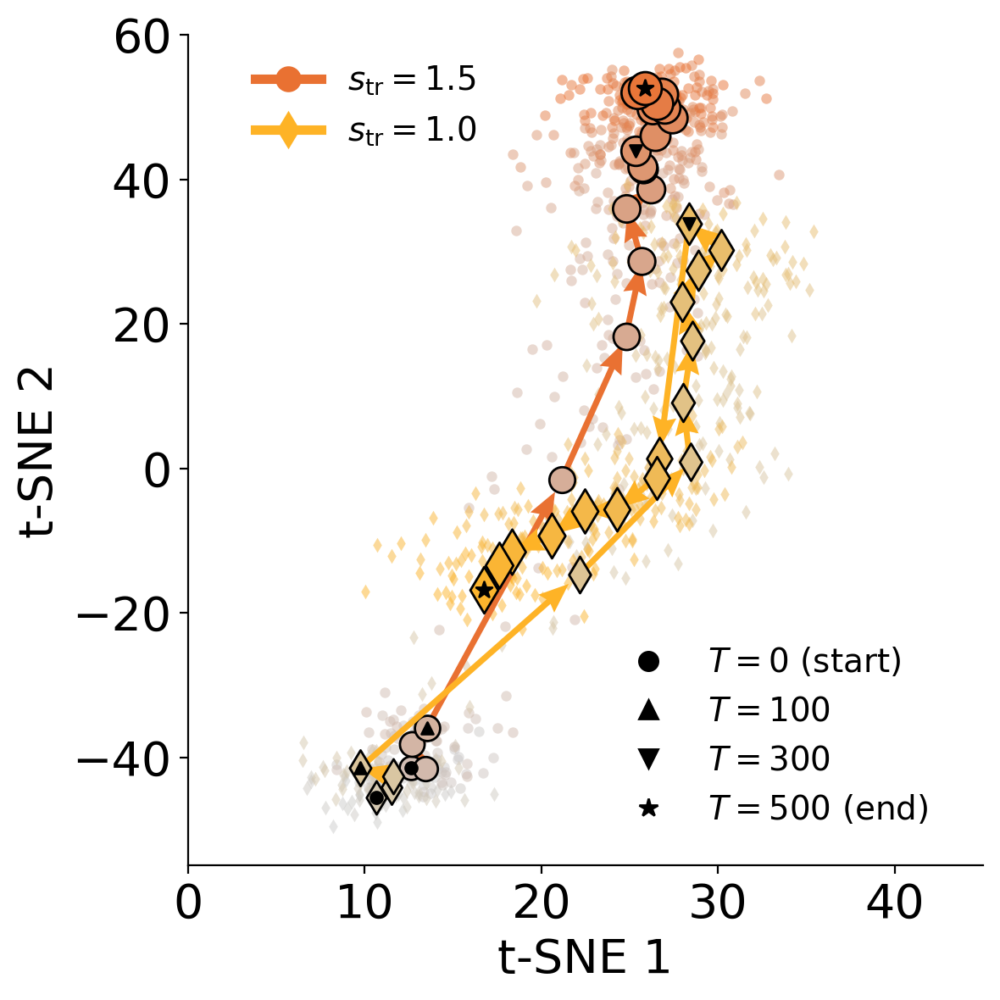

In [284]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig_color_list

tsne1 = total_tsne_list[0][0]
tsne2 = total_tsne_list[1][0]
tsne3 = total_tsne_list[2][0]
tsne4 = total_tsne_list[3][0]

cmap1 = create_colormap(color_list[0])
cmap2 = create_colormap(color_list[1])

for i in range(500):
    ax.scatter(-np.mean(tsne1[:, i, 0]), np.mean(tsne1[:, i, 1]), alpha=0.5, s=20, marker='o', c=[i], cmap=cmap1, vmin=0, vmax=500, linewidth=0)
    ax.scatter(-np.mean(tsne2[:, i, 0]), np.mean(tsne2[:, i, 1]), alpha=0.5, s=20, marker='d', c=[i], cmap=cmap2, vmin=0, vmax=500, linewidth=0)
   

x1 = -np.mean(tsne1[:, :, 0], axis=0)
y1 = np.mean(tsne1[:, :, 1], axis=0)
x2 = -np.mean(tsne2[:, :, 0], axis=0)
y2 = np.mean(tsne2[:, :, 1], axis=0)

step = 25

X1 = np.array([np.mean(x1[i*step: (i+1)*step]) for i in range(500//step)])
Y1 = np.array([np.mean(y1[i*step: (i+1)*step]) for i in range(500//step)])
X2 = np.array([np.mean(x2[i*step: (i+1)*step]) for i in range(500//step)])
Y2 = np.array([np.mean(y2[i*step: (i+1)*step]) for i in range(500//step)])

'''
x11, y11 = X1[:4], Y1[:4]
ax.quiver(x11[:-1], y11[:-1], 0.95*(x11[1:]-x11[:-1]), 0.95*(y11[1:]-y11[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[0], alpha=1.0)

ax.quiver(X1[3], Y1[3], 0.95*(X1[4]-X1[3]), 0.95*(Y1[4]-Y1[3]), scale_units='xy', angles='xy', scale=1, color=color_list[2], alpha=1.0)

x12, y12 = X1[4:], Y1[4:]
ax.quiver(x12[:-1], y12[:-1], 0.95*(x12[1:]-x12[:-1]), 0.95*(y12[1:]-y12[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[0], alpha=1.0)
'''
ax.quiver(X1[:-1], Y1[:-1], 0.95*(X1[1:]-X1[:-1]), 0.95*(Y1[1:]-Y1[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[0], headwidth=4, alpha=1)

for i in range(500//step):
    ax.scatter(X1[i], Y1[i], alpha=1, s=100+5*(i), marker='o', c=[i], cmap=cmap1, vmin=-100//step, vmax=500//step, edgecolor='k')

ax.scatter(X1[0], Y1[0], alpha=1, s=25, marker='o', c='k', edgecolor='k')
ax.scatter(X1[3], Y1[3], alpha=1, s=25, marker='^', c='k', edgecolor='k')
ax.scatter(X1[11], Y1[11], alpha=1, s=25, marker='v', c='k', edgecolor='k')
ax.scatter(X1[-1], Y1[-1], alpha=1, s=50, marker='*', c='k', edgecolor='k')


'''
x21, y21 = X2[:4], Y2[:4]
ax.quiver(x21[:-1], y21[:-1], 0.95*(x21[1:]-x21[:-1]), 0.95*(y21[1:]-y21[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[1], alpha=1.0)

ax.quiver(X2[3], Y2[3], 0.95*(X2[4]-X2[3]), 0.95*(Y2[4]-Y2[3]), scale_units='xy', angles='xy', scale=1, color=color_list[2], alpha=1.0)

x22, y22 = X2[4:], Y2[4:]
ax.quiver(x22[:-1], y22[:-1], 0.95*(x22[1:]-x22[:-1]), 0.95*(y22[1:]-y22[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[1], alpha=1.0, lw=5)

ax.quiver(X2[11], Y2[11], 0.95*(X2[12]-X2[11]), 0.95*(Y2[12]-Y2[11]), scale_units='xy', angles='xy', scale=1, color=color_list[3], alpha=1.0, lw=5)

x23, y23 = X2[12:], Y2[12:]
ax.quiver(x23[:-1], y23[:-1], 0.95*(x23[1:]-x23[:-1]), 0.95*(y23[1:]-y23[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[1], alpha=1.0)
'''
ax.quiver(X2[:-1], Y2[:-1], 0.95*(X2[1:]-X2[:-1]), 0.95*(Y2[1:]-Y2[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[1], headwidth=4, alpha=1)

for i in range(500//step):
    ax.scatter(X2[i], Y2[i], alpha=1, s=100+5*(i), marker='d', c=[i], cmap=cmap2, vmin=-100//step, vmax=500//step, edgecolor='k')
    
ax.scatter(X2[0], Y2[0], alpha=1, s=25, marker='o', c='k', edgecolor='k')
ax.scatter(X2[3], Y2[3], alpha=1, s=25, marker='^', c='k', edgecolor='k')
ax.scatter(X2[11], Y2[11], alpha=1, s=25, marker='v', c='k', edgecolor='k')
ax.scatter(X2[-1], Y2[-1], alpha=1, s=50, marker='*', c='k', edgecolor='k')

ax.set_xlabel('t-SNE 1', fontsize=20)
ax.set_ylabel('t-SNE 2', fontsize=20)
ax.set_xlim(0, 45)
ax.set_ylim(-55, 60)

ax.spines[['right', 'top']].set_visible(False)

line_list = []
custom_line = Line2D([], [], color=color_list[0], marker='o', markersize=10, lw=4, ls='-', alpha=1, label=r'$s_{\mathrm{tr}}=1.5$')
line_list.append(custom_line)

custom_line = Line2D([], [], color=color_list[1], marker='d', markersize=10, lw=4, ls='-', alpha=1, label=r'$s_{\mathrm{tr}}=1.0$')
line_list.append(custom_line)

legend1 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.4, 1.0), fontsize=14)

line_list = []
custom_line = Line2D([], [], color='k', marker='o', markerfacecolor='k', markersize=8, alpha=1, lw=0, label=r'$T=0$'+ " (start)")
line_list.append(custom_line)

custom_line = Line2D([], [], color='k', marker='^', markerfacecolor='k', markersize=8, alpha=1, lw=0, label=r'$T=100$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='k', marker='v', markerfacecolor='k', markersize=8, alpha=1, lw=0, label=r'$T=300$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='k', marker='*', markerfacecolor='k', markersize=8, alpha=1, lw=0, label=r'$T=500$'+ " (end)")
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.5, 0.3), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/fig5h.svg", format="svg", transparent=True, bbox_inches='tight')

### 5j. CS (comment)

In [ ]:
folder_name = '6_counter'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 1.5
counter = 0
    
iv_type = '61'
tier=0

desc_range1 = range(10)
desc_range2 = range(50)

freq_list = []
base_freq_list = []

event_freq_list = []
base_event_freq_list = []


for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)
        
        tmp_base_freq_list = []
        tmp_base_event_freq_list = []
        
        for i in desc_range1:
            print('base', i)
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV00_0_0.0_0_0.0_{target_topic}_-1_t500_{i}'
            parameters, results = load_comp_model_result('0_base', model_type, sim_name)

            comm_num = parameters['comm_num']
            filtered_events_list_list = results['filtered_events_list_list']
            raw_freq_list = results['raw_freq_list']

            base_event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_base_event_freq_list.append(base_event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            base_freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_base_freq_list.append(base_freq)
            
        base_event_freq_list.append(np.mean(tmp_base_event_freq_list, axis=0))
        base_freq_list.append(np.mean(tmp_base_freq_list, axis=0))
        
        tmp_event_freq_list = []
        tmp_freq_list = []
        
        for i in desc_range2:
            print(i)
    
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i}'
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

            comm_num = parameters['comm_num']
            raw_freq_list = results['raw_freq_list']
            filtered_events_list_list = results['filtered_events_list_list']
            
            event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_event_freq_list.append(event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_freq_list.append(np.mean(freq, axis=0))
            
        event_freq_list.append(np.mean(tmp_event_freq_list, axis=0))
        freq_list.append(np.mean(tmp_freq_list, axis=0))
        
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61'), 
                    freq_list=np.array(freq_list), base_freq_list=np.array(base_freq_list),
                    event_freq_list=np.array(event_freq_list), base_event_freq_list=np.array(base_event_freq_list))

0.2 0.9
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44


/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


45
46
47
48
49
0.2 0.95
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.8 0.9
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.8 0.95
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [184]:
folder_name = '6_counter'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 3.0
counter = 0
    
iv_type = '61'
tier=0

desc_range1 = range(10)
desc_range2 = range(50)

freq_list = []
base_freq_list = []

event_freq_list = []
base_event_freq_list = []


for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)
        
        tmp_base_freq_list = []
        tmp_base_event_freq_list = []
        
        for i in desc_range1:
            print('base', i)
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV00_0_0.0_0_0.0_{target_topic}_-1_t500_{i}'
            parameters, results = load_comp_model_result('0_base', model_type, sim_name)

            comm_num = parameters['comm_num']
            filtered_events_list_list = results['filtered_events_list_list']
            raw_freq_list = results['raw_freq_list']

            base_event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_base_event_freq_list.append(base_event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            base_freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_base_freq_list.append(base_freq)
            
        base_event_freq_list.append(np.mean(tmp_base_event_freq_list, axis=0))
        base_freq_list.append(np.mean(tmp_base_freq_list, axis=0))
        
        tmp_event_freq_list = []
        tmp_freq_list = []
        
        for i in desc_range2:
            print(i)
    
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i}'
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

            comm_num = parameters['comm_num']
            raw_freq_list = results['raw_freq_list']
            filtered_events_list_list = results['filtered_events_list_list']
            
            event_freq = np.array([Counter(filtered_events_list_list[t][:, :, tier].flatten())[target_topic]for t in range(timestep)])
            tmp_event_freq_list.append(event_freq)

            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_freq_list.append(np.mean(freq, axis=0))
            
        event_freq_list.append(np.mean(tmp_event_freq_list, axis=0))
        freq_list.append(np.mean(tmp_freq_list, axis=0))
        
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61_2'), 
                    freq_list=np.array(freq_list), base_freq_list=np.array(base_freq_list),
                    event_freq_list=np.array(event_freq_list), base_event_freq_list=np.array(base_event_freq_list))

0.2 0.9
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.2 0.95
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.8 0.9
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
0.8 0.95
base 0
base 1
base 2
base 3
base 4
base 5
base 6
base 7
base 8
base 9
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [26]:
folder_name = '6_counter'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61.npz'))
freq_list = data['freq_list']
base_freq_list = data['base_freq_list']
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61_2.npz'))
freq_list2 = data['freq_list']
event_freq_list2 = data['event_freq_list']

In [27]:
for i in range(4):
    for j in range(500):
        if np.isnan(freq_list[i][j]):
            freq_list[i][j] = freq_list[i][j-1]
        if np.isnan(freq_list2[i][j]):
            freq_list2[i][j] = freq_list2[i][j-1]

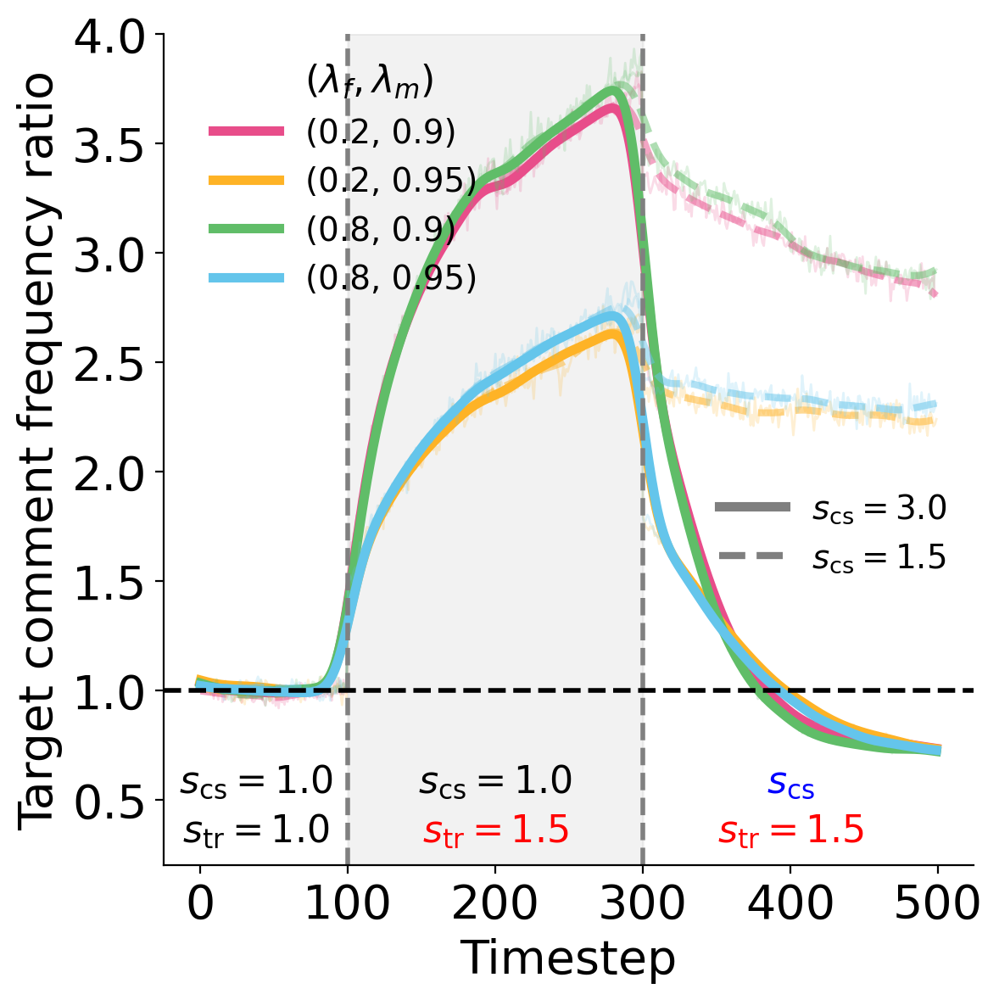

In [31]:
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 1.0

sc = 100
sn = timestep//sc

counter = 0
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        #y = data_list[counter]
        
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=3, alpha=0.5, ls='--', color=color_list[counter])
        
        
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list2[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        counter +=1
            
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.27
ax.text((iv_t1) / 2 * 0.75, y_text, r'$s_{\mathrm{tr}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')

y_text2 = 0.5
ax.text((iv_t1) / 2 * 0.75, y_text2, r'$s_{\mathrm{cs}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text2, r'$s_{\mathrm{cs}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((timestep + iv_t2) / 2 , y_text2, r'$s_{\mathrm{cs}}$', ha='center', va='bottom', fontsize=16, color='b')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(0.2, 4.0)
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target comment frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
legend1 = ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.425, 0.65), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label=r'$s_{\mathrm{cs}}=3.0$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label=r'$s_{\mathrm{cs}}=1.5$')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.65, 0.4), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig5j.svg", format="svg", transparent=True, bbox_inches='tight')

In [11]:
# frequency difference check

folder_name = '6_counter'
model_type = 'simple'

filter_strength = 0.8
memory_strength = 0.9
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 3.0
counter = 0

iv_type = '61'
tier=0

i = 0
sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV00_0_0.0_0_0.0_{target_topic}_-1_t500_{i}'
parameters, results = load_comp_model_result('0_base', model_type, sim_name)

comm_num = parameters['comm_num']
base_raw_freq_list = results['raw_freq_list']

sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i}'
parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
raw_freq_list = results['raw_freq_list']
general_freq = results['general_freq']

### 5k. CS (comment, t=150)

In [ ]:
folder_name = '6_counter'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 150
iv_s2 = 1.5
counter = 0
timestep = 500
    
iv_type = '61'
tier=0

desc_range1 = range(10)
desc_range2 = range(10)

freq_list = []

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)

        tmp_freq_list = []
        
        for i in desc_range2:
            print(i)
    
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i}'
            print(sim_name)
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name, tmp=True)

            comm_num = parameters['comm_num']
            raw_freq_list = results['raw_freq_list']
            filtered_events_list_list = results['filtered_events_list_list']
            
            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_freq_list.append(np.mean(freq, axis=0))
            
        freq_list.append(np.mean(tmp_freq_list, axis=0))
        
np.savez_compressed(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61_3'), 
                    freq_list=np.array(freq_list))

In [33]:
folder_name = '6_counter'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61.npz'))
base_freq_list = data['base_freq_list']

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61_3.npz'))
freq_list = data['freq_list']

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61_4.npz'))
freq_list2 = data['freq_list']

In [34]:
for i in range(4):
    for j in range(500):
        if np.isnan(freq_list[i][j]):
            freq_list[i][j] = freq_list[i][j-1]
        if np.isnan(freq_list2[i][j]):
            freq_list2[i][j] = freq_list2[i][j-1]

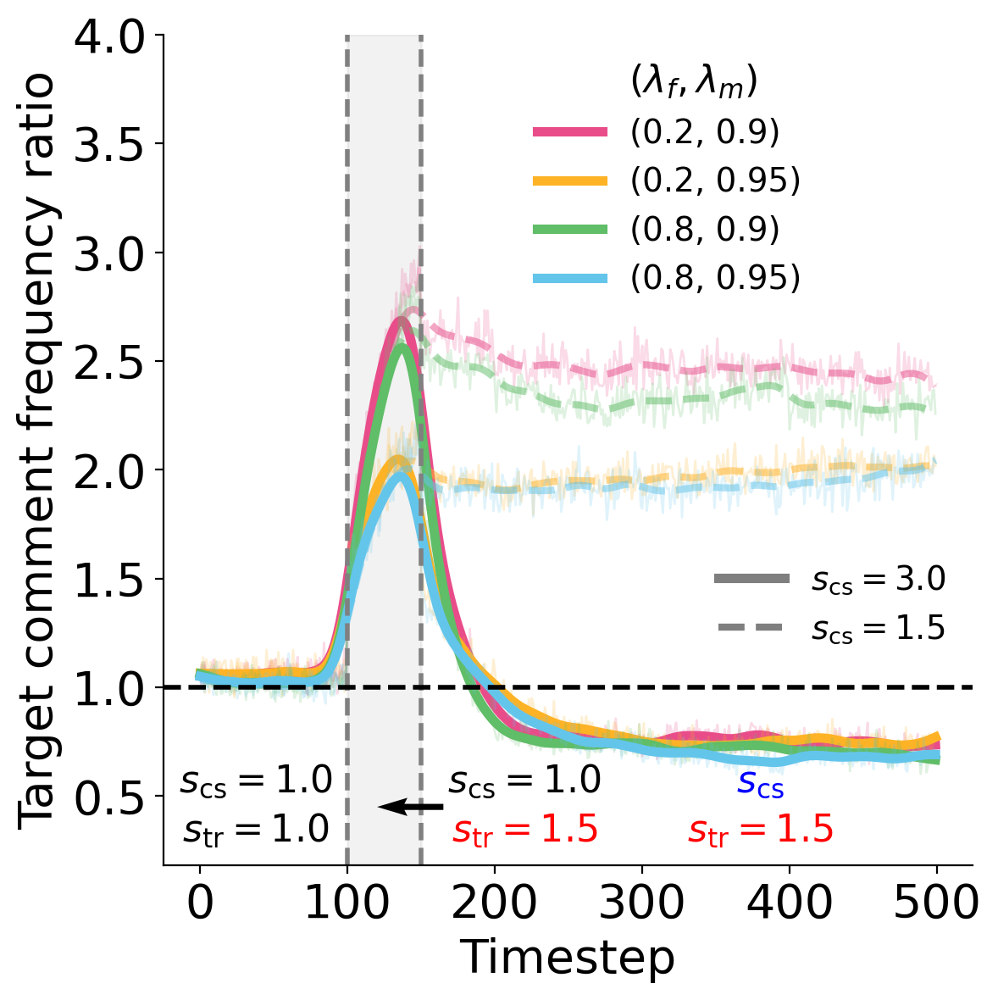

In [50]:
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 150
iv_s2 = 1.0

sc = 100
sn = timestep//sc

counter = 0
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        #y = data_list[counter]
        
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=3, alpha=0.5, ls='--', color=color_list[counter])
        
        
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list2[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        counter +=1
            
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.25
ax.text((iv_t1) / 2 * 0.75, y_text, r'$s_{\mathrm{tr}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text(220, y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')
ax.text(380, y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')

y_text2 = 0.48
ax.text((iv_t1) / 2 * 0.75, y_text2, r'$s_{\mathrm{cs}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text(220, y_text2, r'$s_{\mathrm{cs}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text(380, y_text2, r'$s_{\mathrm{cs}}$', ha='center', va='bottom', fontsize=16, color='b')

ax.quiver(165, 0.45, -45, 0, scale=1, zorder=10, scale_units='xy', angles='xy', color='k')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(0.18, 4.0)
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target comment frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
legend1 = ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.425, 0.65), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label=r'$s_{\mathrm{cs}}=3.0$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label=r'$s_{\mathrm{cs}}=1.5$')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.65, 0.4), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/fig5k.svg", format="svg", transparent=True, bbox_inches='tight')

### 5l. CS (TSNE)

In [255]:

result = np.load('figure/figure_data/fig5.npz')
total_tsne_list = result['total_tsne_list']

def create_colormap(hex_color, base=[0.8, 0.8, 0.8]):
    color_rgb = mpl.colors.hex2color(hex_color)
    return mpl.colors.LinearSegmentedColormap.from_list("custom_colormap", [base, color_rgb])

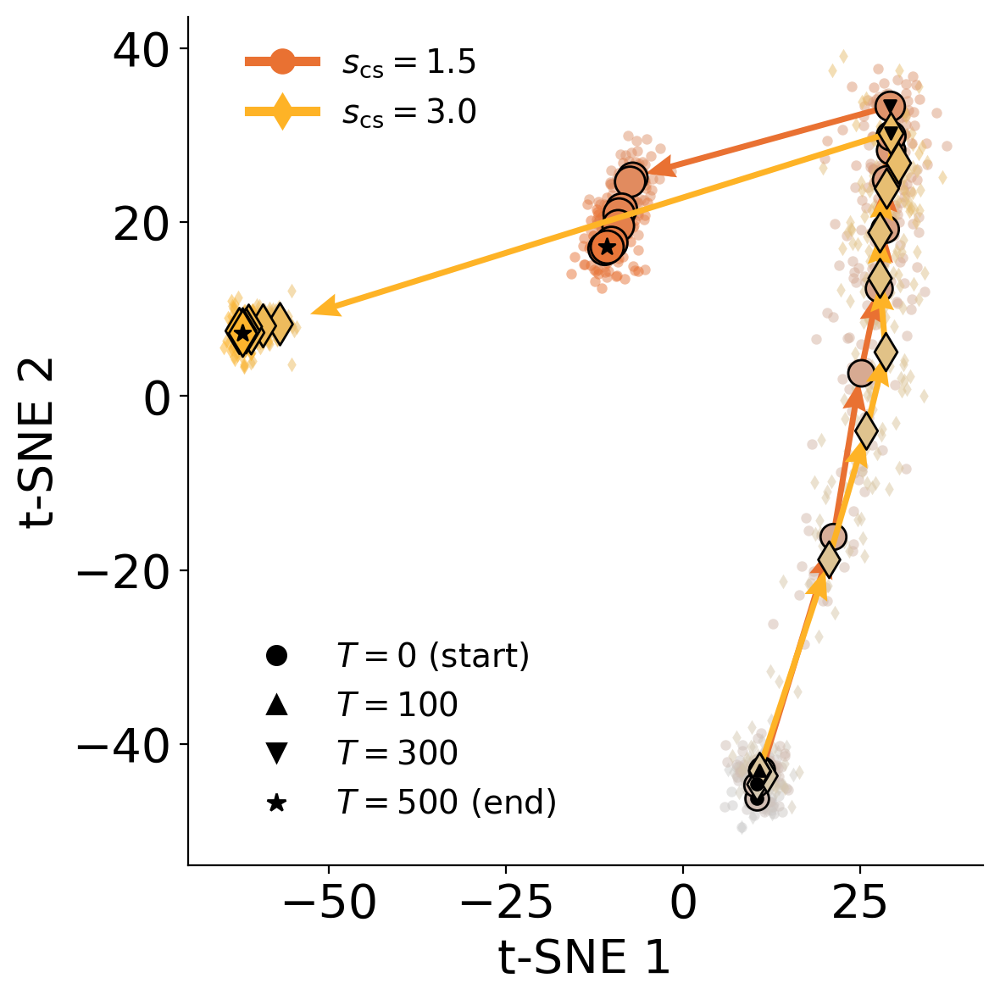

In [285]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig_color_list

tsne1 = total_tsne_list[0][0]
tsne2 = total_tsne_list[1][0]
tsne3 = total_tsne_list[2][0]
tsne4 = total_tsne_list[3][0]

cmap1 = create_colormap(color_list[0])
cmap2 = create_colormap(color_list[1])

for i in range(500):
    ax.scatter(-np.mean(tsne3[:, i, 0]), np.mean(tsne3[:, i, 1]), alpha=0.5, s=20, marker='o', c=[i], cmap=cmap1, vmin=0, vmax=500, linewidth=0)
    ax.scatter(-np.mean(tsne4[:, i, 0]), np.mean(tsne4[:, i, 1]), alpha=0.5, s=20, marker='d', c=[i], cmap=cmap2, vmin=0, vmax=500, linewidth=0)
   

x1 = -np.mean(tsne3[:, :, 0], axis=0)
y1 = np.mean(tsne3[:, :, 1], axis=0)
x2 = -np.mean(tsne4[:, :, 0], axis=0)
y2 = np.mean(tsne4[:, :, 1], axis=0)

step = 25

X1 = np.array([np.mean(x1[i*step: (i+1)*step]) for i in range(500//step)])
Y1 = np.array([np.mean(y1[i*step: (i+1)*step]) for i in range(500//step)])
X2 = np.array([np.mean(x2[i*step: (i+1)*step]) for i in range(500//step)])
Y2 = np.array([np.mean(y2[i*step: (i+1)*step]) for i in range(500//step)])

'''
x11, y11 = X1[:4], Y1[:4]
ax.quiver(x11[:-1], y11[:-1], 0.95*(x11[1:]-x11[:-1]), 0.95*(y11[1:]-y11[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[0], alpha=1.0)

ax.quiver(X1[3], Y1[3], 0.95*(X1[4]-X1[3]), 0.95*(Y1[4]-Y1[3]), scale_units='xy', angles='xy', scale=1, color=color_list[2], alpha=1.0)

x12, y12 = X1[4:], Y1[4:]
ax.quiver(x12[:-1], y12[:-1], 0.95*(x12[1:]-x12[:-1]), 0.95*(y12[1:]-y12[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[0], alpha=1.0)
'''
ax.quiver(X1[:-1], Y1[:-1], 0.95*(X1[1:]-X1[:-1]), 0.95*(Y1[1:]-Y1[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[0], headwidth=4, alpha=1)

for i in range(500//step):
    ax.scatter(X1[i], Y1[i], alpha=1, s=100+5*(i), marker='o', c=[i], cmap=cmap1, vmin=-100//step, vmax=500//step, edgecolor='k')

ax.scatter(X1[0], Y1[0], alpha=1, s=25, marker='o', c='k', edgecolor='k')
ax.scatter(X1[3], Y1[3], alpha=1, s=25, marker='^', c='k', edgecolor='k')
ax.scatter(X1[11], Y1[11], alpha=1, s=25, marker='v', c='k', edgecolor='k')
ax.scatter(X1[-1], Y1[-1], alpha=1, s=50, marker='*', c='k', edgecolor='k')


'''
x21, y21 = X2[:4], Y2[:4]
ax.quiver(x21[:-1], y21[:-1], 0.95*(x21[1:]-x21[:-1]), 0.95*(y21[1:]-y21[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[1], alpha=1.0)

ax.quiver(X2[3], Y2[3], 0.95*(X2[4]-X2[3]), 0.95*(Y2[4]-Y2[3]), scale_units='xy', angles='xy', scale=1, color=color_list[2], alpha=1.0)

x22, y22 = X2[4:], Y2[4:]
ax.quiver(x22[:-1], y22[:-1], 0.95*(x22[1:]-x22[:-1]), 0.95*(y22[1:]-y22[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[1], alpha=1.0, lw=5)

ax.quiver(X2[11], Y2[11], 0.95*(X2[12]-X2[11]), 0.95*(Y2[12]-Y2[11]), scale_units='xy', angles='xy', scale=1, color=color_list[3], alpha=1.0, lw=5)

x23, y23 = X2[12:], Y2[12:]
ax.quiver(x23[:-1], y23[:-1], 0.95*(x23[1:]-x23[:-1]), 0.95*(y23[1:]-y23[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[1], alpha=1.0)
'''
ax.quiver(X2[:-1], Y2[:-1], 0.95*(X2[1:]-X2[:-1]), 0.95*(Y2[1:]-Y2[:-1]), scale_units='xy', angles='xy', scale=1, color=color_list[1], headwidth=4, alpha=1)

for i in range(500//step):
    ax.scatter(X2[i], Y2[i], alpha=1, s=100+5*(i), marker='d', c=[i], cmap=cmap2, vmin=-100//step, vmax=500//step, edgecolor='k')
    
ax.scatter(X2[0], Y2[0], alpha=1, s=25, marker='o', c='k', edgecolor='k')
ax.scatter(X2[3], Y2[3], alpha=1, s=25, marker='^', c='k', edgecolor='k')
ax.scatter(X2[11], Y2[11], alpha=1, s=25, marker='v', c='k', edgecolor='k')
ax.scatter(X2[-1], Y2[-1], alpha=1, s=50, marker='*', c='k', edgecolor='k')

ax.set_xlabel('t-SNE 1', fontsize=20)
ax.set_ylabel('t-SNE 2', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)

line_list = []
custom_line = Line2D([], [], color=color_list[0], marker='o', markersize=10, lw=4, ls='-', alpha=1, label=r'$s_{\mathrm{cs}}=1.5$')
line_list.append(custom_line)

custom_line = Line2D([], [], color=color_list[1], marker='d', markersize=10, lw=4, ls='-', alpha=1, label=r'$s_{\mathrm{cs}}=3.0$')
line_list.append(custom_line)

legend1 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.4, 1.0), fontsize=14)

line_list = []
custom_line = Line2D([], [], color='k', marker='o', markerfacecolor='k', markersize=8, alpha=1, lw=0, label=r'$T=0$'+ " (start)")
line_list.append(custom_line)

custom_line = Line2D([], [], color='k', marker='^', markerfacecolor='k', markersize=8, alpha=1, lw=0, label=r'$T=100$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='k', marker='v', markerfacecolor='k', markersize=8, alpha=1, lw=0, label=r'$T=300$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='k', marker='*', markerfacecolor='k', markersize=8, alpha=1, lw=0, label=r'$T=500$'+ " (end)")
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.5, 0.3), fontsize=14)
plt.gca().add_artist(legend1)
# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/fig5l.svg", format="svg", transparent=True, bbox_inches='tight')

# **[Extended]**

## Figure E1. Data response

### E1a. Example

In [684]:
collection_name = 'Thehill'
aggregate_day = 'month'
num_topics = NUM_TOPICS[collection_name]

with open(join('/data', 'collmind', 'article', collection_name.lower(), aggregate_day, f'topic_dict_{aggregate_day}.pkl'), 'rb') as f:
    articles_by_month = pickle.load(f)
articles_by_month = articles_by_month_clear(articles_by_month)

Original article number: 313673
Filtered article (after comment) number: 287292
Filtered article (after article) number: 284859
Filtered article ratio: 0.908140
Original comment number: 174763515
Filtered comment number (after comment): 174343158
Filtered comment number (after article): 172172405
Filtered comment ratio: 0.985174
Filtered n1 number (after comment): 89926144
Filtered n1 number (after article): 88812391
Filtered n1 ratio: 0.508186


In [685]:
def get_title_comment_topic_dist_triplet(articles_by_month):
    title_comment_topic_dist = defaultdict(lambda: [0, Counter()])
    for month, articles in articles_by_month.items():
        for i in range(len(articles)):
            article = articles.iloc[i]
            article_topic = tuple(article['topic_num'][:3])
            if not (-1 in article_topic):
                title_comment_topic_dist[article_topic][0] += 1
                title_comment_topic_dist[article_topic][1].update(article['comment_topics'])

    return title_comment_topic_dist

def harmonic_approx(N):
    return np.log(N) + 0.57721 + 1/(2*N) - 1/(12*N**2)


In [686]:
title_comment_topic_triplet_dist = get_title_comment_topic_dist_triplet(articles_by_month)
sorted_counters = [(key, counter) for key, counter in sorted(title_comment_topic_triplet_dist.items(), key=lambda x: x[1][0], reverse=True)]

Data number : 224


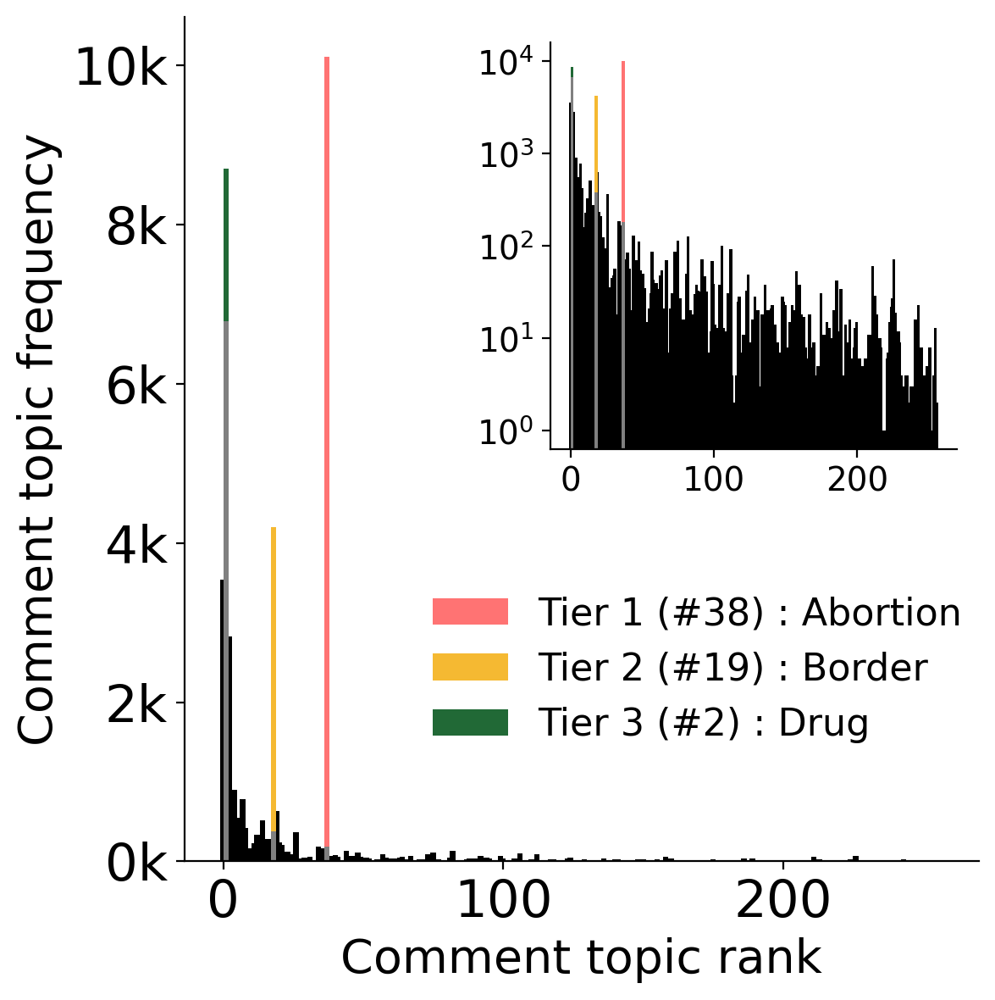

In [688]:
## Figure format

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)

# 7 13 18 21 33
rank = 33

topic = sorted_counters[rank][0]
print(f'Data number : {sorted_counters[rank][1][0]}')
data = title_comment_topic_triplet_dist[topic][1]
rd = ranking_index_dict[collection_name]

#for i in range(3):
#    ax.axvline(x=np.where(rd == topic[i])[0][0], color=color_list[i], linestyle='--', lw=1, label=f'Tier {i+1} (Topic #{topic[i]})')

plot_data = np.array([[i, title_comment_topic_triplet_dist[topic][1][i]] for i in range(NUM_TOPICS[collection_name])])
plot_data[:, 1] = plot_data[:, 1][rd]
ax.bar(plot_data[:, 0], plot_data[:, 1], width=2, color='k')

ax.bar(plot_data[np.where(rd == topic[0])[0][0], 0], plot_data[np.where(rd == topic[0])[0][0], 1], width=2, color=diff_color_list[0], label=f'Tier 1 (#{np.where(rd == topic[0])[0][0]+1}) : Abortion')
ax.bar(plot_data[np.where(rd == topic[1])[0][0], 0], plot_data[np.where(rd == topic[1])[0][0], 1], width=2, color=diff_color_list[1], label=f'Tier 2 (#{np.where(rd == topic[1])[0][0]+1}) : Border')
ax.bar(plot_data[np.where(rd == topic[2])[0][0], 0], plot_data[np.where(rd == topic[2])[0][0], 1], width=2, color=diff_color_list[2], label=f'Tier 3 (#{np.where(rd == topic[2])[0][0]+1}) : Drug')

ax.bar(plot_data[np.where(rd == topic[0])[0][0], 0], (1/np.where(rd == topic[0])[0][0])/harmonic_approx(num_topics) * np.sum(plot_data[:, 1]), width=2, color='gray')
ax.bar(plot_data[np.where(rd == topic[1])[0][0], 0], (1/np.where(rd == topic[1])[0][0])/harmonic_approx(num_topics) * np.sum(plot_data[:, 1]), width=2, color='gray')
ax.bar(plot_data[np.where(rd == topic[2])[0][0], 0], (1/np.where(rd == topic[2])[0][0])/harmonic_approx(num_topics) * np.sum(plot_data[:, 1]), width=2, color='gray')


ax.set_xlabel('Comment topic rank', fontsize=20)
ax.set_ylabel('Comment topic frequency', fontsize=20)
ax.spines[['right', 'top']].set_visible(False)
ax.legend(fontsize=16, frameon=False, bbox_to_anchor=(0.27, 0.1))

# Draw inset with log scale
inset_ax = fig.add_axes([0.55, 0.55, 0.4, 0.4])
inset_ax.bar(plot_data[:, 0], plot_data[:, 1], width=2, color='k')

inset_ax.bar(plot_data[np.where(rd == topic[0])[0][0], 0], plot_data[np.where(rd == topic[0])[0][0], 1], width=2, color=diff_color_list[0])
inset_ax.bar(plot_data[np.where(rd == topic[1])[0][0], 0], plot_data[np.where(rd == topic[1])[0][0], 1], width=2, color=diff_color_list[1])
inset_ax.bar(plot_data[np.where(rd == topic[2])[0][0], 0], plot_data[np.where(rd == topic[2])[0][0], 1], width=2, color=diff_color_list[2])

inset_ax.bar(plot_data[np.where(rd == topic[0])[0][0], 0], (1/np.where(rd == topic[0])[0][0])/harmonic_approx(num_topics) * np.sum(plot_data[:, 1]), width=2, color='gray')
inset_ax.bar(plot_data[np.where(rd == topic[1])[0][0], 0], (1/np.where(rd == topic[1])[0][0])/harmonic_approx(num_topics) * np.sum(plot_data[:, 1]), width=2, color='gray')
inset_ax.bar(plot_data[np.where(rd == topic[2])[0][0], 0], (1/np.where(rd == topic[2])[0][0])/harmonic_approx(num_topics) * np.sum(plot_data[:, 1]), width=2, color='gray')

inset_ax.set_yscale('log')
inset_ax.spines[['right', 'top']].set_visible(False)
inset_ax.tick_params(which='minor', width=0, length=0)
inset_ax.tick_params(axis='both', labelsize=14)

ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{int(x/1000)}k'))
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=14)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

plt.tight_layout()
plt.savefig("figure/EX/figE1a.svg", format="svg", transparent=True)

## Figure E2. TSNE

### E2a. TSNE (data)

In [61]:
title_topic_num_list_dict_dict = {}
ranking_month_list_dict = {}
frequency_list_dict = {}

aggregate_day = 'month'

for collection_name in COLLECTION_NAMES:
    print(collection_name)
    with open(join('/data', 'collmind', 'article_global', collection_name.lower(), 'result_dict.pkl'), 'rb') as f:
        result_dict = pickle.load(f)
    title_topic_num_list_dict_dict[collection_name] = result_dict['title_topic_num_list_dict']['month']
    
    file_names = os.listdir(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df'))
    keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))

    ranking_month_list = []
    frequency_list = []

    for key in keys:
        data = pd.read_parquet(join('/data', 'collmind', 'article_global', collection_name.lower(), aggregate_day, 'df', key+'.parquet'))['topic_freq'].values
        assert data[0] == np.max(data)
        ranking_month_list.append(get_ranking(data[1:])[ranking_dict['global']])
        frequency_list.append(data[1:][ranking_dict['global']]/np.sum(data[1:]))
        
    ranking_month_list_dict[collection_name] = np.array(ranking_month_list)
    frequency_list_dict[collection_name] = np.array(frequency_list)

Gatewaypundit


Breitbart
Thehill
Atlantic
Motherjones


In [62]:
collection_name = 'global'
model_name = MODEL_NAMES[collection_name]

with open(join('result', 'comment_topic_freq_dict.pkl'), 'rb') as f:
    comment_topic_freq_dict = pickle.load(f)

topic_freq = comment_topic_freq_dict[collection_name][1:] # exclude -1
ranking = np.argsort(topic_freq)[::-1] # descending order

topic_name_list = pd.read_csv(join('result', collection_name.lower(), model_name +'_fit.csv'))['Name'].values
topic_name_list = topic_name_list[1:][ranking]
topic_name_list = [(i, name.split('_')[:2]) for i, name in enumerate(topic_name_list)]

In [67]:
# TSNE
embedding_list_tsne = np.vstack([ranking_month_list_dict[collection_name] for collection_name in COLLECTION_NAMES])
X_embedded = sk.manifold.TSNE(n_components=2).fit_transform(embedding_list_tsne)
total_tsne_list = -X_embedded
len_list = [len(ranking_month_list_dict[collection_name]) for collection_name in COLLECTION_NAMES]
max_len = max(len_list)
id = np.insert(np.cumsum(len_list), 0, 0)

Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones


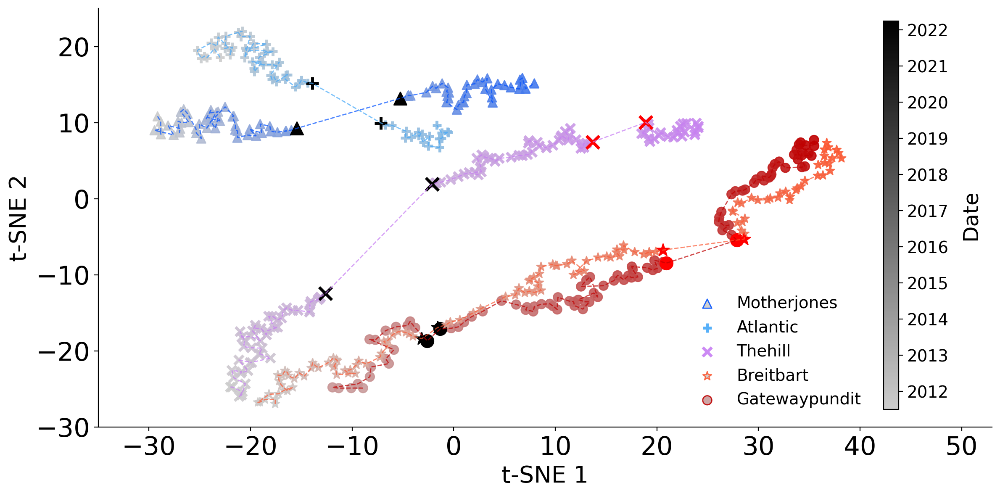

In [78]:
fig = plt.figure(figsize=(12, 6), dpi=200)
ax = fig.add_subplot(111)
jet_colors = plt.get_cmap('jet_r')(np.linspace(0, 1, max_len))
marker_list = ['o', '*', 'x', '+', '^']
linewidth_list = [1, 1, 2.5, 2.5, 1]
gun_offset = 48
covid_offset = 92
line_list = []
color_list = rb_color_list[::-1]

def create_colormap(hex_color):
    color_rgb = mpl.colors.hex2color(hex_color)
    return mpl.colors.LinearSegmentedColormap.from_list("custom_colormap", [[0.8, 0.8, 0.8], color_rgb])

ms = 60
ev_ms = 120

for i, collection_name in enumerate(COLLECTION_NAMES):
    print(collection_name)
    
    cmap=create_colormap(color_list[i])
    
    ax.plot(total_tsne_list[id[i]:id[i+1], 0], total_tsne_list[id[i]:id[i+1], 1], c=color_list[i], ls='--', lw=1, alpha=0.7, label=collection_name)
    line = ax.scatter(total_tsne_list[id[i]:id[i+1], 0], total_tsne_list[id[i]:id[i+1], 1], c=np.arange(MONTH_OFFSET[collection_name], MONTH_OFFSET[collection_name]+len_list[i]), cmap=cmap, vmin=0, vmax=130, s=ms, marker=marker_list[i], label=collection_name, alpha=0.9, linewidths=linewidth_list[i])
    line_list.append(line)
    
    ax.scatter(total_tsne_list[id[i]:id[i+1], 0][gun_offset-MONTH_OFFSET[collection_name]], total_tsne_list[id[i]:id[i+1], 1][gun_offset-MONTH_OFFSET[collection_name]], c='k', s=ev_ms, alpha=1, marker=marker_list[i], linewidths=linewidth_list[i]) # 2016/7, 2016 election
    ax.scatter(total_tsne_list[id[i]:id[i+1], 0][gun_offset+1-MONTH_OFFSET[collection_name]], total_tsne_list[id[i]:id[i+1], 1][gun_offset+1-MONTH_OFFSET[collection_name]], c='k', s=ev_ms, alpha=1, marker=marker_list[i], linewidths=linewidth_list[i]) # 2016/8, 2016 election
    if id[i+1]-id[i] > 91:
        ax.scatter(total_tsne_list[id[i]:id[i+1], 0][covid_offset-MONTH_OFFSET[collection_name]], total_tsne_list[id[i]:id[i+1], 1][covid_offset-MONTH_OFFSET[collection_name]], c='r', s=ev_ms, alpha=1, marker=marker_list[i], linewidths=linewidth_list[i]) # 2019/12, 2019 COVID
        ax.scatter(total_tsne_list[id[i]:id[i+1], 0][covid_offset+1-MONTH_OFFSET[collection_name]], total_tsne_list[id[i]:id[i+1], 1][covid_offset+1-MONTH_OFFSET[collection_name]], c='r', s=ev_ms, alpha=1, marker=marker_list[i], linewidths=linewidth_list[i]) # 2020/01 2019 COVID
    

ax.set_xlim(-35, 53)
ax.set_ylim(-30, 25)

ax.set_xlabel('t-SNE 1', fontsize=20)
ax.set_ylabel('t-SNE 2', fontsize=20)
ax.spines[['right', 'top']].set_visible(False)

leg = ax.legend(handles=line_list[::-1], frameon=False, fontsize=14, bbox_to_anchor=(0.87, 0.35))
for i in range(len(COLLECTION_NAMES)):
    leg.legend_handles[4-i].set_color(color_list[i])
    leg.legend_handles[4-i].set_edgecolor(color_list[i])

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

#cbar = plt.colorbar(cim, ax=ax, orientation='vertical')
cax = fig.add_axes([0.88, 0.18, 0.015, 0.77])
cb = mpl.colorbar.ColorbarBase(cax, orientation='vertical',  cmap=create_colormap('#000000'))
cb.set_label('Date', labelpad=10, fontsize=18)
cb.set_ticks(np.linspace(0, 1, max_len)[6::12])
cb.set_ticklabels(pd.date_range(start='2012-06', end='2023-04', freq='Y').strftime('%Y'), fontsize=14)

plt.tight_layout()
plt.savefig("figure/EX/figE2a.svg", format="svg", transparent=True)

In [76]:
for i in range(len(COLLECTION_NAMES)):
    print(leg.legend_handles[4-i])

In [72]:
len(leg.legend_handles)

5

### E2b. TSNE (model)

In [110]:
embedding_list = []

memory_strength_list = [0.9, 0.95, 0.99]
filter_strength_list = [0.1, 0.5, 0.9]

folder_name = '0_tsne'
model_type = 'simple'

raw_freq_list_list = []

for memory_strength in memory_strength_list:
    for filter_strength in filter_strength_list:
        print(filter_strength, memory_strength)
        sim_name = f'sim_T250_C100_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF1.0_IV99_0_0.0_0_0.0_-1_-1_t300_0'
        parameters, results = load_comp_model_result(folder_name, model_type, sim_name)

        freq_list = results['freq_list']
        raw_freq_list = results['raw_freq_list']
        num_trial = parameters['comm_num']
        time = parameters['timestep']
        num_topics = parameters['topic_num']
        raw_freq_list_list.append(raw_freq_list)

0.1 0.9
0.5 0.9
0.9 0.9
0.1 0.95
0.5 0.95
0.9 0.95
0.1 0.99
0.5 0.99
0.9 0.99


In [111]:
trial = 9
iter_num = 37
raw_freq_list = np.array(raw_freq_list_list)[:, iter_num]
embedding_list_tsne = raw_freq_list[:trial].reshape(-1, num_topics)
embedding_list_tsne = np.argsort(np.argsort(-embedding_list_tsne, axis=1), axis=1)/num_topics
general_embedding = np.argsort(np.argsort(-results['general_freq']))/num_topics
start_embedding = np.vstack([np.argsort(np.argsort(-raw_freq_list[i][0]))/num_topics for i in range(trial)])

embedding_list_tsne = np.vstack((embedding_list_tsne, start_embedding, general_embedding))
X_embedded = sk.manifold.TSNE(n_components=2).fit_transform(embedding_list_tsne)

general_embedding = X_embedded[-1]
start_embedding = X_embedded[-(trial+1):-1]
X_embedded = X_embedded[:-(trial+1)]
total_tsne_list = X_embedded.reshape(trial, time, 2).transpose(1, 0, 2)

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7f0c204274c0>
Traceback (most recent call last):
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().s

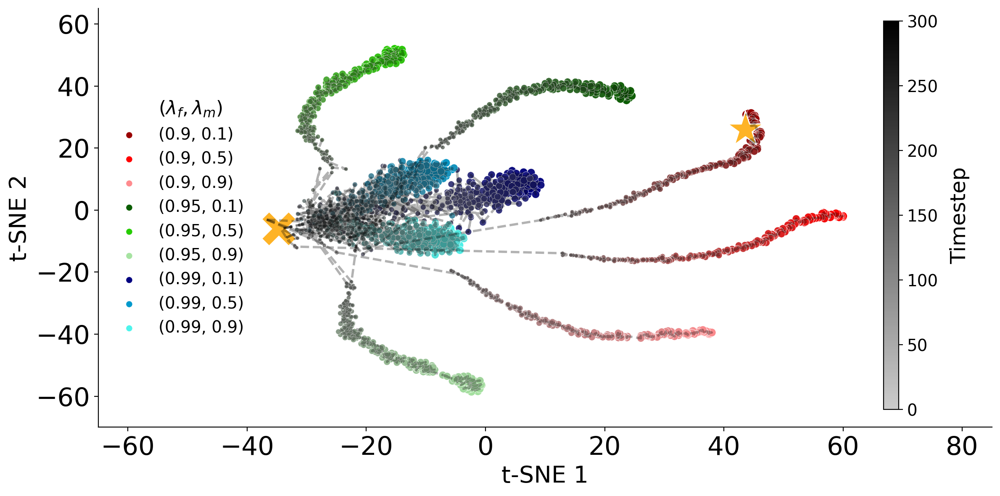

In [118]:
fig = plt.figure(figsize=(12, 6), dpi=200)
ax = fig.add_subplot(111)

tsne_color_list = ['#990000', '#ff0000', '#ff8b8e',
                   '#0a5d00', '#26cc00', '#a6e3a1',
                   '#000080', '#0099cc', '#4df4ec']

line_list = []

for n in range(9):
    filter_strength = filter_strength_list[n%3]
    memory_strength = memory_strength_list[n//3]
    line = ax.scatter(-total_tsne_list[:, n, 0][::-1], -total_tsne_list[:, n, 1][::-1], c=np.arange(time), cmap=create_colormap(tsne_color_list[n]), s=np.linspace(50, 10, time), label=f'({memory_strength}, {filter_strength})', edgecolor='white', linewidth=0.25)
    #line = ax.scatter(total_tsne_list[:, n, 0], total_tsne_list[:, n, 1], c=tsne_color_list[n], s=np.linspace(50, 10, time), label=f'M{memory_strength}, F{filter_strength}', edgecolor='white', linewidth=0.2)
    line_list.append(line)
    ax.plot(-total_tsne_list[:, n, 0], -total_tsne_list[:, n, 1], c='k', alpha=0.3, ls='--', lw=2)
    #ax.scatter(start_embedding[n, 0], start_embedding[n, 1], c='r', s=60, alpha=0.5)

#ax.scatter(start_embedding[0], start_embedding[1], c='b', s=15)

ax.scatter(-np.mean(total_tsne_list[0, :, 0]), -np.mean(total_tsne_list[0, :, 1]), c=orig_color_list[1], marker = 'x', s=500, linewidth=8, edgecolors='white')

ax.scatter(-general_embedding[0], -general_embedding[1], c=orig_color_list[1], marker = '*', s=1000, edgecolors='white')

ax.set_xlim(-65, 85)
ax.set_ylim(-70, 65)

leg = ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, handles=line_list, fontsize=14, loc='center left', columnspacing=0.5)

ax.set_xlabel('t-SNE 1', fontsize=20)
ax.set_ylabel('t-SNE 2', fontsize=20)
ax.spines[['right', 'top']].set_visible(False)

#ax.legend(handles=line_list, fontsize=12)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

#cbar = plt.colorbar(cim, ax=ax, orientation='vertical')
cax = fig.add_axes([0.88, 0.18, 0.015, 0.77])
cb = mpl.colorbar.ColorbarBase(cax, orientation='vertical', cmap=create_colormap('#CCCCCC', 'black'))
cb.set_label('Timestep', labelpad=10, fontsize=18)
cb.set_ticks(np.linspace(0, 1, 7))
cb.set_ticklabels([0, 50, 100, 150, 200, 250, 300], fontsize=14)

plt.tight_layout()
plt.savefig("figure/EX/figE2b.svg", format="svg", transparent=True)

## Figure E3. Vanilla model behavior

In [180]:
model_type = 'simple'
folder_name = '0_base'

freq_list_list = []
raw_freq_list_list = []
timestep = 500
trial = 1000
tot_num = 18

memory_strength_list = [0.8, 0.9, 0.95]
filter_strength_list = [0.2, 0.5, 0.8]
init_freq_std_list = [0.0, 1.0]

for init_freq_std in init_freq_std_list:
    for filter_strength in filter_strength_list:
        for memory_strength in memory_strength_list:
            print(filter_strength, memory_strength, init_freq_std)
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF{init_freq_std}_IV99_0_0.0_0_0.0_25_-1_t500_0'
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name, tmp=True)
            freq_list_list.append(results['freq_list'][:trial, :timestep, :])
            raw_freq_list_list.append(results['raw_freq_list'][:trial, :timestep, :])


freq_list_list = np.array(freq_list_list)
raw_freq_list_list = np.array(raw_freq_list_list)
general_freq = results['general_freq']

0.2 0.8 0.0
0.2 0.9 0.0
0.2 0.95 0.0
0.5 0.8 0.0
0.5 0.9 0.0
0.5 0.95 0.0
0.8 0.8 0.0
0.8 0.9 0.0
0.8 0.95 0.0
0.2 0.8 1.0
0.2 0.9 1.0
0.2 0.95 1.0
0.5 0.8 1.0
0.5 0.9 1.0
0.5 0.95 1.0
0.8 0.8 1.0
0.8 0.9 1.0
0.8 0.95 1.0


In [ ]:
kd_array = np.zeros((tot_num, trial, timestep))

for i in range(tot_num):
    for j in range(trial):
        for k in range(timestep):
            kd_array[i][j][k] = kendalltau_dist(raw_freq_list_list[i][j][k], general_freq)
            
np.savez_compressed(join('figure', 'figure_data', f'figE4'), kd_array=kd_array)

### E3a. KD plot (f=0.2)

In [183]:
kd_array = np.load(join('figure', 'figure_data', 'figE4'))['kd_array']

In [298]:
memory_strength_list = [0.9, 0.95, 0.99]
filter_strength_list = [0.2, 0.5, 0.8]
init_freq_std_list = [0.0, 1.0]

[ 0  1  2  9 10 11]
0 0 0 0
1 1 0 1
2 2 0 2
3 9 3 0
4 10 3 1
5 11 3 2


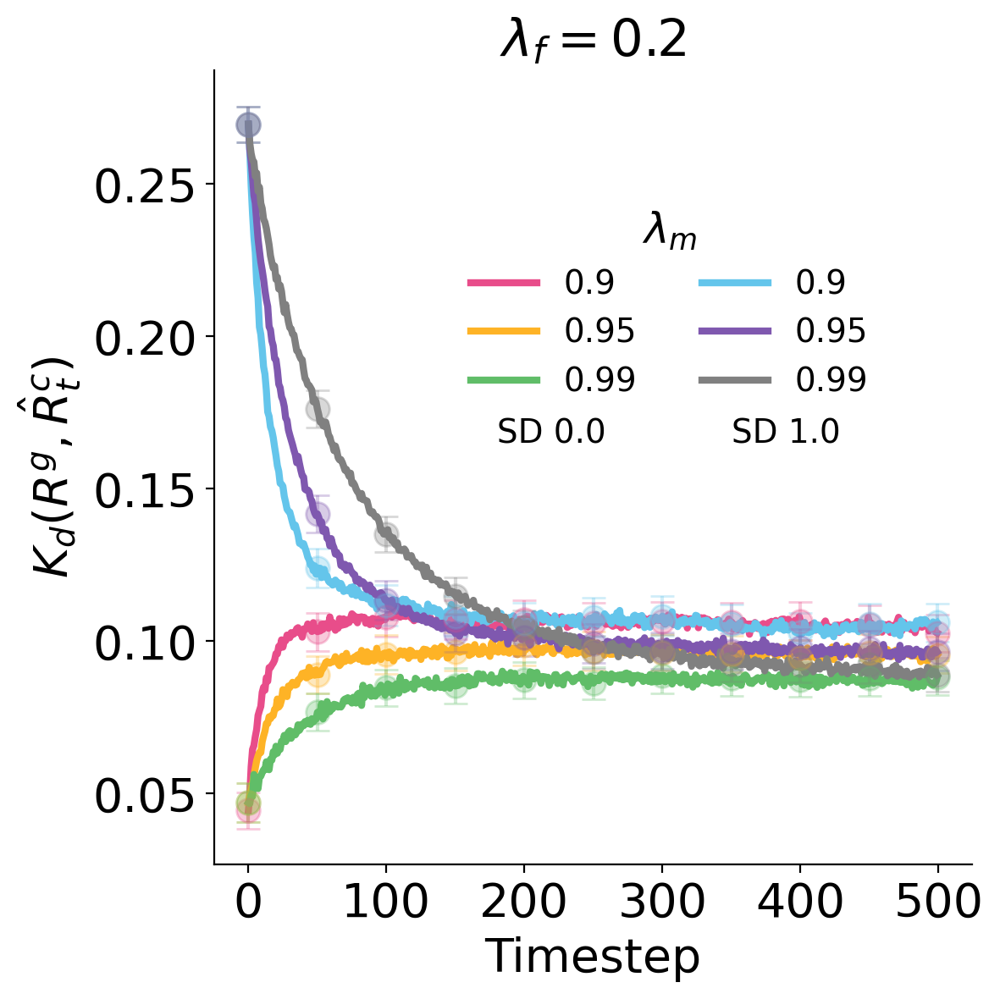

In [ ]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)

timestep=500
desc = np.array([0, 1, 2, 9, 10, 11])+0
print(desc)

for i, d in enumerate(desc):
    print(i, d, d//3, d%3)
    ax.plot(np.mean(kd_array[d], axis=0), lw=3, color=orig2_color_list[i], label=f'{memory_strength_list[d%3]}')
    ax.errorbar(range(timestep)[::50], np.mean(kd_array[d], axis=0)[::50], yerr=np.std(kd_array[d], axis=0)[::50], fmt='o', capsize=5, markersize=10, color=orig2_color_list[i], alpha=0.3)
    ax.errorbar(timestep-1, np.mean(kd_array[d], axis=0)[-1], yerr=np.std(kd_array[d], axis=0)[-1], fmt='o', capsize=5, markersize=10, color=orig2_color_list[i], alpha=0.3)
        
ax.set_xticks([0, 100, 200, 300, 400, 500])
        
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel(r'$K_d(R^g, \hat{R}_t^c)$', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
legend = ax.legend(title=r"$\lambda_m$", title_fontsize=18, frameon=False, bbox_to_anchor=(0.3, 0.55), fontsize=14, ncols=2)

ax.text(180, 0.165, 'SD 0.0', fontsize=14)
ax.text(350, 0.165, 'SD 1.0', fontsize=14)

ax.set_title(r"$\lambda_f=0.2$", fontsize=22)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/SI/figE3a.svg", format="svg", transparent=True, bbox_inches='tight')

### E3b. KD bar (filter)

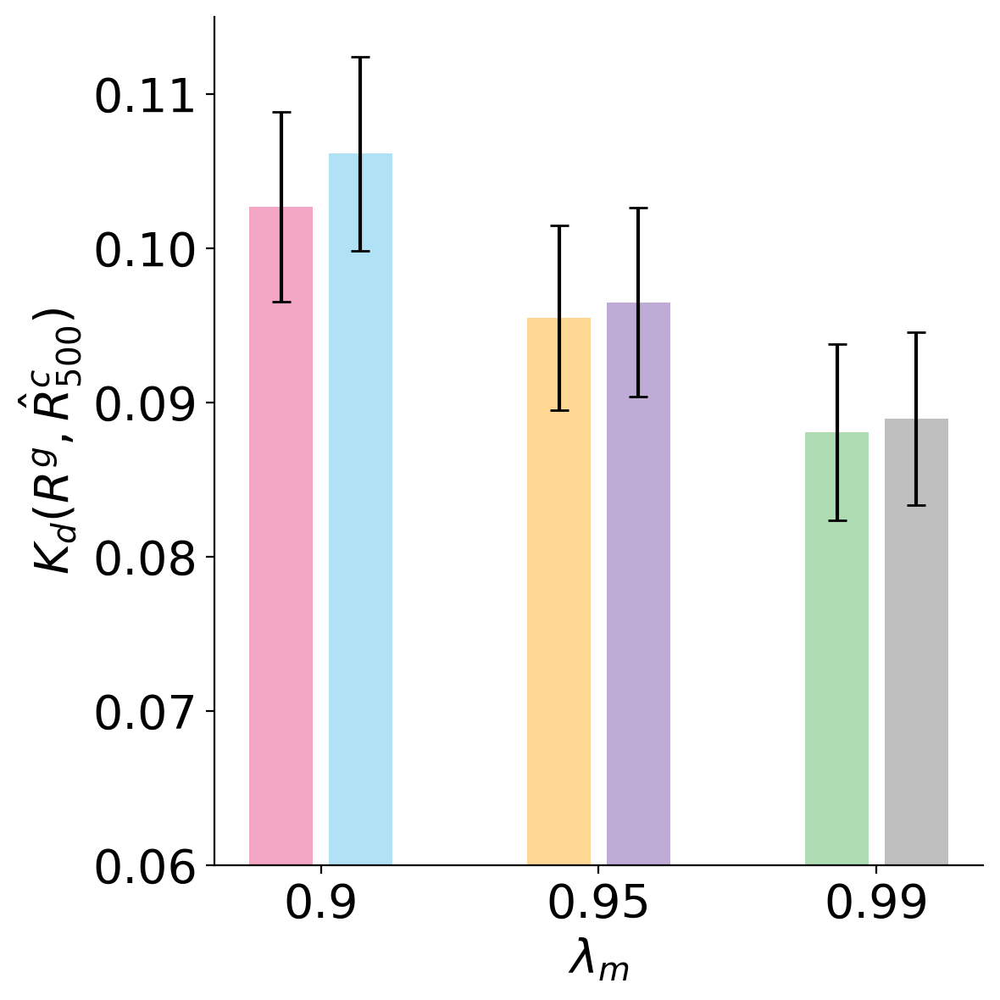

In [ ]:
# memory_strength, iv_time, iv_s2

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list
line_list = []

desc = np.array([0, 1, 2, 9, 10, 11])+0
order = np.array([0, 3, 1, 4, 2, 5])

m=0

for i, d in enumerate(order):
    ax.bar(x=m, height=np.mean(kd_array[desc[d], :, -1]), yerr=np.std(kd_array[desc[d], :, -1]), capsize=4, color=color_list[d], width=0.4, alpha=0.5)
    m+=0.5
    if i%2 == 1:
        m+=0.75

ax.set_xlabel(r'$\lambda_m$', fontsize=20)
#ax.set_xticks([1.25, 5.25])
#ax.set_xticklabels(['SD 0.0', 'SD 1.0'])
ax.set_ylabel(r'$K_d(R^g, \hat{R}_{500}^c)$', fontsize=20)

#ax.set_ylim(0.09, 0.275)
#ax.set_yticks([0.1, 0.15, 0.2, 0.25])
#legend = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.5, 0.9), fontsize=14)

# remove xticks
ax.set_xticks([0.25, 2.0, 3.75])
ax.set_xticklabels(['0.9', '0.95', '0.99'])

ax.set_ylim([0.06, 0.115])

# Remove small ticks and increase tick font size
ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/EX/figE3b.svg", format="svg", transparent=True, bbox_inches='tight')

### E3c. KD bar (memory)

0 0 0 0
1 3 1 0
2 6 2 0
3 9 3 0
4 12 4 0
5 15 5 0


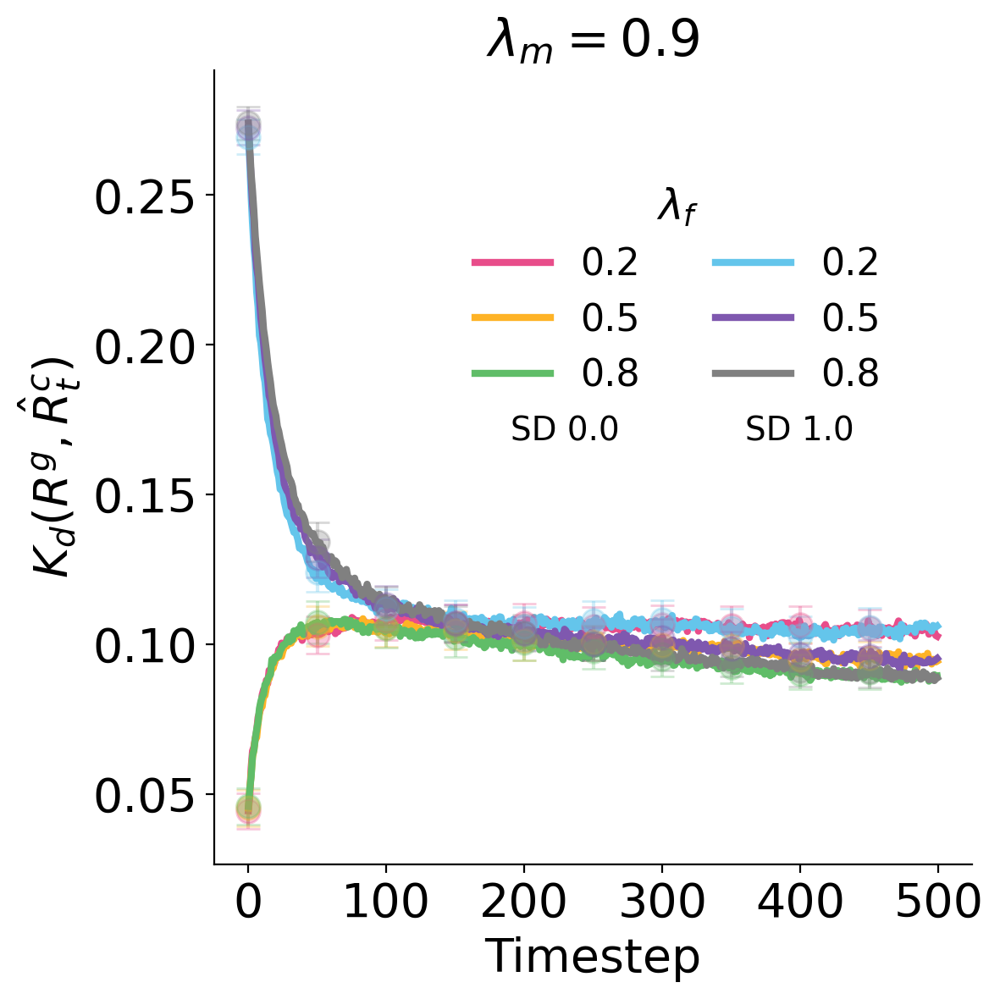

In [ ]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)

timestep=500

desc = np.array([0, 3, 6, 9, 12, 15])+0

for i, d in enumerate(desc):
    print(i, d, d//3, d%3)
    ax.plot(np.mean(kd_array[d], axis=0), lw=3, color=orig2_color_list[i], label=f'{filter_strength_list[(d//3)%3]}')
    ax.errorbar(range(timestep)[::50], np.mean(kd_array[d], axis=0)[::50], yerr=np.std(kd_array[d], axis=0)[::50], fmt='o', capsize=5, markersize=10, color=orig2_color_list[i], alpha=0.3)
        
ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel(r'$K_d(R^g, \hat{R}_t^c)$', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
legend = ax.legend(title=r"$\lambda_f$", title_fontsize=18, frameon=False, bbox_to_anchor=(0.3, 0.55), fontsize=16, ncols=2)

ax.text(190, 0.168, 'SD 0.0', fontsize=14)
ax.text(360, 0.168, 'SD 1.0', fontsize=14)

ax.set_title(r"$\lambda_m=0.9$", fontsize=22)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/EX/figE3c.svg", format="svg", transparent=True, bbox_inches='tight')

### E3d. KD bar (memory)

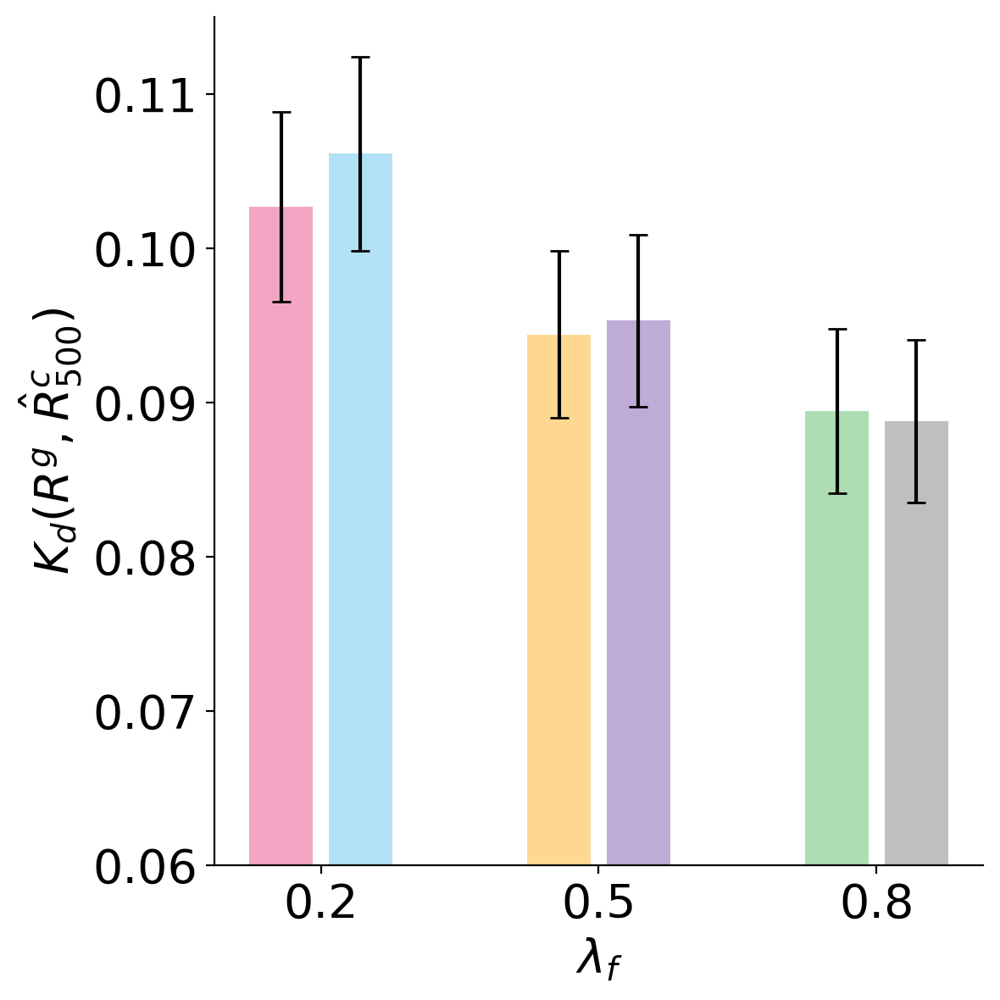

In [ ]:
# memory_strength, iv_time, iv_s2

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list
line_list = []

desc = np.array([0, 3, 6, 9, 12, 15])+0
order = np.array([0, 3, 1, 4, 2, 5])

m=0

for i, d in enumerate(order):
    ax.bar(x=m, height=np.mean(kd_array[desc[d], :, -1]), yerr=np.std(kd_array[desc[d], :, -1]), capsize=4, color=color_list[d], width=0.4, alpha=0.5)
    m+=0.5
    if i%2 == 1:
        m+=0.75

ax.set_xlabel(r'$\lambda_f$', fontsize=20)
#ax.set_xticks([1.25, 5.25])
#ax.set_xticklabels(['SD 0.0', 'SD 1.0'])
ax.set_ylabel(r'$K_d(R^g, \hat{R}_{500}^c)$', fontsize=20)

#ax.set_ylim(0.09, 0.275)
#ax.set_yticks([0.1, 0.15, 0.2, 0.25])
#legend = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.5, 0.9), fontsize=14)

# remove xticks
ax.set_xticks([0.25, 2.0, 3.75])
ax.set_xticklabels(['0.2', '0.5', '0.8'])

ax.set_ylim([0.06, 0.115])

# Remove small ticks and increase tick font size
ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/EX/figE3d.svg", format="svg", transparent=True, bbox_inches='tight')

### E3e. SD 0.0, 1.0 TSNE

In [ ]:
model_type = 'simple'
folder_name = '0_base'

freq_list_list = []
raw_freq_list_list = []
timestep = 100
trial = 100
tot_num = 2
num_topics = 250

memory_strength = 0.9

init_freq_std = 0.0
filter_strength_list = [0.2]

for filter_strength in filter_strength_list:
    sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF{init_freq_std}_IV00_0_0.0_0_0.0_25_-1_t500_0'
    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
    freq_list_list.append(results['freq_list'][:trial, :timestep, :])
    raw_freq_list_list.append(results['raw_freq_list'][:trial, :timestep, :])

init_freq_std = 1.0
filter_strength_list = [0.2]

for filter_strength in filter_strength_list:
    sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF{init_freq_std}_IV00_0_0.0_0_0.0_25_-1_t100_0'
    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
    freq_list_list.append(results['freq_list'][:trial, :timestep, :])
    raw_freq_list_list.append(results['raw_freq_list'][:trial, :timestep, :])

freq_list_list = np.array(freq_list_list)
raw_freq_list_list = np.array(raw_freq_list_list)
general_freq = results['general_freq']

In [178]:
# TSNE

embedding_list_tsne = np.array(raw_freq_list_list[:, :100, :100]).reshape(-1, num_topics)
embedding_list_tsne = np.argsort(np.argsort(-embedding_list_tsne, axis=1), axis=1)/num_topics
general_embedding = np.argsort(np.argsort(-general_freq))/num_topics

embedding_list_tsne = np.vstack((embedding_list_tsne, general_embedding))

X_embedded = sk.manifold.TSNE(n_components=2).fit_transform(embedding_list_tsne)
total_tsne_list = X_embedded

general_embedding = X_embedded[-1]
X_embedded = X_embedded[:-1]
total_tsne_list = X_embedded.reshape(2, 100, 100, 2)

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7f02db631260>
Traceback (most recent call last):
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().s

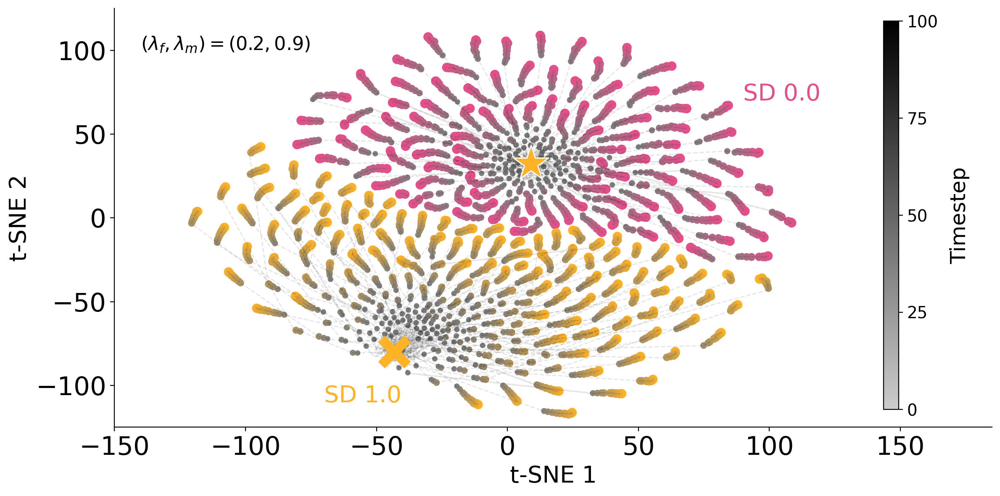

In [ ]:
fig = plt.figure(figsize=(12, 6), dpi=200)
ax = fig.add_subplot(111)

color_list = orig2_color_list

line_list = []
# [0.2, 0.5, 0.8, 1.2, 1.5, 2.0, 3.0]
check_range = [0, 1]

for n in check_range:
    for i in range(100):
        line = ax.scatter(-total_tsne_list[n, i, :, 0][::-1][::10], -total_tsne_list[n, i, :, 1][::-1][::10], c=np.arange(100)[::10], cmap=create_colormap(color_list[n]), s=np.linspace(50, 10, 100)[::10], label=f'trial_{i}')
        line_list.append(line)
        ax.plot(-total_tsne_list[n, i, :, 0], -total_tsne_list[n, i, :, 1], c='k', alpha=0.1, ls='--', lw=1)

#ax.scatter(-np.mean(total_tsne_list[0, :, 0]), -np.mean(total_tsne_list[0, :, 1]), c=orig_color_list[1], marker = 'x', s=500, linewidth=8, edgecolors='white')

ax.scatter(-np.mean(total_tsne_list[check_range[1:], :, 0, 0]), -np.mean(total_tsne_list[check_range[1:], :, 0, 1]), zorder=10, c=orig_color_list[1], marker = 'x', s=500, linewidth=8, edgecolors='white')

ax.scatter(-general_embedding[0], -general_embedding[1], zorder=10, c=orig_color_list[1], marker = '*', s=1000, edgecolors='white')

ax.set_xlim(-150, 185)
ax.set_ylim(-125, 125)

#leg = ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, handles=line_list, fontsize=14, loc='center left', columnspacing=0.5)

ax.text(90, 70, 'SD 0.0', c=color_list[0], fontsize=20)
ax.text(-70, -110, 'SD 1.0', c=color_list[1], fontsize=20)

ax.text(-140, 100, r'$(\lambda_f, \lambda_m) = (0.2,0.9)$', fontsize=16)


ax.set_xlabel('t-SNE 1', fontsize=20)
ax.set_ylabel('t-SNE 2', fontsize=20)
ax.spines[['right', 'top']].set_visible(False)

#ax.legend(handles=line_list, fontsize=12)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

#cbar = plt.colorbar(cim, ax=ax, orientation='vertical')
cax = fig.add_axes([0.88, 0.18, 0.015, 0.77])
cb = mpl.colorbar.ColorbarBase(cax, orientation='vertical', cmap=create_colormap('#CCCCCC', 'black'))
cb.set_label('Timestep', labelpad=10, fontsize=18)
cb.set_ticks(np.linspace(0, 1, 5))
cb.set_ticklabels([0, 25, 50, 75, 100], fontsize=14)

plt.tight_layout()
plt.savefig("figure/EX/figE3e.svg", format="svg", transparent=True)

# **[SI]**

## Figure S1. Empirical data distribution

### S1a. # of comments

In [79]:
with open(join('result', 'freq_mult_rank_w12_dict.pkl'), 'rb') as f:
    ratio_list_w12_dict = pickle.load(f)

In [80]:
data_list = []

for c, collection_name in enumerate(COLLECTION_NAMES):

    num_topics = NUM_TOPICS[collection_name]
    ratio_list_list = ratio_list_w12_dict[collection_name]
    tier = 0
    tmp_list_list = []
    topic_data = [ratio_list_list[i][tier] for i in range(len(ratio_list_list))]

    for topic in range(num_topics):
        tmp_list = []
        for i in range(len(topic_data)):
            if len(topic_data[i][topic])>0:
                tmp_list.extend(topic_data[i][topic])
        print(len(tmp_list))
        
        if len(tmp_list)>0:
            tmp_list = np.array(tmp_list)[:, 0]
            tmp_list_list.append(tmp_list)
            
    data = np.concatenate(tmp_list_list)
    data_list.append(data)

1732
1925
1199
1669
3694
2137
1427
1227
1673
1002
724
766
842
1072
1178
891
1037
819
801
895
941
753
801
852
704
781
875
605
524
654
591
467
621
570
555
573
460
444
678
533
563
476
746
675
473
367
374
339
309
260
320
319
512
276
335
304
303
275
385
250
317
264
313
283
490
264
180
257
284
214
305
255
268
251
201
252
269
269
350
230
163
224
267
211
228
264
223
233
179
202
174
185
185
168
176
234
171
158
244
165
191
204
169
113
136
313
203
187
192
176
160
149
123
173
122
129
123
167
154
134
132
179
180
129
142
123
116
183
148
128
173
134
155
173
110
116
153
102
135
122
170
116
118
107
107
164
136
82
63
96
155
66
81
112
158
138
140
185
196
188
118
165
163
178
200
149
170
160
133
96
114
106
163
159
112
69
118
111
101
117
143
147
99
129
107
116
150
114
86
139
84
109
106
74
71
132
97
92
198
112
183
95
94
108
94
288
134
147
95
56
98
106
110
101
137
127
94
433
117
92
101
113
73
122
153
92
92
86
92
105
136
107
85
95
81
64
50
86
55
99
40
48
46
48
42
27
27
24
53
47
59
6769
3292
5822
9034
10601
973

In [81]:
plot_dict = {}
fit_dict = {}
for i, collection_name in enumerate(COLLECTION_NAMES):
    a, b = np.histogram(data_list[i], bins=30, density=True)
    c = (b[1:] + b[:-1])/2
    lshape, lloc, lscale = stats.lognorm.fit(data_list[i], loc=-0.5)

    plot_dict[collection_name] = (c, a)
    fit_dict[collection_name] = (lloc, lscale, lshape)
    
print(fit_dict)

{'Gatewaypundit': (-1.8252517482879285e-05, np.float64(0.0008796819399094854), np.float64(0.7860274458670808)), 'Breitbart': (5.714868021507431e-06, np.float64(0.00013270397392789546), np.float64(1.4297492941060053)), 'Thehill': (5.6970085679970095e-06, np.float64(0.00011699048964564613), np.float64(1.4953810216049812)), 'Atlantic': (0.00011851008711433681, np.float64(0.0011290281136815267), np.float64(1.3590788651259869)), 'Motherjones': (0.00023309641637704186, np.float64(0.0019393923959851011), np.float64(1.0649542985885165))}


Gatewaypundit 0.7860274458670808 -1.8252517482879285e-05 0.0008796819399094854
Breitbart 1.4297492941060053 5.714868021507431e-06 0.00013270397392789546
Thehill 1.4953810216049812 5.6970085679970095e-06 0.00011699048964564613
Atlantic 1.3590788651259869 0.00011851008711433681 0.0011290281136815267
Motherjones 1.0649542985885165 0.00023309641637704186 0.0019393923959851011


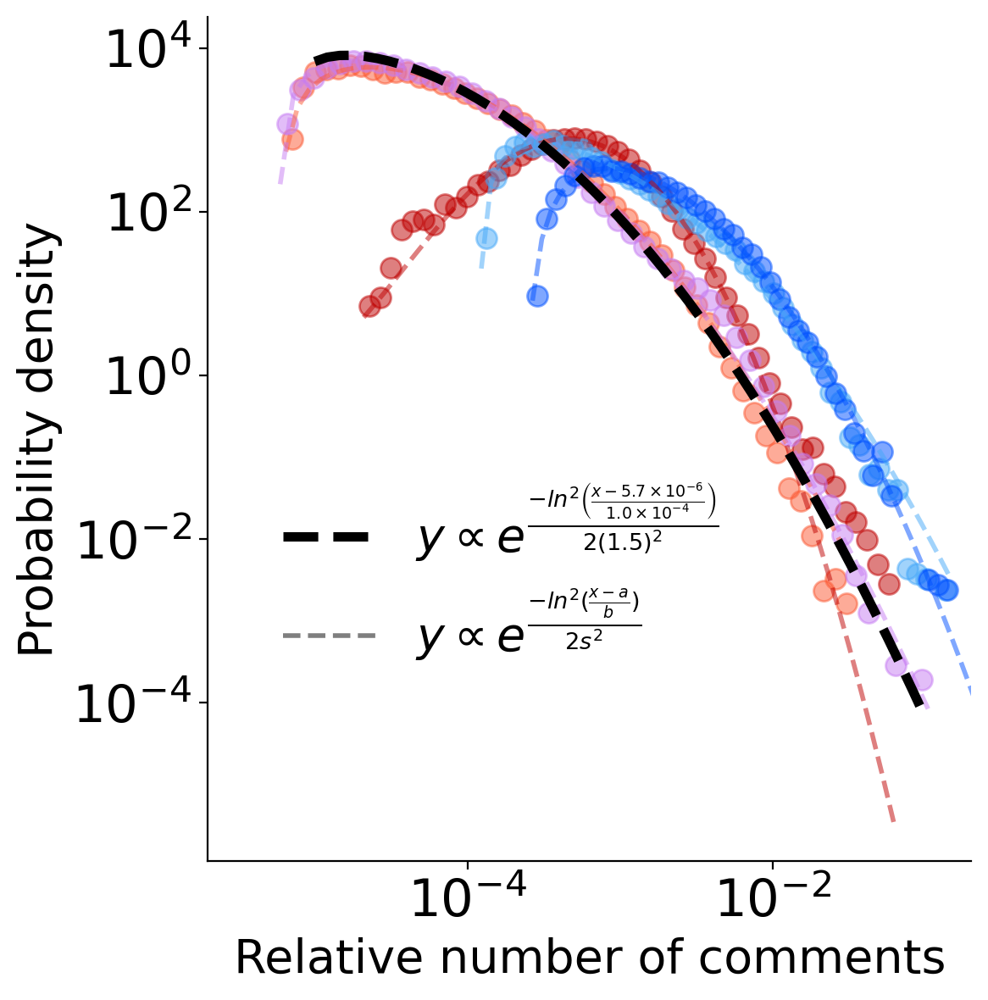

In [82]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list[::-1]
line_list = []

for c, collection_name in enumerate(COLLECTION_NAMES):

    data = data_list[c]
    fit_x = np.logspace(np.log10(np.min(data)), np.log10(np.max(data)))
    #freq, bins = np.histogram(data, bins=np.logspace(np.log10(np.min(data)), np.log10(np.max(data))), density=False)
    freq, bins = np.histogram(data, bins=fit_x, density=True)
    line = ax.scatter((bins[1:]+bins[:-1])/2, freq, color=color_list[c], s=75, alpha=0.5, label=collection_name)

    lshape, lloc, lscale = stats.lognorm.fit(data)
    fit_y = stats.lognorm.pdf(fit_x, lshape, loc=lloc, scale=lscale)
    ax.plot(fit_x, fit_y, color=color_list[c], ls='--', alpha=0.5, linewidth=2, zorder=10-i)

    #results = powerlaw.Fit(data, xmin=6e-6, discrete=False)
    #results.lognormal.plot_pdf(ax=ax, lw=2, ls='--', c=color_list[c], alpha=0.5)
    print(collection_name, lshape, lloc, lscale)
    #print(collection_name, results.lognormal.mu, results.lognormal.sigma)
    

fit_x = np.logspace(-5, -1)
lshape, lloc, lscale = 1.5, 5.7*1e-6, 1*1e-4
fit_y = stats.lognorm.pdf(fit_x, lshape, loc=lloc, scale=lscale)
line = ax.plot(fit_x, fit_y, color='k', ls='--', alpha=1, lw=4, zorder=10, label=r'$y \propto e^{\frac{-ln^2 \left( \frac{x-5.7\times 10^{-6}}{1.0 \times 10^{-4}} \right)}{2(1.5)^2}}$')
line_list.append(line[0])
    
custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto e^{\frac{-ln^2(\frac{x-a}{b})}{2s^2}}$')
line_list.append(custom_line)
ax.legend(handles=line_list, frameon=False, bbox_to_anchor=(0.725, 0.5), fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.set_xlabel('Relative number of comments', fontsize=20)
ax.set_ylabel('Probability density', fontsize=20)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

ax.set_xlim(2e-6, 2e-1)

ax.set_xscale('log')
ax.set_yscale('log')

plt.tight_layout()
plt.savefig("figure/SI/figS1a.svg", format="svg", transparent=True)

### S1b. Zero ratio

In [83]:
with open(join('result', 'freq_mult_rank_w12_global_dict.pkl'), 'rb') as f:
    ratio_list_w12_dict = pickle.load(f)

0 Gatewaypundit
1 Breitbart
2 Thehill
3 Atlantic
4 Motherjones


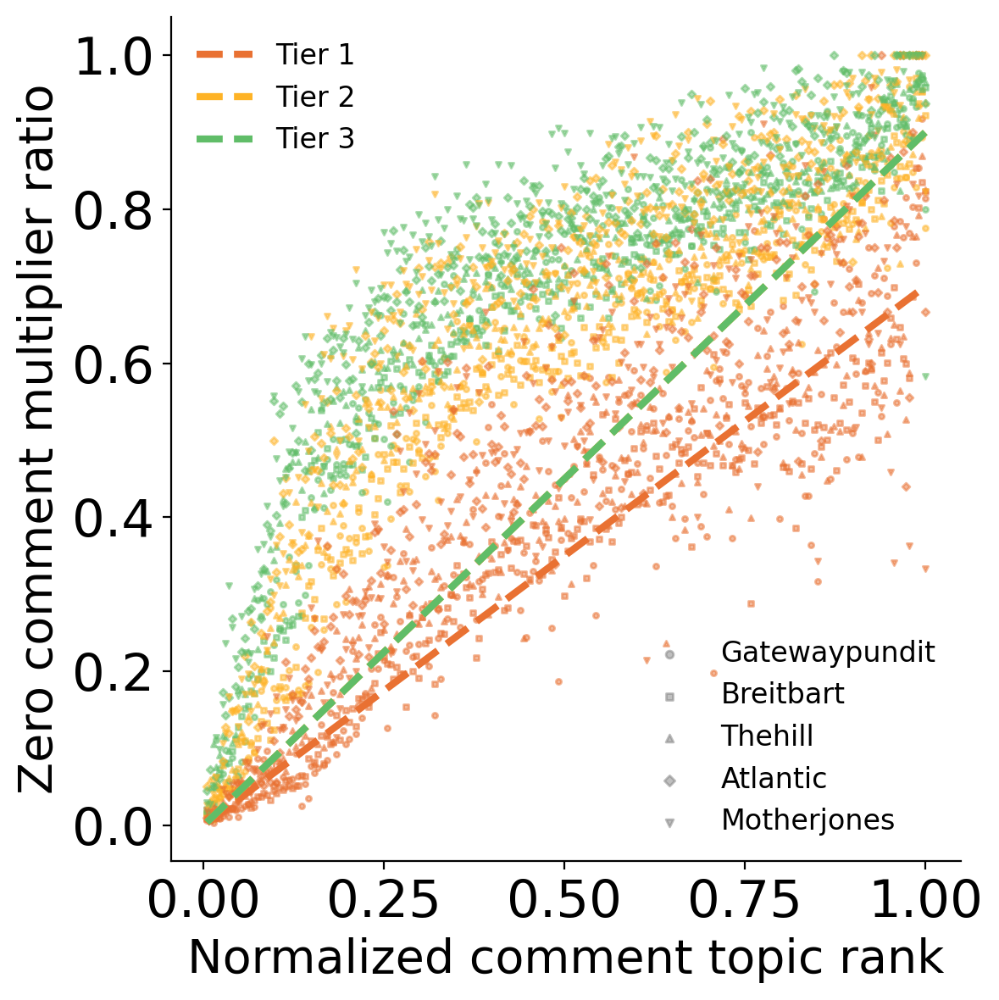

In [84]:
# Zero ratio

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
marker_list = ['o', 's', '^', 'D', 'v']
num_topics = NUM_TOPICS['global']
x = (np.arange(num_topics)+1)/num_topics
line_list = []
scatter_list = []

for c, collection_name in enumerate(COLLECTION_NAMES):
    print(c, collection_name)
    ratio_list_list = ratio_list_w12_dict[collection_name]

    for tier in range(3):
        topic_data = [ratio_list_list[i][tier] for i in range(len(ratio_list_list))]
        
        zero_list = []
        for topic in range(num_topics):
            tmp_list = []
            for i in range(len(topic_data)):
                if len(topic_data[i][topic])>0:
                    tmp_list.extend(np.array(topic_data[i][topic])[:, 1]==0)
            zero_list.append(np.mean(tmp_list))

        ax.scatter(x, zero_list, color=orig_color_list[tier], marker=marker_list[c], alpha=0.5, s=5)
        # Linear fitting
        # slope, intercept = np.polyfit(range(len(zero_list)), zero_list, 1)
        # y_fit = slope * np.array(range(len(zero_list))) + intercept
        # ax.plot(y_fit, '--', color='gray', label='Linear fit')
        # print(slope)
        
    line = ax.scatter([], [], color='gray', marker=marker_list[c], alpha=0.5, s=10, label=collection_name)
    scatter_list.append(line)

legend1 = ax.legend(handles=scatter_list, frameon=False, fontsize=12, loc=4)

zero_ratio_list = [0.7, 0.9, 0.9]

for tier in range(3):
    custom_line = ax.plot(x, zero_ratio_list[tier]*x, color=orig_color_list[tier], lw=3, ls='--', alpha=1, label=f'Tier {tier+1}')
    line_list.append(custom_line[0])
    
legend2 = ax.legend(handles=line_list, frameon=False, fontsize=12, loc=2)
plt.gca().add_artist(legend1)

ax.set_xlabel('Normalized comment topic rank', fontsize=20)
ax.set_ylabel('Zero comment multiplier ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

plt.tight_layout()
plt.savefig("figure/SI/figS1b.svg", format="svg", transparent=True)

### S1c. Multiplier pdf (topic)

In [3]:
#([len(comment_topics)/total_comment_num
# tmp_ratio_list[tier]
# rank_dict[article['topic_num'][rem_list[0]]]
# rank_dict[article['topic_num'][rem_list[1]]]
# tmp_ratio_list[rem_list[0]]
# tmp_ratio_list[rem_list[1]]])

#with open(join('result', 'freq_mult_rank_w12_dict.pkl'), 'rb') as f:
#    ratio_list_w12_dict = pickle.load(f)

with open(join('result', 'freq_mult_rank_w12_global_dict.pkl'), 'rb') as f:
    ratio_list_w12_dict = pickle.load(f)

2
20
200


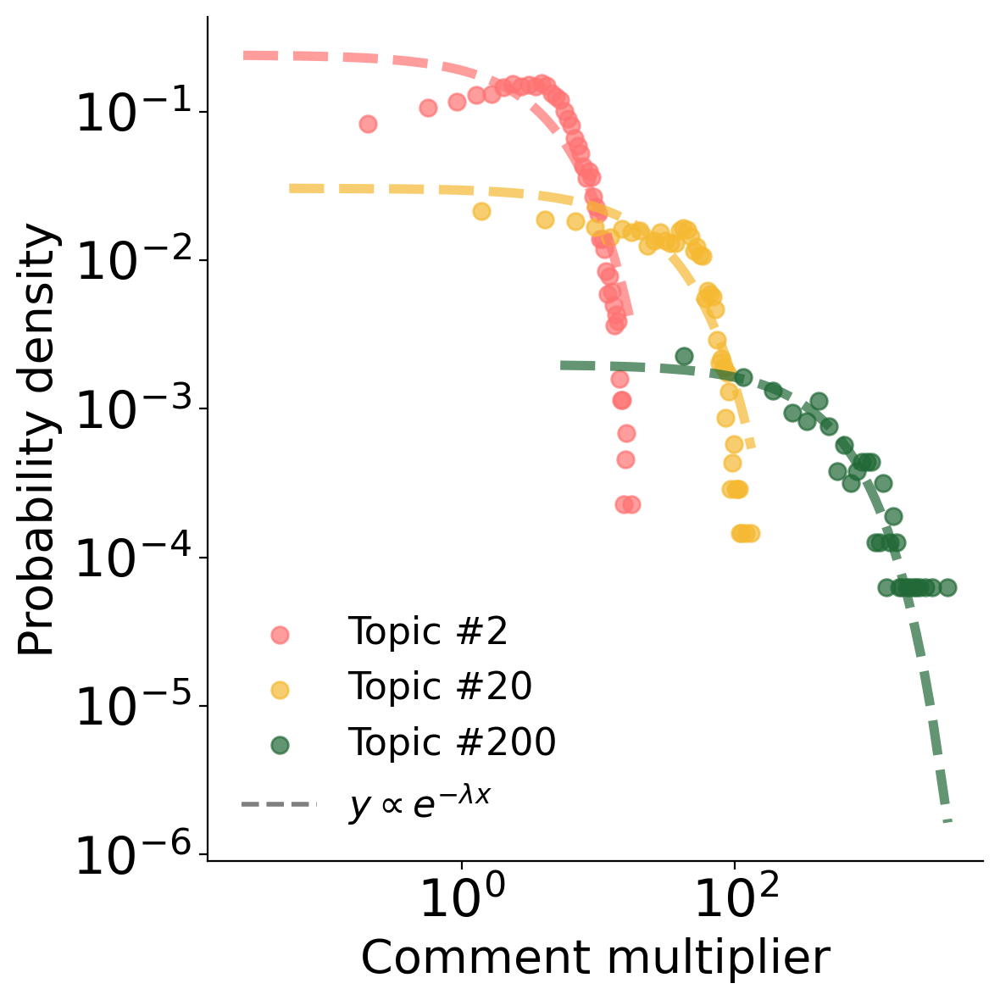

In [4]:
# single tier version

collection_name = 'Thehill'
num_topics = NUM_TOPICS[collection_name]
jet_colors = plt.get_cmap('jet')(np.linspace(0, 1, num_topics+1))

fig = plt.figure(figsize=(6,6), dpi=200)
ax = fig.add_subplot(111)

ratio_list_list = ratio_list_w12_dict[collection_name]
tier = 0
topic_data = [ratio_list_list[i][tier] for i in range(len(ratio_list_list))]
topic_list = [2, 20, 200]

line_list = []

for c, topic in enumerate(topic_list):
    print(topic)
    topic_hist_list = []
    for i in range(len(topic_data)):
        if len(topic_data[i][topic])>0:
            topic_hist_list.extend(np.array(topic_data[i][topic]))
            
    topic_hist_list = np.array(topic_hist_list)
    data = np.array([topic_hist_list[i, 1] for i in range(len(topic_hist_list)) if topic_hist_list[i, 1] != 0])
    freq, bins = np.histogram(data, bins=np.linspace(np.min(data), np.max(data), 50), density=True)
    line = ax.scatter((bins[1:]+bins[:-1])/2, freq, color=diff_color_list[c], s=50, alpha=0.7, label=f'Topic #{topic}')
    line_list.append(line)
    results = powerlaw.Fit(data, xmin=np.min(data), xmax=np.max(data))
    results.exponential.plot_pdf(ax=ax, color=diff_color_list[c], linestyle='--', lw=4, alpha=0.7)

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto e^{-\lambda x}$')
line_list.append(custom_line)
ax.legend(handles=line_list, frameon=False, fontsize=16)

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Comment multiplier', fontsize=20)
ax.set_ylabel('Probability density', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

plt.tight_layout()
plt.savefig("figure/SI/figS1c.svg", format="svg", transparent=True)

### S1d. Multiplier pdf (tier)

In [5]:
with open(join('result', 'freq_mult_rank_w12_global_dict.pkl'), 'rb') as f:
    ratio_list_w12_dict = pickle.load(f)

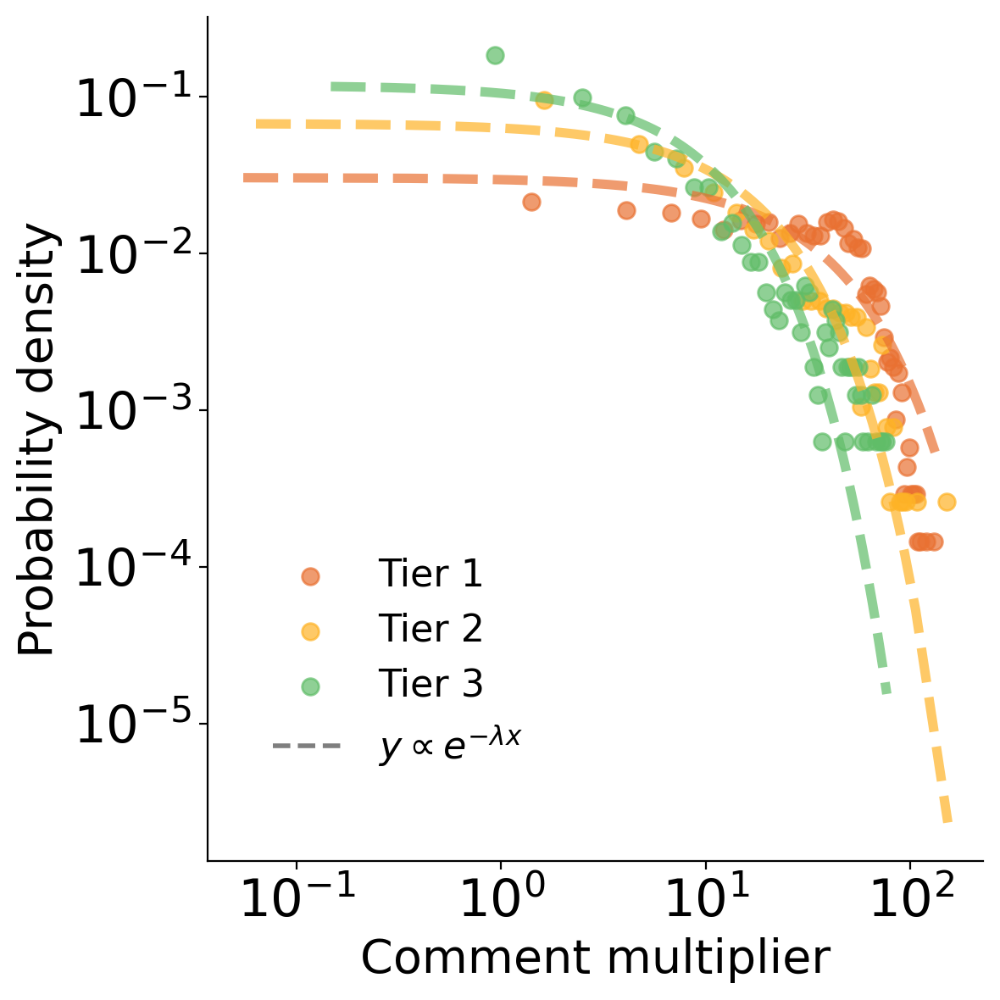

In [6]:
# single topic version

collection_name = 'Thehill'
num_topics = NUM_TOPICS[collection_name]
jet_colors = plt.get_cmap('jet')(np.linspace(0, 1, num_topics+1))

fig = plt.figure(figsize=(6,6), dpi=200)
ax = fig.add_subplot(111)

ratio_list_list = ratio_list_w12_dict[collection_name]

topic = 20
line_list = []

for tier in range(3):

    topic_data = [ratio_list_list[i][tier] for i in range(len(ratio_list_list))]
    topic_hist_list = []
    for i in range(len(topic_data)):
        if len(topic_data[i][topic])>0:
            topic_hist_list.extend(np.array(topic_data[i][topic]))
            
    topic_hist_list = np.array(topic_hist_list)
    data = np.array([topic_hist_list[i, 1] for i in range(len(topic_hist_list)) if topic_hist_list[i, 1] != 0])
    freq, bins = np.histogram(data, bins=np.linspace(np.min(data), np.max(data), 50), density=True)
    line = ax.scatter((bins[1:]+bins[:-1])/2, freq, color=orig_color_list[tier], s=50, alpha=0.7, label=f'Tier {tier+1}')
    line_list.append(line)
    results = powerlaw.Fit(data, xmin=np.min(data), xmax=np.max(data))
    results.exponential.plot_pdf(ax=ax, color=orig_color_list[tier], linestyle='--', lw=4, alpha=0.7)

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto e^{-\lambda x}$')
line_list.append(custom_line)
ax.legend(handles=line_list, frameon=False, fontsize=16, bbox_to_anchor=(0.45, 0.4))

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Comment multiplier', fontsize=20)
ax.set_ylabel('Probability density', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

plt.tight_layout()
plt.savefig("figure/SI/figS1d.svg", format="svg", transparent=True)

### S1e. Multiplier scatter (# of comments)

In [7]:
with open(join('result', 'freq_mult_rank_w12_dict.pkl'), 'rb') as f:
    ratio_list_w12_dict = pickle.load(f)
    
def harmonic_approx(N):
    return np.log(N) + 0.57721 + 1/(2*N) - 1/(12*N**2)

In [8]:
collection_name = 'Thehill'
num_topics = NUM_TOPICS[collection_name]
jet_colors = plt.get_cmap('jet')(np.linspace(0, 1, num_topics+1))

tier = 0
topic = 20

N = ranking_dict[collection_name][topic] + 1
er = harmonic_approx(num_topics) * N

ratio_list_list = ratio_list_w12_dict[collection_name]
topic_data = [ratio_list_list[i][tier] for i in range(len(ratio_list_list))]
topic_hist_list = []

for i in range(len(topic_data)):
    if len(topic_data[i][topic])>0:
        topic_hist_list.extend(np.array(topic_data[i][topic]))
        
topic_hist_list = np.array(topic_hist_list)

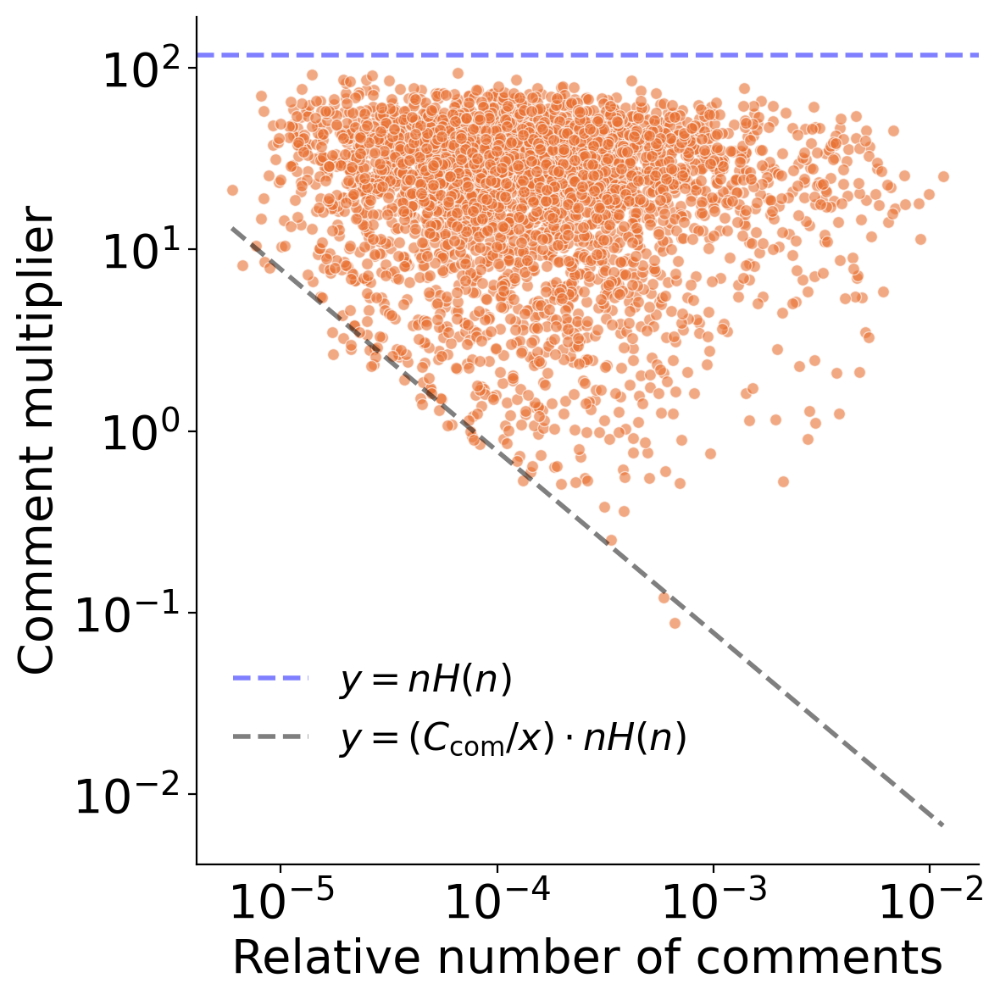

In [9]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)

x = topic_hist_list[:, 0]
y = topic_hist_list[:, 1]
mask = (y!=0)

ax.scatter(x[mask], y[mask], s=25, color=orig_color_list[0], alpha=0.6, edgecolors='w', linewidth=0.5)

a = np.linspace(np.min(topic_hist_list[:, 0]), np.max(topic_hist_list[:, 0]), 1000)
ax.axhline(er, color='b', ls='--', lw=2, alpha=0.5, label=r'$y = nH(n)$')
ax.plot(a, er/(a*1.5e6), color='k', ls='--', lw=2, alpha=0.5, label=r'$y = (C_{\mathrm{com}}/x) \cdot nH(n)$')

ax.set_xlabel('Relative number of comments', fontsize=20)
ax.set_ylabel('Comment multiplier', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)
ax.set_xscale('log')
ax.set_yscale('log')
ax.legend(fontsize=16, frameon=False, bbox_to_anchor=(0.67, 0.28))

plt.tight_layout()
plt.savefig("figure/SI/figS1e.svg", format="svg", transparent=True)

In [ ]:
# auxilary, cross-section

fig = plt.figure(figsize=(3, 3), dpi=200)
ax = fig.add_subplot(111)

for c in range(3):
    data = data_list[c]
    freq, bins = np.histogram(data, bins=np.logspace(np.log10(np.min(data)), np.log10(np.max(data)), 30), density=True)
    ax.scatter((bins[1:]+bins[:-1])/2, freq, s=50, color=diff2_color_list[c], alpha=0.5)

    dist = powerlaw.Exponential()
    dist.Lambda = lambda_list[c]
    #dist.beta = beta_list[c]
    dist.xmin = np.min(data)
    x = dist.generate_random(1000000)
    freq, bins = np.histogram(x, bins=np.logspace(np.log10(np.min(data)), np.log10(np.max(data)), 30), density=True)
    ax.plot((bins[1:]+bins[:-1])/2, freq, ls='--', color=diff2_color_list[c], lw=2, alpha=0.5)

line_list = []
custom_line = Line2D([], [], color='gray', lw=2, ls='--', alpha=0.5, label=r'$y \propto e^{-\lambda x}$')
line_list.append(custom_line)
ax.legend(handles=line_list, frameon=False, fontsize=12, loc='lower left')

#ax.set_xscale('log')
ax.set_yscale('log')
ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=16)

ax.set_xlabel('Multiplier', fontsize=16)
ax.set_ylabel('Probability density', fontsize=16)

plt.tight_layout()
plt.savefig("figure/EX/figE2c2.svg", format="svg", transparent=True)

### S1f. Lambda fitting

In [10]:
# Lambda / beta list for tiers (for simple)

collection_name = 'Thehill'
num_topics = NUM_TOPICS['global']
jet_colors = plt.get_cmap('jet')(np.linspace(0, 1, num_topics+1))
ratio_list_list = ratio_list_w12_dict[collection_name]

lambda_list = []

for tier in range(3):
    lambda_list.append([])
    for topic in range(num_topics):
        print(topic)
        topic_data = [ratio_list_list[i][tier] for i in range(len(ratio_list_list))]
        topic_hist_list = []

        for i in range(len(topic_data)):
            if len(topic_data[i][topic])>0:
                topic_hist_list.extend(np.array(topic_data[i][topic]))
                
        topic_hist_list = np.array(topic_hist_list)
        data = topic_hist_list[:, 1]
        data = data[data!=0]

        results = powerlaw.Fit(data, xmin=np.min(data), xmax=np.max(data))
        lambda_list[-1].append(results.exponential.Lambda)

lambda_list = np.array(lambda_list)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
6

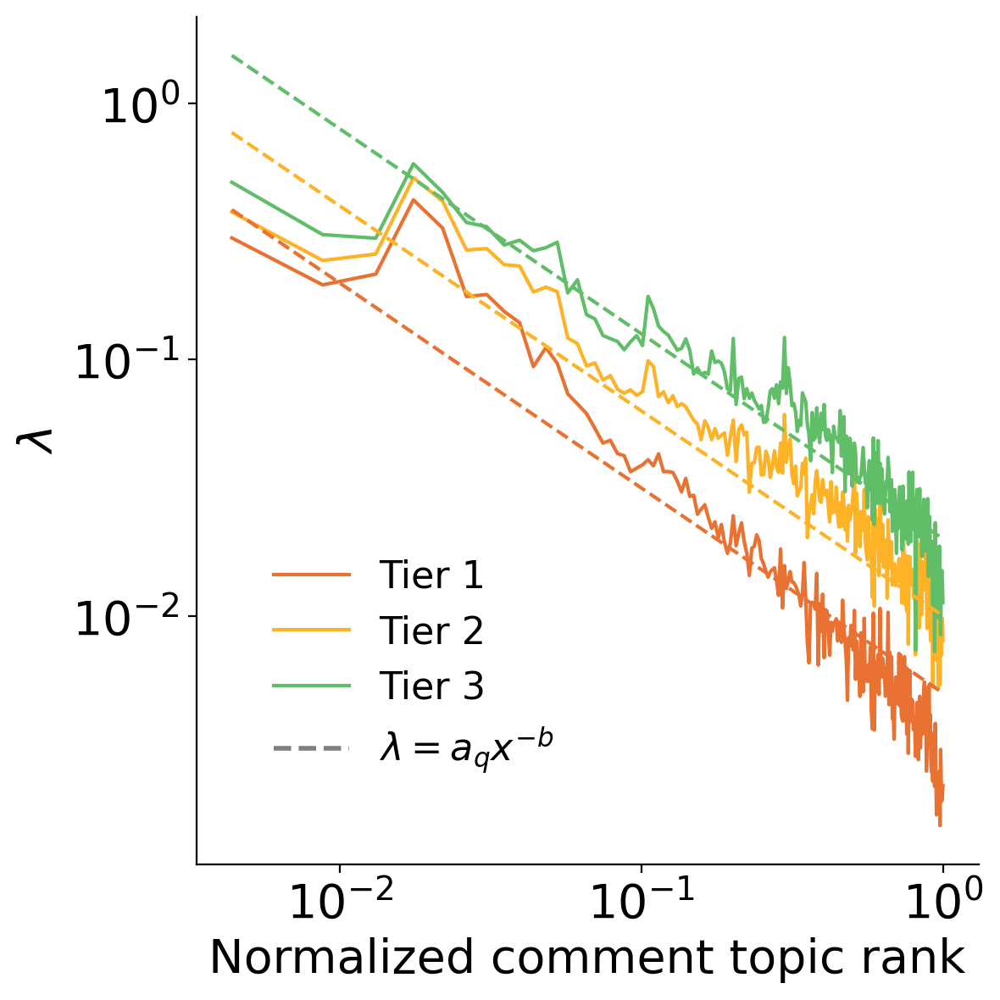

In [11]:
fig = plt.figure(figsize=(6,6), dpi=200)
ax = fig.add_subplot(111)

a_fit_list = [5e-3, 1e-2, 2e-2] 
b_fit = 0.8
line_list = []

for i in range(3):
    data = lambda_list[i]
    x = np.arange(1, num_topics+1)/num_topics
    line = ax.plot(x, lambda_list[i], color=orig_color_list[i], label='Tier '+str(i+1))
    line_list.append(line[0])
    
ax.plot(x, a_fit_list[0]/x**b_fit, color=orig_color_list[0], ls='--')
ax.plot(x, a_fit_list[1]/x**b_fit, color=orig_color_list[1], ls='--')
ax.plot(x, a_fit_list[2]/x**b_fit, color=orig_color_list[2], ls='--')

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$\lambda = a_{q}x^{-b}$')
line_list.append(custom_line)


ax.set_xlabel('Normalized comment topic rank', fontsize=20)
ax.set_ylabel(r'$\lambda$', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)
ax.set_xscale('log')
ax.set_yscale('log')
ax.legend(handles=line_list, frameon=False, fontsize=16, bbox_to_anchor=(0.5, 0.4))

plt.tight_layout()
plt.savefig("figure/SI/figS1f.svg", format="svg", transparent=True)

## Figure S2. Auxiliary analysis-1

### S2a. off-corr follows original distribution

In [ ]:
with open(join('result', 'corr_rank_freq_global_dict.pkl'), 'rb') as f:
    data = pickle.load(f)
    
ranking_month_list_dict = data['ranking_month_list_dict']
frequency_month_list_dict = data['frequency_month_list_dict']

In [ ]:
off_corr_dict = {}

for c, collection_name in enumerate(COLLECTION_NAMES):
    corr_freq_month_list = frequency_month_list_dict['corr'][collection_name]
    off_corr_freq_month_list = frequency_month_list_dict['off_corr'][collection_name]
    data = np.sum(off_corr_freq_month_list, axis=0)
    off_corr_dict[collection_name] = data / np.sum(data)

Gatewaypundit 1.1438533795004293 0.0005025915933397417
Breitbart 1.104006286203123 0.0005883375863795846
Thehill 1.1553795883132143 0.0004926857483635033
Atlantic 0.9517457778440322 0.0010101947768614366
Motherjones 1.0342989364533928 0.0007413373593228985


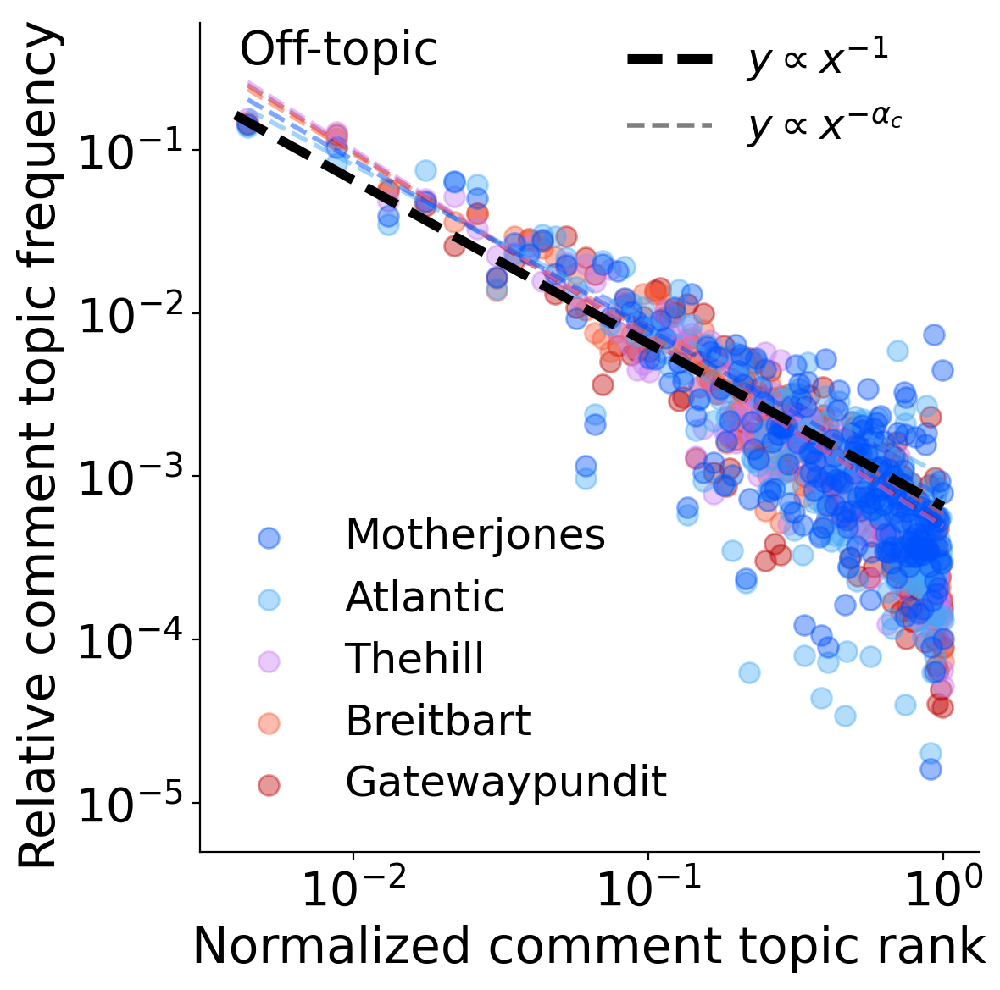

In [ ]:

# Define the power-law model function
def func_power_law(x, a, b):
    return b * x**(-a)

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list[::-1]
line_list = []

for i, collection_name in enumerate(COLLECTION_NAMES):
    x = np.arange(1, NUM_TOPICS['global']+1)/ NUM_TOPICS['global']
    line = ax.scatter(x, off_corr_dict[collection_name], c=color_list[i], s=75, alpha=0.4, label=collection_name)
    line_list.append(line)
    
    # Fit the data to the power-law model
    popt, pcov = curve_fit(func_power_law, x[1:], off_corr_dict[collection_name][1:], p0=[1.0, 1.0])

    # Extract the optimal parameters
    a_opt, b_opt = popt
    print(collection_name, a_opt, b_opt)

    # Generate fitted values
    y_fit = func_power_law(x, a_opt, b_opt)

    ax.plot(x, y_fit, color=color_list[i], lw=2, ls='--', zorder=10, alpha=0.5)

line_list = line_list[::-1]
legend1 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor=(0.65, 0.45), fontsize=18)

line_list = []

x = np.arange(1, NUM_TOPICS['Gatewaypundit']+1)/ NUM_TOPICS['Gatewaypundit']
pdf, _ = power_law(alpha=1, xmax=NUM_TOPICS['Gatewaypundit'])

line = ax.plot(x, pdf, c='k', lw=4, ls='--', zorder=10, alpha=1, label=r'$y \propto x^{-1}$')
line_list.append(line[0])

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto x^{-\alpha_{c}}$')
line_list.append(custom_line)

ax.set_xlabel('Normalized comment topic rank', fontsize=21)
ax.set_ylabel('Relative comment topic frequency ', fontsize=21)
ax.spines[['right', 'top']].set_visible(False)
ax.text(0.05, 0.95, f'Off-topic', fontsize=20, transform=ax.transAxes)
ax.set_ylim(5e-6, 6e-1)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor=(0.5, 0.8), fontsize=18)
plt.gca().add_artist(legend1)
ax.set_xscale('log')
ax.set_yscale('log')

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/SI/figS2a.svg", format="svg", transparent=True)

### S2b. Weight decay

In [ ]:
aggregate_day = '3d'
data_list_dict = {}

num_topics = NUM_TOPICS['global']
pairs = list(combinations(range(num_topics), 2))

for collection_name in COLLECTION_NAMES:
    print(collection_name)

    nonexist_last_dict = {pair:-1 for pair in pairs}
    nonexist_streak_dict = {}
    file_names = os.listdir(join('/data', 'collmind', 'article_global', collection_name.lower(), aggregate_day, 'df'))
    keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))

    pairs = list(combinations(range(num_topics), 2))
    nonexist_last_dict = {pair:-1 for pair in pairs}
    nonexist_streak_dict = {pair:0 for pair in pairs}

    data_list = {i:[] for i in range(len(keys))}

    for key in keys:
        print(key)
        data = pd.read_parquet(join('/data', 'collmind', 'article_global', collection_name.lower(), aggregate_day, 'df', key+'.parquet'))
        embedding = np.vstack(data['topic_mean_embedding'].values)
        
        sim_matrix_full = cosine_similarity(embedding, embedding)
        non_exist = np.where(data['topic_freq'].values==0)[0]
        
        for pair in pairs:
            if pair[0] in non_exist or pair[1] in non_exist:
                nonexist_streak_dict[pair] += 1
            else:
                current = sim_matrix_full[pair[0], pair[1]]
                if nonexist_streak_dict[pair]>0:
                    if nonexist_last_dict[pair]==-1:
                        nonexist_last_dict[pair] = current
                    else:
                        data_list[nonexist_streak_dict[pair]].append([nonexist_last_dict[pair], current])
                        
                nonexist_streak_dict[pair] = 0
                
    data_list_dict[collection_name] = data_list
    
# save data_list_dict
with open(join('result', f'weight_decay_{aggregate_day}_dict.pkl'), 'wb') as f:
    pickle.dump(data_list_dict, f)

Gatewaypundit
2015-01-01
2015-01-04
2015-01-07
2015-01-10
2015-01-13
2015-01-16
2015-01-19
2015-01-22
2015-01-25
2015-01-28
2015-01-31
2015-02-03
2015-02-06
2015-02-09
2015-02-12
2015-02-15
2015-02-18
2015-02-21
2015-02-24
2015-02-27
2015-03-02
2015-03-05
2015-03-08
2015-03-11
2015-03-14
2015-03-17
2015-03-20
2015-03-23
2015-03-26
2015-03-29
2015-04-01
2015-04-04
2015-04-07
2015-04-10
2015-04-13
2015-04-16
2015-04-19
2015-04-22
2015-04-25
2015-04-28
2015-05-01
2015-05-04
2015-05-07
2015-05-10
2015-05-13
2015-05-16
2015-05-19
2015-05-22
2015-05-25
2015-05-28
2015-05-31
2015-06-03
2015-06-06
2015-06-09
2015-06-12
2015-06-15
2015-06-18
2015-06-21
2015-06-24
2015-06-27
2015-06-30
2015-07-03
2015-07-06
2015-07-09
2015-07-12
2015-07-15
2015-07-18
2015-07-21
2015-07-24
2015-07-27
2015-07-30
2015-08-02
2015-08-05
2015-08-08
2015-08-11
2015-08-14
2015-08-17
2015-08-20
2015-08-23
2015-08-26
2015-08-29
2015-09-01
2015-09-04
2015-09-07
2015-09-10
2015-09-13
2015-09-16
2015-09-19
2015-09-22
2015-09

In [ ]:
# save data_list_dict
with open(join('result', f'weight_decay_{aggregate_day}_dict.pkl'), 'wb') as f:
    pickle.dump(data_list_dict, f)

In [ ]:
aggregate_day = 'month'

with open(join('result', f'weight_decay_{aggregate_day}_dict.pkl'), 'rb') as f:
    data_list_dict = pickle.load(f)

In [ ]:
decay_dict = {}

for collection_name in COLLECTION_NAMES:
    print(collection_name)
    decay_list = []

    for i in range(1, len(data_list_dict[collection_name])):
        data = np.array(data_list_dict[collection_name][i])
        if len(data)>0:
            print(i, np.mean(data[:, 0]-data[:, 1]))
            decay_list.append([i, np.mean(data[:, 0]-data[:, 1])])
            
    decay_list = np.array(decay_list)
    
    decay_dict[collection_name] = decay_list

Gatewaypundit
1 -0.04472769051183146
2 -0.04382158797642205
3 -0.031052460236882264
4 -0.05721828629635988
5 -0.06299811648391095
6 -0.039595884856730885
7 -0.06882795334740993
8 -0.12286664330743562
9 -0.01626681656856796
10 0.010737933635543684
11 0.06197419976127984
12 0.008181129960962485
13 -0.10239331375377385
14 -0.015158600770750121
15 -0.11681810414647747
17 -0.10378717707600114
19 -0.27839947195429404
21 -0.3406240964245255
Breitbart
1 0.021413311889797403
2 -0.01131429466953997
3 -0.09129178291176729
4 0.07927367224664222
5 -0.1201885457205506
6 0.09766817053531407
Thehill
1 -0.018400742168086827
2 0.011317923920508611
3 0.016942630739811154
4 0.01780573807155033
5 0.03798747551602554
6 0.0019483405400100469
7 0.03039347389171213
8 0.013028969199076902
9 -0.0460783131882561
11 -0.1449985733070737
12 -0.016005738646766465
14 0.11782420884927008
Atlantic
1 -0.023151517676063223
2 -0.030470791125119193
3 -0.0055333938441676335
4 -0.007220644614841771
5 -0.0037102613022144447
6 

Gatewaypundit -0.009863097657888563 0.021228074727371607
Breitbart 0.0064347712923703134 -0.026594944294980122
Thehill -0.000301884083294544 0.003876657353994527
Atlantic -0.0042319523685694005 0.02192629506973704
Motherjones -5.354598291494448e-05 -0.010706195935129892
general -0.0022681419345803432 -0.0036962248570278945


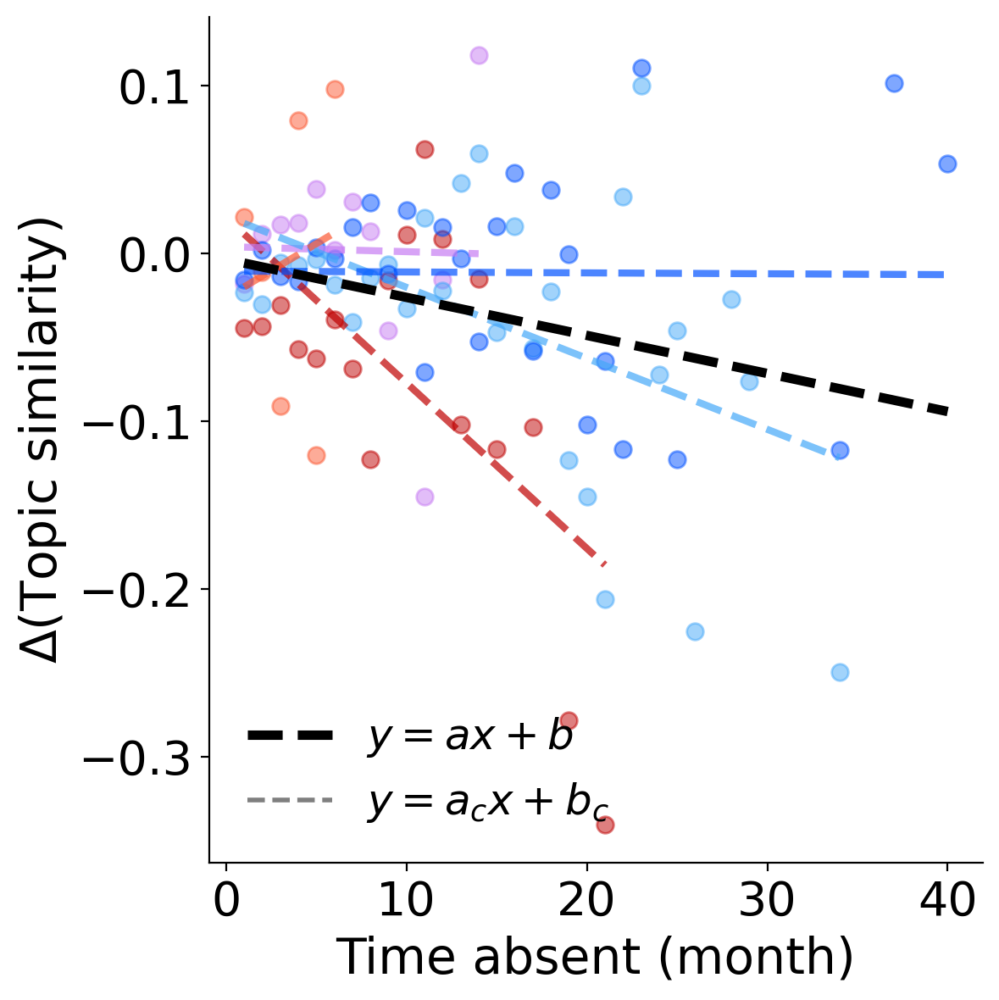

In [ ]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list[::-1]
line_list = []

for i, collection_name in enumerate(COLLECTION_NAMES):
    data = decay_dict[collection_name]
    
    ax.scatter(data[:, 0], data[:, 1], color=color_list[i], label=collection_name, s=50, alpha=0.5)
    # linear fitting
    slope, intercept, r_value, p_value, std_err = stats.linregress(data[:, 0], data[:, 1])
    # plot 
    x = np.linspace(np.min(data[:, 0]), np.max(data[:, 0]), 100)
    ax.plot(x, x*slope+intercept, color=color_list[i], lw=3, ls='--', alpha=0.7)
    print(collection_name, slope, intercept)
    
data = np.concatenate([decay_dict[collection_name] for collection_name in COLLECTION_NAMES])

# linear fitting
slope, intercept, r_value, p_value, std_err = stats.linregress(data[:, 0], data[:, 1])
x = np.linspace(np.min(data[:, 0]), np.max(data[:, 0]), 100)
line = ax.plot(x, x*slope+intercept, color='k', lw=4, ls='--', alpha=1, label = r'$y = ax + b$')
line_list.append(line[0])
print('general', slope, intercept)

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y = a_cx + b_c$')
line_list.append(custom_line)

ax.set_xlabel('Normalized comment topic rank', fontsize=21)
ax.set_ylabel('Relative comment topic frequency ', fontsize=21)
ax.spines[['right', 'top']].set_visible(False)
#ax.text(0.05, 0.05, f'Data', fontsize=20, transform=ax.transAxes)

legend = ax.legend(handles=line_list, frameon=False,  fontsize=18)
    
ax.set_xlabel('Time absent (month)', fontsize=21)
ax.set_ylabel(r'$\Delta$'+'(Topic similarity)', fontsize=21)
ax.spines[['right', 'top']].set_visible(False)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/SI/figS2b.svg", format="svg", transparent=True)

## Figure S3. Auxiliary analysis - 2

In [75]:
num_topics = NUM_TOPICS['global']
collection_name = 'Gatewaypundit'

# Load the big_dict from the file
with open(join('result', f'comment_sim_{collection_name}_global_dict.pkl'), 'rb') as f:
    big_dict = pickle.load(f)


In [77]:
aggregate_day = 'month'

similarity_other_list = big_dict[aggregate_day]['similarity_other_list']
similarity_self_list_list = big_dict[aggregate_day]['similarity_self_list_list']

In [82]:
tier = 2
index = similarity_self_list_list[tier] != 0
d_self = similarity_self_list_list[tier, index]
d_other = similarity_other_list[index]

np.mean(d_self), np.mean(d_other)

(0.38740793237210974, 0.1593815506343905)

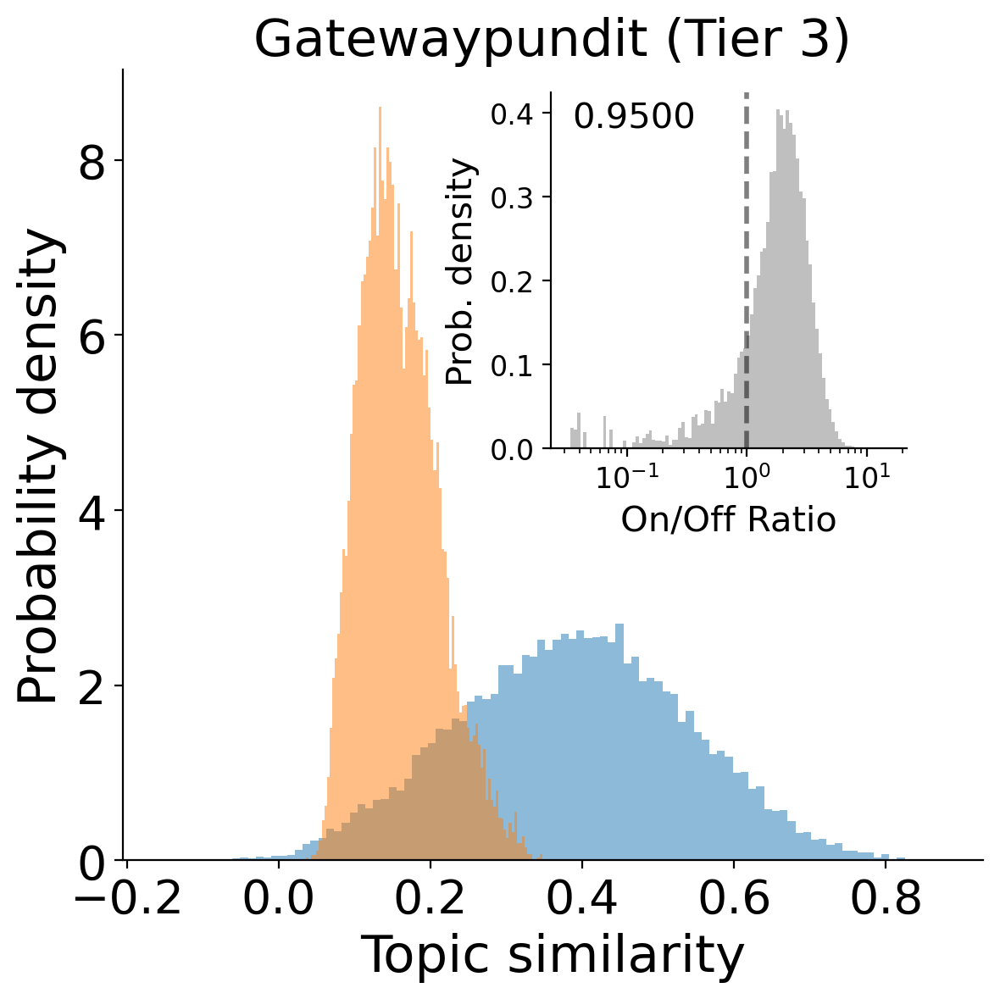

In [83]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list[::-1]
line_list = []

ax.hist(d_self, bins=100, alpha=0.5, label='Self Similarity', density=True)
ax.hist(d_other, bins=100, alpha=0.5, label='Other Similarity', density=True)


ax.set_xlabel('Normalized comment topic rank', fontsize=21)
ax.set_ylabel('Relative comment topic frequency ', fontsize=21)
ax.spines[['right', 'top']].set_visible(False)
#ax.text(0.05, 0.05, f'Data', fontsize=20, transform=ax.transAxes)


inset_ax = fig.add_axes([0.55, 0.55, 0.35, 0.35])

x = d_self/d_other
x = x[x>0]
inset_ax.hist(x, bins=np.logspace(-1.5, 1.2, 100), alpha=0.5, color='gray', density=True)
inset_ax.axvline(1.0, color='k', ls='--', lw=2, alpha=0.5)
# get how many of x is equal or greater than 1 and add text to the inset
inset_ax.text(0.06, 0.9, f'{np.sum(x>=1)/len(x):.4f}', fontsize=15, transform=inset_ax.transAxes)

inset_ax.set_xscale('log')
inset_ax.set_xlabel('On/Off Ratio', fontsize=15)
inset_ax.set_ylabel('Prob. density', fontsize=15)
inset_ax.spines[['right', 'top']].set_visible(False)
inset_ax.tick_params(axis='both', labelsize=12)
    
ax.set_title(f'{collection_name} (Tier {tier+1})', fontsize=22)    

ax.set_xlabel('Topic similarity', fontsize=22)
ax.set_ylabel('Probability density', fontsize=22)
ax.spines[['right', 'top']].set_visible(False)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/SI/figS3i.svg", format="svg", transparent=True)

## Figure S4. # of articles / comments

In [151]:
date_dict = {collection_name: [] for collection_name in COLLECTION_NAMES}
article_num_dict = {collection_name: {} for collection_name in COLLECTION_NAMES}
article_num_exist_dict = {collection_name: {} for collection_name in COLLECTION_NAMES} # article number more than 1 comments
article_num_filtered_dict = {collection_name: {} for collection_name in COLLECTION_NAMES} # article number more than 10 comments
comment_num_dict = {collection_name: {} for collection_name in COLLECTION_NAMES}
comment_num_exist_dict = {collection_name: {} for collection_name in COLLECTION_NAMES} # comment number more than 1
comment_num_filtered_dict = {collection_name: {} for collection_name in COLLECTION_NAMES} # comment number more than 10
comment_threshold = 11

for collection_name in COLLECTION_NAMES:
    model_name = MODEL_NAMES[collection_name]
    with open(join('article', collection_name.lower(), model_name, 'article_num_counter_dict.pkl'), 'rb') as f:
        article_num_counter_dict = pickle.load(f)
    with open(join('article', collection_name.lower(), model_name, 'comment_num_counter_dict.pkl'), 'rb') as f:
        comment_num_counter_dict = pickle.load(f)

    for key, counter in article_num_counter_dict.items():
        date_dict[collection_name].append(key)
        article_num_dict[collection_name][key] = counter[list(counter.keys())[-1]]
        if list(counter.keys())[0] >= 1:
            threshold_key = next(k for k in reversed(counter.keys()) if k >= 1)
            article_num_exist_dict[collection_name][key] = counter[threshold_key] 
        else:
            article_num_exist_dict[collection_name][key] = 0
        if list(counter.keys())[0] >= comment_threshold:
            threshold_key = next(k for k in reversed(counter.keys()) if k >= comment_threshold)
            article_num_filtered_dict[collection_name][key] = counter[threshold_key]
        else:
            article_num_filtered_dict[collection_name][key] = 0
        
    for key, counter in comment_num_counter_dict.items():
        comment_num_dict[collection_name][key] = counter[list(counter.keys())[-1]]
        if list(counter.keys())[0] >= 1:
            threshold_key = next(k for k in reversed(counter.keys()) if k >= 1)
            comment_num_exist_dict[collection_name][key] = counter[threshold_key] 
        else:
            comment_num_exist_dict[collection_name][key] = 0 
        if list(counter.keys())[0] >= comment_threshold:
            threshold_key = next(k for k in reversed(counter.keys()) if k >= comment_threshold)
            comment_num_filtered_dict[collection_name][key] = counter[threshold_key]
        else:
            comment_num_filtered_dict[collection_name][key] = 0

In [918]:
figure_dict = {}
for collection_name in COLLECTION_NAMES:
    figure_dict[collection_name] = (date_dict[collection_name], 
                                    list(article_num_dict[collection_name].values()), 
                                    list(article_num_exist_dict[collection_name].values()), 
                                    list(article_num_filtered_dict[collection_name].values()),
                                    list(comment_num_dict[collection_name].values()),
                                    list(comment_num_exist_dict[collection_name].values()),
                                    list(comment_num_filtered_dict[collection_name].values()))
    

Motherjones
Atlantic
Thehill


Breitbart
Gatewaypundit


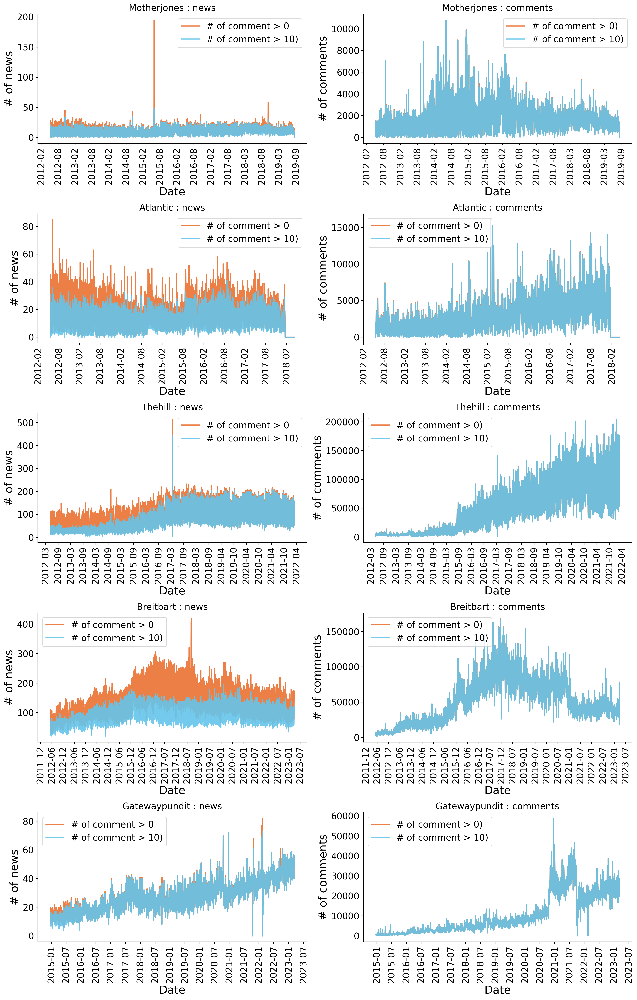

In [ ]:
# Create a figure with two subplots
fig, axes = plt.subplots(5, 2, figsize=(16, 25), dpi=200)

for c, collection_name in enumerate(COLLECTION_NAMES[::-1]):
    print(collection_name)
    ax1 = axes[c][0]
    ax2 = axes[c][1]
    
    date, an, ane, anf, cn, cne, cnf = figure_dict[collection_name]
    # Convert the date strings to datetime objects
    dates = [datetime.strptime(d, '%Y-%m-%d') for d in date]
        
    # Set the x-axis format to display the dates as 'days' with a 30-day interval
    ax1.xaxis.set_major_locator(mdates.DayLocator(interval=183))
    ax1.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    ax2.xaxis.set_major_locator(mdates.DayLocator(interval=183))
    ax2.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

    # Rotate the xtick labels by 90 degrees
    ax1.tick_params(axis='x', rotation=90)
    ax2.tick_params(axis='x', rotation=90)

    # Plot the data for cne
    ax1.plot(dates, ane, label='# of comment > 0', linewidth=2, alpha=0.9, c=color_list[0])
    ax1.plot(dates, anf, label='# of comment > 10)', linewidth=2, alpha=0.9, c=color_list[3])
    #ax1.plot([datetime.strptime(d, '%Y-%m-%d') for d in ['2013-05-17', '2014-05-18', '2015-05-19', '2016-05-20', '2020-05-21']], [100, 200, 300, 400, 500], linewidth=3)

    ax2.plot(dates, cne, label='# of comment > 0)', linewidth=2, alpha=0.9, c=color_list[0])
    ax2.plot(dates, cnf, label='# of comment > 10)', linewidth=2, alpha=0.9, c=color_list[3])

    # Add labels and legends to each subplot
    ax1.set_xlabel('Date', fontsize=20)
    ax1.set_ylabel('# of news', fontsize=20)

    ax2.set_xlabel('Date', fontsize=20)
    ax2.set_ylabel('# of comments', fontsize=20)

    #print(f'ane : {np.sum(ane)}, anf : {np.sum(anf)}, cne : {np.sum(cne)}, cnf : {np.sum(cnf)}')
    #print(f'article ratio : {np.sum(anf)/np.sum(ane)}, comment ratio : {np.sum(cnf)/np.sum(cne)}')

    ax1.spines[['right', 'top']].set_visible(False)
    ax1.legend(fontsize=16)

    ax2.spines[['right', 'top']].set_visible(False)
    ax2.legend(fontsize=16)

    # Remove small ticks and increase tick font size
    ax1.tick_params(which='minor', width=0, length=0)
    ax1.tick_params(axis='both', labelsize=16)

    ax2.tick_params(which='minor', width=0, length=0)
    ax2.tick_params(axis='both', labelsize=16)
    
    ax1.set_title(f'{collection_name} : news', fontsize=16)
    ax2.set_title(f'{collection_name} : comments', fontsize=16)

plt.tight_layout()
plt.savefig(f"figure/SI/figS4.svg", format="svg", transparent=True, bbox_inches='tight')

In [ ]:
aggregate_day = 'month'
exclude_neg_one = True
for collection_name in COLLECTION_NAMES:
    print(collection_name)
    num_topics = NUM_TOPICS[collection_name]
    with open(join('/data', 'collmind', 'article', collection_name.lower(), aggregate_day, f'topic_dict_{aggregate_day}.pkl'), 'rb') as f:
        articles_by_month = pickle.load(f)
    
    articles_by_month = articles_by_month_clear(articles_by_month, exclude_neg_one=exclude_neg_one)

## Figure S5. Survey 1

In [333]:
data = pd.read_csv('survey_result/t1_results.CSV')
max_num = np.max(data['n'])
name_list = ['GP', 'BB','TH', 'AT', 'MJ','Global']
color_list = [cm.inferno_r(x) for x in np.linspace(0, 1, max_num+1)]

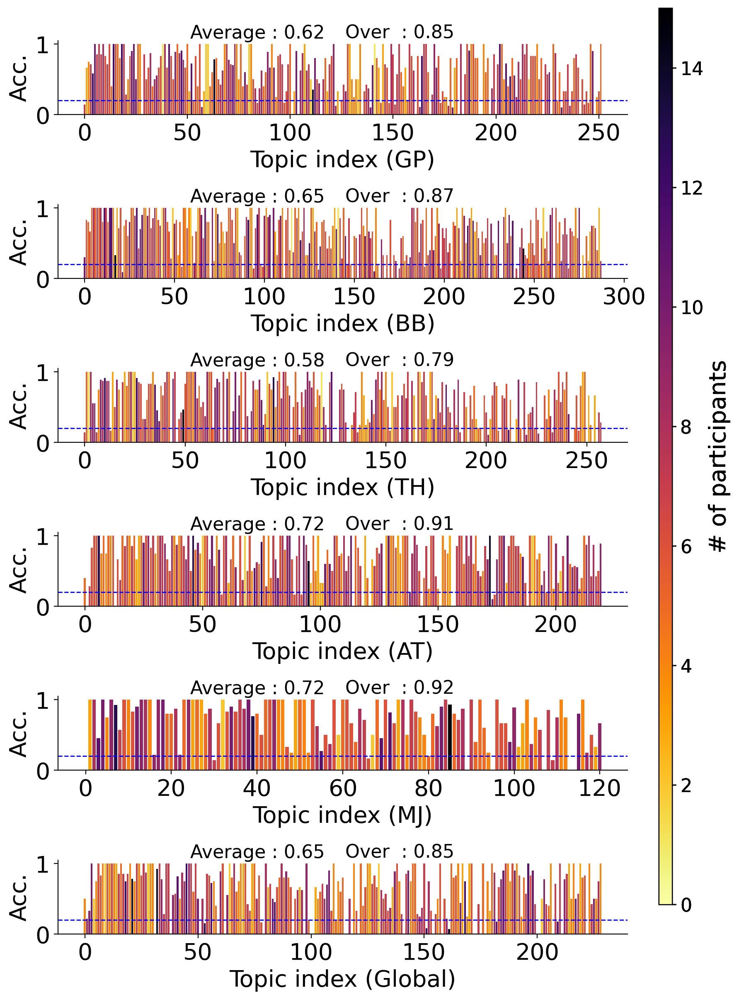

In [ ]:
# Figure template

fig = plt.figure(figsize=(8, 12), dpi=200)
ax1 = fig.add_subplot(611)
ax2 = fig.add_subplot(612)
ax3 = fig.add_subplot(613)
ax4 = fig.add_subplot(614)
ax5 = fig.add_subplot(615)
ax6 = fig.add_subplot(616)
ax_list = [ax1, ax2, ax3, ax4, ax5, ax6]

for i, ax in enumerate(ax_list):

    if i==5:
        tmp_data = data[data['site']==6]
    else:
        tmp_data = data[data['site']==5-i]
    
    topic_num = len(tmp_data)
    colors = [color_list[int(x)] for x in tmp_data['n']]

    ax.bar(np.arange(topic_num), tmp_data['pcorrect'], color=colors)
    ax.axhline(0.2, lw=1, ls='--', color='b')

    ax.set_xlabel(f'Topic index ({name_list[i]})', fontsize=20)
    ax.set_ylabel(f'Acc.', fontsize=20)
    
    avg_total = np.mean(tmp_data['pcorrect'])
    over_total = np.mean(tmp_data['pcorrect']>0.2)
    
    ax.text(0.35, 1.1, f'Average : {avg_total:.2f}', ha='center', va='center', fontsize=16, transform = ax.transAxes)
    ax.text(0.6, 1.1, f'Over  : {over_total:.2f}', ha='center', va='center', fontsize=16, transform = ax.transAxes)

    # Remove small ticks and increase tick font size
    ax.tick_params(which='minor', width=0, length=0)
    ax.tick_params(axis='both', labelsize=20)
    ax.spines[['right', 'top']].set_visible(False)

    # Add colorbar
    cax = fig.add_axes([1.0, 0.1, 0.02, 0.9])
    norm = mpl.colors.Normalize(vmin=0, vmax=max_num)
    cb = mpl.colorbar.ColorbarBase(cax, cmap=cm.inferno_r, norm=norm, orientation='vertical')
    cb.set_label('# of participants', fontsize=20)
    cb.ax.tick_params(labelsize=16)

plt.tight_layout()
plt.savefig(f"figure/SI/figS5.svg", format="svg", transparent=True, bbox_inches='tight')

## Figure S6. Survey 2

In [ ]:
data_L = pd.read_csv('survey_result/t2Ltot_results.CSV')
data_G = pd.read_csv('survey_result/t2Gtot_results.CSV')
min_num = min([np.min(data_L['n']), np.min(data_G['n'])])
max_num = max([np.max(data_L['n']), np.max(data_G['n'])])
name_list = ['MJ', 'AT', 'TH', 'BB', 'GP', 'Global']

In [ ]:
# Figure template

fig = plt.figure(figsize=(8, 12), dpi=200)
ax_list = []
for i in range(10):
    ax = fig.add_subplot(5, 2, i+1)
    ax_list.append(ax)
    
for i, ax in enumerate(ax_list):
    if i%2== 0:
        tmp_data = data_L[data_L['site']==i//2+1]
    else:
        tmp_data = data_G[data_G['site']==i//2+1]
        
    print(i, len(tmp_data))

    topic_num = len(tmp_data)
    norm = plt.Normalize(vmin=min_num, vmax=max_num)
    colors = [plt.cm.inferno(norm(x)) for x in tmp_data['n']] 

    ax.bar(np.arange(topic_num), tmp_data['pcorrect']/100., color=colors)
    ax.set_xticks(np.arange(topic_num))
    ax.set_xticklabels(tmp_data['topic'].values)
    ax.axhline(0.25, lw=1, ls='--', color='b')

    ax.set_xlabel(f'Topic index ({name_list[i//2]}, {"Local" if i%2==0 else "Global"})', fontsize=16)
    if i%2 == 0:
        ax.set_ylabel(f'Acc.', fontsize=20)
    
    avg_total = np.mean(tmp_data['pcorrect']/100.)
    over_total = np.mean(tmp_data['pcorrect']>0.25)
    
    ax.text(0.3, 1.0, f'Average : {avg_total:.2f}', ha='center', va='center', fontsize=10, transform = ax.transAxes)
    ax.text(0.7, 1.0, f'Over  : {over_total:.2f}', ha='center', va='center', fontsize=10, transform = ax.transAxes)

    ax.set_ylim(0, 1)

    # Remove small ticks and increase tick font size
    ax.tick_params(which='minor', width=0, length=0)
    ax.tick_params(axis='x', labelsize=10)
    ax.tick_params(axis='y', labelsize=20)
    ax.spines[['right', 'top']].set_visible(False)

    # Add colorbar
    cax = fig.add_axes([1.05, 0.1, 0.02, 0.9])
    norm = mpl.colors.Normalize(vmin=min_num, vmax=max_num)
    cb = mpl.colorbar.ColorbarBase(cax, cmap=cm.inferno_r, norm=norm, orientation='vertical')
    cb.set_label('# of participants', fontsize=20)
    cb.ax.tick_params(labelsize=16)

plt.tight_layout()
plt.savefig(f"figure/SI/figS6.svg", format="svg", transparent=True, bbox_inches='tight')

## Figure S7. Survey 3

In [ ]:
data_L = pd.read_csv('survey_result/t6L_results.CSV')
data_G = pd.read_csv('survey_result/t6G_results.CSV')
name_list = ['MJ', 'AT', 'TH', 'BB', 'GP', 'Global']

In [ ]:
# Figure template

fig = plt.figure(figsize=(15, 12), dpi=200)
ax_list = []
for i in range(10):
    ax = fig.add_subplot(5, 2, i+1)
    ax_list.append(ax)
    
color_list = ['#e84d8a', '#feb326', '#60bd68', 'k']
    
for i, ax in enumerate(ax_list):
    if i%2== 0:
        tmp_data = data_L[data_L['site']==i//2+1]
    else:
        tmp_data = data_G[data_G['site']==i//2+1]
        
    print(i, len(tmp_data))

    title_num = len(tmp_data)
    rate_list = ['rate_t1', 'rate_t2', 'rate_t3', 'rate_tx']
    text_list = ['Tier 1', 'Tier 2', 'Tier 3', 'Random']
    alpha_list = [1.0, 0.7, 0.7, 0.9]
    y_list = [0.9, 0.7, 0.5, 0.3]
    
    for j in range(4):
        ax.plot(np.arange(title_num), tmp_data[rate_list[j]], color=color_list[j], lw=2, alpha=alpha_list[j])
        ax.text(1.05, y_list[j], f'{text_list[j]}: {np.mean(tmp_data[rate_list[j]]):.2f}', ha='center', va='center', fontsize=10, color=color_list[j], transform = ax.transAxes)

    #ax.set_xticks(np.arange(topic_num))
    #ax.set_xticklabels(tmp_data['topic'].values)

    ax.set_xlabel(f'Article title index ({name_list[i//2]}, {"Local" if i%2==0 else "Global"})', fontsize=16)
    if i%2 == 0:
        ax.set_ylabel(f'Score', fontsize=20)

    ax.set_ylim(0, 5)

    # Remove small ticks and increase tick font size
    ax.tick_params(which='minor', width=0, length=0)
    ax.tick_params(axis='x', labelsize=10)
    ax.tick_params(axis='y', labelsize=20)
    ax.spines[['right', 'top']].set_visible(False)

plt.tight_layout()
plt.savefig(f"figure/SI/figS7.svg", format="svg", transparent=True, bbox_inches='tight')

## Figure S8. Survey 4

In [3]:
data = pd.read_csv('survey_result/t3_results.CSV')
max_num = np.max(data['n'])
name_list = ['MJ', 'AT', 'TH', 'BB', 'GP', 'Global']
collection_names = ['Motherjones', 'Atlantic', 'Thehill', 'Breitbart', 'Gatewaypundit', 'Global']

In [4]:
similarity_matrix_local_dict = {}
similarity_matrix_global_dict = {}

for collection_name in COLLECTION_NAMES:
    print(collection_name)
    num_topics = NUM_TOPICS[collection_name]
    file_names = os.listdir(join('/data', 'collmind', 'article', collection_name.lower(), 'month', 'df'))
    keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))

    total_embeddings = np.zeros((num_topics+1, 384))
    total_num = np.zeros((num_topics+1))

    for key in keys:
        data = pd.read_parquet(join('/data', 'collmind', 'article', collection_name.lower(), 'month', 'df', key+'.parquet'))
        total_num += data['topic_freq'].values
        total_embeddings += data['topic_freq'].values.reshape(-1, 1) * np.vstack(data['topic_mean_embedding'].values)
        
    total_embeddings /= total_num.reshape(-1, 1)
    similarity_matrix = cosine_similarity(total_embeddings, total_embeddings)[1:, 1:]
    similarity_matrix_local_dict[collection_name] = similarity_matrix
    
for collection_name in COLLECTION_NAMES:
    print(collection_name)
    num_topics = NUM_TOPICS['global']
    file_names = os.listdir(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df'))
    keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))

    total_embeddings = np.zeros((num_topics+1, 384))
    total_num = np.zeros((num_topics+1))

    for key in keys:
        data = pd.read_parquet(join('/data', 'collmind', 'article_global', collection_name.lower(), 'month', 'df', key+'.parquet'))
        total_num += data['topic_freq'].values
        total_embeddings += data['topic_freq'].values.reshape(-1, 1) * np.vstack(data['topic_mean_embedding'].values)
        
    total_embeddings /= total_num.reshape(-1, 1)
    similarity_matrix = cosine_similarity(total_embeddings, total_embeddings)[1:, 1:]
    similarity_matrix_global_dict[collection_name] = similarity_matrix



Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones
Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones


In [5]:
data = pd.read_csv('survey_result/t3_results.CSV')

In [7]:
sim_list = []
for row in data.iterrows():
    topic1 = int(row[1]['topic1'])-1
    topic2 = int(row[1]['topic2'])-1
    if row[1]['locglob']==1:
        sim = similarity_matrix_local_dict[collection_names[int(row[1]['site'])-1]][topic1, topic2]
    else:
        sim = similarity_matrix_global_dict[collection_names[int(row[1]['site'])-1]][topic1, topic2]
    sim_list.append(sim)

data['sim'] = sim_list

0 184
1 183
2 276
3 278
4 232
5 145


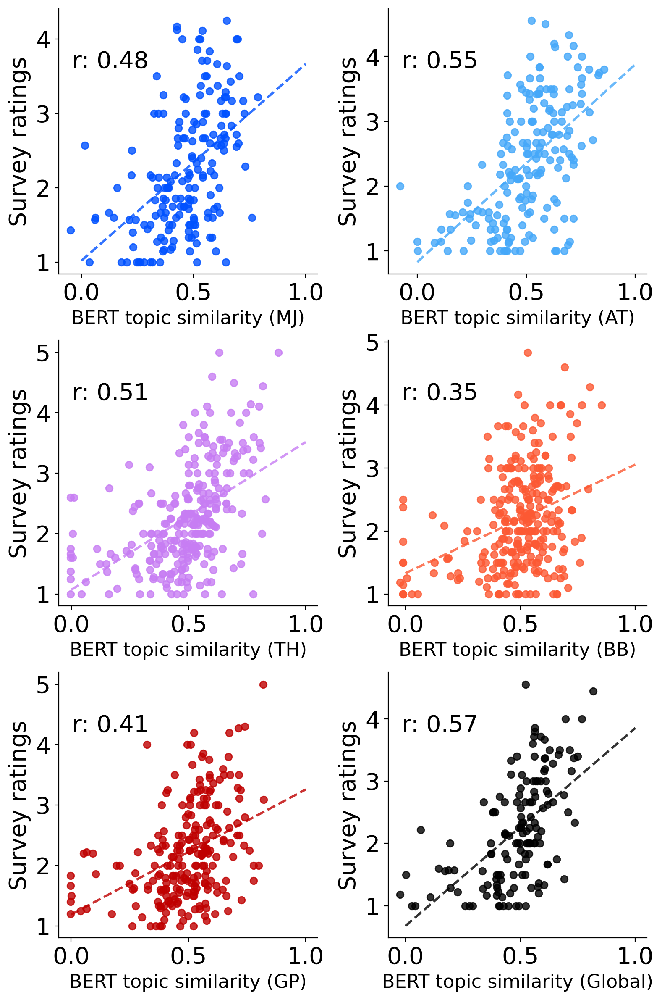

In [ ]:
# Figure template

fig = plt.figure(figsize=(8, 12), dpi=200)
ax_list = []
color_list = rb_color_list
for i in range(6):
    ax = fig.add_subplot(3, 2, i+1)
    ax_list.append(ax)
    
for i, ax in enumerate(ax_list):
    if i<5:
        tmp_data = data[data['site']==i+1].dropna(subset=['sim', 'avgsim'])
        color = color_list[i]
    else:
        tmp_data = data[data['locglob']==2].dropna(subset=['sim', 'avgsim'])
        color = 'k'
        
    print(i, len(tmp_data))


    ax.set_xlabel(f'BERT topic similarity ({name_list[i]})', fontsize=16)
    ax.set_ylabel('Survey ratings', fontsize=20)

    slope, intercept, r_value, p_value, std_err = linregress(tmp_data['sim'].values, tmp_data['avgsim'].values)
    ax.scatter(tmp_data['sim'].values, tmp_data['avgsim'].values, color=color, alpha=0.8)
    
    ax.plot([0, 1], [intercept, slope+intercept], color=color, lw=2, ls='--', alpha=0.8)
    ax.text(0.20, 0.8, f'r: {r_value:.2f}', ha='center', va='center', fontsize=20, transform = ax.transAxes)
    ax.spines[['right', 'top']].set_visible(False)

    # Remove small ticks and increase tick font size
    ax.tick_params(which='minor', width=0, length=0)
    ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/SI/figS8.svg", format="svg", transparent=True, bbox_inches='tight')

## Figure S9. Survey 5

In [9]:
def load_embeddings(collection_name, date):
    print(date)
    next_date = next_month(date)
    embedding_foler = '/data/comments/valentin/sentence-embeddings/'
    embedding_path = embedding_foler + f'{collection_name.lower()}/bert-emb-{date}-{next_date}.pt'
    embedding = torch.load(embedding_path, map_location=torch.device('cpu'))
    if embedding['embeddings'].device.type == 'cuda':
        print(date, 'cuda')
        embedding['embeddings']= embedding['embeddings'].to('cpu')
    return embedding

In [10]:
data_L = pd.read_csv('survey_result/t4L_results.CSV')
data_G = pd.read_csv('survey_result/t4G_results.CSV')

In [39]:
data = data_G

name_list = ['Motherjones', 'Atlantic', 'Thehill', 'Breitbart', 'Gatewaypundit']
site = name_list[0]
date = '0612'
embedding_data = np.zeros((len(data), 2, 384))

embeddings = load_embeddings(name_list[0], '0612')

for row in data.iterrows():
    print(row[0])
    now_site = name_list[int(row[1]['site'])-1]
    now_date = str(int(row[1]['date'])).zfill(4)
    if (site != now_site) or (date != now_date):
        embeddings = load_embeddings(now_site, now_date)
        site = now_site
        date = now_date
    
    X = str(int(row[1]['s_comid']))
    index = embeddings['_id'].index(X)
    embedding_entry = embeddings['embeddings'][index]
    embedding_data[row[0]][0] = embedding_entry.numpy()
    
    X = str(int(row[1]['t_comid']))
    index = embeddings['_id'].index(X)
    embedding_entry = embeddings['embeddings'][index]
    embedding_data[row[0]][1] = embedding_entry.numpy()
    

0612
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
0614


KeyboardInterrupt: 

In [ ]:
# save embedding_data
np.savez_compressed(join('figure', 'figure_data', 't4G_embeddings'), embedding_data=embedding_data)

In [ ]:
# Reshape the array
reshaped_embedding_data = embedding_data.reshape(embedding_data.shape[0], 2*384)

# Convert to a DataFrame
df = pd.DataFrame(reshaped_embedding_data)

# Save to CSV
df.to_csv(join('figure', 'figure_data','t4G_embeddings.csv'), index=True)

In [11]:
data_L = pd.read_csv('survey_result/t4L_results.CSV')
data_G = pd.read_csv('survey_result/t4G_results.CSV')

In [12]:
embedding_data_L = np.load(join('figure', 'figure_data', 't4L_embeddings.npz'))['embedding_data']
embedding_data_G = np.load(join('figure', 'figure_data', 't4G_embeddings.npz'))['embedding_data']

sim_list_L = []

for i in range(len(embedding_data_L)):
    sim_list_L.append(cosine_similarity(embedding_data_L[i][0].reshape(1, -1), embedding_data_L[i][1].reshape(1, -1))[0][0])

data_L['cos_sim'] = sim_list_L
data_L = data_L[data_L['avgsim'] == data_L['avgsim']]

sim_list_G = []

for i in range(len(embedding_data_G)):
    sim_list_G.append(cosine_similarity(embedding_data_G[i][0].reshape(1, -1), embedding_data_G[i][1].reshape(1, -1))[0][0])    

data_G['cos_sim'] = sim_list_G
data_G = data_G[data_G['avgsim'] == data_G['avgsim']]

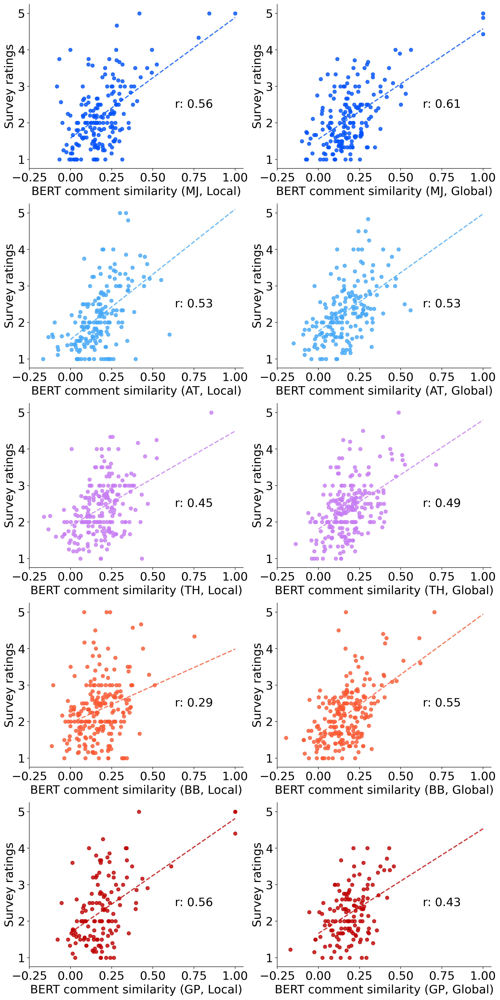

In [ ]:
name_list = ['MJ', 'AT', 'TH', 'BB', 'GP']

fig = plt.figure(figsize=(12, 24), dpi=200)
color_list = rb_color_list
ax_list = []
for i in range(10):
    ax = fig.add_subplot(5, 2, i+1)
    ax_list.append(ax)
    
for i, ax in enumerate(ax_list):
    if i%2== 0:
        tmp_data = data_L[data_L['site']==i//2+1]
    else:
        tmp_data = data_G[data_G['site']==i//2+1]

    ax.set_xlim(-0.25, 1.05)
    ax.set_ylim(0.75, 5.25)

    ax.set_xlabel(f'BERT comment similarity ({name_list[i//2]}, {"Local" if i%2==0 else "Global"})', fontsize=20)
    ax.set_ylabel('Survey ratings', fontsize=20)

    slope, intercept, r_value, p_value, std_err = linregress(tmp_data['cos_sim'].values, tmp_data['avgsim'].values)
    ax.scatter(tmp_data['cos_sim'].values, tmp_data['avgsim'].values, color=rb_color_list[i//2], alpha=0.8, label=name_list[i//2])
    
    ax.plot([0, 1], [intercept, slope+intercept], color=rb_color_list[i//2], lw=2, ls='--', alpha=0.8)
    ax.text(0.75, 2.5, f'r: {r_value:.2f}', ha='center', va='center', fontsize=20)
    ax.spines[['right', 'top']].set_visible(False)

    # Remove small ticks and increase tick font size
    ax.tick_params(which='minor', width=0, length=0)
    ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/SI/figS9.svg", format="svg", transparent=True, bbox_inches='tight')

In [ ]:
# comment embeddings of s_comid and t_comid for all cases

In [604]:
# survey 6

#data = pd.read_csv('survey_result/t5_results.CSV')
data = pd.read_csv('survey_result/task5_all_new_sentiments.CSV')
name_list = ['Motherjones', 'Atlantic', 'Thehill', 'Breitbart', 'Gatewaypundit']

In [607]:
data[data['site']==name_list[0]]

,comid,text,topic,site,month,id
0,684042742,that's what happened concerning clinton the bu...,1,Motherjones,1012,1
1,690100129,that's the thing the right gives their candida...,1,Motherjones,1012,2
2,685584075,can't you come up with something other than yo...,2,Motherjones,1012,3
3,690331162,popularity is independent of smarts and on ave...,2,Motherjones,1012,4
4,675799344,by the way health care given by the government...,5,Motherjones,1012,5
...,...,...,...,...,...,...
557,3868737019,assault rifles are not particularly accurate s...,80,Motherjones,418,558
558,3834335501,upvoting your own spam lol,95,Motherjones,418,559
559,3857157216,arrant nonsense spam,95,Motherjones,418,560
560,3841181780,and it would rain jelly beans and we'd ride un...,110,Motherjones,418,561


In [611]:
def load_sentiments(collection_name, date):
    next_date = next_month(date)
    sentiments_foler = f'/data/comments/valentin/max-sentiment-analysis/{collection_name.lower()}/sentiments_by_comment/'
    sentiments_path = sentiments_foler + f'batch-{date}.csv_createdAt'
    try:
        sentiments = pd.read_csv(sentiments_path)  # order : anger	anticipation	disgust	fear	joy	love	optimism	pessimism	sadness	surprise	trust
    except:
        print('go to old')
        sentiments = pd.read_csv(f'_old/batch-{date}.csv')
    return sentiments

In [70]:

sentiments_data = np.zeros((len(data), 11))
date_data = np.zeros(len(data))

for i, collection_name in enumerate(name_list):
    print(collection_name)
    
    tmp_data = data[data['site']==i+1]
    tmp_data = tmp_data.sort_values(by='comid')
    date_list = np.sort(tmp_data['date'].unique())
    date_counter = 0
    
    site = collection_name
    date = str(date_list[date_counter]).zfill(4)
    sentiments = load_sentiments(site, date)
    sentiments_id = list(sentiments['id'].values)
    
    for row in tmp_data.iterrows():
        print(row[0])
        
        X = int(row[1]['comid'])
        try:
            index = sentiments_id.index(X)
            sentiments_entry = sentiments.iloc[index][['anger', 'anticipation', 'disgust', 'fear', 'joy', 'love', 'optimism', 'pessimism', 'sadness', 'surprise', 'trust']].values
        except ValueError:
            date_counter+=1
            date = str(date_list[date_counter]).zfill(4)
            print('DATE CHANGED', date)
            sentiments = load_sentiments(site, date)
            sentiments_id = list(sentiments['id'].values)
            
            index = sentiments_id.index(X)
            sentiments_entry = sentiments.iloc[index][['anger', 'anticipation', 'disgust', 'fear', 'joy', 'love', 'optimism', 'pessimism', 'sadness', 'surprise', 'trust']].values
        
        sentiments_data[row[0]] = sentiments_entry
        date_data[row[0]] = date

Motherjones
895
52
6
22
884
40
935
23
19
0
876
9
45
911
883
132
20
941
1000
878
105
27
41
28
982
898
961
880
890
995
36
874
64
10
879
115
896
989
894
122
146
887
11
58
39
112
30
14
1
16
7
885
899
916
958
917
21
889
974
903
17
886
26
18
3
65
904
881
2
12
130
15
4
1004
968
8
42
127
953
875
882
877
5
25
888
13
29
DATE CHANGED 1013
135
960
927
921
31
978
942
32
94
95
33
983
943
24
118
53
128
900
918
905
912
66
67
48
145
119
966
946
90
1007
106
49
37
901
984
137
902
75
47
897
92
99
1001
136
969
906
907
103
34
68
69
35
46
891
892
910
38
930
992
57
893
50
925
DATE CHANGED 1014
919
920
56
43
120
142
76
59
913
54
60
985
945
954
996
938
979
121
924
914
138
96
71
86
147
109
975
91
44
976
908
933
51
72
922
997
944
139
962
967
113
926
82
55
931
100
73
97
101
909
986
971
125
915
104
80
955
83
972
923
947
61
DATE CHANGED 1015
77
123
126
928
932
78
144
129
116
79
936
940
124
994
74
929
939
990
948
970
102
107
148
937
956
70
81
84
963
62
63
949
934
87
DATE CHANGED 1016
1008
85
1009
108
993
110
964
1005

In [609]:
data

,comid,text,topic,site,month,id
0,684042742,that's what happened concerning clinton the bu...,1,Motherjones,1012,1
1,690100129,that's the thing the right gives their candida...,1,Motherjones,1012,2
2,685584075,can't you come up with something other than yo...,2,Motherjones,1012,3
3,690331162,popularity is independent of smarts and on ave...,2,Motherjones,1012,4
4,675799344,by the way health care given by the government...,5,Motherjones,1012,5
...,...,...,...,...,...,...
1227,5835684316,elon musk is correct the woke virus is making ...,185,Breitbart,422,1228
1228,5819460309,is that like aoc and her factually wrong but m...,221,Breitbart,422,1229
1229,5836196692,aoc is so stupid that she thinks roe vs wade a...,221,Breitbart,422,1230
1230,5833659405,steph colbert is no different than all the oth...,257,Breitbart,422,1231


In [617]:
tmp_data

,comid,text,topic,site,month,id
8,667936598,but i guess i'd like to see some evidence that...,35,Motherjones,1012,9
9,672472178,others once eradicated have returned due to in...,35,Motherjones,1012,10
16,675239121,that's it i've had more than enough of your sp...,95,Motherjones,1012,17
4,675799344,by the way health care given by the government...,5,Motherjones,1012,5
18,678033032,you didn't even read the link did ya dumbass y...,110,Motherjones,1012,19
...,...,...,...,...,...,...
150,4158669343,the planet you live on must be a very interest...,110,Motherjones,1018,151
149,4159511029,if you work on that for a while it may rise to...,95,Motherjones,1018,150
137,4163997193,the funny thing is no one ever had to lose the...,5,Motherjones,1018,138
147,4167129897,specious argument always used by the gun nuts ...,80,Motherjones,1018,148


In [625]:
date_list

array([ 413,  414,  415,  416,  417,  418, 1012, 1013, 1014, 1015, 1016,
       1017, 1018])

In [623]:
data[data['site']==name_list[i]]

,comid,text,topic,site,month,id
0,684042742,that's what happened concerning clinton the bu...,1,Motherjones,1012,1
1,690100129,that's the thing the right gives their candida...,1,Motherjones,1012,2
2,685584075,can't you come up with something other than yo...,2,Motherjones,1012,3
3,690331162,popularity is independent of smarts and on ave...,2,Motherjones,1012,4
4,675799344,by the way health care given by the government...,5,Motherjones,1012,5
...,...,...,...,...,...,...
557,3868737019,assault rifles are not particularly accurate s...,80,Motherjones,418,558
558,3834335501,upvoting your own spam lol,95,Motherjones,418,559
559,3857157216,arrant nonsense spam,95,Motherjones,418,560
560,3841181780,and it would rain jelly beans and we'd ride un...,110,Motherjones,418,561


In [626]:
# new dataset

sentiments_data = np.zeros((len(data), 11))
date_data = np.zeros(len(data))

for i, collection_name in enumerate(name_list):
    print(collection_name)
    
    tmp_data = data[data['site']==name_list[i]]
    date_list = tmp_data['month'].unique()
    date_counter = 0
    
    site = collection_name
    date = str(date_list[date_counter]).zfill(4)
    sentiments = load_sentiments(site, date)
    sentiments_id = list(sentiments['id'].values)
    
    for row in tmp_data.iterrows():
        print(row[0])
        
        X = int(row[1]['comid'])
        try:
            index = sentiments_id.index(X)
            sentiments_entry = sentiments.iloc[index][['anger', 'anticipation', 'disgust', 'fear', 'joy', 'love', 'optimism', 'pessimism', 'sadness', 'surprise', 'trust']].values
        except ValueError:
            date_counter+=1
            date = str(date_list[date_counter]).zfill(4)
            print('DATE CHANGED', date)
            sentiments = load_sentiments(site, date)
            sentiments_id = list(sentiments['id'].values)
            
            index = sentiments_id.index(X)
            sentiments_entry = sentiments.iloc[index][['anger', 'anticipation', 'disgust', 'fear', 'joy', 'love', 'optimism', 'pessimism', 'sadness', 'surprise', 'trust']].values
        
        sentiments_data[row[0]] = sentiments_entry
        date_data[row[0]] = date

Motherjones
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
DATE CHANGED 1013
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
DATE CHANGED 1014
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
DATE CHANGED 1015
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
DATE CHANGED 1016
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
DATE CHANGED 1017
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
DATE CHANGED 1018
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
432
DATE CHANGED 0413
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
DATE CHANGED 0414
453
454
455
456
457
458
459
460
461
462
463
464
465
466
467
468
469
470
471
472
473
474
DATE CHANGED 0415
475
476
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
492
493
494
495
496
DATE CHANGED 0416
497
498
499
500
501
502
503
504
505
506
507
508
50

In [627]:
data['sentiments'] = list(sentiments_data)
data['true_date'] = list((np.array(date_data)).astype(int))

In [84]:
for i, collection_name in enumerate(name_list):
    print(collection_name, Counter(data[data['site']==i+1]['true_date']))

Motherjones Counter({1012: 86, 1013: 63, 1014: 62, 1015: 34, 1016: 30, 1017: 7, 1018: 3})
Atlantic Counter({1012: 87, 1014: 51, 1013: 39, 1015: 26, 1016: 26, 1017: 9})
Thehill Counter({1012: 61, 1013: 58, 1015: 55, 1017: 52, 1016: 45, 1014: 35, 1018: 34, 1019: 27, 1020: 15, 1021: 6})
Breitbart Counter({1013: 87, 1012: 56, 1016: 56, 1017: 54, 1014: 53, 1018: 48, 1015: 39, 1019: 25, 1020: 15, 1021: 9, 1022: 1})
Gatewaypundit Counter({1015: 65, 1016: 61, 1017: 47, 1019: 43, 1018: 39, 1021: 38, 1020: 21, 1022: 11})


In [628]:
sentiments_df = pd.DataFrame(sentiments_data)

In [629]:
sentiments_df.columns = ['anger', 'anticipation', 'disgust', 'fear', 'joy', 'love', 'optimism', 'pessimism', 'sadness', 'surprise', 'trust']

In [630]:
sentiments_df.to_csv(join('figure', 'figure_data','t5_sentiments_new.csv'), index=True)

In [341]:
# find total number of survey participants

file_list = ['survey_result/t1_results.CSV',
             'survey_result/t2Ltot_results.CSV',
             'survey_result/t2Gtot_results.CSV',
             'survey_result/t6L_results.CSV',
             'survey_result/t6G_results.CSV',
             'survey_result/t3_results.CSV',
             'survey_result/t4L_results.CSV',
             'survey_result/t4G_results.CSV']

total_sum = 0

for file in file_list:
    data = pd.read_csv(file)
    print(file, np.sum(data['n'].values))
    total_sum += np.sum(data['n'].values)

print(total_sum)

survey_result/t1_results.CSV 8688
survey_result/t2Ltot_results.CSV 330.602392982
survey_result/t2Gtot_results.CSV 311.19734247
survey_result/t6L_results.CSV 5822
survey_result/t6G_results.CSV 5687
survey_result/t3_results.CSV 7602
survey_result/t4L_results.CSV 4911
survey_result/t4G_results.CSV 6144
39495.799735452005


## Figure S10. Local TM Data distribution

### S10a. Title topic distribution

In [ ]:
title_topic_num_list_dict_dict = {}
for collection_name in COLLECTION_NAMES:
    print(collection_name)
    with open(join('/data', 'collmind', 'article', collection_name.lower(), 'result_dict.pkl'), 'rb') as f:
        result_dict = pickle.load(f)
    title_topic_num_list_dict_dict[collection_name] = result_dict['title_topic_num_list_dict']['month']

Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones


In [ ]:
# individual ver.

fig, axes = plt.subplots(1, 3, figsize=(18, 6), dpi=200)
color_list = rb_color_list[::-1]
marker_list = marker_list = ['o', '^', 'D']

power_constant_list = [-0.2, -0.1, -0.05]
comp_color_list = orig_color_list

def model(x, a, b):
    return -b * np.log(x) * x**(a)

for rank in range(1, 4):
    line_list = []
    ax = axes[rank-1]
    for i, collection_name in enumerate(COLLECTION_NAMES):
        num_topics = NUM_TOPICS[collection_name] + 1
        x = np.arange(1, num_topics) / num_topics
        data = [title_topic_num_list_dict_dict[collection_name][i][:, rank-1] for i in range(len(title_topic_num_list_dict_dict[collection_name]))]
        sum_data = np.sum(data, axis=0)
        #line = ax.plot(x, np.sort(sum_data / np.sum(sum_data))[::-1], color=color_list[i], lw=4, label=collection_name)
        line = ax.scatter(x, np.sort(sum_data / np.sum(sum_data))[::-1], color=color_list[i], s=100, marker=marker_list[rank-1], alpha=0.5, label=collection_name)
        line_list.append(line)
    
        popt, pcov = curve_fit(model, x, np.sort(sum_data / np.sum(sum_data))[::-1], p0=[-0.2, 1])
        #plot fitting curve
        print(rank, collection_name, *popt)
        ax.plot(x, model(x, *popt), color=color_list[i], lw=2, ls='--', alpha=0.5)
     
    num_topics = NUM_TOPICS['Breitbart'] + 1
    x = np.arange(1, num_topics) / num_topics   
    nlog = -np.log(x) * np.power(x, power_constant_list[rank-1])
    y = nlog / np.sum(nlog)
    ax.plot(x, y, color=comp_color_list[rank-1], lw=5, ls='--')

    ax.semilogx()
    if rank==2:
        ax.set_xlabel('Normalized title topic rank', fontsize=24)
    if rank==1:
        ax.set_ylabel('Relative title topic frequency', fontsize=24, labelpad=10)
    ax.set_yticks([0, 0.02, 0.04, 0.06, 0.08])
    ax.set_ylim([-0.005, 0.09])
    ax.spines[['right', 'top']].set_visible(False)
    ax.tick_params(which='minor', width=0, length=0)
    ax.tick_params(axis='both', labelsize=20)
    
    #ax.text(0.05, 0.05, f'Data', fontsize=20, transform=ax.transAxes)
    ax.text(0.73, 0.37, f'Tier {rank}', fontsize=20, transform=ax.transAxes)
    if rank==1:
        ax.text(0.7, 0.3, r'$\alpha_1=0.2$', fontsize=20, color=comp_color_list[rank-1], transform=ax.transAxes)
        custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto -ln(x)x^{-\alpha_q}$')
        line_list = line_list[::-1]
        line_list.append(custom_line)
        ax.legend(handles=line_list, frameon=False, fontsize=18, bbox_to_anchor=(0.375, 1.025))
    if rank==2:
        ax.text(0.7, 0.3, r'$\alpha_2=0.1$', fontsize=20, color=comp_color_list[rank-1], transform=ax.transAxes)
    if rank==3:
        ax.text(0.69, 0.3, r'$\alpha_3=0.05$', fontsize=20, color=comp_color_list[rank-1], transform=ax.transAxes)
        
    # draw a small straight downward arrow from the bottom of the text to the curve
    ax.arrow(0.81, 0.27, 0.0, -0.07, width=0.005, color=comp_color_list[rank-1], transform=ax.transAxes)
    #ax.set_facecolor([0, 0, 0, 0.05])
    # Create a custom line for the legend
    
plt.tight_layout()
plt.savefig("figure/SI/figS10a.svg", format="svg", transparent=True)

### S10b. Comment topic distribution

In [ ]:
sorted_norm_topic_freq_dict = {}
for collection_name in COLLECTION_NAMES:

    file_names = os.listdir(join('/data', 'collmind', 'article', collection_name.lower(), 'month', 'df'))
    keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))
    dates = [datetime.strptime(key, '%Y-%m-%d') for key in keys]

    topic_freq_list = []

    for key in keys:
        data = pd.read_parquet(join('/data', 'collmind', 'article', collection_name.lower(), 'month', 'df', key+'.parquet'))
        topic_freq = data['topic_freq'].values[1:]
        topic_freq_list.append(topic_freq)

        
    topic_freq_list = np.sum(np.array(topic_freq_list), axis=0)
    sorted_topic_freq = np.sort(topic_freq_list)[::-1]
    sorted_norm_topic_freq = sorted_topic_freq / np.sum(sorted_topic_freq)
    
    sorted_norm_topic_freq_dict[collection_name] = sorted_norm_topic_freq

Gatewaypundit 0.9869799123092438 0.0007626420020442098
Breitbart 0.898345657207571 0.0009040013591813555
Thehill 0.90756989861385 0.000996405637419109
Atlantic 0.9830739355544753 0.0010103525452766805
Motherjones 1.4487598126835735 0.0005117178363456707


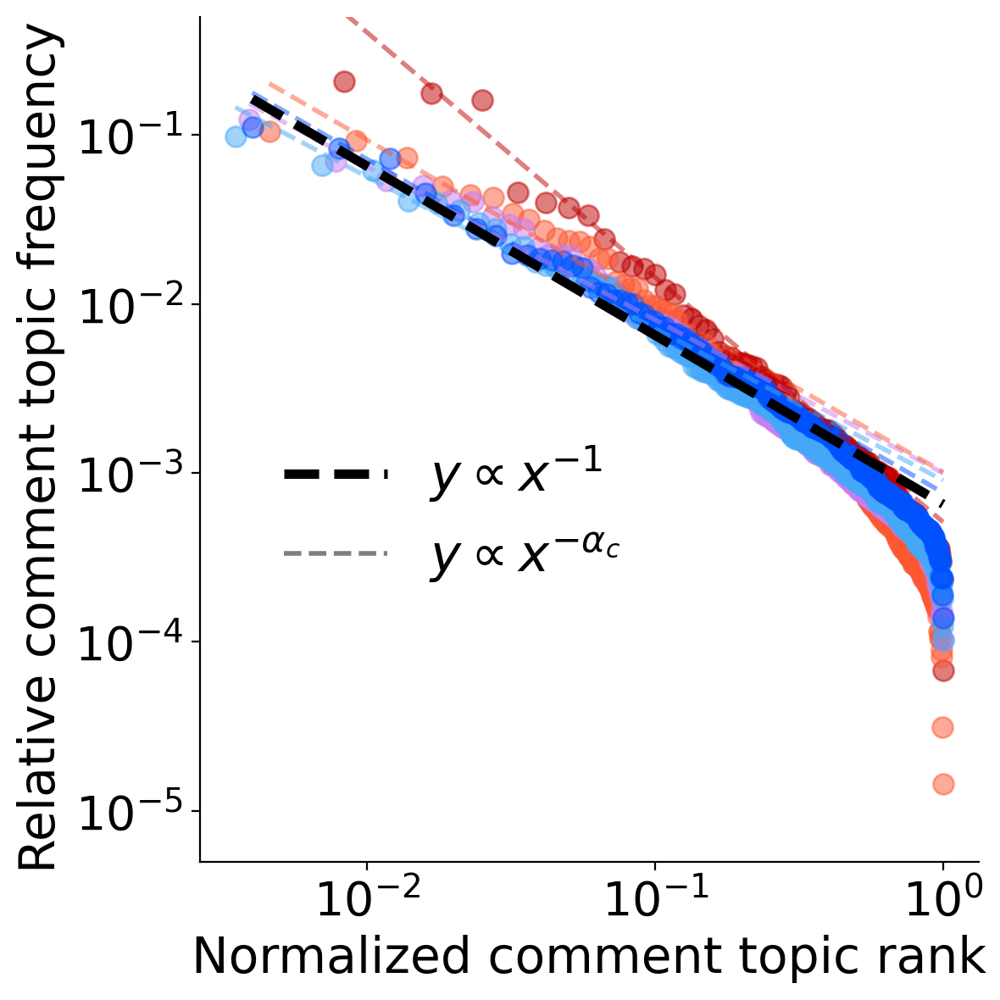

In [ ]:

# Define the power-law model function
def func_power_law(x, a, b):
    return b * x**(-a)

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list
line_list = []

for i, collection_name in enumerate(COLLECTION_NAMES):
    x = np.arange(1, NUM_TOPICS[collection_name]+1)/ NUM_TOPICS[collection_name]
    ax.scatter(x, sorted_norm_topic_freq_dict[collection_name], c=color_list[i], s=75, alpha=0.5, label=collection_name,zorder=5-i)
    
    # Fit the data to the power-law model
    popt, pcov = curve_fit(func_power_law, x[1:], sorted_norm_topic_freq_dict[collection_name][1:], p0=[1.0, 1.0])

    # Extract the optimal parameters
    a_opt, b_opt = popt
    print(collection_name, a_opt, b_opt)

    # Generate fitted values
    y_fit = func_power_law(x, a_opt, b_opt)

    ax.plot(x, y_fit, color=color_list[i], lw=2, ls='--', zorder=10, alpha=0.5)

x = np.arange(1, NUM_TOPICS['Gatewaypundit']+1)/ NUM_TOPICS['Gatewaypundit']
pdf, _ = power_law(alpha=1, xmax=NUM_TOPICS['Gatewaypundit'])

line = ax.plot(x, pdf, c='k', lw=4, ls='--', zorder=10, alpha=1, label=r'$y \propto x^{-1}$')
line_list.append(line[0])

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto x^{-\alpha_{c}}$')
line_list.append(custom_line)

ax.set_xlabel('Normalized comment topic rank', fontsize=21)
ax.set_ylabel('Relative comment topic frequency ', fontsize=21)
ax.spines[['right', 'top']].set_visible(False)
#ax.text(0.05, 0.05, f'Data', fontsize=20, transform=ax.transAxes)
ax.set_ylim(5e-6, 5e-1)

ax.legend(handles=line_list, frameon=False, bbox_to_anchor=(0.6, 0.55), fontsize=22)
ax.set_xscale('log')
ax.set_yscale('log')

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/SI/figS10b.svg", format="svg", transparent=True)

### S10c. Similarity distribution

In [ ]:
hist_data_dict = {}
similarity_matrix_dict = {}

for collection_name in COLLECTION_NAMES:
    print(collection_name)
    num_topics = NUM_TOPICS[collection_name]
    file_names = os.listdir(join('/data', 'collmind', 'article', collection_name.lower(), 'month', 'df'))
    keys = sorted([file_name.split('.')[0] for file_name in file_names], key=lambda x: datetime.strptime(x, '%Y-%m-%d'))

    total_embeddings = np.zeros((num_topics+1, 384))
    total_num = np.zeros((num_topics+1))

    for key in keys:
        data = pd.read_parquet(join('/data', 'collmind', 'article', collection_name.lower(), 'month', 'df', key+'.parquet'))
        total_num += data['topic_freq'].values
        total_embeddings += data['topic_freq'].values.reshape(-1, 1) * np.vstack(data['topic_mean_embedding'].values)
        
    total_embeddings /= total_num.reshape(-1, 1)
    similarity_matrix = cosine_similarity(total_embeddings, total_embeddings)[1:, 1:]
    similarity_matrix_dict[collection_name] = similarity_matrix
    hist_data = similarity_matrix[np.triu_indices(num_topics, k = 1)]
    hist_data_dict[collection_name] = hist_data

Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones


In [ ]:
plot_dict = {}
fit_dict = {}

for collection_name in COLLECTION_NAMES:
    a, b = np.histogram(hist_data_dict[collection_name], bins=30, density=True)
    c = (b[1:] + b[:-1])/2
    lshape, lloc, lscale = stats.lognorm.fit(hist_data_dict[collection_name], loc=-0.5)
    mu, std = stats.norm.fit(hist_data_dict[collection_name])
    
    plot_dict[collection_name] = (c, a)
    fit_dict[collection_name] = (lshape, lloc, lscale, mu, std)
    
print(fit_dict)


{'Gatewaypundit': (0.11779398596390654, -0.6500773930545252, 0.9985323782150917, 0.3554165911024624, 0.11904602104811746), 'Breitbart': (0.11771702673994991, -0.6546352454883637, 0.9868939785039004, 0.3391260798160866, 0.1175519172335929), 'Thehill': (0.13066878248556246, -0.5675457372976669, 0.9145529416359566, 0.35485534026316745, 0.12124936081386459), 'Atlantic': (0.17978688971610424, -0.5376570126294733, 0.8108090784063313, 0.2863656517658033, 0.1494523810190901), 'Motherjones': (0.13652808673654498, -0.6649509129104827, 0.958572537055177, 0.3025980704868058, 0.13378127741191345)}


0.11779398596390654 -0.6500773930545252 0.9985323782150917
0.11771702673994991 -0.6546352454883637 0.9868939785039004
0.13066878248556246 -0.5675457372976669 0.9145529416359566
0.17978688971610424 -0.5376570126294733 0.8108090784063313
0.13652808673654498 -0.6649509129104827 0.958572537055177


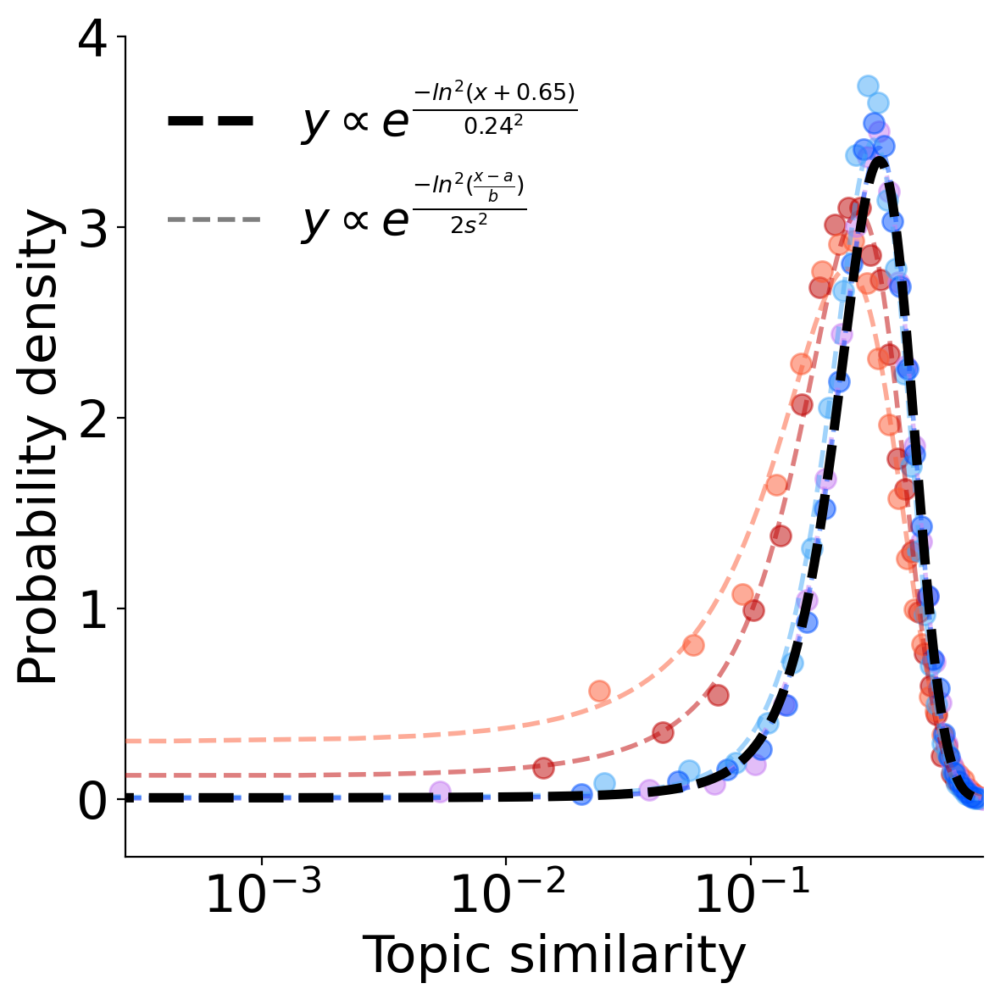

In [ ]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list
line_list = []

for i, collection_name in enumerate(COLLECTION_NAMES):
    x, y = plot_dict[collection_name]
    lshape, lloc, lscale, mu, std = fit_dict[collection_name]
    print(lshape, lloc, lscale)
    fit_x = np.linspace(min(x), max(x), 500)
    fit_y = stats.lognorm.pdf(fit_x, lshape, loc=lloc, scale=lscale)
    ax.scatter(x, y, s=75, alpha=0.5, color=color_list[i], label=collection_name, zorder=5-i)
    ax.plot(fit_x, fit_y, color=color_list[i], ls='--', alpha=0.5, linewidth=2, zorder=10-i)
    
lshape, lloc, lscale = 0.12, -0.65, 1
fit_y = stats.lognorm.pdf(fit_x, lshape, loc=lloc, scale=lscale)
line = ax.plot(fit_x, fit_y, color='k', ls='--', alpha=1, lw=4, zorder=10, label=r'$y \propto e^{\frac{-ln^2(x+0.65)}{0.24^2}}$')
line_list.append(line[0])

ax.set_xscale('log')

ax.set_xlabel('Topic similarity', fontsize=22)
ax.set_ylabel('Probability density', fontsize=22)
ax.spines[['right', 'top']].set_visible(False)

#ax.set_xticks(np.arange(0, 1.0, 0.5))

ax.set_xlim(np.min(fit_x), np.max(fit_x)*1.1)
ax.set_ylim(-0.3, 4)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

custom_line = Line2D([], [], color='black', lw=2, ls='--', alpha=0.5, label=r'$y \propto e^{\frac{-ln^2(\frac{x-a}{b})}{2s^2}}$')
line_list.append(custom_line)
ax.legend(handles=line_list, frameon=False, fontsize=20)

plt.tight_layout()
plt.savefig("figure/SI/figS10c.svg", format="svg", transparent=True)


## Figure S11. Hypersensitive filter

In [ ]:
model_type = 'simple'
freq_list_list = []
raw_freq_list_list = []
timestep = 300
trial = 1000

init_freq_std = 0.2
memory_strength = 0.9

folder_name = '0_tsne'
filter_strength_list = [0.2, 0.5, 0.8, 1.2, 1.5, 2.0, 3.0]
tot_num = len(filter_strength_list)

for filter_strength in filter_strength_list:
    print(filter_strength)
    sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF{init_freq_std}_IV99_0_0.0_0_0.0_-1_-1_t{timestep}_0'
    parameters, results = load_comp_model_result(folder_name, model_type, sim_name, tmp=True)
    freq_list_list.append(results['freq_list'][:trial, :timestep, :])
    raw_freq_list_list.append(results['raw_freq_list'][:trial, :timestep, :])

freq_list_list = np.array(freq_list_list)
raw_freq_list_list = np.array(raw_freq_list_list)
general_freq = results['general_freq']

0.2


0.5
0.8
1.2
1.5
2.0
3.0


### S11a. KD plot

In [ ]:
kd_array = np.zeros((tot_num, trial, 100))

for i in range(tot_num):
    for j in range(trial):
        for k in range(100):
            kd_array[i][j][k] = kendalltau_dist(raw_freq_list_list[i][j][k], general_freq)

In [ ]:
np.std(kd_array[0][:t], axis=0)

array([7.21644966e-16, 1.38331455e-03, 1.91178533e-03, 2.34251794e-03,
       2.62239093e-03, 2.84138490e-03, 2.99150993e-03, 3.12997732e-03,
       3.32676433e-03, 3.50240158e-03, 3.61222150e-03, 3.67669563e-03,
       3.83297508e-03, 3.89330643e-03, 4.02320303e-03, 4.06635589e-03,
       4.18022668e-03, 4.28915882e-03, 4.31156043e-03, 4.37024860e-03,
       4.39945882e-03, 4.46770628e-03, 4.40293943e-03, 4.44487760e-03,
       4.57314091e-03, 4.59435455e-03, 4.54290859e-03, 4.58652492e-03,
       4.59509075e-03, 4.67360528e-03, 4.73134840e-03, 4.79947390e-03,
       4.88608202e-03, 4.86383942e-03, 4.84420066e-03, 4.92149931e-03,
       4.91877177e-03, 4.84827334e-03, 4.93817656e-03, 4.88936790e-03,
       4.94739882e-03, 4.96664867e-03, 5.00151939e-03, 4.93158931e-03,
       4.93724491e-03, 4.89631555e-03, 4.90971338e-03, 4.88787243e-03,
       4.95431303e-03, 5.02385871e-03, 5.06116914e-03, 5.08745275e-03,
       5.09871755e-03, 5.08416090e-03, 5.06006058e-03, 5.09416298e-03,
      

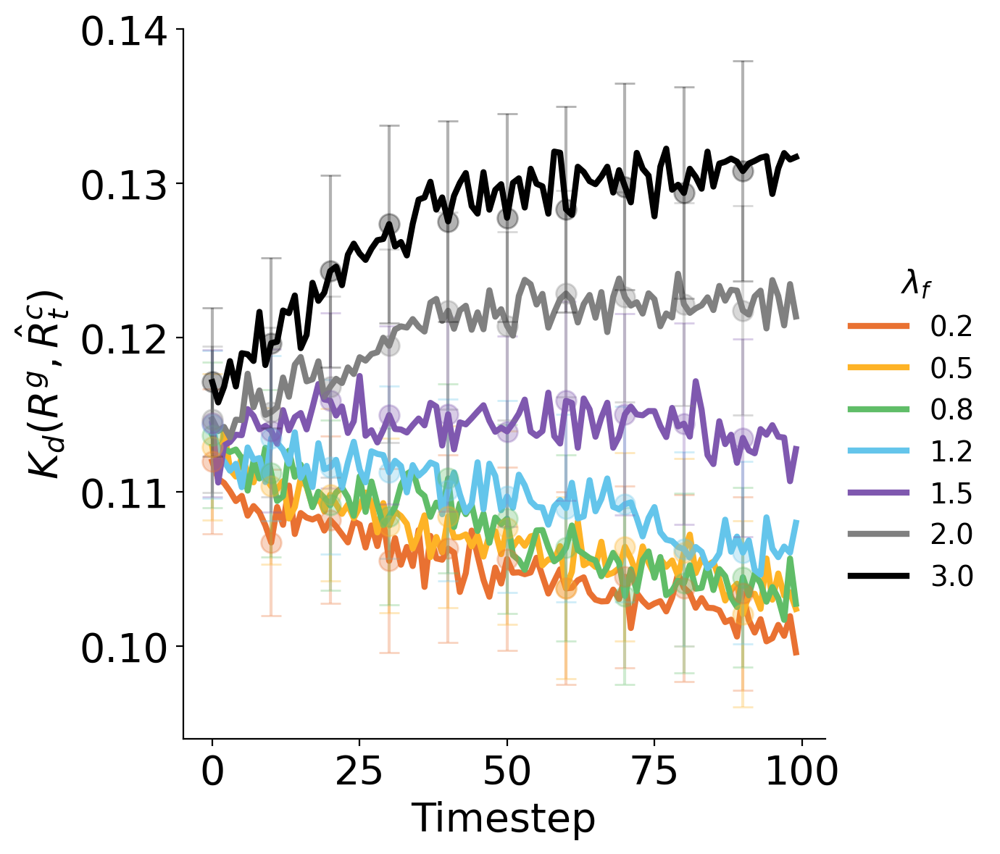

In [ ]:
fig = plt.figure(figsize=(7, 6), dpi=200)
ax = fig.add_subplot(111)

t=1000

for i in range(tot_num):
    ax.plot(np.mean(kd_array[i][:t], axis=0), lw=3, color=orig_color_list[i], label=filter_strength_list[i])
    ax.errorbar(range(100)[::10], np.mean(kd_array[i][:t], axis=0)[::10], yerr=np.std(kd_array[i][:t], axis=0)[::10], fmt='o', capsize=5, markersize=10, color=orig_color_list[i], alpha=0.3)
        
        
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel(r'$K_d(R^g, \hat{R}_t^c)$', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
legend1 = ax.legend(title=" "+r"$\lambda_f$", title_fontsize=16, frameon=False, bbox_to_anchor = (1.0, 0.7), fontsize=14)

ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/SI/figS11a.svg", format="svg", transparent=True, bbox_inches='tight')

### S11b. TSNE

In [ ]:
# TSNE

# [0.2, 0.5, 0.8, 1.2, 1.5, 2.0, 3.0]
check_range = [0, 2, 4, 6] # [0.2, 0.8, 1.5, 3.0]

embedding_list_tsne = np.array(raw_freq_list_list[check_range, :100, :100]).reshape(-1, num_topics)
embedding_list_tsne = np.argsort(np.argsort(-embedding_list_tsne, axis=1), axis=1)/num_topics
general_embedding = np.argsort(np.argsort(-general_freq))/num_topics

embedding_list_tsne = np.vstack((embedding_list_tsne, general_embedding))

X_embedded = sk.manifold.TSNE(n_components=2).fit_transform(embedding_list_tsne)
total_tsne_list = X_embedded

general_embedding = X_embedded[-1]
X_embedded = X_embedded[:-1]
total_tsne_list = X_embedded.reshape(len(check_range), 100, 100, 2)

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7f02dab26980>
Traceback (most recent call last):
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/home/seungwoong.ha/anaconda3/envs/collmind/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().s

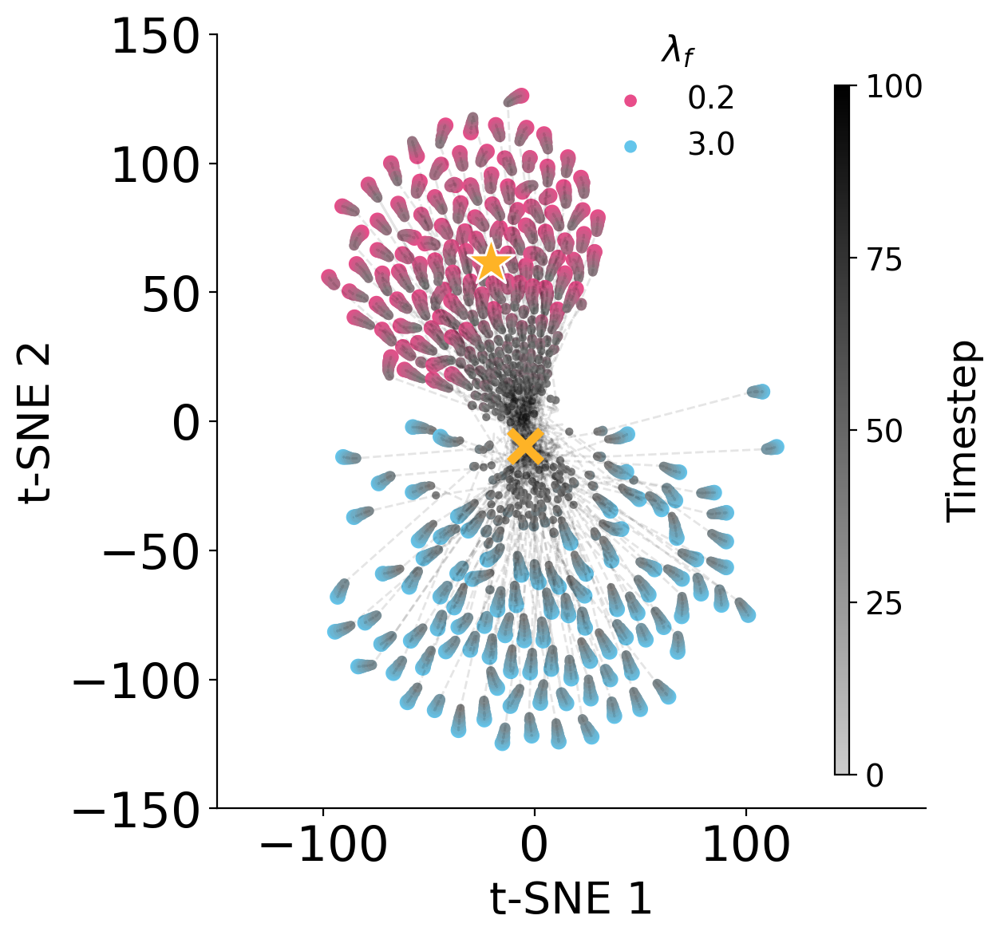

In [ ]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)

color_list = orig2_color_list

line_list = []
# [0.2, 0.5, 0.8, 1.2, 1.5, 2.0, 3.0]
f_list = [0.2, 0.8, 1.5, 3.0]

for n in check_range:
    for i in range(100):
        line = ax.scatter(-total_tsne_list[n, i, :, 0][::-1][::10], -total_tsne_list[n, i, :, 1][::-1][::10], c=np.arange(100)[::10], cmap=create_colormap(color_list[n]), s=np.linspace(50, 10, 100)[::10], label=f_list[n], linewidth=0)
        ax.plot(-total_tsne_list[n, i, :, 0], -total_tsne_list[n, i, :, 1], c='k', alpha=0.1, ls='--', lw=1)
    line_list.append(line)

#ax.scatter(-np.mean(total_tsne_list[0, :, 0]), -np.mean(total_tsne_list[0, :, 1]), c=orig_color_list[1], marker = 'x', s=500, linewidth=8, edgecolors='white')

ax.scatter(-np.mean(total_tsne_list[check_range[1:], :, 0, 0]), -np.mean(total_tsne_list[check_range[1:], :, 0, 1]), zorder=10, c=orig_color_list[1], marker = 'x', s=200, linewidth=4, edgecolors='white')

ax.scatter(-general_embedding[0], -general_embedding[1], zorder=10, c=orig_color_list[1], marker = '*', s=500, edgecolors='white')

ax.set_xlim(-150, 185)
ax.set_ylim(-150, 150)

leg = ax.legend(title="  "+r"$\lambda_f$", title_fontsize=16, frameon=False, handles=line_list, fontsize=14, bbox_to_anchor = (0.5, 0.8), columnspacing=0.5)

ax.set_xlabel('t-SNE 1', fontsize=20)
ax.set_ylabel('t-SNE 2', fontsize=20)
ax.spines[['right', 'top']].set_visible(False)

#ax.legend(handles=line_list, fontsize=12)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

#cbar = plt.colorbar(cim, ax=ax, orientation='vertical')
cax = fig.add_axes([0.88, 0.18, 0.015, 0.72])
cb = mpl.colorbar.ColorbarBase(cax, orientation='vertical', cmap=create_colormap('#CCCCCC', 'black'))
cb.set_label('Timestep', labelpad=10, fontsize=18)
cb.set_ticks(np.linspace(0, 1, 5))
cb.set_ticklabels([0, 25, 50, 75, 100], fontsize=14)

plt.tight_layout()
plt.savefig("figure/SI/figS11b.svg", format="svg", bbox_inches='tight', transparent=True)

## Figure S12. Additional influence figures

### S12a. Ref (comment)

In [178]:
folder_name = '3_ref'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250

iv_t1 = 100
iv_s1 = 0.04
iv_t2 = 300
iv_s2 = 0.0
tier = 2
timestep = 500

init_type = 'fixed'
init_freq_std = 0.0

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_31.npz'))
freq_list = data['freq_list']
base_freq_list = data['base_freq_list']
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']
top_weight_list = data['top_weight_list']
bottom_weight_list = data['bottom_weight_list']

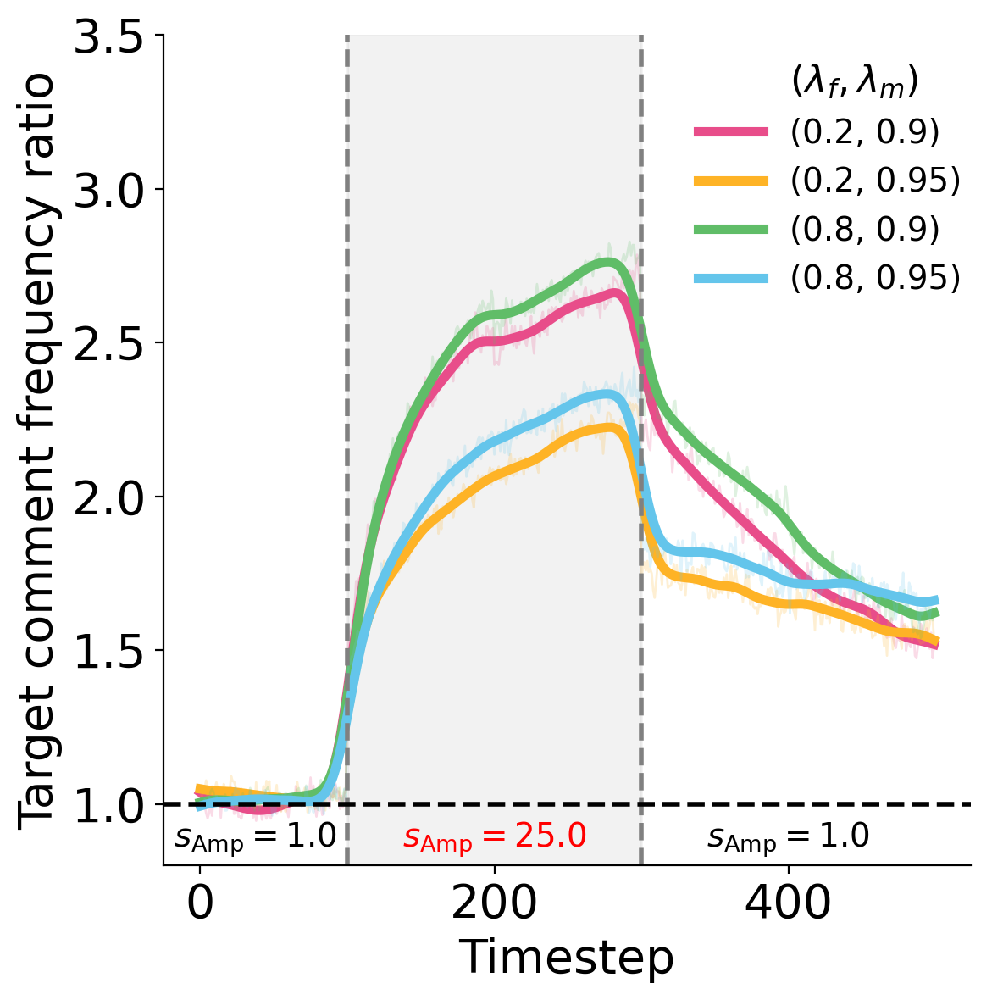

In [ ]:
sc = 100
sn = timestep//sc

counter = 0
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        #y = data_list[counter]
        
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        counter +=1
            
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.82
ax.text((iv_t1) / 2 * 0.75, y_text, r'$s_{\mathrm{Amp}}=1.0$', ha='center', va='bottom', fontsize=14, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$s_{\mathrm{Amp}}=25.0$', ha='center', va='bottom', fontsize=14, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$s_{\mathrm{Amp}}=1.0$', ha='center', va='bottom', fontsize=14, color='k')

ax.set_ylim(0.8, 3.5)
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target comment frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.625, 0.65), fontsize=14)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/SI/figS12a.svg", format="svg", transparent=True, bbox_inches='tight')

### S12b. CS (event)

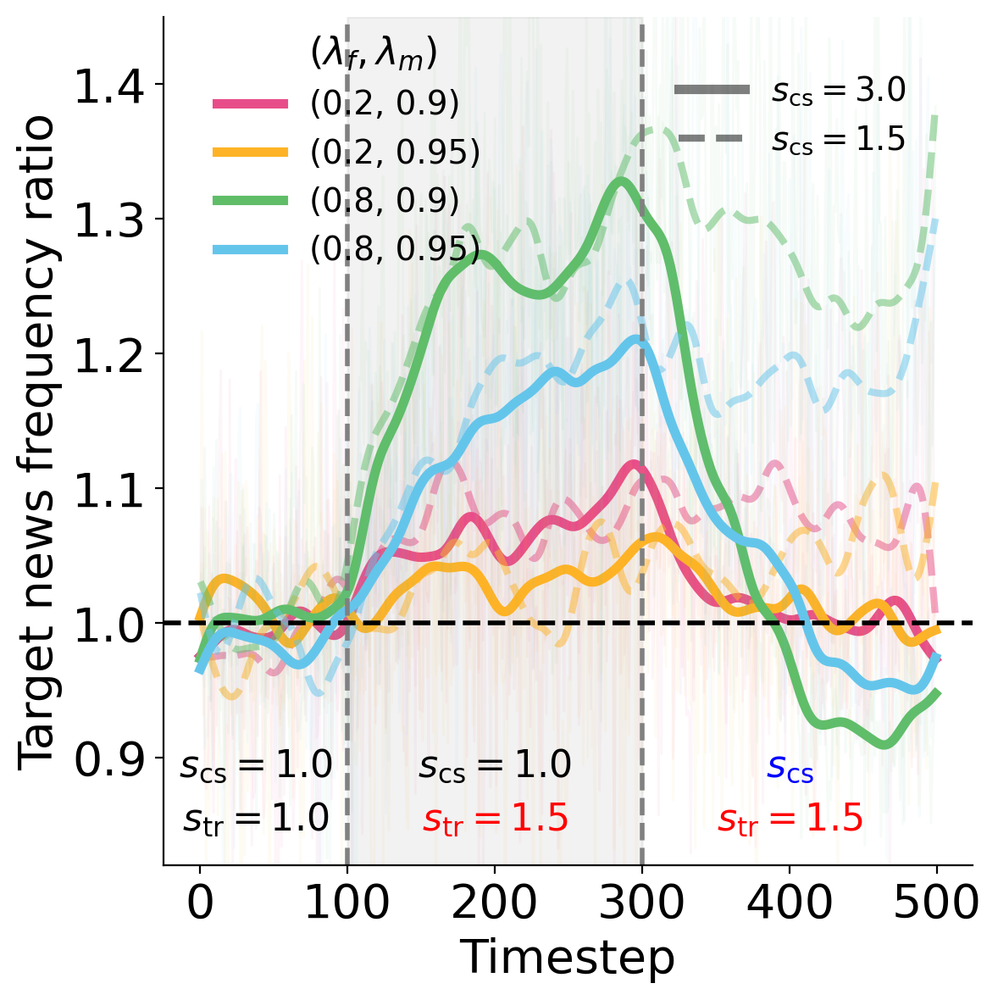

In [ ]:
folder_name = '6_counter'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61.npz'))
freq_list = data['freq_list']
base_freq_list = data['base_freq_list']
event_freq_list = data['event_freq_list']
base_event_freq_list = data['base_event_freq_list']

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_61_2.npz'))
freq_list2 = data['freq_list']
event_freq_list2 = data['event_freq_list']
model_type = 'simple'
color_list = orig2_color_list
lambda_ = 0.4

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)
timestep = 500

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 1.0
    
tier=0
counter = 0

sc = 100
sn = timestep//sc

fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
line_list = []

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        a = [np.mean(base_event_freq_list[counter][i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([event_freq_list2[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.05, color=color_list[counter], ls='-')

        denoised_signal = total_variation_denoising(y, lambda_)
        line = ax.plot(denoised_signal, lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        a = [np.mean(base_event_freq_list[counter][i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([event_freq_list[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.05, color=color_list[counter], ls='-')
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=3, ls='--', alpha=0.5, color=color_list[counter])
        line_list.append(line[0])
        
        counter +=1
        
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.84
ax.text((iv_t1) / 2 * 0.75, y_text, r'$s_{\mathrm{tr}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')
ax.text((timestep + iv_t2) / 2 , y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')

y_text2 = 0.88
ax.text((iv_t1) / 2 * 0.75, y_text2, r'$s_{\mathrm{cs}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((iv_t1 + iv_t2) / 2, y_text2, r'$s_{\mathrm{cs}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text((timestep + iv_t2) / 2 , y_text2, r'$s_{\mathrm{cs}}$', ha='center', va='bottom', fontsize=16, color='b')
#ax.set_ylim(0.95, 1.4)

ax.set_ylim(0.82, 1.45)

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target news frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
#ax.legend(bbox_to_anchor = (0.43, 0.735), fontsize=14)

legend1 =ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, handles=line_list, frameon=False, bbox_to_anchor = (0.43, 0.67), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label=r'$s_{\mathrm{cs}}=3.0$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label=r'$s_{\mathrm{cs}}=1.5$')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.6, 0.8), fontsize=14)
plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/SI/figS12b.svg", format="svg", transparent=True, bbox_inches='tight')

### S12c. Trolls (comment, t=150)

In [ ]:
folder_name = '5_trolls'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 150
iv_s2 = 1.0
counter = 0
timestep = 500
    
iv_type = '51'
tier=0

desc_range1 = range(10)
desc_range2 = range(10)

freq_list = []

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        print(filter_strength, memory_strength)

        tmp_freq_list = []
        
        for i in desc_range2:
            print(i)
    
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i}'
            print(sim_name)
            parameters, results = load_comp_model_result(folder_name, model_type, sim_name, tmp=True)

            comm_num = parameters['comm_num']
            raw_freq_list = results['raw_freq_list']
            filtered_events_list_list = results['filtered_events_list_list']
            
            raw_freq_list = raw_freq_list / np.sum(raw_freq_list, axis=2)[..., np.newaxis]
            freq = np.array([[raw_freq_list[c][i][target_topic] for i in range(timestep)] for c in range(comm_num)])
            tmp_freq_list.append(np.mean(freq, axis=0))
            
        freq_list.append(np.mean(tmp_freq_list, axis=0))
        


In [39]:
np.savez_compressed(join('comp_model', 'model_result_tmp', f'summary_51_3'), 
                    freq_list=np.array(freq_list))

In [43]:
folder_name = '5_trolls'
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250
timestep = 500

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_51.npz'))
base_freq_list = data['base_freq_list']

data = np.load(join('/data', 'collmind', 'model_result', folder_name, model_type, f'summary_51_2.npz'))
freq_list = data['freq_list']

data = np.load(join('comp_model', 'model_result_tmp', f'summary_51_3.npz'))
freq_list2 = data['freq_list']

In [44]:
for i in range(4):
    for j in range(500):
        if np.isnan(freq_list[i][j]):
            freq_list[i][j] = freq_list[i][j-1]
        if np.isnan(freq_list2[i][j]):
            freq_list2[i][j] = freq_list2[i][j-1]

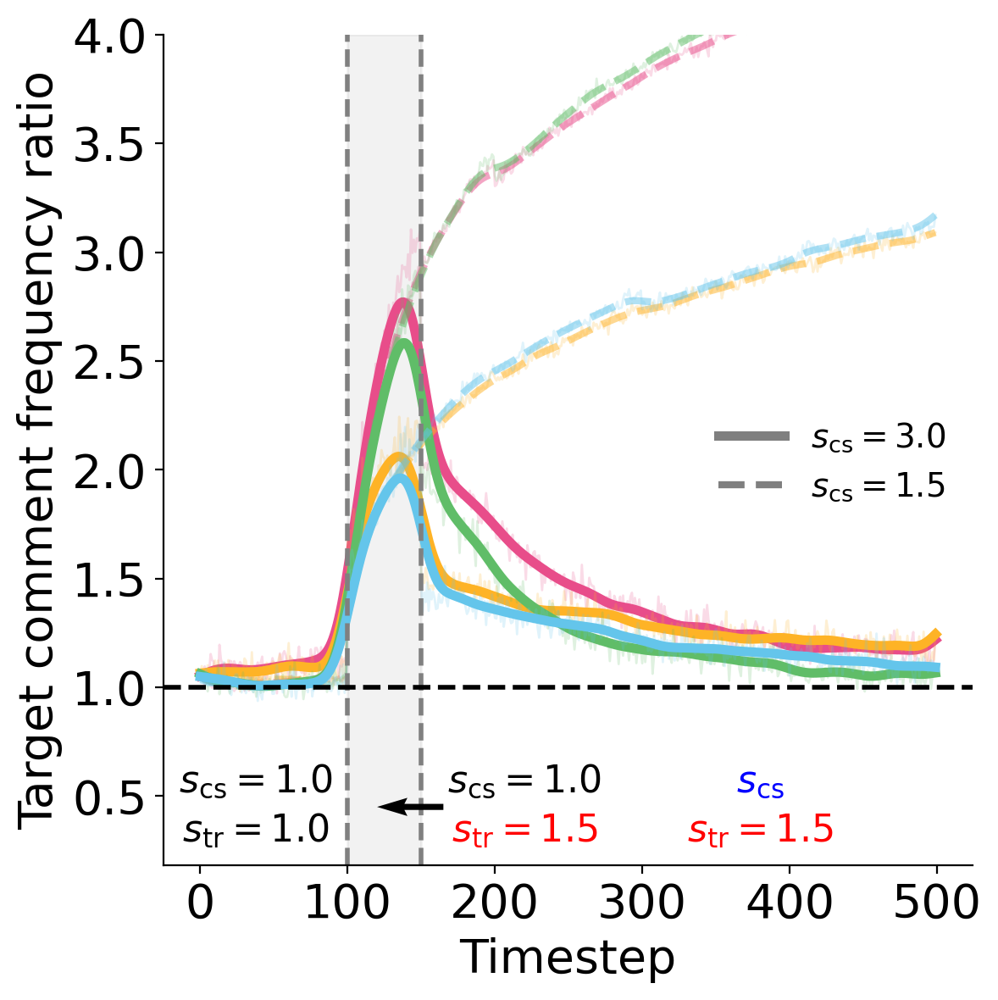

In [ ]:
model_type = 'simple'

filter_strength_list = [0.2, 0.8]
memory_strength_list = [0.9, 0.95]
target_topic = 25
num_topics = 250

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 150
iv_s2 = 1.0

sc = 100
sn = timestep//sc

counter = 0
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list

for filter_strength in filter_strength_list:
    for memory_strength in memory_strength_list:
        
        #y = data_list[counter]
        
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=3, alpha=0.5, ls='--', color=color_list[counter])
        
        
        a = [np.mean(base_freq_list[counter][:, i*sc: (i+1)*sc]) for i in range(sn)]
        y = np.concatenate([freq_list2[counter][i*sc: (i+1)*sc]/a[i] for i in range(sn)])
        ax.plot(y, lw=1, alpha=0.2, color=color_list[counter], ls='-')

        lambda_ = 0.4
        denoised_signal = total_variation_denoising(y, lambda_)
        ax.plot(denoised_signal, lw=4, color=color_list[counter], label=f'({filter_strength}, {memory_strength})')
        
        counter +=1
            
ax.axvline(iv_t1, lw=2, ls='--', color='gray')
ax.axvline(iv_t2, lw=2, ls='--', color='gray')
ax.axhline(1.0, lw=2, ls='--', color='black')

ax.axvspan(iv_t1, iv_t2, color='black', alpha=0.05)

y_text = 0.25
ax.text((iv_t1) / 2 * 0.75, y_text, r'$s_{\mathrm{tr}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text(220, y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')
ax.text(380, y_text, r'$s_{\mathrm{tr}}=1.5$', ha='center', va='bottom', fontsize=16, color='r')

y_text2 = 0.48
ax.text((iv_t1) / 2 * 0.75, y_text2, r'$s_{\mathrm{cs}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text(220, y_text2, r'$s_{\mathrm{cs}}=1.0$', ha='center', va='bottom', fontsize=16, color='k')
ax.text(380, y_text2, r'$s_{\mathrm{cs}}$', ha='center', va='bottom', fontsize=16, color='b')

ax.quiver(165, 0.45, -45, 0, scale=1, zorder=10, scale_units='xy', angles='xy', color='k')

ax.set_xticks([0, 100, 200, 300, 400, 500])
ax.set_ylim(0.18, 4.0)
ax.set_xlabel('Timestep', fontsize=20)
ax.set_ylabel('Target comment frequency ratio', fontsize=20)

ax.spines[['right', 'top']].set_visible(False)
#legend1 = ax.legend(title="    "+r"$(\lambda_f, \lambda_m)$", title_fontsize=16, frameon=False, bbox_to_anchor = (0.425, 0.65), fontsize=14)

line_list=[]
custom_line = Line2D([], [], color='black', lw=4, ls='-', alpha=0.5, label=r'$s_{\mathrm{cs}}=3.0$')
line_list.append(custom_line)

custom_line = Line2D([], [], color='black', lw=3, ls='--', alpha=0.5, label=r'$s_{\mathrm{cs}}=1.5$')
line_list.append(custom_line)

legend2 = ax.legend(handles=line_list, frameon=False, bbox_to_anchor = (0.65, 0.4), fontsize=14)
#plt.gca().add_artist(legend1)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig(f"figure/SI/figS12c.svg", format="svg", transparent=True, bbox_inches='tight')

## Figure S13. CS topic frequency distribution

In [5]:
# frequency difference check

folder_name = '6_counter'
model_type = 'simple'

filter_strength = 0.8
memory_strength = 0.9
target_topic = 25
num_topics = 250
num_events = 250 ## 1000 / 2 / 2 (num of events)

iv_t1 = 100
iv_s1 = 1.5
iv_t2 = 300
iv_s2 = 3.0
counter = 0

iv_type = '61'
tier=0

i = 0
sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV00_0_0.0_0_0.0_{target_topic}_-1_t500_{i}'
parameters, results = load_comp_model_result('0_base', model_type, sim_name)

comm_num = parameters['comm_num']
base_raw_freq_list = results['raw_freq_list']

sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF0.0_IV{iv_type}_{iv_t1}_{iv_s1}_{iv_t2}_{iv_s2}_{target_topic}_-1_t500_{i}'
parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
raw_freq_list = results['raw_freq_list']
general_freq = results['general_freq']

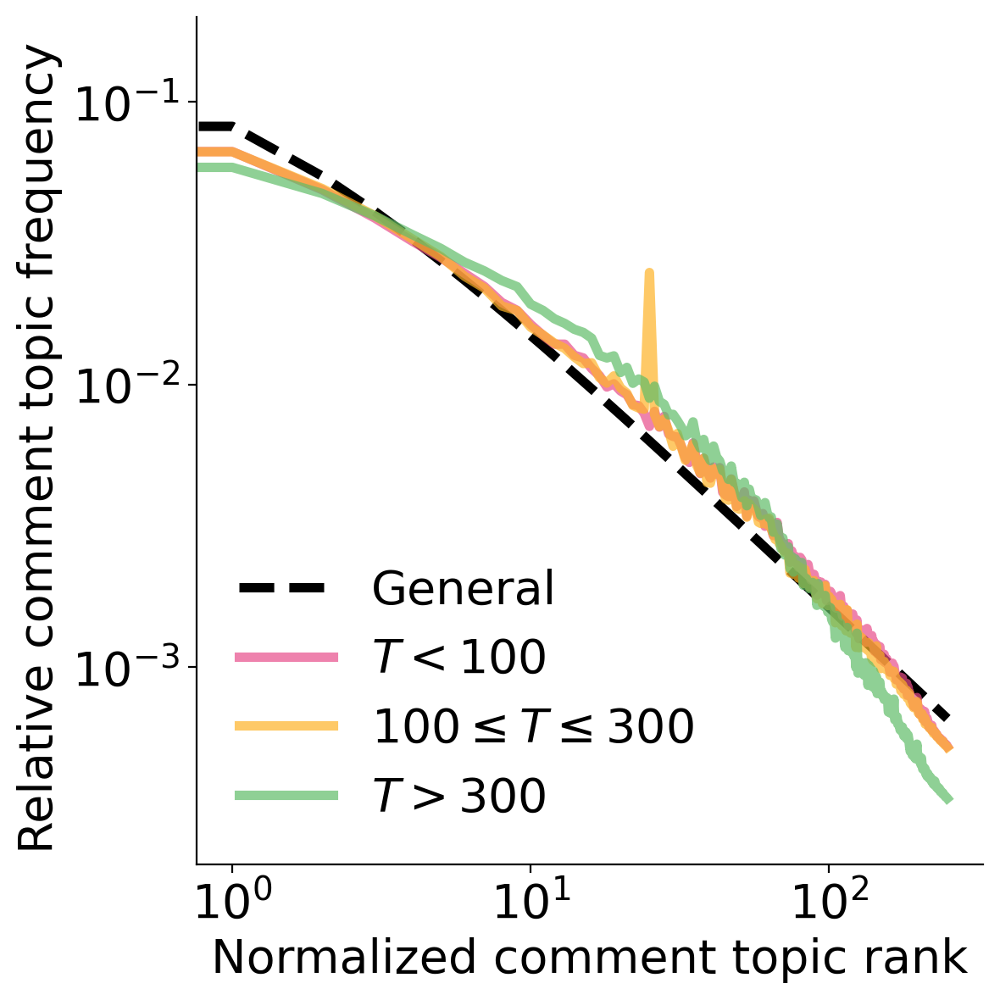

In [ ]:
d1 = np.mean(raw_freq_list[:, :100, :], axis=(0, 1))
d2 = np.mean(raw_freq_list[:, 100:300, :], axis=(0, 1))
d3 = np.mean(raw_freq_list[:, 300:, :], axis=(0, 1))


fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = orig2_color_list
line_list = []

ax.plot(general_freq, lw=4, ls='--', color='k', label='General')
ax.plot(d1/np.sum(d1), lw=4, color=color_list[0], alpha=0.7, label=r'$T<100$')
ax.plot(d2/np.sum(d2), lw=4, color=color_list[1], alpha=0.7, label=r'$100 \leq T \leq 300$')
ax.plot(d3/np.sum(d3), lw=4, color=color_list[2], alpha=0.7, label=r'$T>300$')

ax.set_xlabel('Normalized comment topic rank', fontsize=20)
ax.set_ylabel('Relative comment topic frequency ', fontsize=20)
ax.spines[['right', 'top']].set_visible(False)
#ax.text(0.05, 0.05, f'Data', fontsize=20, transform=ax.transAxes)
ax.set_ylim(2e-4, 2e-1)

ax.legend(frameon=False, fontsize=20)
ax.set_xscale('log')
ax.set_yscale('log')

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/SI/figS13.svg", format="svg", transparent=True)

## Figure S14. Parameter estimation for the real data

### S14a. Memory

In [21]:
with open(join('result', 'corr_rank_freq_global_dict.pkl'), 'rb') as f:
    data = pickle.load(f)
    
ranking_month_list_dict = data['ranking_month_list_dict']
frequency_month_list_dict = data['frequency_month_list_dict']

In [22]:
def moving_average(values, window_size):
    moving_averages = []
    for i in range(len(values) - window_size + 1):
        window = values[i:i+window_size]
        window_average = sum(window) / window_size
        moving_averages.append(window_average)
    return np.array(moving_averages)

In [23]:
off_corr_dict = {}
window_size = 12

for c, collection_name in enumerate(COLLECTION_NAMES):
    full_corr_freq_month_list = frequency_month_list_dict['off_corr'][collection_name] + frequency_month_list_dict['corr'][collection_name]
    full_corr_freq_month_list = full_corr_freq_month_list / np.sum(full_corr_freq_month_list, axis=1, keepdims=True)
    prev_data = moving_average(full_corr_freq_month_list, window_size)

    off_corr_freq_month_list = frequency_month_list_dict['off_corr'][collection_name]
    data = (off_corr_freq_month_list / np.sum(off_corr_freq_month_list, axis=1, keepdims=True))[window_size:]
        
    corr_list = []
    for i in range(len(data)-1):
        corr_list.append(np.corrcoef(prev_data[i], data[i+1])[0][1])
    off_corr_dict[collection_name] = corr_list

np.int64(117)

0.922657093981065
0.9509672158347751
0.9461943461933731
0.9326975504643062
0.9274871826249672


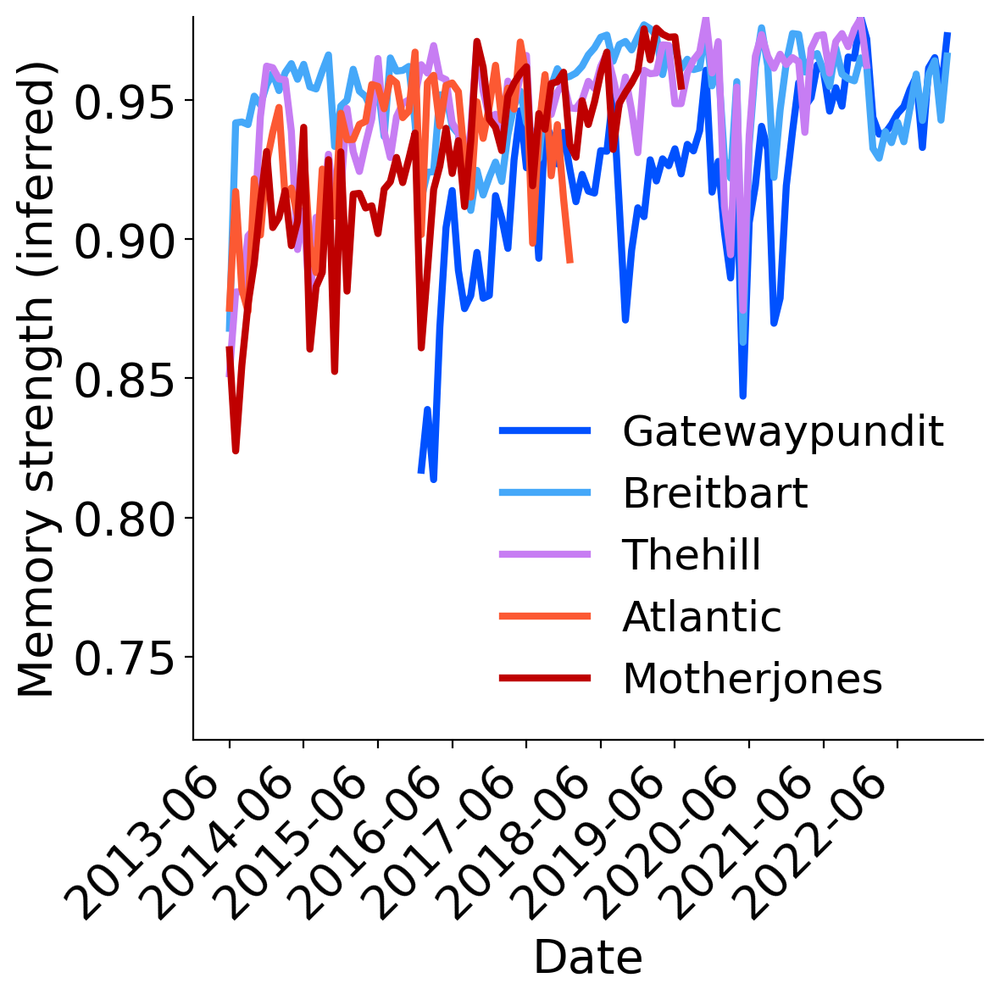

In [31]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)
color_list = rb_color_list
line_list = []

for c, collection_name in enumerate(COLLECTION_NAMES):
    ax.plot(np.arange(MONTH_OFFSET[collection_name], len(off_corr_dict[collection_name])+MONTH_OFFSET[collection_name]), off_corr_dict[collection_name], color=color_list[c], lw=3, label=collection_name)
    print(np.mean(off_corr_dict[collection_name]))

ax.set_xlabel('Date', fontsize=20)
ax.set_ylabel('Memory strength (inferred)', fontsize=20)
ax.spines[['right', 'top']].set_visible(False)
#ax.text(0.05, 0.05, f'Data', fontsize=20, transform=ax.transAxes)
xticks = np.arange(0, np.max([len(off_corr_dict[collection_name]) for collection_name in COLLECTION_NAMES]), 12)
xtick_labels = [f"{2013 + i}-06" for i in range(len(xticks))]
ax.set_xticks(xticks)
ax.set_xticks(xticks)
ax.set_xticklabels(xtick_labels, rotation=45, ha='right')

#ax.grid(True, which='both', linestyle='--', linewidth=0.5)

ax.set_ylim(0.72, 0.98)
ax.legend(frameon=False, fontsize=18)

#ax.set_xscale('log')
#ax.set_yscale('log')

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.savefig("figure/SI/figS14.svg", format="svg", transparent=True)

### S14b. Filter strength

In [12]:
title_topic_num_list_dict_dict = {}
for collection_name in COLLECTION_NAMES:
    print(collection_name)
    with open(join('/data', 'collmind', 'article_global', collection_name.lower(), 'result_dict.pkl'), 'rb') as f:
        result_dict = pickle.load(f)
    title_topic_num_list_dict_dict[collection_name] = result_dict['title_topic_num_list_dict']['month']

Gatewaypundit
Breitbart
Thehill
Atlantic
Motherjones


In [14]:
title_topic_num_list_dict_dict['Breitbart']

[array([[  4.,   4.,   2.],
        [ 72., 110.,  68.],
        [ 44.,  36.,  33.],
        [ 13.,  11.,   8.],
        [ 45.,  28.,  23.],
        [ 25.,  17.,  14.],
        [ 28.,  17.,   6.],
        [ 15.,  11.,   2.],
        [ 76.,  40.,  28.],
        [  3.,   7.,  11.],
        [ 31.,  22.,  26.],
        [ 32.,  15.,  12.],
        [ 50.,  33.,  11.],
        [  9.,   5.,   3.],
        [ 30.,  13.,   8.],
        [ 49.,  26.,  11.],
        [  2.,   5.,   2.],
        [ 12.,   7.,   6.],
        [  2.,   3.,   5.],
        [  1.,   8.,   1.],
        [ 17.,  11.,   8.],
        [ 11.,   5.,   4.],
        [  6.,   2.,   2.],
        [  3.,   3.,  11.],
        [  7.,   9.,   4.],
        [  2.,   2.,   2.],
        [  5.,   4.,   0.],
        [ 17.,  26.,  34.],
        [  7.,   5.,   4.],
        [  5.,   1.,   2.],
        [ 90.,  12.,  13.],
        [  3.,   5.,   4.],
        [ 12.,   8.,   9.],
        [  3.,   2.,   4.],
        [  0.,   0.,   0.],
        [  3.,   4.,

In [45]:
collection_name = 'Breitbart'
rank=1
data_list = []
for collection_name in COLLECTION_NAMES:
    data = np.array([title_topic_num_list_dict_dict[collection_name][i][:, rank-1] for i in range(len(title_topic_num_list_dict_dict[collection_name]))])
    data_list.append(data/np.sum(data, axis=1, keepdims=True))

In [46]:
data_list = np.array([data_list[0][:61-39], data_list[1][39:61], data_list[2][39:61], data_list[3][39:61], data_list[4][39:61]])

In [49]:
np.sum(data_list, axis=0)

array([[0.02034923, 0.1607477 , 0.10519461, ..., 0.01859008, 0.00112962,
        0.01474693],
       [0.01291404, 0.13736534, 0.08682374, ..., 0.01583362, 0.00330885,
        0.00736927],
       [0.01467674, 0.12649395, 0.0654668 , ..., 0.01951015, 0.00053291,
        0.01246134],
       ...,
       [0.01294099, 0.22594614, 0.12096147, ..., 0.0331829 , 0.00626143,
        0.00704043],
       [0.01191739, 0.16739293, 0.10958888, ..., 0.01981018, 0.0031883 ,
        0.00796459],
       [0.01522724, 0.1910349 , 0.06753702, ..., 0.01592258, 0.00259254,
        0.00185148]])

[]

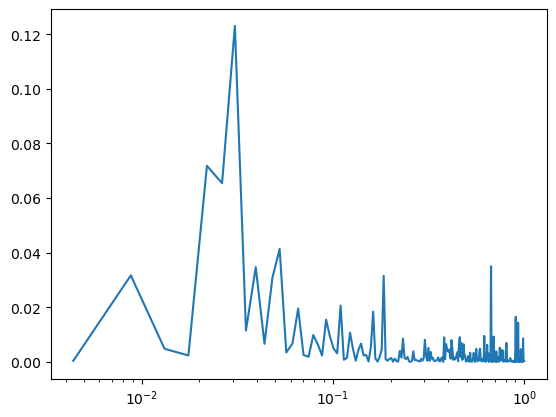

In [70]:
plt.plot(np.arange(1, 228+1)/228, np.mean(data_list[0], axis=0))
plt.semilogx()

# **[Analysis]**

## Stratified threshold (SI #1)

In [ ]:
def _filter_filenames_between(filenames: List[str], start_date: datetime, end_date: datetime):
    """Filter a list of filenames, which contain batches in a given time period

    Args:
        filenames (List[str]): Filenames to filter
        start_date (datetime): Lower bound of the time period (inclusive)
        end_date (datetime): Upper bound of the time period (inclusive)

    Returns:
        List[str]: Filtered list of filenames
    """
    filtered_filenames = []
    for filename in filenames:
        file_date_start, file_date_end = filename.replace(".pt", "").split("-")[-2:]
        file_date_start = datetime.strptime(file_date_start, "%m%y")
        file_date_end = datetime.strptime(file_date_end, "%m%y")
        if (start_date <= file_date_start <= end_date) and (start_date <= file_date_end <= end_date):
            filtered_filenames.append(filename)
    return filtered_filenames

def get_threshold(freq, sampling_size):
    
    '''calculate k for stratified samplings'''

    sum_freq = sum(freq)
    cumsum_freq = np.cumsum(freq)
    cumsum_i_freq = np.cumsum((freq * (np.arange(len(freq))+1)))
    for k in range(1, len(freq)+1):
        if k * (sum_freq - cumsum_freq[k-1]) + cumsum_i_freq[k-1] > sampling_size:
            break
        
    return k-1

In [ ]:
mode='new' 
size = 2000000
seed = 19

for collection_name in COLLECTION_NAMES:

    start_date, end_date = DATE_RANGES[collection_name]
    # Sample data
    
    collection_dir = join(DATA_DIR, f"new_ids/{collection_name.lower()}") 
    sample_filename = f"s{size}_{start_date.strftime('%m%y')}_{end_date.strftime('%m%y')}_sd{seed}.csv"
    all_ids_df = pd.read_csv(join(collection_dir, f"all.csv"), dtype={"id": str})
    filenames_mask = _filter_filenames_between(all_ids_df["filename"].unique(), start_date, end_date)
    filtered_ids_df = all_ids_df[all_ids_df["filename"].isin(filenames_mask)]

    # Stratified sampling
    time_period = relativedelta(end_date, start_date)
    messages, topics, timestamps = [], [], []
    art_id_counter = Counter()
    art_id_dict = defaultdict(list)
    for embeddings_month, current_date in tqdm(gen_sent_embeddings(collection_name, start_date, end_date, mode='new'), total=12 * time_period.years + time_period.months):
        comments_df = query_comments_by_id("Comments", collection_name, embeddings_month["_id"],  select_columns=["_id", "raw_message", "createdAt", "art_id"]) \
            .set_index("_id").loc[embeddings_month["_id"]]
        temp = Counter(comments_df['art_id'].values)
        art_id_counter += temp
        
        # make a dictionary from comments_df, where the key is art_id and value is the lis of _id shares the same art_id
        for i, row in comments_df.iterrows():
            art_id_dict[row['art_id']].append(i)
    
    art_id_counter_filtered = {k: v for k, v in art_id_counter.items() if v >= 10}
    
    freq, bins = np.histogram(list(art_id_counter_filtered.values()), bins=np.arange(max(art_id_counter_filtered.values())+1))
    threshold = get_threshold(freq, size)
    print(collection_name, threshold)

## TM model grid search (Table S2, S3)

In [ ]:
# gather all files ending with 'output.pkl' in 'result/{collection_name}' and make it as a dataframe

collection_names = ['Atlantic', 'Breitbart', 'Thehill', 'Gatewaypundit', 'MotherJones', 'global']

grade = 'coarse'
df_dict = {}
for collection_name in collection_names:
    print(collection_name)
    hlist = [200, 300, 400]
    ulist = [30, 60, 90]
    slist = [1, 2, 3, 4, 5]

    df_list = []
    for h in hlist:
        for u in ulist:
            for s in slist:
                try:
                    file_path = join('/data', 'collmind', 'search', collection_name.lower(), f'{collection_name.lower()}_new_s{s}_r19_h{h}_u{u}_t10_output.pkl')
                    df = pd.read_pickle(file_path)
                    del df['ctfidf_vectors'], df['topic_embeddings'], df['names']
                    df['h'] = h
                    df['u'] = u
                    df['seed'] = s
                    df_list.append(pd.DataFrame([df]))
                except:
                    # noticing missing file
                    print(f'{collection_name.lower()}_new_s{s}_r19_h{h}_u{u}_t10_output.pkl is missing')
                    pass

    df = pd.concat(df_list, ignore_index=True)
    df_dict[collection_name] = df

In [ ]:
df = df_dict['Gatewaypundit']
grouped = df.groupby(['h', 'u']).agg({key: ['mean', 'std']})
dz = grouped[key]['mean'].values.flatten()
dz.reshape(3, 3)

In [ ]:
# gather all files ending with 'output.pkl' in 'result/{collection_name}' and make it as a dataframe

collection_names = ['global']

grade = 'coarse'
df_dict = {}
for collection_name in collection_names:
    print(collection_name)
    hlist = [200, 300, 400]
    ulist = [30, 60, 90]
    slist = [1, 2, 3, 4, 5]

    df_list = []
    for h in hlist:
        for u in ulist:
            for s in slist:
                try:
                    file_path = join('/data', 'collmind', 'search', collection_name.lower(), f'{collection_name.lower()}_new_s{s}_r19_h{h}_u{u}_t10_output.pkl')
                    df = pd.read_pickle(file_path)
                    del df['ctfidf_vectors'], df['topic_embeddings'], df['names']
                    df['h'] = h
                    df['u'] = u
                    df['seed'] = s
                    df_list.append(pd.DataFrame([df]))
                except:
                    # noticing missing file
                    print(f'{collection_name.lower()}_new_s{s}_r19_h{h}_u{u}_t10_output.pkl is missing')
                    pass

    df = pd.concat(df_list, ignore_index=True)
    df_dict[collection_name] = df

In [ ]:
df = df_dict['global']
grouped = df.groupby(['h', 'u']).agg({key: ['mean', 'std']})
dz = grouped[key]['mean'].values.flatten()
dz.reshape(3, 3)

In [ ]:
# Corase grained result 

# atl : 200, 90
# brb : 200, 30
# gtw : 400, 30
# mj : 400, 90
# th : 300, 90
# global : 300, 30

In [ ]:
# Fine search

# gather all files ending with 'output.pkl' in 'result/{collection_name}' and make it as a dataframe

collection_names = ['Atlantic', 'Breitbart', 'Gatewaypundit', 'Motherjones', 'Thehill', 'global']
fine_dict = {'Atlantic': (200, 90), 'Breitbart': (200, 30), 'Gatewaypundit': (400, 30), 'Motherjones': (400, 90), 'Thehill': (300, 90), 'global':(300, 30)}

df_dict = {}

for collection_name in collection_names:
    print(collection_name)
    fine_param = fine_dict[collection_name]
    h = fine_param[0]
    u = fine_param[1]
    hlist = [h-25, h, h+25]
    ulist = [u-10, u, u+10]
    slist = [1, 2, 3, 4, 5]

    df_list = []
    for h in hlist:
        for u in ulist:
            for s in slist:
                try:
                    file_path = join('/data', 'collmind', 'search', collection_name.lower(), f'{collection_name.lower()}_new_s{s}_r19_h{h}_u{u}_t10_output.pkl')
                    df = pd.read_pickle(file_path)
                    del df['ctfidf_vectors'], df['topic_embeddings'], df['names']
                    df['h'] = h
                    df['u'] = u
                    df['seed'] = s
                    df_list.append(pd.DataFrame([df]))
                except:
                    # noticing missing file
                    print(f'{collection_name.lower()}_new_s{s}_r19_h{h}_u{u}_t10_output.pkl is missing')
                    pass

    df = pd.concat(df_list, ignore_index=True)
    df_dict[collection_name] = df

In [ ]:
collectio_name = 'global'
df = df_dict[collection_name]
# sort df by h value
df = df.sort_values(by='h')


In [ ]:
collection_name = 'global'
df = df_dict[collection_name]
# sort df by outlier_ratio_10

df_sort = df.sort_values(by='outlier_ratio_10', ascending=True).head(5)
df_sort

In [ ]:
# Fine(2) search result

# atl : (5) 175, 80 / ★ (4) 200, 80 (this one has distinctive vaccine)
# brb : ★ (3) 225 20 (5) / (4) 175, 30 (10) (this one has china-vaccine merging problem)
# gtw : (4) 425 30 (5) (this has school-gun-warming all-together merging prbolm) / ★ (4) 400 30 (5, 3) (although this is third one, it has very good representation (two covids though))	
# mj : ★ (5) 425, 90 (5) (climate is super big topic with energy)
# th : ★ (2) 300 80	

# Final winners (horray!)

# atl : (4) 200, 80 
# brb : (3) 225, 20 
# gtw : (4) 400, 30
# mj : (5) 425, 90
# th : (2) 300, 80

In [3]:
## ETC

In [3]:
collection_name = 'Thehill'
aggregate_day = 'month'
num_topics = NUM_TOPICS[collection_name]
model_name = MODEL_NAMES[collection_name]
article_day = '2012-06-01'

with open(join('/data', 'collmind', 'article', collection_name.lower(), aggregate_day, f'topic_dict_{aggregate_day}.pkl'), 'rb') as f:
    articles_by_month = pickle.load(f)
articles_by_month = articles_by_month_clear(articles_by_month)

Original article number: 313673
Filtered article (after comment) number: 287292
Filtered article (after article) number: 284859
Filtered article ratio: 0.908140
Original comment number: 174763515
Filtered comment number (after comment): 174343158
Filtered comment number (after article): 172172405
Filtered comment ratio: 0.985174
Filtered n1 number (after comment): 89926144
Filtered n1 number (after article): 88812391
Filtered n1 ratio: 0.508186


In [4]:
with open(join('article', collection_name.lower(), MODEL_NAMES[collection_name], 'articles_by_day.pkl'), 'rb') as f:
    articles_by_day = pickle.load(f)

In [5]:
articles_by_day['2012-06-01']

,_id,createdAt,clean_title,title_embeddings
0,710109851,2012-06-01 00:02:11,http://thehill.com/blogs/defcon-hill/budget-ap...,"[-0.07646606862545013, -0.009535612538456917, ..."
1,710110673,2012-06-01 00:03:32,"Brown, Coakley both trending on Twitter","[0.033942218869924545, -0.11053239554166794, 0..."
2,710125675,2012-06-01 00:26:41,Slew of amendments approved for military const...,"[-0.05453859269618988, 0.01211472786962986, 0...."
3,710147732,2012-06-01 00:59:47,House members slam Obama on Yucca Mountain policy,"[-0.023600758984684944, -0.016822753474116325,..."
4,710173128,2012-06-01 01:34:26,Human health is the real oil spill issue,"[-0.045810405164957047, 0.01765337400138378, 0..."
...,...,...,...,...
107,711145439,2012-06-01 21:57:41,DAY'S END ROUNDUP,"[-0.0376415029168129, 0.11572637408971786, 0.0..."
108,711155163,2012-06-01 22:11:34,Speaker's staff presses DoD,"[-0.03141971677541733, 0.003748977091163397, 0..."
109,711180633,2012-06-01 22:43:40,Romney worth between $190 and $250 million,"[-0.06541240960359573, -0.0533406101167202, -0..."
110,711187334,2012-06-01 22:53:05,Repealing healthcare reform - A risk we can't ...,"[-0.004277550615370274, 0.07488793134689331, 0..."


In [6]:
new_data = pd.read_parquet(join('article', collection_name.lower(), MODEL_NAMES[collection_name], 'articles_by_day', article_day + '.parquet'))

In [ ]:
new_data.to_json('new_data.json', orient='records', lines=True)

In [7]:
new_data

,_id,createdAt,clean_title,title_embeddings,topic_num,topic_prob,comment_id,comment_topics,comment_createdAt,comment_embeddings,comment_sentiments,topic_num_global,topic_prob_global,comment_topics_global
0,710109851,2012-06-01 00:02:11,http://thehill.com/blogs/defcon-hill/budget-ap...,"[-0.07646606862545013, -0.009535612538456917, ...","[79, 155, 218, 249, 1]","[0.6149638027940959, 0.5374340326645709, 0.536...","[544289187, 544290138, 544294391, 544295414, 5...","[1, -1, -1, 27, 1, 4, 61, -1, 9, 82, -1, -1, 6...","[2012-06-01T01:14:22.000000, 2012-06-01T01:16:...","[[-0.01782108284533024, 0.07905706018209457, 0...","[[0.76120317, 0.27966288, 0.65680283, 0.015561...","[50, 92, 1, 106, 10]","[0.6032330484813386, 0.5222732292411362, 0.518...","[-1, 2, -1, 28, 2, -1, 53, -1, -1, 18, -1, 1, ..."
1,710110673,2012-06-01 00:03:32,"Brown, Coakley both trending on Twitter","[0.033942218869924545, -0.11053239554166794, 0...","[84, 184, 194, 139, 196]","[0.39396975192354056, 0.3710780650351104, 0.37...",[],[],[],[],[],"[31, 132, 176, 149, 27]","[0.3815213808755188, 0.3800150907977484, 0.355...",[]
2,710125675,2012-06-01 00:26:41,Slew of amendments approved for military const...,"[-0.05453859269618988, 0.01211472786962986, 0....","[183, 213, 146, 218, 110]","[0.4976805670933795, 0.38454057016704835, 0.34...",[],[],[],[],[],"[86, 181, 67, 35, 128]","[0.3651967708634174, 0.3501461111031138, 0.291...",[]
3,710147732,2012-06-01 00:59:47,House members slam Obama on Yucca Mountain policy,"[-0.023600758984684944, -0.016822753474116325,...","[9, 218, 145, 251, 7]","[0.540256496262913, 0.44121845012650696, 0.420...","[544315759, 544330364, 544339291, 544359914, 5...","[1, -1, -1, -1, -1, 9, 38, 53, -1, -1, -1, -1,...","[2012-06-01T01:55:45.000000, 2012-06-01T02:10:...","[[0.05985511839389801, 0.03240117058157921, -0...","[[0.7312587, 0.1753996, 0.8498107, 0.06188496,...","[157, 1, 50, 92, 106]","[0.4205803207106269, 0.3975205308368423, 0.386...","[2, -1, -1, 1, -1, 1, -1, 6, 9, -1, 13, -1, 14..."
4,710173128,2012-06-01 01:34:26,Human health is the real oil spill issue,"[-0.045810405164957047, 0.01765337400138378, 0...","[8, 2, 174, 47, 22]","[0.5243292231779662, 0.45037588175406945, 0.39...",[],[],[],[],[],"[42, 13, 49, 107, 177]","[0.5679755856484522, 0.47920561382959265, 0.44...",[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,711145439,2012-06-01 21:57:41,DAY'S END ROUNDUP,"[-0.0376415029168129, 0.11572637408971786, 0.0...","[0, 221, 30, 180, 252]","[0.3517665124274457, 0.33222636458438426, 0.31...",[],[],[],[],[],"[75, 59, 0, 217, 221]","[0.5110069520403242, 0.3247185102049427, 0.316...",[]
108,711155163,2012-06-01 22:11:34,Speaker's staff presses DoD,"[-0.03141971677541733, 0.003748977091163397, 0...","[141, 102, 129, 110, 106]","[0.2601051171707001, 0.25140309386291687, 0.23...",[],[],[],[],[],"[86, 23, 125, 148, 133]","[0.23480202764514227, 0.2188283037868497, 0.21...",[]
109,711180633,2012-06-01 22:43:40,Romney worth between $190 and $250 million,"[-0.06541240960359573, -0.0533406101167202, -0...","[42, 98, 253, 212, 87]","[0.5974475059680442, 0.31843837042830603, 0.31...","[545366190, 545373295, 545375839, 545376838, 5...","[1, 1, 42, 17, 42, -1, -1, -1, 1, -1, 1, 1, 42...","[2012-06-01T23:01:40.000000, 2012-06-01T23:16:...","[[0.00962365698069334, 0.010936857201159, -0.0...","[[0.046335045, 0.57778114, 0.06741949, 0.02003...","[30, 111, 69, 100, 41]","[0.5889006635869378, 0.31387345907230274, 0.27...","[2, 2, 30, -1, 30, 30, -1, -1, 2, -1, -1, -1, ..."
110,711187334,2012-06-01 22:53:05,Repealing healthcare reform - A risk we can't ...,"[-0.004277550615370274, 0.07488793134689331, 0...","[22, 20, 213, 146, 183]","[0.6745144972870394, 0.6736444146400394, 0.630...",[],[],[],[],[],"[12, 2, 168, 178, 197]","[0.6957533187312134, 0.43865943216253495, 0.42...",[]


In [ ]:
from proj_utils import _init_mongo_collection

select_columns = ['_id', 'raw_message', 'createdAt', 'art_id']
mongo_client_comments, collection_comments = _init_mongo_collection('Comments', collection_name)

In [8]:
def get_comments_from_id(collection, id, select_columns):
    query = {'_id': id}
    projection = {k: 1 for k in select_columns}
    comments = collection.find(query, projection)
    return pd.DataFrame(comments)

In [16]:
#select_columns = ['raw_message']
get_comments_from_id(collection_comments, '544289187', select_columns)

,_id,createdAt,raw_message,art_id
0,544289187,2012-06-01 01:14:22,Make a real deal or make the sequestration cut...,710109851


In [30]:
query = {'_id': '544289187'}
d =pd.DataFrame(collection_comments.find(query))

In [31]:
d.columns

Index(['_id', 'editableUntil', 'dislikes', 'numReports', 'likes', 'createdAt',
       'media', 'isSpam', 'isDeletedByAuthor', 'isHighlighted', 'parent',
       'isApproved', 'isDeleted', 'isFlagged', 'raw_message', 'isAtFlagLimit',
       'canVote', 'forum', 'points', 'moderationLabels', 'isEdited', 'sb',
       'user_about', 'user_avatar', 'user_id', 'user_isAnonymous',
       'user_joinedAt', 'user_location', 'user_profileURL', 'user_name',
       'user_disable3rdPartyTrackers', 'user_isPowerContributor',
       'user_isPrivate', 'user_isPrimary', 'art_id'],
      dtype='object')

In [29]:
d['posts']

0    218
Name: posts, dtype: int64

In [26]:
d

,_id,dislikes,likes,ratingsEnabled,createdAt,adsDisabled,clean_title,isClosed,link,forum,posts
0,710109851,1,0,False,2012-06-01 00:02:11,False,http://thehill.com/blogs/defcon-hill/budget-ap...,False,http://thehill.com/blogs/defcon-hill/budget-ap...,thehill-v4,92


In [11]:
from proj_utils import _process_raw_message

In [12]:
article_id_list = []
comment_id_list = []
comment_list = []

for data in new_data.iterrows():
    cil = data[1]['comment_id']
    print(data[0], cil)
    for comment_id in cil:
        article_id_list.append(data[1]['_id'])
        comment_id_list.append(comment_id)
        comment_list.append(_process_raw_message(get_comments_from_id(collection_comments, comment_id, select_columns)['raw_message'].values[0]))

0 ['544289187' '544290138' '544294391' '544295414' '544295822' '544305020'
 '544305941' '544306890' '544319800' '544319892' '544320209' '544327098'
 '544343044' '544350239' '544370688' '544375607' '544419037' '544433276'
 '544442420' '544443897' '544446169' '544468612' '544478672' '544481148'
 '544485132' '544489663' '544491282' '544498836' '544501463' '544519115'
 '544519984' '544521074' '544522380' '544530298' '544551221' '544552582'
 '544555181' '544605872' '544612956' '544615739' '544683672' '544828199'
 '544830297' '544830546' '544831953' '544833029' '544834468' '544834661'
 '544835051' '544877224' '544880399' '544897368' '544903418' '544922814'
 '544940749' '544951997' '544954521' '544974370' '544979338' '544980343'
 '544981211' '544982742' '545000826' '545001182' '545036811' '545070497'
 '545122045' '545378609' '545478945' '545935173' '546129164' '546129317'
 '546129722' '546129949' '546130111' '546130295' '546130427' '546130499'
 '546179353' '546199173' '546200078' '546607147' 

7 []
8 []
9 ['544836029' '544837082' '544837874' '544840937' '544840967' '544844047'
 '544845627' '544849351' '544852081' '544856114' '544856727' '544859737'
 '544859837' '544861459' '544861622' '544863237' '544864974' '544866029'
 '544866580' '544866959' '544867423' '544867615' '544867968' '544869095'
 '544869128' '544869461' '544869875' '544872459' '544872796' '544873138'
 '544875500' '544875629' '544878722' '544881136' '544883431' '544884660'
 '544885123' '544885694' '544885849' '544886896' '544887789' '544888041'
 '544888295' '544888702' '544889207' '544889960' '544890198' '544890799'
 '544891123' '544891469' '544892327' '544892761' '544893888' '544894061'
 '544894613' '544895321' '544896259' '544896834' '544898726' '544898905'
 '544899290' '544901758' '544902239' '544903321' '544903629' '544904281'
 '544904356' '544905315' '544905392' '544905903' '544905945' '544906496'
 '544907163' '544907408' '544907723' '544908307' '544908311' '544908709'
 '544909335' '544909377' '544909769' '5

In [13]:
new_dataframe = pd.DataFrame({'article_id': article_id_list, 'comment': comment_list})

In [14]:
new_dataframe

,article_id,comment
0,710109851,make a real deal or make the sequestration cut...
1,710109851,buck mckeon r calif are you kidding me i blame...
2,710109851,it turns out that chip brogan is a phony conse...
3,710109851,eisenhower called it right about the military ...
4,710109851,the refusal to increase the debt limit without...
...,...,...
4111,711180633,thank you for bringing up tony rezco the obama...
4112,711180633,the election is a referendum on the obama econ...
4113,711180633,why wont the president rescind eo his first of...
4114,711180633,li ke how ard repl ied i am sho cked that any ...


In [38]:
new_dataframe.to_csv('raw_comment_sample_thehill_20120601.csv', index=False)

In [27]:
folder_path = join('/data', 'collmind', 'model_result', '5_trolls', model_type)
# for all files in folder, get its name and change IV41 into IV51
file_names = os.listdir(folder_path)
# sort file_names in alphabetical order
file_names.sort()

for file_name in os.listdir(folder_path):
    # if file_name ends with .pkl
    new_file_name = file_name.replace('IV41', 'IV51')
    os.rename(join(folder_path, file_name), join(folder_path, new_file_name))
    print(file_name, new_file_name)

summary_41_2.npz summary_41_2.npz
summary_44_1.npz summary_44_1.npz
summary_44_2.npz summary_44_2.npz
summary_41_1.npz summary_41_1.npz
param_sim_T250_C1000_E1000_ET3_F0.2_M0.9_ITfixed_IF0.0_IV51_100_1.5_300_1.0_25_-1_t500_6.pkl param_sim_T250_C1000_E1000_ET3_F0.2_M0.9_ITfixed_IF0.0_IV51_100_1.5_300_1.0_25_-1_t500_6.pkl
result_sim_T250_C1000_E1000_ET3_F0.2_M0.95_ITfixed_IF0.0_IV41_100_1.5_300_1.0_25_-1_t500_8.npz result_sim_T250_C1000_E1000_ET3_F0.2_M0.95_ITfixed_IF0.0_IV51_100_1.5_300_1.0_25_-1_t500_8.npz
param_sim_T250_C1000_E1000_ET3_F0.2_M0.95_ITfixed_IF0.0_IV51_100_1.5_300_1.0_25_-1_t500_7.pkl param_sim_T250_C1000_E1000_ET3_F0.2_M0.95_ITfixed_IF0.0_IV51_100_1.5_300_1.0_25_-1_t500_7.pkl
result_sim_T250_C1000_E1000_ET3_F0.2_M0.9_ITfixed_IF0.0_IV41_100_1.5_300_1.0_25_-1_t500_6.npz result_sim_T250_C1000_E1000_ET3_F0.2_M0.9_ITfixed_IF0.0_IV51_100_1.5_300_1.0_25_-1_t500_6.npz
param_sim_T250_C1000_E1000_ET3_F0.2_M0.95_ITfixed_IF0.0_IV51_100_1.5_300_1.0_25_-1_t500_2.pkl param_sim_T250_C10

In [28]:
folder_path = join('/data', 'collmind', 'model_result', '6_counter', model_type)
# for all files in folder, get its name and change IV41 into IV51
for file_name in os.listdir(folder_path):
    # if file_name ends with .pkl
    new_file_name = file_name.replace('IV44', 'IV61')
    os.rename(join(folder_path, file_name), join(folder_path, new_file_name))

# **[ETC]**

## Figure Sx. 3d multiplier-topic prob. dens.

In [ ]:
fig = plt.figure(figsize=(6,6), dpi=200)
ax = fig.add_subplot(111, projection='3d')

collection_name = 'Thehill'
num_topics = NUM_TOPICS[collection_name]
jet_colors = plt.get_cmap('jet')(np.linspace(0, 1, num_topics+1))

ratio_list_list = ratio_list_w12_dict[collection_name]
tier = 0
topic_data = [ratio_list_list[i][tier] for i in range(len(ratio_list_list))]

for topic in range(num_topics):
    print(topic)
    topic_hist_list = []
    for i in range(len(topic_data)):
        if len(topic_data[i][topic])>0:
            topic_hist_list.extend(np.array(topic_data[i][topic]))
            
    topic_hist_list = np.array(topic_hist_list)
    data = np.array([topic_hist_list[i, 1] for i in range(len(topic_hist_list)) if topic_hist_list[i, 1] != 0])
    #freq, bins = np.histogram(data, bins=np.logspace(np.log10(np.min(data)), np.log10(np.max(data)), 50), density=True)
    freq, bins = np.histogram(data, bins=np.linspace(np.min(data), np.max(data), 50), density=True)
    ax.plot(np.log10((bins[1:]+bins[:-1])/2), np.log(freq), zs=topic, zdir='y', color=jet_colors[topic], alpha=0.2)

#ax.set_xscale('log')
#ax.set_yscale('log')
ax.set_xlabel('Multiplier', fontsize=16)
ax.set_ylabel('Topic ranking', fontsize=16)
ax.set_zlabel('Probability density', fontsize=16)


## Figure Sx. Kendall tau distance heatmap

In [ ]:
def compute_final_stats(folder_name, model_type, sim_name, time=100, dist={'l2':True, 'js': True, 'kd': True, 'corr': False}):
    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
    comm_num = parameters['comm_num']
    timestep = parameters['timestep']
    freq_list = results['freq_list']
    raw_freq_list = results['raw_freq_list']
    general_freq = results['general_freq']
    
    if dist['l2']:
        zt_l2_list = []
        gt_l2_list = []
    
    if dist['js']:
        zt_js_list = []
        gt_js_list = []
    
    if dist['kd']:
        zt_kd_list = []
        gt_kd_list = []
    
    if dist['corr']:
        zt_corr_list = []
        gt_corr_list = []

    tg_data = general_freq
    
    for c in range(comm_num):
        tz_data = np.argsort(np.argsort(-raw_freq_list[c][0]))/num_topics
        t_data = np.argsort(np.argsort(-raw_freq_list[c][time-1]))/num_topics
    
        if dist['l2']:
            zt_l2_list.append(euclidean(tz_data, t_data))
            gt_l2_list.append(euclidean(tg_data, t_data))
        
        if dist['js']:
            zt_js_list.append(jensenshannon(tz_data, t_data))
            gt_js_list.append(jensenshannon(tg_data, t_data))
        
        if dist['kd']:
            zt_kd_list.append(kendalltau_dist(tz_data, t_data))
            gt_kd_list.append(kendalltau_dist(tg_data, t_data))
            
        if dist['corr']:
            zt_corr_list.append(np.corrcoef(tz_data, t_data)[0][1])
            gt_corr_list.append(np.corrcoef(tg_data, t_data)[0][1])

    result_dict = {}
    if dist['l2']:
        result_dict['l2'] = (np.array(zt_l2_list), np.array(gt_l2_list))
    if dist['kd']:
        result_dict['kd'] = (np.array(zt_kd_list), np.array(gt_kd_list))
    if dist['js']:
        result_dict['js'] = (np.array(zt_js_list), np.array(gt_js_list))
    if dist['corr']:
        result_dict['corr'] = (np.array(zt_corr_list), np.array(gt_corr_list))
    return result_dict

def compute_final_kd(folder_name, model_type, sim_name, time=100):
    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
    comm_num = parameters['comm_num']
    timestep = parameters['timestep']
    freq_list = results['freq_list']
    raw_freq_list = results['raw_freq_list']
    general_freq = results['general_freq']

    zt_kd_list = []
    gt_kd_list = []
    
    tg_data = general_freq/np.sum(general_freq)
    
    for c in range(comm_num):
        tz_data = raw_freq_list[c][0]/np.sum(raw_freq_list[c][0])
        t_data = raw_freq_list[c][time-1]/np.sum(raw_freq_list[c][time-1])
        
        zt_kd_list.append(kendalltau_dist(tz_data, t_data))
        gt_kd_list.append(kendalltau_dist(tg_data, t_data))

    return np.array(zt_kd_list), np.array(gt_kd_list)

def compute_final_js(folder_name, model_type, sim_name, time=100):
    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
    comm_num = parameters['comm_num']
    timestep = parameters['timestep']
    freq_list = results['freq_list']
    raw_freq_list = results['raw_freq_list']
    general_freq = results['general_freq']

    zt_js_list = []
    gt_js_list = []
    
    tg_data = general_freq/np.sum(general_freq)
    
    for c in range(comm_num):
        tz_data = raw_freq_list[c][0]/np.sum(raw_freq_list[c][0])
        t_data = raw_freq_list[c][time-1]/np.sum(raw_freq_list[c][time-1])
        
        zt_js_list.append(jensenshannon(tz_data, t_data))
        gt_js_list.append(jensenshannon(tg_data, t_data))

    return np.array(zt_js_list), np.array(gt_js_list)


def compute_final_l2(folder_name, model_type, sim_name, time=100):
    parameters, results = load_comp_model_result(folder_name, model_type, sim_name)
    comm_num = parameters['comm_num']
    timestep = parameters['timestep']
    freq_list = results['freq_list']
    raw_freq_list = results['raw_freq_list']
    general_freq = results['general_freq']

    zt_js_list = []
    gt_js_list = []
    
    tg_data = general_freq/np.sum(general_freq)
    
    for c in range(comm_num):
        tz_data = raw_freq_list[c][0]/np.sum(raw_freq_list[c][0])
        t_data = raw_freq_list[c][time-1]/np.sum(raw_freq_list[c][time-1])
        
        zt_js_list.append(euclidean(tz_data, t_data))
        gt_js_list.append(euclidean(tg_data, t_data))

    return np.array(zt_js_list), np.array(gt_js_list)

## Sx. Comment (T) vs. Title (T+1)

In [ ]:
aggregate_day = 'week'
articles_by_month_dict = {}

for collection_name in COLLECTION_NAMES:
    print(collection_name)
    with open(join('/data', 'collmind', 'article_global', collection_name.lower(), aggregate_day, f'topic_dict_{aggregate_day}.pkl'), 'rb') as f:
        articles_by_month = pickle.load(f)
    articles_by_month = articles_by_month_clear(articles_by_month, exclude_neg_one=True)
    articles_by_month_dict[collection_name] = articles_by_month

Gatewaypundit
Original article number: 83771
Filtered article (after comment) number: 81662
Filtered article (after article) number: 79637
Filtered article ratio: 0.950651
Original comment number: 30803561
Filtered comment number (after comment): 30766916
Filtered comment number (after article): 29975547
Filtered comment ratio: 0.973120
Filtered n1 number (after comment): 16044850
Filtered n1 number (after article): 15632291
Filtered n1 ratio: 0.507483
Breitbart
Original article number: 400027
Filtered article (after comment) number: 363394
Filtered article (after article) number: 357147
Filtered article ratio: 0.892807
Original comment number: 200780188
Filtered comment number (after comment): 200220304
Filtered comment number (after article): 195670244
Filtered comment ratio: 0.974550
Filtered n1 number (after comment): 106010567
Filtered n1 number (after article): 103651283
Filtered n1 ratio: 0.516243
Thehill
Original article number: 313673
Filtered article (after comment) number: 2

In [ ]:
collection_name = 'Breitbart'
keys = articles_by_month_dict[collection_name].keys()

title_freq_array = np.zeros((len(keys), 3, num_topics))
comment_freq_array = np.zeros((len(keys), num_topics))

for c, key in enumerate(keys):
    print(key)
    title_data = np.array([xi for xi in articles_by_month_dict[collection_name][key]['topic_num_global']])
    title_freq_list = np.zeros((3, num_topics))

    for i in range(3):
        d = title_data[:, i]
        title_counter = Counter(d)
        for j in range(num_topics):
            title_freq_list[i][j] = title_counter[j]
            
    title_freq_list /= title_freq_list.sum(axis=1, keepdims=True)
    title_freq_array[c] = title_freq_list

    comment_data = []
    for xi in articles_by_month_dict[collection_name][key]['comment_topics'].values:
        comment_data.extend(xi)
    comment_freq_list = np.zeros(num_topics)
    
    comment_counter = Counter(comment_data)
    for j in range(num_topics):
        comment_freq_list[j] = comment_counter[j]
    
    comment_freq_list /= comment_freq_list.sum(axis=0, keepdims=True)
    comment_freq_array[c] = comment_freq_list

2012-05-28
2012-06-04
2012-06-11
2012-06-18
2012-06-25
2012-07-02
2012-07-09
2012-07-16
2012-07-23
2012-07-30
2012-08-06
2012-08-13
2012-08-20
2012-08-27
2012-09-03
2012-09-10
2012-09-17
2012-09-24
2012-10-01
2012-10-08
2012-10-15
2012-10-22
2012-10-29
2012-11-05
2012-11-12
2012-11-19
2012-11-26
2012-12-03
2012-12-10
2012-12-17
2012-12-24
2012-12-31
2013-01-07
2013-01-14
2013-01-21
2013-01-28
2013-02-04
2013-02-11
2013-02-18
2013-02-25
2013-03-04
2013-03-11
2013-03-18
2013-03-25
2013-04-01
2013-04-08
2013-04-15
2013-04-22
2013-04-29
2013-05-06
2013-05-13
2013-05-20
2013-05-27
2013-06-03
2013-06-10
2013-06-17
2013-06-24
2013-07-01
2013-07-08
2013-07-15
2013-07-22
2013-07-29
2013-08-05
2013-08-12
2013-08-19
2013-08-26
2013-09-02
2013-09-09
2013-09-16
2013-09-23
2013-09-30
2013-10-07
2013-10-14
2013-10-21
2013-10-28
2013-11-04
2013-11-11
2013-11-18
2013-11-25
2013-12-02
2013-12-09
2013-12-16
2013-12-23
2013-12-30
2014-01-06
2014-01-13
2014-01-20
2014-01-27
2014-02-03
2014-02-10
2014-02-17

2014-03-31
2014-04-07
2014-04-14
2014-04-21
2014-04-28
2014-05-05
2014-05-12
2014-05-19
2014-05-26
2014-06-02
2014-06-09
2014-06-16
2014-06-23
2014-06-30
2014-07-07
2014-07-14
2014-07-21
2014-07-28
2014-08-04
2014-08-11
2014-08-18
2014-08-25
2014-09-01
2014-09-08
2014-09-15
2014-09-22
2014-09-29
2014-10-06
2014-10-13
2014-10-20
2014-10-27
2014-11-03
2014-11-10
2014-11-17
2014-11-24
2014-12-01
2014-12-08
2014-12-15
2014-12-22
2014-12-29
2015-01-05
2015-01-12
2015-01-19
2015-01-26
2015-02-02
2015-02-09
2015-02-16
2015-02-23
2015-03-02
2015-03-09
2015-03-16
2015-03-23
2015-03-30
2015-04-06
2015-04-13
2015-04-20
2015-04-27
2015-05-04
2015-05-11
2015-05-18
2015-05-25
2015-06-01
2015-06-08
2015-06-15
2015-06-22
2015-06-29
2015-07-06
2015-07-13
2015-07-20
2015-07-27
2015-08-03
2015-08-10
2015-08-17
2015-08-24
2015-08-31
2015-09-07
2015-09-14
2015-09-21
2015-09-28
2015-10-05
2015-10-12
2015-10-19
2015-10-26
2015-11-02
2015-11-09
2015-11-16
2015-11-23
2015-11-30
2015-12-07
2015-12-14
2015-12-21

In [ ]:
comment_freq_diff = np.diff(comment_freq_array, axis=0)
title_freq_diff = np.diff(title_freq_array, axis=0)

Text(0, 0.5, 'Window size')

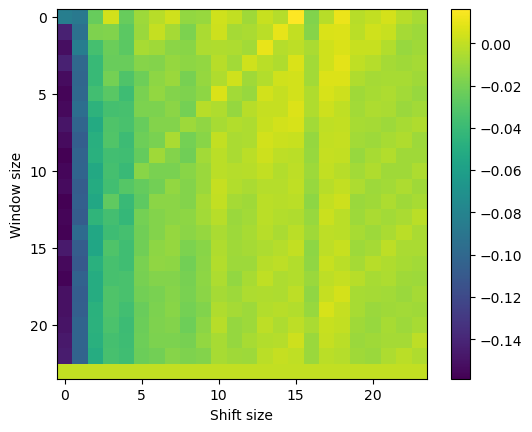

In [ ]:
def moving_average(values, window_size):
    moving_averages = []
    for i in range(len(values) - window_size + 1):
        window = values[i:i+window_size]
        window_average = sum(window) / window_size
        moving_averages.append(window_average)
    return np.array(moving_averages)

tier=0

corr_list = np.zeros((24, 24))
for window_size in range(1, 24):
    for shift_size in range(24):
        ma = moving_average(comment_freq_diff, window_size)
        freq_corr = np.corrcoef(ma[:-(1+shift_size)].flatten(), title_freq_diff[:, tier][window_size+shift_size:].flatten())
        corr_list[window_size-1][shift_size]= freq_corr[0, 1]
    
plt.imshow(corr_list)
plt.colorbar()
plt.xlabel('Shift size')
plt.ylabel('Window size')


In [ ]:
result_dict = {}
time_list = [100]
for time in time_list:
    result_dict[time] = [np.zeros((11, 11)), np.zeros((11, 11))]

folder_name = '0_grid'
model_type = 'simple'

memory_strength_list = [0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99]
filter_strength_list = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

for time in time_list:
    result_dict_array = [[None for _ in range(11)] for _ in range(11)]
    for f, filter_strength in enumerate(filter_strength_list):
        for m, memory_strength in enumerate(memory_strength_list):
            print(time, f, m)
            sim_name = f'sim_T250_C1000_E1000_ET3_F{filter_strength}_M{memory_strength}_ITfixed_IF1.0_IV00_0_0.0_0_0.0_-1_-1_t100_0'
            a, b = compute_final_kd(folder_name, model_type, sim_name, time)
            result_dict[time][0][f][m] = np.mean(a)
            result_dict[time][1][f][m] = np.mean(b)

In [ ]:
with open(join('figure', 'figure_data', 'fig3g.pkl'), 'wb') as f:
    pickle.dump(result_dict, f)

In [ ]:
with open(join('figure', 'figure_data', 'fig3g.pkl'), 'rb') as f:
    result_dict = pickle.load(f)

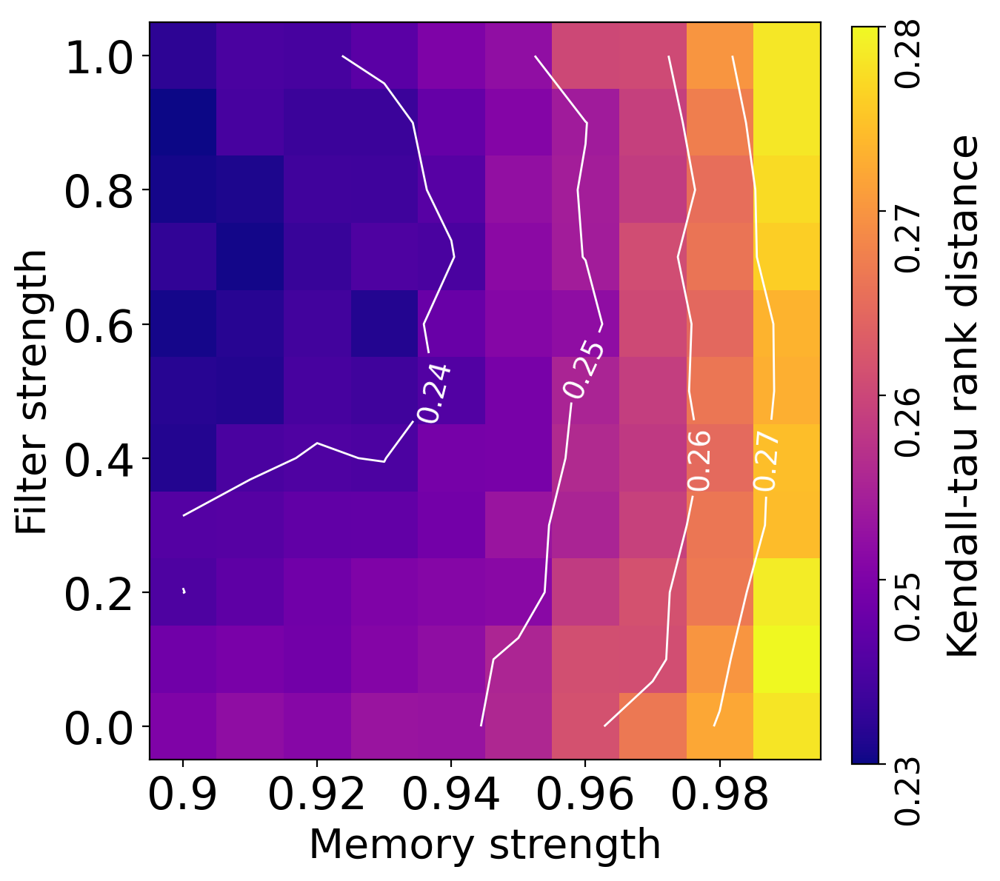

In [ ]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax = fig.add_subplot(111)

x = 1  # 0 : zt, 1 : gt
time = 100

result_array = result_dict[time][x][:, :-1]
        
im = ax.imshow(result_array, origin='lower', cmap='plasma', vmin=np.min(result_array), vmax=np.max(result_array))

cax = fig.add_axes([0.97, 0.14, 0.03, 0.83])
cb = plt.colorbar(im, orientation='vertical', cax=cax)
cb.set_label('Kendall-tau rank distance', fontsize=20, labelpad=10)
cb.set_ticks(np.linspace(np.min(result_array), np.max(result_array), 5))
cb.set_ticklabels(np.round(np.linspace(np.min(result_array), np.max(result_array), 5), 2), rotation=90)
cb.ax.tick_params(labelsize=16)

ax.set_xlabel('Memory strength', fontsize=20)
ax.set_ylabel('Filter strength', fontsize=20)

ax.set_xticks(np.arange(0, 10, 2))
ax.set_yticks(np.arange(0, 11, 2))
ax.set_xticklabels(np.round(np.arange(0.9, 1.0, 0.02), 2))
ax.set_yticklabels(np.round(np.arange(0, 1.1, 0.2), 1))

# Add contour lines
contour = ax.contour(result_array, levels=[0.23, 0.24, 0.25, 0.26, 0.27, 0.28], colors='white', linewidths=1)
ax.clabel(contour, inline=True, fontsize=14)

#ax.spines[['right', 'top']].set_visible(False)

#ax.legend(handles=line_list, fontsize=12)

# Remove small ticks and increase tick font size
ax.tick_params(which='minor', width=0, length=0)
ax.tick_params(axis='both', labelsize=22)

plt.tight_layout()
#plt.savefig("figure/fig3g.svg", format="svg", transparent=True, bbox_inches='tight')